# Your first neural network

In this project, you'll build your first neural network and use it to predict daily bike rental ridership. We've provided some of the code, but left the implementation of the neural network up to you (for the most part). After you've submitted this project, feel free to explore the data and the model more.



In [89]:
%matplotlib inline
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = 'retina'

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


## Load and prepare the data

A critical step in working with neural networks is preparing the data correctly. Variables on different scales make it difficult for the network to efficiently learn the correct weights. Below, we've written the code to load and prepare the data. You'll learn more about this soon!

In [90]:
data_path = 'Bike-Sharing-Dataset/hour.csv'

rides = pd.read_csv(data_path)

In [91]:
rides.head()

,instant,dteday,season,yr,mnth,hr,holiday,weekday,workingday,weathersit,temp,atemp,hum,windspeed,casual,registered,cnt
0,1,2011-01-01,1,0,1,0,0,6,0,1,0.24,0.2879,0.81,0.0,3,13,16
1,2,2011-01-01,1,0,1,1,0,6,0,1,0.22,0.2727,0.80,0.0,8,32,40
2,3,2011-01-01,1,0,1,2,0,6,0,1,0.22,0.2727,0.80,0.0,5,27,32
3,4,2011-01-01,1,0,1,3,0,6,0,1,0.24,0.2879,0.75,0.0,3,10,13
4,5,2011-01-01,1,0,1,4,0,6,0,1,0.24,0.2879,0.75,0.0,0,1,1


## Checking out the data

This dataset has the number of riders for each hour of each day from January 1 2011 to December 31 2012. The number of riders is split between casual and registered, summed up in the `cnt` column. You can see the first few rows of the data above.

Below is a plot showing the number of bike riders over the first 10 days or so in the data set. (Some days don't have exactly 24 entries in the data set, so it's not exactly 10 days.) You can see the hourly rentals here. This data is pretty complicated! The weekends have lower over all ridership and there are spikes when people are biking to and from work during the week. Looking at the data above, we also have information about temperature, humidity, and windspeed, all of these likely affecting the number of riders. You'll be trying to capture all this with your model.

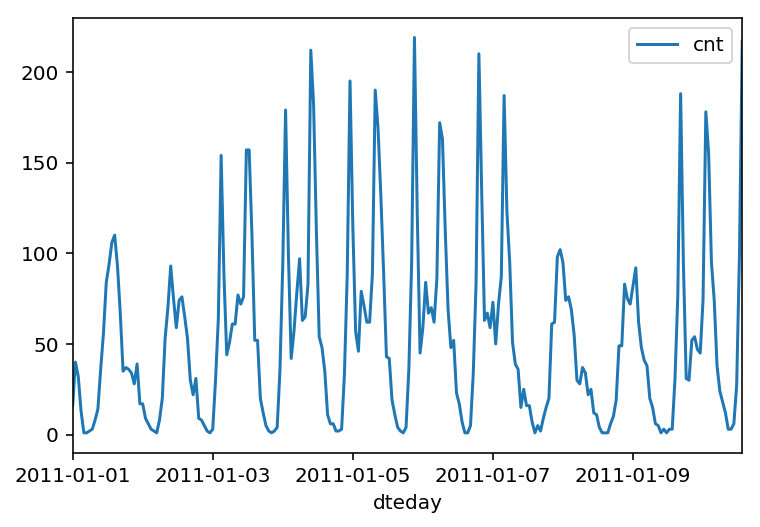

In [92]:
rides[:24*10].plot(x='dteday', y='cnt')

### Dummy variables
Here we have some categorical variables like season, weather, month. To include these in our model, we'll need to make binary dummy variables. This is simple to do with Pandas thanks to `get_dummies()`.

In [93]:
dummy_fields = ['season', 'weathersit', 'mnth', 'hr', 'weekday']
for each in dummy_fields:
    dummies = pd.get_dummies(rides[each], prefix=each, drop_first=False)
    rides = pd.concat([rides, dummies], axis=1)

fields_to_drop = ['instant', 'dteday', 'season', 'weathersit', 
                  'weekday', 'atemp', 'mnth', 'workingday', 'hr']
data = rides.drop(fields_to_drop, axis=1)
data.head()

,yr,holiday,temp,hum,windspeed,casual,registered,cnt,season_1,season_2,...,hr_21,hr_22,hr_23,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6
0,0,0,0.24,0.81,0.0,3,13,16,1,0,...,0,0,0,0,0,0,0,0,0,1
1,0,0,0.22,0.80,0.0,8,32,40,1,0,...,0,0,0,0,0,0,0,0,0,1
2,0,0,0.22,0.80,0.0,5,27,32,1,0,...,0,0,0,0,0,0,0,0,0,1
3,0,0,0.24,0.75,0.0,3,10,13,1,0,...,0,0,0,0,0,0,0,0,0,1
4,0,0,0.24,0.75,0.0,0,1,1,1,0,...,0,0,0,0,0,0,0,0,0,1


### Scaling target variables
To make training the network easier, we'll standardize each of the continuous variables. That is, we'll shift and scale the variables such that they have zero mean and a standard deviation of 1.

The scaling factors are saved so we can go backwards when we use the network for predictions.

In [94]:
quant_features = ['casual', 'registered', 'cnt', 'temp', 'hum', 'windspeed']
# Store scalings in a dictionary so we can convert back later
scaled_features = {}
for each in quant_features:
    mean, std = data[each].mean(), data[each].std()
    scaled_features[each] = [mean, std]
    data.loc[:, each] = (data[each] - mean)/std

### Splitting the data into training, testing, and validation sets

We'll save the data for the last approximately 21 days to use as a test set after we've trained the network. We'll use this set to make predictions and compare them with the actual number of riders.

In [95]:
# Save data for approximately the last 21 days 
test_data = data[-21*24:]

# Now remove the test data from the data set 
data = data[:-21*24]

# Separate the data into features and targets
target_fields = ['cnt', 'casual', 'registered']
features, targets = data.drop(target_fields, axis=1), data[target_fields]
test_features, test_targets = test_data.drop(target_fields, axis=1), test_data[target_fields]

We'll split the data into two sets, one for training and one for validating as the network is being trained. Since this is time series data, we'll train on historical data, then try to predict on future data (the validation set).

In [96]:
# Hold out the last 60 days or so of the remaining data as a validation set
train_features, train_targets = features[:-60*24], targets[:-60*24]
val_features, val_targets = features[-60*24:], targets[-60*24:]

## Time to build the network

Below you'll build your network. We've built out the structure. You'll implement both the forward pass and backwards pass through the network. You'll also set the hyperparameters: the learning rate, the number of hidden units, and the number of training passes.

<img src="assets/neural_network.png" width=300px>

The network has two layers, a hidden layer and an output layer. The hidden layer will use the sigmoid function for activations. The output layer has only one node and is used for the regression, the output of the node is the same as the input of the node. That is, the activation function is $f(x)=x$. A function that takes the input signal and generates an output signal, but takes into account the threshold, is called an activation function. We work through each layer of our network calculating the outputs for each neuron. All of the outputs from one layer become inputs to the neurons on the next layer. This process is called *forward propagation*.

We use the weights to propagate signals forward from the input to the output layers in a neural network. We use the weights to also propagate error backwards from the output back into the network to update our weights. This is called *backpropagation*.

> **Hint:** You'll need the derivative of the output activation function ($f(x) = x$) for the backpropagation implementation. If you aren't familiar with calculus, this function is equivalent to the equation $y = x$. What is the slope of that equation? That is the derivative of $f(x)$.

Below, you have these tasks:
1. Implement the sigmoid function to use as the activation function. Set `self.activation_function` in `__init__` to your sigmoid function.
2. Implement the forward pass in the `train` method.
3. Implement the backpropagation algorithm in the `train` method, including calculating the output error.
4. Implement the forward pass in the `run` method.
  

In [97]:
#############
# In the my_answers.py file, fill out the TODO sections as specified
#############

from my_answers import NeuralNetwork

In [98]:
def MSE(y, Y):
    return np.mean((y-Y)**2)

## Unit tests

Run these unit tests to check the correctness of your network implementation. This will help you be sure your network was implemented correctly befor you starting trying to train it. These tests must all be successful to pass the project.

In [115]:
import unittest

inputs = np.array([[0.5, -0.2, 0.1]])
targets = np.array([[0.4]])
test_w_i_h = np.array([[0.1, -0.2],
                       [0.4, 0.5],
                       [-0.3, 0.2]])
test_w_h_o = np.array([[0.3],
                       [-0.1]])

class TestMethods(unittest.TestCase):
    
    ##########
    # Unit tests for data loading
    ##########
    
    def test_data_path(self):
        # Test that file path to dataset has been unaltered
        self.assertTrue(data_path.lower() == 'bike-sharing-dataset/hour.csv')
        
    def test_data_loaded(self):
        # Test that data frame loaded
        self.assertTrue(isinstance(rides, pd.DataFrame))
    
    ##########
    # Unit tests for network functionality
    ##########

    def test_activation(self):
        network = NeuralNetwork(3, 2, 1, 0.5)
        # Test that the activation function is a sigmoid
        self.assertTrue(np.all(network.activation_function(0.5) == 1/(1+np.exp(-0.5))))

    def test_train(self):
        # Test that weights are updated correctly on training
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()
        
        network.train(inputs, targets)
        self.assertTrue(np.allclose(network.weights_hidden_to_output, 
                                    np.array([[ 0.37275328], 
                                              [-0.03172939]])))
        self.assertTrue(np.allclose(network.weights_input_to_hidden,
                                    np.array([[ 0.10562014, -0.20185996], 
                                              [0.39775194, 0.50074398], 
                                              [-0.29887597, 0.19962801]])))

    def test_run(self):
        # Test correctness of run method
        network = NeuralNetwork(3, 2, 1, 0.5)
        network.weights_input_to_hidden = test_w_i_h.copy()
        network.weights_hidden_to_output = test_w_h_o.copy()

        self.assertTrue(np.allclose(network.run(inputs), 0.09998924))

suite = unittest.TestLoader().loadTestsFromModule(TestMethods())
unittest.TextTestRunner().run(suite)

....F

[[-0.01511573]
 [-0.01418438]]  delta_weights_h_o
[[-0.0046824   0.00154962]
 [ 0.00187296 -0.00061985]
 [-0.00093648  0.00030992]]  delta_weights_i_h



FAIL: test_train (__main__.TestMethods)
----------------------------------------------------------------------
Traceback (most recent call last):
  File "<ipython-input-115-90d75d2cf513>", line 43, in test_train
    [-0.03172939]])))
AssertionError: False is not true

----------------------------------------------------------------------
Ran 5 tests in 0.008s

FAILED (failures=1)


<unittest.runner.TextTestResult run=5 errors=0 failures=1>

## Training the network

Here you'll set the hyperparameters for the network. The strategy here is to find hyperparameters such that the error on the training set is low, but you're not overfitting to the data. If you train the network too long or have too many hidden nodes, it can become overly specific to the training set and will fail to generalize to the validation set. That is, the loss on the validation set will start increasing as the training set loss drops.

You'll also be using a method know as Stochastic Gradient Descent (SGD) to train the network. The idea is that for each training pass, you grab a random sample of the data instead of using the whole data set. You use many more training passes than with normal gradient descent, but each pass is much faster. This ends up training the network more efficiently. You'll learn more about SGD later.

### Choose the number of iterations
This is the number of batches of samples from the training data we'll use to train the network. The more iterations you use, the better the model will fit the data. However, this process can have sharply diminishing returns and can waste computational resources if you use too many iterations.  You want to find a number here where the network has a low training loss, and the validation loss is at a minimum. The ideal number of iterations would be a level that stops shortly after the validation loss is no longer decreasing.

### Choose the learning rate
This scales the size of weight updates. If this is too big, the weights tend to explode and the network fails to fit the data. Normally a good choice to start at is 0.1; however, if you effectively divide the learning rate by n_records, try starting out with a learning rate of 1. In either case, if the network has problems fitting the data, try reducing the learning rate. Note that the lower the learning rate, the smaller the steps are in the weight updates and the longer it takes for the neural network to converge.

### Choose the number of hidden nodes
In a model where all the weights are optimized, the more hidden nodes you have, the more accurate the predictions of the model will be.  (A fully optimized model could have weights of zero, after all.) However, the more hidden nodes you have, the harder it will be to optimize the weights of the model, and the more likely it will be that suboptimal weights will lead to overfitting. With overfitting, the model will memorize the training data instead of learning the true pattern, and won't generalize well to unseen data.  

Try a few different numbers and see how it affects the performance. You can look at the losses dictionary for a metric of the network performance. If the number of hidden units is too low, then the model won't have enough space to learn and if it is too high there are too many options for the direction that the learning can take. The trick here is to find the right balance in number of hidden units you choose.  You'll generally find that the best number of hidden nodes to use ends up being between the number of input and output nodes.

In [116]:
import sys

####################
### Set the hyperparameters in you myanswers.py file ###
####################

from my_answers import iterations, learning_rate, hidden_nodes, output_nodes


N_i = train_features.shape[1]
network = NeuralNetwork(N_i, hidden_nodes, output_nodes, learning_rate)

losses = {'train':[], 'validation':[]}
for ii in range(iterations):
    # Go through a random batch of 128 records from the training data set
    batch = np.random.choice(train_features.index, size=128)
    X, y = train_features.ix[batch].values, train_targets.ix[batch]['cnt']
                             
    network.train(X, y)
    
    # Printing out the training progress
    train_loss = MSE(network.run(train_features).T, train_targets['cnt'].values)
    val_loss = MSE(network.run(val_features).T, val_targets['cnt'].values)
    sys.stdout.write("\rProgress: {:2.1f}".format(100 * ii/float(iterations)) \
                     + "% ... Training loss: " + str(train_loss)[:5] \
                     + " ... Validation loss: " + str(val_loss)[:5])
    sys.stdout.flush()
    
    losses['train'].append(train_loss)
    losses['validation'].append(val_loss)

/Users/Arturo/anaconda/envs/dlnd/lib/python3.6/site-packages/ipykernel_launcher.py:17: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated


[[ 0.07179761]
 [ 0.07077765]]  delta_weights_h_o
[[ 0.12523117 -0.14997353]
 [ 0.          0.        ]
 [ 0.17105353 -0.20484917]
 [-0.0501294   0.06003365]
 [ 0.34015481 -0.40736038]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12523117 -0.14997353]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12523117 -0.14997353]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12523117 -0.14997353]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.

[[-3.46635011]
 [-3.15354546]]  delta_weights_h_o
[[ 1.54618856 -1.81618265]
 [-0.37991247  0.42643513]
 [ 8.37093037 -9.97102974]
 [-3.94641185  4.86355908]
 [ 4.83805319 -5.71969058]
 [-3.03565014  3.62825339]
 [-1.80768476  2.24761897]
 [ 0.18289858 -0.19873171]
 [-1.72140168  2.10862217]
 [-4.78000967  5.81867529]
 [-1.48255843  1.82419902]
 [-0.1192699   0.14288852]
 [ 0.          0.        ]
 [-1.06607333  1.25327914]
 [-0.43405427  0.52656348]
 [-0.78868164  0.9100186 ]
 [-0.56098534  0.70781294]
 [-0.64587477  0.81938479]
 [ 0.05545314 -0.05118493]
 [-1.302369    1.53665266]
 [ 0.93321573 -1.12553847]
 [ 0.67116498 -0.7564788 ]
 [-0.76553204  0.94805261]
 [-0.50930409  0.59162397]
 [-1.96879739  2.42557683]
 [-1.40063351  1.71840426]
 [-1.37119626  1.67792791]
 [-1.82063857  2.20338713]
 [-1.14999953  1.37661081]
 [-1.54887512  1.85457446]
 [-0.35897938  0.43365276]
 [-0.21801999  0.25909131]
 [ 0.06292785 -0.07168135]
 [ 0.98958587 -1.1914902 ]
 [ 0.22600349 -0.267135  ]
 [-0.

 [ -1.41581242   1.70467492]]  delta_weights_i_h
[[-7.0956624 ]
 [-6.52134092]]  delta_weights_h_o
[[  0.28804524  -0.29096151]
 [ -0.62966447   0.71766357]
 [ 12.86857822 -15.47731017]
 [ -8.53672101  10.53478775]
 [  6.73647179  -8.05523147]
 [ -5.22257117   6.36488731]
 [ -5.49639111   6.68422673]
 [  0.19115496  -0.10874703]
 [ -2.01381001   2.41865392]
 [ -7.25502859   8.97379241]
 [ -4.47395185   5.37479389]
 [ -0.8126369    1.01043462]
 [  0.           0.        ]
 [ -1.32776507   1.61707572]
 [ -1.35098456   1.62861699]
 [ -1.81399071   2.20067583]
 [ -2.23571695   2.7429064 ]
 [ -1.91681332   2.34741136]
 [ -0.8553331    1.02196823]
 [ -1.30109554   1.55465672]
 [  1.81046013  -2.19118792]
 [ -0.17718269   0.35848088]
 [ -0.87065742   1.07122223]
 [ -0.16283694   0.1625572 ]
 [ -2.33970118   2.84463727]
 [ -1.851797     2.27445145]
 [ -2.13246547   2.58748496]
 [ -1.82063857   2.20338713]
 [ -2.2434833    2.6801864 ]
 [ -2.26888268   2.778481  ]
 [ -1.45016327   1.7303901 ]
 [

Progress: 0.0% ... Training loss: 1.023 ... Validation loss: 1.471[[-0.12342462]
 [-0.10518152]]  delta_weights_h_o
[[-0.16127781  0.22195079]
 [ 0.          0.        ]
 [-0.06952845  0.09568516]
 [-0.16950457  0.23327248]
 [-0.35936436  0.49455783]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16127781  0.22195079]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16127781  0.22195079]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16127781  0.22195079]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.   

 [-0.79197835  1.0345997 ]]  delta_weights_i_h
[[-3.54986921]
 [-3.26157225]]  delta_weights_h_o
[[-2.50230972  3.13845663]
 [ 0.22944795 -0.30102387]
 [ 3.42257828 -4.27035118]
 [-3.06325284  3.91128216]
 [-1.32713968  1.79943514]
 [-2.24799494  2.77016967]
 [-1.78751869  2.23926484]
 [-0.25203889  0.40578213]
 [-1.907414    2.37840574]
 [-2.79433927  3.51292843]
 [-1.78985453  2.17579128]
 [-1.61077272  2.10490265]
 [ 0.          0.        ]
 [-1.33144176  1.67022562]
 [-0.31657775  0.3838847 ]
 [ 0.04705143 -0.0582187 ]
 [-0.85614678  1.09666967]
 [-0.65138624  0.79765088]
 [-0.41395487  0.50740579]
 [ 0.04466508 -0.05505407]
 [ 0.3123457  -0.38523951]
 [-0.53288553  0.75319134]
 [-1.42394131  1.7763345 ]
 [-0.17651798  0.22717498]
 [-0.89617652  1.07959715]
 [-1.25071903  1.61663883]
 [-1.03808705  1.35019768]
 [ 0.          0.        ]
 [-0.78236267  0.96610051]
 [-0.40310971  0.48502331]
 [-0.37962406  0.47938991]
 [ 0.          0.        ]
 [-0.37934679  0.45563924]
 [ 0.2131767

 [-6.99384565]]  delta_weights_h_o
[[ -2.01593239   2.50764586]
 [  0.09911635  -0.14187375]
 [  9.65008505 -11.97897261]
 [-11.44142538  14.31584643]
 [  1.57661541  -1.71684785]
 [ -3.85917088   4.71636289]
 [ -6.17919544   7.60631979]
 [  0.61941853  -0.53357931]
 [ -3.84120154   4.7561385 ]
 [ -4.63731956   5.83171381]
 [ -4.57419297   5.48037317]
 [ -4.04863679   5.23315489]
 [  0.           0.        ]
 [ -2.03221815   2.53607509]
 [ -0.87150658   1.05915392]
 [ -0.5456745    0.66862757]
 [ -2.60441232   3.24302922]
 [ -1.99955524   2.41210358]
 [ -1.9354206    2.32319262]
 [  0.24848628  -0.30312946]
 [  1.82046961  -2.18859297]
 [ -0.90989448   1.3339429 ]
 [ -1.80263121   2.25168684]
 [ -0.70712518   0.88622516]
 [ -1.92066695   2.32292741]
 [ -2.23926572   2.84766446]
 [ -2.20993601   2.75816417]
 [  0.           0.        ]
 [ -1.09293884   1.37300401]
 [ -2.38267421   2.91692952]
 [ -1.13177871   1.33406138]
 [ -0.5808169    0.67549978]
 [ -0.59515075   0.70921599]
 [ -0.29

Progress: 1.0% ... Training loss: 1.015 ... Validation loss: 1.477[[-0.16213381]
 [-0.18820423]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.06849333  0.07645279]
 [-0.08386965  0.09361595]
 [-0.23434787  0.26158091]
 [ 0.          0.        ]
 [-0.306625    0.34225721]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.306625    0.34225721]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.306625    0.34225721]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.306625    0.34225721]
 [ 0.          0.   

 [ -1.02226488   1.31989443]]  delta_weights_i_h
[[-2.41430143]
 [-2.17112991]]  delta_weights_h_o
[[ -0.0868907    0.18222646]
 [ -0.63857862   0.71909123]
 [  7.8260645   -9.7258444 ]
 [ -8.07169623  10.04960652]
 [  4.18270687  -4.8676004 ]
 [ -2.35023188   2.87473506]
 [ -0.71541342   0.89422116]
 [  0.14263887  -0.17397425]
 [ -1.074355     1.3882906 ]
 [ -1.40434673   1.82904689]
 [ -1.7342443    2.08177976]
 [ -0.8587704    1.07244592]
 [  0.           0.        ]
 [ -0.67218667   0.90779928]
 [ -0.58881629   0.64427778]
 [  0.33199984  -0.37138158]
 [ -1.2866374    1.56203285]
 [  0.19892973  -0.24636556]
 [  0.74390391  -0.8944328 ]
 [  0.31795704  -0.44393548]
 [ -0.40603661   0.48489516]
 [ -0.60338307   0.78641584]
 [  0.23782112  -0.27158049]
 [ -0.40389883   0.49266329]
 [ -1.8670142    2.33288426]
 [ -0.70279371   0.92200022]
 [ -1.07577809   1.23549789]
 [ -1.05465416   1.35155807]
 [ -0.3919928    0.47105532]
 [ -0.7478708    0.93054181]
 [ -0.40389883   0.49266329]
 [

 [ -2.12870963e+00   2.66612023e+00]]  delta_weights_i_h
[[-6.38095891]
 [-5.72432682]]  delta_weights_h_o
[[  3.98591725e-01  -4.74312232e-01]
 [ -6.38578618e-01   7.19091231e-01]
 [  1.35133183e+01  -1.67685074e+01]
 [ -1.59805849e+01   2.02366836e+01]
 [  6.14223998e+00  -6.99394094e+00]
 [ -4.72186377e+00   5.70727907e+00]
 [ -1.41586694e+00   1.98952103e+00]
 [ -1.42586672e+00   1.74166746e+00]
 [ -3.28007861e+00   4.07076173e+00]
 [ -5.32608356e+00   6.47874313e+00]
 [ -2.72026746e+00   3.42839543e+00]
 [ -2.79732502e+00   3.60209073e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.00993722e+00   2.54417504e+00]
 [ -1.58923886e+00   1.81058424e+00]
 [ -7.70541090e-01   1.00434551e+00]
 [ -1.14779029e+00   1.49922281e+00]
 [ -9.27042408e-02   1.08259819e-01]
 [  1.26531941e+00  -1.43681357e+00]
 [  3.29081698e-01  -4.83779097e-01]
 [ -9.86553193e-01   1.15303562e+00]
 [ -1.87945969e+00   2.43614252e+00]
 [ -2.95795758e-01   3.82504846e-01]
 [ -1.51390541e+00   1.82017125e+00]
 [ -2

Progress: 2.0% ... Training loss: 1.003 ... Validation loss: 1.481[[-0.05701075]
 [-0.05870197]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10934104  0.13504084]
 [ 0.01153388 -0.01424483]
 [ 0.05890674 -0.07275234]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12915723  0.15951469]
 [ 0.          0.        ]
 [-0.12915723  0.15951469]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12915723  0.15951469]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.   

 [-1.01549976  1.23289054]]  delta_weights_i_h
[[-2.75128339]
 [-2.74136065]]  delta_weights_h_o
[[-1.3796976   1.72601647]
 [ 0.13696735 -0.17011076]
 [-0.60701528  0.71267217]
 [-1.94885644  2.44125824]
 [ 0.60351826 -0.62284865]
 [-1.27812197  1.65425384]
 [-1.12265568  1.43958021]
 [-1.92264713  2.42143966]
 [-1.0337602   1.31853558]
 [-4.29912126  5.50054018]
 [-0.12136371  0.11057349]
 [-0.9367      1.22269562]
 [ 0.          0.        ]
 [-0.29489635  0.35705705]
 [-0.44508888  0.52187446]
 [-0.53222452  0.81312513]
 [-0.19141557  0.23572024]
 [-0.57134603  0.71614862]
 [-0.73094446  0.94590665]
 [-1.36782383  1.67588239]
 [ 0.05819337 -0.06001661]
 [-0.57825523  0.73745735]
 [-0.57748897  0.72948419]
 [-0.11128442  0.14279235]
 [-0.01461008  0.01837749]
 [-0.34345015  0.44176677]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.36513817  0.4959981 ]
 [-1.54485459  1.88367529]
 [-1.04623428  1.32865753]
 [ 0.          0.        ]
 [ 0.00815977  0.01195112]
 [-0.0568578

[[-3.31877373]
 [-3.31292693]]  delta_weights_h_o
[[-1.2182793   1.52441581]
 [ 0.13696735 -0.17011076]
 [ 0.19079227 -0.27886289]
 [-2.92820695  3.639117  ]
 [ 1.09704964 -1.21966709]
 [-1.6056447   2.07046537]
 [-1.12265568  1.43958021]
 [-1.8889299   2.37913805]
 [-1.78093111  2.21920129]
 [-4.41826185  5.64744645]
 [-0.7156768   0.82203132]
 [-1.26422273  1.63890715]
 [ 0.          0.        ]
 [-0.29489635  0.35705705]
 [-0.77261161  0.93808599]
 [-0.53222452  0.81312513]
 [-0.19141557  0.23572024]
 [-0.57134603  0.71614862]
 [-0.73094446  0.94590665]
 [-1.36782383  1.67588239]
 [ 0.0919106  -0.10231822]
 [-0.57825523  0.73745735]
 [-1.1099291   1.36189846]
 [-0.11128442  0.14279235]
 [-0.22934086  0.28662892]
 [-0.34345015  0.44176677]
 [-0.37958231  0.4432064 ]
 [ 0.          0.        ]
 [-0.36513817  0.4959981 ]
 [-1.54485459  1.88367529]
 [-1.04623428  1.32865753]
 [ 0.          0.        ]
 [ 0.00815977  0.01195112]
 [-0.05685787  0.06576824]
 [-0.44747613  0.56711919]
 [-0.

 [-8.85473331]]  delta_weights_h_o
[[ -2.21303917   2.921888  ]
 [ -0.29376875   0.35986185]
 [  6.53160044  -7.90869128]
 [ -9.89239066  12.41952894]
 [  5.79548961  -6.84521933]
 [ -6.55752006   8.14147887]
 [ -3.43341422   4.29441419]
 [ -2.76531248   3.5894526 ]
 [ -3.60487728   4.4913518 ]
 [-10.43798789  13.06566851]
 [ -3.02491152   3.62344886]
 [ -2.89822463   3.82758008]
 [  0.           0.        ]
 [ -1.17059062   1.4132898 ]
 [ -3.80481131   4.58434233]
 [ -2.25722334   3.01440074]
 [ -0.87088878   1.10027972]
 [ -0.97499455   1.21034438]
 [ -0.43722435   0.61047341]
 [ -2.02724748   2.48677885]
 [ -0.84809902   1.07174529]
 [ -0.77542045   1.09847784]
 [ -1.73284269   2.17136436]
 [ -0.8240335    1.0019391 ]
 [ -0.63774794   0.75326163]
 [ -1.88296867   2.34697666]
 [ -1.77197413   2.13732772]
 [ -1.38326715   1.67269756]
 [ -0.73865429   0.92214904]
 [ -3.0273798    3.79685591]
 [ -1.75778212   2.19859498]
 [ -0.97815241   1.19235464]
 [ -0.2290031    0.30103297]
 [  0.08

[[-9.61364714]
 [-9.88427693]]  delta_weights_h_o
[[ -3.45889031   4.49453756]
 [ -0.29376875   0.35986185]
 [  6.49759828  -7.83125312]
 [-11.79844201  14.85946716]
 [  6.85686032  -8.02790528]
 [ -6.55752006   8.14147887]
 [ -4.05672782   5.08805237]
 [ -3.93576329   5.11495554]
 [ -3.60487728   4.4913518 ]
 [-11.65004089  14.57011908]
 [ -3.02491152   3.62344886]
 [ -3.47993603   4.64227064]
 [  0.           0.        ]
 [ -1.17059062   1.4132898 ]
 [ -3.80481131   4.58434233]
 [ -2.25722334   3.01440074]
 [ -1.22719707   1.53908712]
 [ -1.24199986   1.56517516]
 [ -0.14778801   0.25960078]
 [ -2.40218725   2.94289593]
 [ -1.36319669   1.71053328]
 [ -1.34527016   1.87994835]
 [ -1.73284269   2.17136436]
 [ -0.8240335    1.0019391 ]
 [ -0.63774794   0.75326163]
 [ -1.88296867   2.34697666]
 [ -2.16397069   2.62394009]
 [ -1.38326715   1.67269756]
 [ -1.49183879   1.85205246]
 [ -3.0273798    3.79685591]
 [ -1.75778212   2.19859498]
 [ -0.97815241   1.19235464]
 [ -0.2290031    0.301

Progress: 3.0% ... Training loss: 0.999 ... Validation loss: 1.492[[-0.17679009]
 [-0.21178613]]  delta_weights_h_o
[[-0.37228825  0.44133806]
 [ 0.          0.        ]
 [ 0.57419537 -0.68069371]
 [-0.33338894  0.39522394]
 [ 0.16979528 -0.2012879 ]
 [-0.37228825  0.44133806]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.37228825  0.44133806]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.37228825  0.44133806]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.37228825  0.44133806]
 [ 0.          0.        ]
 [ 0.          0.   

[[-2.18445988  2.74873314]
 [-0.33818595  0.4181038 ]
 [ 4.80623785 -6.04509404]
 [-3.93115822  5.00637376]
 [ 0.62569856 -0.32424102]
 [-3.11320239  3.83067928]
 [-0.44607702  0.6036814 ]
 [-0.12007622  0.17794726]
 [-0.05827567  0.17547971]
 [-2.03294544  2.54790669]
 [-0.84359182  1.03991567]
 [-0.86109404  1.19996529]
 [ 0.          0.        ]
 [-1.94506228  2.41769176]
 [-0.29370239  0.33368096]
 [-0.12823078  0.18293201]
 [-0.38718071  0.46410891]
 [-0.35302858  0.46601749]
 [-0.91888613  1.16192031]
 [ 0.18446292 -0.22936211]
 [ 0.15190225 -0.177948  ]
 [ 0.07176105 -0.08653327]
 [ 0.18171368 -0.10272196]
 [-0.23998936  0.27820167]
 [-0.06139096  0.07979989]
 [-0.65161753  0.83723796]
 [-0.37235012  0.4664189 ]
 [-0.36381419  0.46353536]
 [-0.3906837   0.49012967]
 [-1.14401392  1.39833216]
 [-0.72412258  0.87986316]
 [ 0.          0.        ]
 [-0.71508961  0.8923313 ]
 [ 0.72556303 -0.91776263]
 [-0.25251719  0.31466092]
 [-0.38260473  0.4730373 ]
 [ 0.02207065 -0.0282494 ]
 

 [-6.03933048]]  delta_weights_h_o
[[ -2.95630445e+00   3.58174883e+00]
 [ -3.38185950e-01   4.18103805e-01]
 [  9.25872934e+00  -1.16129291e+01]
 [ -7.46612028e+00   9.49502711e+00]
 [  1.29700999e+00  -1.01321627e+00]
 [ -6.28587788e+00   7.75921240e+00]
 [ -2.02997824e+00   2.48192283e+00]
 [ -1.74731706e+00   2.28045863e+00]
 [ -1.23535572e+00   1.64061928e+00]
 [ -7.27455763e+00   9.03093080e+00]
 [ -2.71024900e+00   3.33101242e+00]
 [ -1.31372227e+00   1.80026992e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.43011556e+00   4.27657731e+00]
 [ -1.43927658e+00   1.72480339e+00]
 [ -6.52940165e-01   8.40600067e-01]
 [ -8.85426820e-01   1.02506806e+00]
 [ -1.50124707e-01   1.42885779e-01]
 [ -2.61447964e+00   3.31121257e+00]
 [ -2.46489041e-01   3.27559501e-01]
 [  1.36310072e-01  -1.48967435e-01]
 [ -8.79177354e-01   1.10716918e+00]
 [ -4.17892512e-01   6.62373022e-01]
 [ -4.79547604e-01   6.03483937e-01]
 [ -2.39368986e-01   2.89447768e-01]
 [ -1.57308162e+00   2.02072624e+00]
 [ 

 [-6.47671473]]  delta_weights_h_o
[[ -3.49689438e+00   4.21970270e+00]
 [ -3.38185950e-01   4.18103805e-01]
 [  9.53439045e+00  -1.18895691e+01]
 [ -8.02634302e+00   1.02280103e+01]
 [  1.34040722e+00  -9.73587585e-01]
 [ -6.64712115e+00   8.16192082e+00]
 [ -2.28932725e+00   2.81775678e+00]
 [ -1.88003004e+00   2.44578779e+00]
 [ -1.23535572e+00   1.64061928e+00]
 [ -7.34687719e+00   9.11922090e+00]
 [ -3.07149227e+00   3.73372083e+00]
 [ -1.63346471e+00   2.21314293e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.43011556e+00   4.27657731e+00]
 [ -1.80051985e+00   2.12751180e+00]
 [ -6.52940165e-01   8.40600067e-01]
 [ -8.85426820e-01   1.02506806e+00]
 [ -2.94591087e-01   3.21859041e-01]
 [ -2.72936228e+00   3.46807326e+00]
 [ -4.59204383e-01   5.93477157e-01]
 [  2.16312430e-01  -2.49555935e-01]
 [ -8.79177354e-01   1.10716918e+00]
 [ -4.17892512e-01   6.62373022e-01]
 [ -4.79547604e-01   6.03483937e-01]
 [ -2.39368986e-01   2.89447768e-01]
 [ -1.57308162e+00   2.02072624e+00]
 [ 

Progress: 4.0% ... Training loss: 0.993 ... Validation loss: 1.498[[ 0.03805373]
 [ 0.0433825 ]]  delta_weights_h_o
[[ 0.08939765 -0.1139964 ]
 [ 0.          0.        ]
 [ 0.07568165 -0.09650629]
 [-0.05895387  0.07517567]
 [-0.06254872  0.07975969]
 [ 0.          0.        ]
 [ 0.08939765 -0.1139964 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08939765 -0.1139964 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08939765 -0.1139964 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.   

 [ -1.33523091e+00   1.73006303e+00]]  delta_weights_i_h
[[-3.59449858]
 [-3.87397925]]  delta_weights_h_o
[[ -2.33009366e+00   2.95652761e+00]
 [  7.67971907e-02  -9.87869226e-02]
 [  4.33242115e+00  -5.28180586e+00]
 [ -4.12640993e+00   5.02148403e+00]
 [  1.29547931e+00  -1.41226791e+00]
 [ -2.72494895e+00   3.35786018e+00]
 [ -2.11243111e+00   2.58509765e+00]
 [ -1.91650830e+00   2.46217790e+00]
 [ -3.85094640e-01   4.97911703e-01]
 [ -4.51615334e+00   5.73614394e+00]
 [ -1.06715433e+00   1.24336681e+00]
 [ -1.55567533e+00   1.92353668e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.58063977e+00   1.99707570e+00]
 [ -5.75822926e-01   6.24500581e-01]
 [ -1.87704517e-01   2.58101643e-01]
 [ -1.13643544e+00   1.39027672e+00]
 [ -7.11185125e-01   8.61007032e-01]
 [ -6.38492910e-01   8.05517562e-01]
 [ -9.74165746e-01   1.21939000e+00]
 [ -5.76526378e-01   7.52593400e-01]
 [ -1.68304555e-01   2.50274067e-01]
 [  2.74451645e-01  -3.41007104e-01]
 [ -4.83375543e-01   6.07135576e-01]
 [ -3

[[ -2.78761788e+00   3.46854194e+00]
 [  7.67971907e-02  -9.87869226e-02]
 [  4.82873979e+00  -5.78944560e+00]
 [ -4.48077913e+00   5.38838938e+00]
 [  1.39486323e+00  -1.46238950e+00]
 [ -3.47627234e+00   4.25405592e+00]
 [ -2.25366714e+00   2.77042795e+00]
 [ -2.01594357e+00   2.58922968e+00]
 [ -7.71496212e-01   9.86423328e-01]
 [ -5.98691352e+00   7.54100037e+00]
 [ -9.74790408e-01   1.13559983e+00]
 [ -1.55567533e+00   1.92353668e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.58063977e+00   1.99707570e+00]
 [ -9.54626270e-01   1.03427557e+00]
 [ -5.60224557e-01   7.44522395e-01]
 [ -1.13643544e+00   1.39027672e+00]
 [ -8.73135550e-01   1.07114978e+00]
 [ -6.17778515e-01   7.80705123e-01]
 [ -9.74165746e-01   1.21939000e+00]
 [ -5.76526378e-01   7.52593400e-01]
 [ -2.67739824e-01   3.77325846e-01]
 [ -1.04454434e-01   1.38566210e-01]
 [ -4.83375543e-01   6.07135576e-01]
 [ -3.88277234e-01   4.87120570e-01]
 [ -3.50590936e-01   4.46722848e-01]
 [ -7.27890563e-01   9.19513966e-01]
 

 [ -3.86603375e+00   4.92066068e+00]]  delta_weights_i_h
[[ -9.22300899]
 [-10.03960111]]  delta_weights_h_o
[[ -5.61532219e+00   7.00500736e+00]
 [ -3.05956193e-01   4.17205671e-01]
 [  6.44061503e+00  -7.65269562e+00]
 [ -1.19771081e+01   1.48102884e+01]
 [  5.33312544e+00  -6.39611903e+00]
 [ -5.44287380e+00   6.62540326e+00]
 [ -5.63322503e+00   7.10692939e+00]
 [ -4.48167051e+00   5.71132876e+00]
 [ -2.74811604e+00   3.48759376e+00]
 [ -1.25894648e+01   1.58988083e+01]
 [ -2.68709307e+00   3.24426326e+00]
 [ -3.02932751e+00   3.78818364e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.38382430e+00   2.94458527e+00]
 [ -1.44771878e+00   1.58558050e+00]
 [ -1.84882472e+00   2.35187651e+00]
 [ -1.54464692e+00   1.95970165e+00]
 [ -3.47037080e+00   4.40781988e+00]
 [ -1.19422023e+00   1.52484972e+00]
 [ -1.29399420e+00   1.56873345e+00]
 [ -8.99529166e-01   1.16740529e+00]
 [ -1.70775984e+00   2.21147730e+00]
 [ -6.26958831e-01   7.99545851e-01]
 [ -7.63839548e-01   9.56547261e-01]
 [ 

 [-10.35148557]]  delta_weights_h_o
[[ -5.47164418e+00   6.52904781e+00]
 [ -3.05956193e-01   4.17205671e-01]
 [  6.62085265e+00  -8.16223139e+00]
 [ -1.34215022e+01   1.69644274e+01]
 [  4.79374101e+00  -5.31918048e+00]
 [ -5.14792810e+00   6.02900277e+00]
 [ -6.22521455e+00   7.80575988e+00]
 [ -4.78612133e+00   6.11567016e+00]
 [ -2.74811604e+00   3.48759376e+00]
 [ -1.20975281e+01   1.50308968e+01]
 [ -3.47607359e+00   4.21460472e+00]
 [ -3.33377833e+00   4.19252504e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.38382430e+00   2.94458527e+00]
 [ -1.44771878e+00   1.58558050e+00]
 [ -1.55387901e+00   1.75547602e+00]
 [ -1.74770629e+00   2.21568027e+00]
 [ -3.85930095e+00   4.85067174e+00]
 [ -1.19422023e+00   1.52484972e+00]
 [ -1.29399420e+00   1.56873345e+00]
 [ -8.99529166e-01   1.16740529e+00]
 [ -2.01221066e+00   2.61581870e+00]
 [ -6.26958831e-01   7.99545851e-01]
 [ -7.63839548e-01   9.56547261e-01]
 [ -1.12419805e+00   1.45313250e+00]
 [ -8.64639791e-01   1.13169221e+00]
 [

Progress: 5.0% ... Training loss: 0.993 ... Validation loss: 1.512[[ 0.21748942]
 [ 0.22119626]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.23581696 -0.29947712]
 [-0.22429367  0.28484306]
 [ 0.41729421 -0.52994522]
 [ 0.          0.        ]
 [ 0.36913221 -0.46878161]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.36913221 -0.46878161]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.36913221 -0.46878161]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.   

 [-1.98559214]]  delta_weights_h_o
[[-0.03630532  0.08691597]
 [-0.05633507  0.02765287]
 [ 3.88959911 -4.82067581]
 [-1.1582206   1.45777467]
 [-1.17176862  1.47459562]
 [-2.17464059  2.68403639]
 [-0.58978537  0.77458667]
 [-0.63298741  0.79000798]
 [-0.11460097  0.14945443]
 [-2.8932957   3.6471001 ]
 [-0.1606182   0.16779215]
 [-0.45810044  0.58319323]
 [ 0.          0.        ]
 [-0.82405522  1.0546532 ]
 [-0.9790858   1.15806647]
 [-0.66818369  0.8642306 ]
 [-0.37970423  0.46686396]
 [-0.08152385  0.12946834]
 [ 0.16812684 -0.2146595 ]
 [-0.42778136  0.52467554]
 [-0.54471633  0.68619744]
 [ 0.54887711 -0.68331889]
 [-0.06754431  0.08655665]
 [-0.04528293  0.05307444]
 [-0.21114057  0.27227723]
 [-1.0152033   1.26562089]
 [ 0.          0.        ]
 [-0.37439334  0.47941517]
 [-0.72457857  0.91567179]
 [-0.36954407  0.47786814]
 [-0.70528341  0.84211572]
 [-0.34705214  0.44401582]
 [-0.36490992  0.46300246]
 [ 0.30747613 -0.37721242]
 [-0.51522024  0.61100606]
 [-0.13828063  0.187

[[-2.54445695]
 [-2.77191547]]  delta_weights_h_o
[[-0.3709836   0.52201297]
 [-0.36655154  0.42912548]
 [ 6.06960758 -7.60775848]
 [-1.45928492  1.83784527]
 [-0.18618229  0.20341236]
 [-3.14828935  3.94263221]
 [-1.26914005  1.61545529]
 [-0.21213499  0.25183601]
 [-0.34675174  0.45085365]
 [-4.40346624  5.58674683]
 [ 0.26023423 -0.37037982]
 [-0.83308411  1.04441014]
 [ 0.          0.        ]
 [-1.65322145  2.12863528]
 [-0.9790858   1.15806647]
 [-1.04316736  1.32544751]
 [-0.68407524  0.84651566]
 [-0.08152385  0.12946834]
 [ 0.16812684 -0.2146595 ]
 [-0.42778136  0.52467554]
 [-0.1238639   0.14802547]
 [ 0.54887711 -0.68331889]
 [-0.37776078  0.48802926]
 [-0.04528293  0.05307444]
 [-0.2775574   0.35681756]
 [-1.32541978  1.6670935 ]
 [-0.37498367  0.46121691]
 [-0.75764496  0.96661074]
 [-0.72457857  0.91567179]
 [-0.73266848  0.95949157]
 [-0.70528341  0.84211572]
 [-0.34705214  0.44401582]
 [-0.67452603  0.84948491]
 [ 0.30747613 -0.37721242]
 [-0.51522024  0.61100606]
 [-0.

 [-5.57905979]]  delta_weights_h_o
[[ -1.16943662e+00   1.51565295e+00]
 [ -7.09493006e-01   8.46019458e-01]
 [  7.47655481e+00  -9.45026273e+00]
 [ -4.60847802e+00   5.86957751e+00]
 [  2.15509403e+00  -2.78541873e+00]
 [ -4.84700399e+00   6.14327130e+00]
 [ -1.98298151e+00   2.46225925e+00]
 [ -1.86574653e+00   2.34885697e+00]
 [ -1.24786053e+00   1.61344828e+00]
 [ -7.07090413e+00   8.99791177e+00]
 [ -1.30205409e+00   1.57836823e+00]
 [ -1.57063434e+00   1.99155580e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.93044379e+00   2.48200703e+00]
 [ -1.70992401e+00   2.12233251e+00]
 [ -1.62198052e+00   2.02882706e+00]
 [ -4.33238383e-01   5.13730284e-01]
 [ -7.81169286e-01   1.00520558e+00]
 [  1.68126841e-01  -2.14659500e-01]
 [ -8.12213943e-01   1.02372662e+00]
 [ -9.88407196e-01   1.25037733e+00]
 [  1.44241451e-01  -1.87700877e-01]
 [ -8.08536992e-01   1.03704565e+00]
 [ -3.86728739e-01   5.06235049e-01]
 [ -7.83317995e-01   1.00070905e+00]
 [ -1.54618014e+00   1.94993352e+00]
 [ 

 [ -2.50836105e+00   3.25079932e+00]]  delta_weights_i_h
[[-6.14942431]
 [-6.94405324]]  delta_weights_h_o
[[ -3.83638920e-01   4.33210359e-01]
 [ -9.87574240e-01   1.19077922e+00]
 [  1.11909461e+01  -1.39954148e+01]
 [ -9.32371037e+00   1.16715384e+01]
 [  6.68157485e+00  -8.40610466e+00]
 [ -5.91399927e+00   7.44102558e+00]
 [ -1.68328706e+00   1.94715245e+00]
 [ -1.85025960e+00   2.36800728e+00]
 [ -2.71284821e+00   3.52913201e+00]
 [ -7.91993525e+00   1.00549442e+01]
 [ -2.12681479e+00   2.51633127e+00]
 [ -2.11364411e+00   2.71404186e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.35933108e+00   3.00788875e+00]
 [ -1.92898675e+00   2.34542339e+00]
 [ -1.76294453e+00   2.23284898e+00]
 [ -1.97720608e-01   1.12764220e-01]
 [ -1.24642348e+00   1.56952900e+00]
 [  6.97557706e-01  -8.93123660e-01]
 [ -7.77648398e-01   9.69177509e-01]
 [ -9.63717629e-01   1.21878891e+00]
 [ -5.07513389e-02   1.11519735e-01]
 [ -1.15264664e+00   1.49704914e+00]
 [ -1.14698362e+00   1.48222196e+00]
 [ -1

Progress: 6.0% ... Training loss: 0.985 ... Validation loss: 1.519[[ 0.14233248]
 [ 0.19502937]]  delta_weights_h_o
[[ 0.29983141 -0.32251366]
 [ 0.          0.        ]
 [ 0.06697579 -0.07204251]
 [ 0.0198476  -0.02134908]
 [ 0.15587673 -0.16766881]
 [ 0.          0.        ]
 [ 0.29983141 -0.32251366]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.29983141 -0.32251366]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.29983141 -0.32251366]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.   

 [ 0.88792529 -1.11317021]]  delta_weights_i_h
[[-1.79717426]
 [-1.98372336]]  delta_weights_h_o
[[ 0.6642612  -0.8437798 ]
 [-0.35962787  0.46594001]
 [ 4.80895934 -5.98980709]
 [-2.65955318  3.24522709]
 [ 2.12877685 -2.63618476]
 [-1.68483534  2.07710439]
 [ 0.42085469 -0.51248974]
 [-1.22764402  1.58333306]
 [-1.10271704  1.4291397 ]
 [-2.9534174   3.82067541]
 [-0.11461985  0.16859874]
 [-0.52630446  0.58781327]
 [ 0.          0.        ]
 [-0.76016923  0.94644624]
 [-0.89509324  1.08007456]
 [-0.59370174  0.71828833]
 [ 0.20129082 -0.19923327]
 [ 0.16815425 -0.21675634]
 [ 0.61553849 -0.76420487]
 [-0.44123766  0.57802207]
 [-0.80518272  1.02940408]
 [ 0.01877636 -0.02409309]
 [ 0.          0.        ]
 [-0.48575025  0.62871833]
 [-0.6169668   0.80042137]
 [-0.30300294  0.38956376]
 [ 0.          0.        ]
 [-0.36497541  0.47137377]
 [-0.30092418  0.37054172]
 [-0.7501543   0.96337212]
 [-1.05458365  1.34303999]
 [-0.13028636  0.16552254]
 [ 0.1501305  -0.18068636]
 [-0.2911439

 [ -0.01421166  -0.01692482]]  delta_weights_i_h
[[-5.23208633]
 [-5.76498165]]  delta_weights_h_o
[[ -1.56639148   1.93928927]
 [ -0.29456592   0.38093797]
 [  8.92390074 -11.07106331]
 [ -4.87144371   5.61098398]
 [  2.24727793  -2.22937675]
 [ -4.95535652   6.21116153]
 [  0.37610364  -0.61263171]
 [ -3.37904326   4.39806146]
 [ -2.46927102   3.07376588]
 [ -6.88248428   8.78824251]
 [ -2.21768317   2.69577113]
 [ -1.32739971   1.58634351]
 [  0.           0.        ]
 [ -2.95442375   3.72810905]
 [ -1.52858297   1.87733326]
 [ -1.29930321   1.5663965 ]
 [ -0.66880131   0.8414243 ]
 [  0.35916134  -0.4507401 ]
 [  1.12027318  -1.46528352]
 [ -0.18902351   0.29854278]
 [ -2.31121038   2.96750741]
 [ -0.89787198   1.16253424]
 [  0.03332923  -0.04638352]
 [ -1.47414701   1.79049538]
 [ -0.6169668    0.80042137]
 [ -0.63220509   0.81084237]
 [ -1.09044204   1.39386097]
 [ -1.45656514   1.75538438]
 [ -1.03569992   1.25101196]
 [ -1.1182391    1.43500262]
 [ -1.05458365   1.34303999]
 [

[[  4.54634868e-01  -7.06007962e-01]
 [ -2.94565920e-01   3.80937975e-01]
 [  1.29989897e+01  -1.64027306e+01]
 [ -1.12688141e+01   1.37668243e+01]
 [  4.77997006e+00  -5.48545293e+00]
 [ -5.96698027e+00   7.50750435e+00]
 [ -3.91367812e-01   3.96438692e-01]
 [ -2.66341043e+00   3.39252651e+00]
 [ -2.04642559e+00   2.50872385e+00]
 [ -6.01950575e+00   7.59548897e+00]
 [ -3.24995216e+00   4.01269514e+00]
 [ -1.79872618e+00   2.19700929e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.00410655e+00   5.09016796e+00]
 [ -1.27200786e+00   1.54712128e+00]
 [ -1.02891245e+00   1.21105144e+00]
 [ -8.80106365e-01   1.12170618e+00]
 [ -6.85911892e-01   8.97889379e-01]
 [  2.12479109e+00  -2.79644633e+00]
 [ -7.93412902e-01   1.07367606e+00]
 [ -1.37543615e+00   1.73567211e+00]
 [ -3.58707540e-01   4.48723828e-01]
 [  3.33292282e-02  -4.63835210e-02]
 [ -1.84370801e+00   2.24115547e+00]
 [ -9.83994709e-01   1.28085955e+00]
 [ -6.32205091e-01   8.10842366e-01]
 [ -1.46653442e+00   1.87063420e+00]
 

Progress: 7.0% ... Training loss: 0.979 ... Validation loss: 1.525[[-0.1194312]
 [-0.1639556]]  delta_weights_h_o
[[-0.31038554  0.42399171]
 [ 0.          0.        ]
 [ 0.18857424 -0.2575955 ]
 [ 0.57470979 -0.78506296]
 [ 0.065704   -0.08975274]
 [ 0.          0.        ]
 [-0.31038554  0.42399171]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.31038554  0.42399171]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.31038554  0.42399171]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.31038554  0.42399

 [-0.45620854]]  delta_weights_h_o
[[ 0.03740966 -0.02115895]
 [-0.34441255  0.43227231]
 [-0.55257448  0.75234937]
 [ 0.53532287 -0.75456219]
 [-0.51316242  0.70544652]
 [ 0.34779519 -0.44515066]
 [-0.31038554  0.42399171]
 [-0.51192724  0.716743  ]
 [-0.34441255  0.43227231]
 [-0.63846663  0.87704483]
 [-0.18046351  0.25081153]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.34779519 -0.44515066]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.31038554  0.42399171]
 [ 0.          0.        ]
 [-0.18046351  0.25081153]
 [-0.17066028  0.23447215]
 [ 0.          0.        ]
 [-0.16080346  0.23145932]
 [ 0.          0.        ]
 [-0.34441255  0.43227231]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.31038554  0.42399171]
 [ 0.34779519 -0.44515066]
 [ 0.          0.        ]
 [ 0.          0.   

 [-2.75781542]]  delta_weights_h_o
[[-1.36218452  1.7375949 ]
 [-0.34441255  0.43227231]
 [ 0.52639338 -0.6173442 ]
 [-0.58933779  0.44576897]
 [-0.14939007  0.35126234]
 [-1.13703603  1.42294333]
 [-1.05721809  1.34097105]
 [-1.29310465  1.75404438]
 [-1.38617767  1.77620413]
 [-3.01655673  4.03797751]
 [-1.79066136  2.16542319]
 [-0.06631836  0.09076219]
 [ 0.          0.        ]
 [-0.62427637  0.81941773]
 [-0.29177539  0.36973297]
 [-0.28730262  0.32455482]
 [-0.60131684  0.73553604]
 [ 0.05087683 -0.06533588]
 [-0.62092323  0.83082023]
 [-0.17066028  0.23447215]
 [-0.4828741   0.63595559]
 [-0.45910677  0.63280511]
 [-1.04176513  1.34393182]
 [-0.34441255  0.43227231]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-1.06150312  1.41382097]
 [ 0.          0.        ]
 [-0.70775308  0.87646261]
 [-0.22098427  0.23379263]
 [-0.60868885  0.8253375 ]
 [ 0.05686389 -0.13360633]
 [-0.10798537  0.14747602]
 [ 0.          0.   

[[ -8.50179492e-01   7.81329819e-01]
 [ -3.43799478e-01   4.31484917e-01]
 [  2.62235760e+00  -3.39938060e+00]
 [ -5.63347099e-01   2.45816142e-01]
 [  1.93930461e+00  -2.51629616e+00]
 [ -1.76105454e+00   2.08408590e+00]
 [ -7.60959126e-01   9.68471008e-01]
 [ -5.74727090e-01   6.73767599e-01]
 [ -1.58711713e+00   2.05941010e+00]
 [ -3.01132581e+00   4.05386566e+00]
 [ -1.67535111e+00   1.85037001e+00]
 [  2.81903838e-03  -1.18501061e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -8.85228381e-01   1.14495722e+00]
 [ -6.54841889e-01   7.05336053e-01]
 [ -2.87302623e-01   3.24554820e-01]
 [ -7.97927341e-01   9.93427682e-01]
 [  5.43746297e-01  -6.95727563e-01]
 [ -6.20923230e-01   8.30820230e-01]
 [  5.60504051e-02  -2.42822382e-01]
 [ -7.44245625e-02   1.17729210e-01]
 [ -3.75889427e-01   5.48049237e-01]
 [ -1.04176513e+00   1.34393182e+00]
 [ -3.44412545e-01   4.32272307e-01]
 [ -2.00939456e-01   2.83205971e-01]
 [ -2.37603920e-01   3.13049411e-01]
 [ -3.48358123e-01   4.58866647e-01]
 

 [-1.67328564  2.21143781]]  delta_weights_i_h
[[-2.9078906 ]
 [-3.35269925]]  delta_weights_h_o
[[-1.34587736  1.44160347]
 [-0.34379948  0.43148492]
 [ 4.25351765 -5.55014596]
 [-0.18779989 -0.17435546]
 [ 2.03138119 -2.61231852]
 [-2.50804983  3.05316576]
 [-1.25665699  1.62874465]
 [-0.94154152  1.15317774]
 [-1.46399371  1.87278997]
 [-4.25701804  5.64936942]
 [-1.54376759  1.69522464]
 [-0.36945643  0.36328408]
 [ 0.          0.        ]
 [-1.63222367  2.11403708]
 [-0.65484189  0.70533605]
 [-0.28730262  0.32455482]
 [-1.10509751  1.39236572]
 [ 0.3552186  -0.43439195]
 [-0.62092323  0.83082023]
 [-0.31076403  0.23658776]
 [-0.07442456  0.11772921]
 [-0.37588943  0.54804924]
 [-0.78272955  0.9693877 ]
 [-0.4803247   0.6201963 ]
 [-0.20093946  0.28320597]
 [-0.61232375  0.80034414]
 [-0.66846934  0.87534763]
 [-0.71566527  0.86117179]
 [-1.79138406  2.2288342 ]
 [-0.37957608  0.48278711]
 [-0.70775308  0.87646261]
 [-0.22098427  0.23379263]
 [-0.48428355  0.68065302]
 [ 1.0916169

[[-5.64104379]
 [-6.40200566]]  delta_weights_h_o
[[ -2.13907414   2.4063827 ]
 [ -0.34379948   0.43148492]
 [  5.20270451  -6.66266392]
 [ -2.79978613   3.14027177]
 [  2.72023276  -3.48270354]
 [ -3.7126849    4.51882783]
 [ -2.79228779   3.49950414]
 [ -2.52126021   3.25501218]
 [ -2.26539899   2.91312537]
 [ -7.7037216   10.07189362]
 [ -2.92329875   3.34959455]
 [ -0.66461155   0.76498135]
 [  0.           0.        ]
 [ -1.91721297   2.46654275]
 [ -1.01115103   1.12532782]
 [ -0.5202367    0.5911007 ]
 [ -2.1273403    2.63864192]
 [  0.20877641  -0.2722027 ]
 [ -0.98786906   1.29311426]
 [ -1.00459532   1.14216736]
 [ -0.36924931   0.51493797]
 [ -1.10619453   1.52458975]
 [ -1.44489237   1.83222866]
 [ -0.4803247    0.6201963 ]
 [ -0.53134201   0.70982472]
 [ -0.61232375   0.80034414]
 [ -1.00338758   1.31349998]
 [ -1.01824195   1.27110581]
 [ -2.07987002   2.61794626]
 [ -1.0886753    1.35002067]
 [ -1.44170661   1.79990033]
 [ -0.45139276   0.54686827]
 [ -0.78703477   1.071

[[-6.43386187]
 [-7.17965505]]  delta_weights_h_o
[[ -1.17204094   1.27726074]
 [ -0.34379948   0.43148492]
 [  6.51050112  -8.21260793]
 [ -3.50474034   4.1139959 ]
 [  2.58604392  -3.42329338]
 [ -4.73579826   5.75404341]
 [ -1.52095534   1.97468678]
 [ -3.33484597   4.34346105]
 [ -3.09778863   4.03325958]
 [ -8.29448867  10.85557812]
 [ -3.34361051   3.99661726]
 [ -1.05128902   1.25325543]
 [  0.           0.        ]
 [ -1.91721297   2.46654275]
 [ -1.42179286   1.63278146]
 [  0.10950226  -0.16475336]
 [ -2.1273403    2.63864192]
 [  0.26019063  -0.34209831]
 [ -1.01016131   1.32180851]
 [ -1.4883825    1.79884447]
 [ -0.69904789   0.94670974]
 [ -1.10619453   1.52458975]
 [ -1.46048747   1.85253517]
 [ -0.82406165   1.08919325]
 [ -1.00439961   1.34065547]
 [ -0.61232375   0.80034414]
 [ -1.00338758   1.31349998]
 [ -1.01824195   1.27110581]
 [ -2.07987002   2.61794626]
 [ -1.46271472   1.85065356]
 [ -1.78544356   2.26889728]
 [ -0.45139276   0.54686827]
 [ -1.12983991   1.485

Progress: 8.0% ... Training loss: 0.980 ... Validation loss: 1.542[[-0.13487526]
 [-0.19792706]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.35266539 -0.46840693]
 [-0.21937099  0.29136654]
 [ 0.28318397 -0.37612234]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.3447325   0.45787054]
 [ 0.          0.        ]
 [-0.3447325   0.45787054]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.3447325   0.45787054]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.3447325   0.45787054]
 [ 0.          0.   

 [-3.48877213]]  delta_weights_h_o
[[ -1.83777800e+00   2.19692649e+00]
 [ -2.03761831e-01   2.65204766e-01]
 [  5.43596830e+00  -6.77100238e+00]
 [ -4.85621424e+00   5.75781873e+00]
 [  5.77199386e-01  -6.11564631e-01]
 [ -2.19045560e+00   2.70094949e+00]
 [ -1.80637437e+00   2.22148325e+00]
 [  4.09137968e-01  -5.78368828e-01]
 [ -2.16829889e+00   2.75356644e+00]
 [ -2.59104819e+00   3.32487508e+00]
 [ -2.81461642e+00   3.31734240e+00]
 [ -3.50326290e-01   4.55412876e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.63166231e-01   4.51909321e-01]
 [ -7.90232483e-01   8.97440276e-01]
 [ -1.38776468e+00   1.75861576e+00]
 [ -1.06108170e+00   1.29621532e+00]
 [ -4.60743410e-01   6.01093866e-01]
 [  6.61585354e-02  -8.28417974e-02]
 [  6.15175589e-01  -8.26521088e-01]
 [ -2.39441994e-01   2.95705583e-01]
 [ -1.28747441e-01   1.67561259e-01]
 [ -7.99712448e-01   1.01678617e+00]
 [ -1.11137468e+00   1.39871213e+00]
 [ -9.50599503e-02   1.22953560e-01]
 [ -7.96912982e-01   1.04283881e+00]
 [ 

 [-4.45411893]]  delta_weights_h_o
[[ -1.47723921e+00   1.56045576e+00]
 [ -2.03761831e-01   2.65204766e-01]
 [  6.42354320e+00  -8.06756318e+00]
 [ -5.83852324e+00   6.70151999e+00]
 [ -1.28214747e-02   8.02862794e-02]
 [ -3.34261212e+00   4.15076012e+00]
 [ -2.75813273e+00   3.38790803e+00]
 [  1.07919018e+00  -1.54155658e+00]
 [ -2.35826871e+00   2.95690518e+00]
 [ -2.82028283e+00   3.46374559e+00]
 [ -3.88526275e+00   4.57700220e+00]
 [ -6.74277803e-01   9.13268953e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.63166231e-01   4.51909321e-01]
 [ -7.90232483e-01   8.97440276e-01]
 [ -2.53992120e+00   3.20842640e+00]
 [ -1.78763367e+00   2.18188230e+00]
 [ -4.38649040e-01   5.68140469e-01]
 [ -1.81142228e-01   2.30869385e-01]
 [  6.15175589e-01  -8.26521088e-01]
 [ -2.39441994e-01   2.95705583e-01]
 [  5.41304769e-01  -7.95626497e-01]
 [ -7.99712448e-01   1.01678617e+00]
 [ -1.30134449e+00   1.60205087e+00]
 [ -9.50599503e-02   1.22953560e-01]
 [ -1.42039683e+00   1.85744940e+00]
 [ 

 [-8.61112463]]  delta_weights_h_o
[[ -1.57345948e+00   1.55634683e+00]
 [ -3.45557475e-01   5.77591191e-01]
 [  1.50935007e+01  -1.92565528e+01]
 [ -7.49104155e+00   8.85129925e+00]
 [  4.43564727e-01  -2.47967873e-01]
 [ -5.67213660e+00   7.13955035e+00]
 [ -5.12518920e+00   6.19972680e+00]
 [ -8.54888064e-02  -2.90066077e-02]
 [ -3.92217399e+00   5.14468911e+00]
 [ -7.53663663e+00   9.48413321e+00]
 [ -4.56158432e+00   5.29815177e+00]
 [ -2.70676764e+00   3.67267466e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.41580064e+00   3.21459962e+00]
 [ -2.15497627e+00   2.59855971e+00]
 [ -2.99111212e+00   3.55470665e+00]
 [ -2.07864848e+00   2.46411825e+00]
 [ -9.75646066e-01   1.27642353e+00]
 [ -5.49810536e-01   7.25055185e-01]
 [  1.70830658e-01  -2.78205992e-01]
 [ -4.10758173e-01   5.29486659e-01]
 [  3.60955203e-01  -5.59358493e-01]
 [ -1.30356641e+00   1.77667661e+00]
 [ -2.01841049e+00   2.57593195e+00]
 [ -4.38045272e-01   5.76965958e-01]
 [ -2.62112927e+00   3.43544978e+00]
 [ 

 [-8.99935378]]  delta_weights_h_o
[[ -1.59365742e+00   1.58350140e+00]
 [ -6.60720622e-01   9.72332346e-01]
 [  1.51863466e+01  -1.93618192e+01]
 [ -8.16658572e+00   9.72065644e+00]
 [  1.06801388e+00  -1.03777493e+00]
 [ -5.67213660e+00   7.13955035e+00]
 [ -5.84561452e+00   7.12837611e+00]
 [  2.51523752e-01  -4.62486308e-01]
 [ -4.23733713e+00   5.53943026e+00]
 [ -7.80982462e+00   9.82389746e+00]
 [ -4.98697223e+00   5.84829829e+00]
 [ -2.70676764e+00   3.67267466e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.41580064e+00   3.21459962e+00]
 [ -2.15497627e+00   2.59855971e+00]
 [ -2.99111212e+00   3.55470665e+00]
 [ -2.07864848e+00   2.46411825e+00]
 [ -1.33285656e+00   1.73705780e+00]
 [ -9.13025354e-01   1.19307022e+00]
 [  3.20831722e-01  -4.60529635e-01]
 [ -4.10758173e-01   5.29486659e-01]
 [  5.47966698e-01  -8.10514550e-01]
 [ -1.61872956e+00   2.17141777e+00]
 [ -2.01841049e+00   2.57593195e+00]
 [ -4.38045272e-01   5.76965958e-01]
 [ -2.62112927e+00   3.43544978e+00]
 [ 

Progress: 9.0% ... Training loss: 0.978 ... Validation loss: 1.560[[-0.17787131]
 [-0.23169854]]  delta_weights_h_o
[[-0.34821789  0.39029257]
 [ 0.          0.        ]
 [ 0.32006304 -0.35873581]
 [-0.23963786  0.26859297]
 [ 0.15881714 -0.17800679]
 [ 0.          0.        ]
 [-0.34821789  0.39029257]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.34821789  0.39029257]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.34821789  0.39029257]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.34821789  0.39029257]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.   

[[-0.27675624  0.29518381]
 [ 0.          0.        ]
 [ 1.12760953 -1.36083304]
 [-1.63065574  1.9089956 ]
 [-0.49306607  0.74486043]
 [-1.00993288  1.28691559]
 [-1.15304754  1.47746082]
 [-0.81717444  1.07976193]
 [-0.93532653  1.22561909]
 [-2.14235221  2.90348184]
 [-1.09950415  1.25695618]
 [-0.67362504  0.9093194 ]
 [ 0.          0.        ]
 [-0.45324796  0.59318137]
 [-0.28779326  0.43978641]
 [-0.26889166  0.25394781]
 [-0.67848502  0.82408168]
 [-0.41353057  0.57001993]
 [-0.27124641  0.36450002]
 [-0.42431384  0.55777782]
 [-0.27538591  0.37010994]
 [ 0.31454548 -0.42962224]
 [-0.68396522  0.91274431]
 [-0.1740337   0.21187137]
 [-0.29913332  0.40135901]
 [-0.56564173  0.67957227]
 [-0.70365242  0.94661983]
 [-0.27538591  0.37010994]
 [-0.33353893  0.44334119]
 [-0.69576683  0.92604819]
 [ 0.          0.        ]
 [-0.21021446  0.28114081]
 [ 0.04510079 -0.0601564 ]
 [-0.40987644  0.54256797]
 [ 0.06006278 -0.08400739]
 [ 0.          0.        ]
 [-0.07344446  0.10404172]
 

 [-3.09693102]]  delta_weights_h_o
[[-0.21021668  0.18029451]
 [-0.24080061  0.29292178]
 [ 1.73588507 -2.29561182]
 [-1.91982437  2.22309315]
 [-1.1711238   1.76416725]
 [-1.4560909   1.9336639 ]
 [-1.71825246  2.19778797]
 [-0.73877293  1.0032102 ]
 [-1.40358725  1.86593037]
 [-2.55815011  3.45426313]
 [-1.93857513  2.40824006]
 [-0.81997831  1.13808926]
 [ 0.          0.        ]
 [-0.80583384  1.09068769]
 [-0.15479986  0.23819713]
 [-0.4954572   0.60477908]
 [-0.83069378  1.03870514]
 [-0.58680055  0.76322079]
 [-0.5109726   0.67700284]
 [ 0.04569351 -0.07291875]
 [-0.61620643  0.86618577]
 [ 0.06778657 -0.08834751]
 [-1.03990657  1.37986513]
 [-0.09037948  0.10185611]
 [-0.29913332  0.40135901]
 [-0.76010899  0.94687823]
 [-1.2873992   1.71044637]
 [-0.27538591  0.37010994]
 [-0.67242766  0.87587142]
 [-0.69576683  0.92604819]
 [-0.31788267  0.4153565 ]
 [-0.21021446  0.28114081]
 [ 0.00595076 -0.00777617]
 [ 0.26341401 -0.34214182]
 [ 0.06006278 -0.08400739]
 [ 0.15374959 -0.213

[[ -9.33983621e-01   1.11436450e+00]
 [ -2.40800609e-01   2.92921776e-01]
 [  4.41762908e+00  -5.77994196e+00]
 [ -2.96701826e+00   3.57105610e+00]
 [ -1.89870173e+00   2.67269054e+00]
 [ -2.82871614e+00   3.80157261e+00]
 [ -2.24974904e+00   2.77602571e+00]
 [ -2.03771109e+00   2.80281840e+00]
 [ -1.73694523e+00   2.30172953e+00]
 [ -4.40169138e+00   5.89707250e+00]
 [ -3.04630595e+00   3.87647840e+00]
 [ -1.40512418e+00   1.90859535e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.96940578e+00   2.68735323e+00]
 [  1.30366580e-01  -1.20539185e-01]
 [ -7.40675282e-01   9.05558828e-01]
 [ -1.18904642e+00   1.40210486e+00]
 [ -7.59944481e-01   9.78058816e-01]
 [ -5.91850920e-01   7.89265750e-01]
 [ -5.11823886e-01   6.56605901e-01]
 [ -6.02237356e-01   8.56782349e-01]
 [ -6.06724958e-01   8.78876556e-01]
 [ -1.03990657e+00   1.37986513e+00]
 [ -3.96166307e-01   5.00558606e-01]
 [ -5.75706130e-01   7.67655409e-01]
 [ -7.60108989e-01   9.46878233e-01]
 [ -1.96303977e+00   2.60136318e+00]
 

 [ -1.41291635e+00   1.88706848e+00]]  delta_weights_i_h
[[-4.84639546]
 [-5.36818418]]  delta_weights_h_o
[[ -2.10410824e-01   9.05186591e-02]
 [ -2.40800609e-01   2.92921776e-01]
 [  6.12444766e+00  -8.11421382e+00]
 [ -4.67511826e+00   5.98204537e+00]
 [ -1.80843716e+00   2.69720140e+00]
 [ -3.18622983e+00   4.24979181e+00]
 [ -2.53186929e+00   3.13888528e+00]
 [ -1.19482038e+00   1.67357450e+00]
 [ -2.25976044e+00   3.06391068e+00]
 [ -3.88511145e+00   5.16779887e+00]
 [ -3.32842619e+00   4.23933797e+00]
 [ -1.95914230e+00   2.71902543e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.96940578e+00   2.68735323e+00]
 [ -2.27147112e-01   3.27680014e-01]
 [ -7.40675282e-01   9.05558828e-01]
 [ -1.18904642e+00   1.40210486e+00]
 [ -1.04206472e+00   1.34091838e+00]
 [ -5.91850920e-01   7.89265750e-01]
 [ -6.63495773e-01   8.76467217e-01]
 [ -5.07884845e-01   7.27785872e-01]
 [  3.83313000e-01  -4.68518459e-01]
 [ -1.39188937e+00   1.92194781e+00]
 [ -3.96166307e-01   5.00558606e-01]
 [ -8

Progress: 10.0% ... Training loss: 0.977 ... Validation loss: 1.571[[-0.19286499]
 [-0.22138863]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.41824236  0.5305388 ]
 [-0.398262    0.50519379]
 [ 0.07644443 -0.09696946]
 [ 0.          0.        ]
 [-0.36112329  0.45808348]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.36112329  0.45808348]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.36112329  0.45808348]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.36112329  0.45808348]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [  4.07047451e-01  -5.51762569e-01]]  delta_weights_i_h
[[-0.02630863]
 [-0.05072612]]  delta_weights_h_o
[[  9.38160525e-01  -1.27766192e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  4.21033721e-01  -6.03845086e-01]
 [ -1.10059171e+00   1.44000177e+00]
 [ -1.83689409e-01   2.97359255e-01]
 [ -4.60442151e-01   6.55219784e-01]
 [  5.77037235e-01  -8.19578437e-01]
 [ -2.96750418e-02   6.82784677e-02]
 [ -5.57301569e-03   7.07196626e-04]
 [  5.22011158e-01  -6.51035601e-01]
 [ -4.40664132e-01   5.55662612e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.49118209e-01   4.94122785e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  3.86295807e-01  -5.23024480e-01]
 [  5.51864718e-01  -7.54637436e-01]
 [ -3.61123290e-01   4.58083479e-01]
 [  7.53956888e-02  -7.90366746e-02]
 [ -1.05070731e-01   1.47315142e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.57301569e-03   7.07196626e-04]
 [  0.00000000e+00   0.00000000e+00]
 [ -1

 [-1.94971803]]  delta_weights_h_o
[[ 0.92580732 -1.28627683]
 [-0.4265003   0.57415694]
 [ 2.333574   -3.09360119]
 [-2.42588269  3.12347949]
 [-0.78401252  1.07288308]
 [-1.46409493  1.95494799]
 [-0.623078    0.77422554]
 [-0.57741783  0.81882535]
 [-0.45323053  0.58391086]
 [-1.67242819  2.25535453]
 [-1.18953229  1.52931869]
 [-0.25586081  0.34723651]
 [ 0.          0.        ]
 [-1.48683356  1.98270545]
 [ 0.          0.        ]
 [ 0.13406257 -0.18885446]
 [-0.481516    0.64744554]
 [ 0.22075801 -0.33123735]
 [-0.36232001  0.45801735]
 [-0.07625338  0.14179063]
 [-0.45196308  0.60318633]
 [-0.04920138  0.0738484 ]
 [-0.20416367  0.26895819]
 [-0.24906686  0.31495267]
 [-0.11132394  0.161097  ]
 [-0.32942376  0.44282011]
 [-0.682878    0.91824122]
 [-0.72295123  0.93381407]
 [ 0.          0.        ]
 [-0.34911821  0.49412278]
 [ 0.          0.        ]
 [-0.54733702  0.68548707]
 [ 0.          0.        ]
 [ 0.85236616 -1.1535852 ]
 [ 0.          0.        ]
 [-0.01067211  0.014

[[ 1.06113699 -1.46667003]
 [-0.4265003   0.57415694]
 [ 3.34106206 -4.45544601]
 [-3.40239802  4.37655287]
 [-0.89409753  1.23063628]
 [-1.53673466  2.05166168]
 [-0.85283817  1.07830958]
 [-0.52139428  0.74655324]
 [-1.10276258  1.46700421]
 [-2.39951198  3.24658728]
 [-1.22718287  1.57169101]
 [-0.38703484  0.52525042]
 [ 0.          0.        ]
 [-1.48683356  1.98270545]
 [-0.03765058  0.04237231]
 [ 0.09907342 -0.13451309]
 [-0.481516    0.64744554]
 [ 0.12520184 -0.2019199 ]
 [-0.496524    0.63278393]
 [ 0.26592    -0.31008284]
 [-0.45196308  0.60318633]
 [-0.33535121  0.45344975]
 [-0.49631832  0.64920215]
 [-0.48548804  0.65657404]
 [-0.23228017  0.32232503]
 [-0.32942376  0.44282011]
 [-0.682878    0.91824122]
 [-0.72295123  0.93381407]
 [-0.28614983  0.37960135]
 [-0.70352121  0.95672786]
 [ 0.          0.        ]
 [-0.68154102  0.86025365]
 [ 0.34217338 -0.45187347]
 [ 0.85236616 -1.1535852 ]
 [-0.12095623  0.16122803]
 [-0.01067211  0.01439173]
 [ 0.40704745 -0.55176257]
 

[[ 0.46416591 -0.71734625]
 [-0.94086292  1.23833158]
 [ 3.05356986 -4.14166544]
 [-4.2203282   5.32086958]
 [ 0.67104757 -0.97931282]
 [-2.14632541  2.88797897]
 [-1.17400564  1.53214067]
 [-1.61310343  2.15227338]
 [-2.07255286  2.74581354]
 [-4.91150448  6.59829932]
 [-1.43759747  1.8386833 ]
 [-0.6568854   0.88122393]
 [ 0.          0.        ]
 [-1.75693858  2.41570623]
 [-0.37713631  0.44568883]
 [ 0.09907342 -0.13451309]
 [-0.8130559   1.11521029]
 [ 0.13557426 -0.21585355]
 [-0.25664309  0.30967884]
 [-0.54154566  0.75382118]
 [-0.45196308  0.60318633]
 [-1.20917495  1.57381937]
 [-0.76616888  1.00517566]
 [-0.48548804  0.65657404]
 [-0.58252054  0.78971243]
 [-0.874781    1.16157084]
 [-0.682878    0.91824122]
 [-1.40419047  1.85702723]
 [-0.28614983  0.37960135]
 [-0.70352121  0.95672786]
 [-1.0034359   1.26863284]
 [-0.68154102  0.86025365]
 [ 0.03822536 -0.05469111]
 [ 0.85236616 -1.1535852 ]
 [-0.12095623  0.16122803]
 [-0.01067211  0.01439173]
 [ 0.23847244 -0.33679933]
 

[[ -0.78662452   0.90612937]
 [ -1.20009823   1.56318892]
 [  5.79183255  -7.61648933]
 [ -6.27170285   7.93696941]
 [ -0.60828873   0.7049089 ]
 [ -4.32607811   5.76573458]
 [ -2.01930181   2.63473581]
 [ -1.28711666   1.77730579]
 [ -3.50253746   4.61463802]
 [ -7.59047827  10.17469387]
 [ -1.9442947    2.46614507]
 [ -1.60026107   2.15157525]
 [  0.           0.        ]
 [ -2.38217348   3.23040294]
 [ -0.72067547   0.86023164]
 [ -1.11190521   1.514003  ]
 [ -1.03766981   1.39006582]
 [ -0.13425854   0.13771696]
 [ -0.60749254   0.78384794]
 [ -0.66033288   0.9414471 ]
 [ -0.53088625   0.70937906]
 [ -0.79894232   1.06174897]
 [ -1.84193776   2.37813567]
 [ -0.72623922   0.99572266]
 [ -0.58252054   0.78971243]
 [ -1.19961035   1.59875798]
 [ -1.03217071   1.39034365]
 [ -1.73337674   2.29415946]
 [ -0.6377519    0.78143499]
 [ -1.74972118   2.39189792]
 [ -2.37382934   3.00839363]
 [ -0.87031367   1.15553181]
 [ -0.09335255   0.10805595]
 [  1.15400891  -1.55560765]
 [ -0.11703563

[[ -1.02333566   1.25392965]
 [ -1.20009823   1.56318892]
 [  6.51213914  -8.51062366]
 [ -6.54803995   8.12779429]
 [ -0.01806909  -0.10874677]
 [ -4.5913902    6.15263202]
 [ -1.99336608   2.46556829]
 [ -1.43608882   1.97894738]
 [ -3.51116839   4.66544526]
 [ -7.76861039  10.43181092]
 [ -2.16314204   2.67920678]
 [ -1.60026107   2.15157525]
 [  0.           0.        ]
 [ -2.64748558   3.61730039]
 [ -0.72067547   0.86023164]
 [ -1.11190521   1.514003  ]
 [ -1.01173408   1.22089829]
 [ -0.13425854   0.13771696]
 [ -0.60749254   0.78384794]
 [ -0.66033288   0.9414471 ]
 [ -0.67985841   0.91102066]
 [ -0.79894232   1.06174897]
 [ -1.84193776   2.37813567]
 [ -0.73487016   1.0465299 ]
 [ -0.58252054   0.78971243]
 [ -1.19961035   1.59875798]
 [ -1.29748281   1.77724109]
 [ -1.73337674   2.29415946]
 [ -0.6377519    0.78143499]
 [ -1.74972118   2.39189792]
 [ -2.72518616   3.36236134]
 [ -1.01928583   1.35717341]
 [ -0.09335255   0.10805595]
 [  1.15400891  -1.55560765]
 [  0.06016221

[[ -0.17234452   0.14168257]
 [ -1.56104393   1.99477364]
 [  8.04101317 -10.52985256]
 [ -7.20533359   8.98991521]
 [  0.6561821   -1.03863664]
 [ -5.11619995   6.85166133]
 [ -2.05691815   2.48729896]
 [ -1.17211876   1.66725165]
 [ -3.51116839   4.66544526]
 [ -8.3569722   11.15257089]
 [ -1.89917197   2.36751104]
 [ -1.60026107   2.15157525]
 [  0.           0.        ]
 [ -2.64748558   3.61730039]
 [ -0.98665179   1.21232067]
 [ -1.11190521   1.514003  ]
 [ -1.43100481   1.73605011]
 [  0.22146012  -0.35570418]
 [ -0.60749254   0.78384794]
 [ -0.66033288   0.9414471 ]
 [ -0.67985841   0.91102066]
 [ -0.53497225   0.75005324]
 [ -1.84193776   2.37813567]
 [ -0.73487016   1.0465299 ]
 [ -0.84135397   1.1366527 ]
 [ -1.4985145    1.99222672]
 [ -1.29748281   1.77724109]
 [ -1.73337674   2.29415946]
 [ -0.6377519    0.78143499]
 [ -2.11066689   2.82348263]
 [ -2.72518616   3.36236134]
 [ -1.01928583   1.35717341]
 [  0.17061751  -0.20363979]
 [  1.15400891  -1.55560765]
 [  0.06016221

Progress: 11.0% ... Training loss: 0.978 ... Validation loss: 1.586[[ 0.05109988]
 [ 0.06243558]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06899562 -0.09883242]
 [-0.09173468  0.13140486]
 [-0.2003987   0.28706007]
 [ 0.          0.        ]
 [ 0.12896966 -0.18474191]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12896966 -0.18474191]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12896966 -0.18474191]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-1.05871826]
 [-1.12320895]]  delta_weights_h_o
[[-0.88781414  1.20864204]
 [-0.30964686  0.45185775]
 [ 1.34867866 -1.84579296]
 [-0.0547585  -0.00194734]
 [-1.1944527   1.7165237 ]
 [-1.40625032  1.89667755]
 [ 0.12896966 -0.18474191]
 [-0.52250563  0.70648345]
 [-0.1081484   0.15066467]
 [-1.10291568  1.51802611]
 [-0.54195661  0.70156988]
 [-0.2630624   0.34948778]
 [ 0.          0.        ]
 [-0.91022221  1.2848399 ]
 [-0.35042182  0.45144574]
 [-0.14560628  0.1603919 ]
 [ 0.          0.        ]
 [ 0.12896966 -0.18474191]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.51594739  0.69585185]
 [-0.11470664  0.16129627]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.66006868  0.90330349]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.35761245  0.48232165]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.

 [-1.4455226 ]]  delta_weights_h_o
[[-1.18681609  1.60721073]
 [-0.30964686  0.45185775]
 [ 1.92899422 -2.61591989]
 [ 0.0645906  -0.16165405]
 [-1.58955549  2.225278  ]
 [-1.66931272  2.24616532]
 [-0.37345306  0.47618992]
 [-0.48489779  0.66505495]
 [ 0.10048257 -0.11766781]
 [-1.35909958  1.86919696]
 [-0.54195661  0.70156988]
 [-0.5261248   0.69897555]
 [ 0.          0.        ]
 [-1.17328462  1.63432768]
 [-0.35042182  0.45144574]
 [-0.44460823  0.55896059]
 [ 0.          0.        ]
 [ 0.12896966 -0.18474191]
 [-0.20342076  0.26236315]
 [ 0.10852078 -0.13795954]
 [-0.58686033  0.79238289]
 [-0.11470664  0.16129627]
 [ 0.20863098 -0.26833248]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.66006868  0.90330349]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.35761245  0.48232165]
 [-0.29900195  0.39856869]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03128476  0.0454003 ]
 [ 0.          0.   

 [-2.32331453]]  delta_weights_h_o
[[-0.70165775  0.92397125]
 [-0.30964686  0.45185775]
 [ 3.24292665 -4.39740606]
 [ 0.49312548 -0.78078799]
 [-2.62373029  3.56652512]
 [-2.43070896  3.28884566]
 [-0.65364356  0.86541701]
 [-0.14939902  0.17739293]
 [-0.65719552  0.93409066]
 [-2.5637196   3.56176869]
 [-0.51959674  0.62422578]
 [-0.80763072  1.07975179]
 [ 0.          0.        ]
 [-1.5380272   2.11507762]
 [-0.42463422  0.55457127]
 [-0.80682111  1.06919559]
 [ 0.          0.        ]
 [ 0.15811638 -0.22355077]
 [-0.60398671  0.80362884]
 [ 0.26864824 -0.34854835]
 [-0.35320894  0.49922124]
 [-0.1501348   0.16338948]
 [-0.29883074  0.40976208]
 [-0.14206797  0.22299923]
 [ 0.          0.        ]
 [-0.66006868  0.90330349]
 [ 0.          0.        ]
 [-0.33663573  0.46450242]
 [-0.36474258  0.48074995]
 [-0.35761245  0.48232165]
 [-0.29900195  0.39856869]
 [-0.2259558   0.29731833]
 [ 0.08851647 -0.10343845]
 [-0.03977161  0.05143014]
 [-0.03128476  0.0454003 ]
 [ 0.16012747 -0.210

 [-2.66461436]]  delta_weights_h_o
[[ -5.83327265e-01   5.96287469e-01]
 [ -4.32280422e-01   6.18142587e-01]
 [  4.32816736e+00  -5.90652979e+00]
 [  6.51949591e-01  -1.08392699e+00]
 [ -9.72953630e-01   9.33980782e-01]
 [ -3.44503307e+00   4.59110783e+00]
 [ -1.98408094e-01   8.88514055e-02]
 [ -1.49399021e-01   1.77392926e-01]
 [ -8.11086173e-01   1.13376055e+00]
 [ -3.36377230e+00   4.58143387e+00]
 [ -4.32523348e-01   3.29927053e-01]
 [ -8.07630717e-01   1.07975179e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.87493218e+00   2.56395945e+00]
 [ -7.39785405e-01   9.29359917e-01]
 [ -8.06821115e-01   1.06919559e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  1.58116381e-01  -2.23550766e-01]
 [ -1.48751245e-01   2.70632355e-02]
 [  2.68648243e-01  -3.48548349e-01]
 [ -3.53208941e-01   4.99221243e-01]
 [ -3.04025453e-01   3.63059373e-01]
 [ -2.98830740e-01   4.09762082e-01]
 [ -1.42067968e-01   2.22999229e-01]
 [ -3.62267941e-01   4.78591701e-01]
 [ -6.60068678e-01   9.03303491e-01]
 [ 

 [ -6.30907206e-02   1.40038994e-01]]  delta_weights_i_h
[[-2.51149111]
 [-3.28109679]]  delta_weights_h_o
[[ -1.01029426e+00   1.19602802e+00]
 [ -4.32280422e-01   6.18142587e-01]
 [  5.73199756e+00  -7.84415132e+00]
 [ -8.77061288e-01   3.65548225e-01]
 [  1.09413576e+00  -1.88467464e+00]
 [ -3.73565447e+00   5.18877159e+00]
 [ -1.07479341e-01  -5.84766897e-02]
 [ -7.23115192e-01   9.51100781e-01]
 [ -7.20816404e-01   1.01109269e+00]
 [ -3.39117513e+00   4.65499917e+00]
 [ -1.08825955e+00   1.35773742e+00]
 [ -8.07630717e-01   1.07975179e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.87493218e+00   2.56395945e+00]
 [ -7.39785405e-01   9.29359917e-01]
 [ -1.09744251e+00   1.66685935e+00]
 [ -2.14265864e-01   2.60446389e-01]
 [  1.58116381e-01  -2.23550766e-01]
 [  1.56443371e-01  -3.80711248e-01]
 [  6.56347483e-01  -8.60929228e-01]
 [ -5.74170538e-01   8.31647650e-01]
 [ -1.04447927e+00   1.31672170e+00]
 [ -2.98830740e-01   4.09762082e-01]
 [ -5.17981999e-02   1.00331373e-01]
 [ -3

 [-3.05384191]]  delta_weights_h_o
[[  6.14029332e-01  -1.03264215e+00]
 [ -4.32280422e-01   6.18142587e-01]
 [  8.31609982e+00  -1.14392691e+01]
 [ -2.80149677e+00   3.08226577e+00]
 [  1.92753574e+00  -2.96399605e+00]
 [ -3.72800692e+00   5.19728500e+00]
 [  3.78152205e-01  -7.84513679e-01]
 [ -5.81985157e-01   7.60704981e-01]
 [ -7.69019472e-01   1.09930867e+00]
 [ -2.32469924e+00   3.16025477e+00]
 [ -1.31348246e+00   1.65758158e+00]
 [ -1.06267765e+00   1.45494862e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.87493218e+00   2.56395945e+00]
 [ -7.39785405e-01   9.29359917e-01]
 [ -9.19791624e-01   1.44988142e+00]
 [ -4.39488766e-01   5.60290547e-01]
 [  9.91240430e-01  -1.42469884e+00]
 [  1.56443371e-01  -3.80711248e-01]
 [  7.97477518e-01  -1.05132503e+00]
 [ -5.74170538e-01   8.31647650e-01]
 [ -1.04447927e+00   1.31672170e+00]
 [ -2.85935332e-01   4.08087536e-01]
 [  7.83909994e-02  -7.64807574e-02]
 [ -8.45828556e-01   1.14605262e+00]
 [ -1.13402914e+00   1.59054992e+00]
 [ 

 [-4.70041381]]  delta_weights_h_o
[[ -1.02219687   1.14657323]
 [ -0.80463153   1.17737031]
 [  9.96385017 -13.5975728 ]
 [ -3.1328337    3.49965805]
 [  1.27191788  -2.03750845]
 [ -4.90545438   6.79258711]
 [ -0.01781554  -0.31591793]
 [ -1.54608094   2.10455484]
 [ -0.93199945   1.32609061]
 [ -3.27253028   4.44834555]
 [ -1.88347591   2.4204457 ]
 [ -1.91901427   2.64413261]
 [ -0.32632984   0.39439077]
 [ -2.49652027   3.36344625]
 [ -1.26128024   1.67855549]
 [ -1.27336228   1.89782619]
 [ -0.72236921   0.93328638]
 [  1.23172378  -1.7770437 ]
 [ -0.81579765   0.97836635]
 [  0.79747752  -1.05132503]
 [ -0.57417054   0.83164765]
 [ -1.03633402   1.30149396]
 [ -0.28593533   0.40808754]
 [ -0.08458897   0.15030118]
 [ -0.88019309   1.19267235]
 [ -1.41927873   1.98411561]
 [ -1.3331496    1.73766086]
 [ -0.33663573   0.46450242]
 [ -1.39712453   1.86823777]
 [ -1.04453559   1.35720773]
 [ -0.5942602    0.80366471]
 [ -0.71785135   1.01835616]
 [ -0.21353505   0.22816445]
 [  0.60

[[-4.58323333]
 [-5.87289051]]  delta_weights_h_o
[[ -0.48582868   0.32159768]
 [ -0.80463153   1.17737031]
 [ 13.18817812 -17.84678662]
 [ -9.16583717  11.28929265]
 [  4.0333811   -5.70054305]
 [ -5.54483267   7.62205126]
 [ -0.12080214  -0.32978571]
 [ -1.49143183   2.04201185]
 [ -1.87946551   2.60245781]
 [ -3.75317634   5.01692453]
 [ -2.44131363   3.09045239]
 [ -2.51571234   3.43496753]
 [ -0.32632984   0.39439077]
 [ -3.13589856   4.19291041]
 [ -1.26128024   1.67855549]
 [ -1.27336228   1.89782619]
 [ -0.99281556   1.15201289]
 [  1.39918354  -2.00963798]
 [ -0.81579765   0.97836635]
 [  0.93400102  -1.27027075]
 [ -0.8022789    1.18368127]
 [ -1.58427152   2.00205113]
 [ -0.28593533   0.40808754]
 [ -0.56622634   0.83929827]
 [ -0.65185031   0.88385441]
 [ -1.41927873   1.98411561]
 [ -1.92294391   2.4913986 ]
 [ -0.33663573   0.46450242]
 [ -2.07000973   2.71577761]
 [ -1.39612089   1.76891443]
 [ -1.59805707   2.12203433]
 [ -0.94089724   1.3008082 ]
 [ -0.21353505   0.228

Progress: 12.0% ... Training loss: 0.972 ... Validation loss: 1.594[[ 0.09467119]
 [ 0.10028694]]  delta_weights_h_o
[[ 0.18375749 -0.2497784 ]
 [ 0.          0.        ]
 [ 0.15556415 -0.21145568]
 [-0.01640974  0.02230548]
 [ 0.34216379 -0.46509737]
 [ 0.          0.        ]
 [ 0.18375749 -0.2497784 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.18375749 -0.2497784 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.18375749 -0.2497784 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [ 0.31546208]]  delta_weights_h_o
[[ 1.07851096 -1.49476926]
 [ 0.          0.        ]
 [ 1.95825484 -2.7123111 ]
 [-0.24540225  0.3414108 ]
 [ 0.57161124 -0.76659555]
 [-0.39331977  0.53947706]
 [ 0.17432405 -0.23700468]
 [ 0.99915322 -1.40074301]
 [-0.18864872  0.24108876]
 [ 0.21657998 -0.30757394]
 [-0.09368241  0.09811032]
 [ 0.46861121 -0.64771826]
 [ 0.          0.        ]
 [-0.39331977  0.53947706]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.18375749 -0.2497784 ]
 [-0.00943344  0.01277372]
 [ 0.89475347 -1.24499085]
 [ 0.          0.        ]
 [ 0.10439975 -0.15575216]
 [ 0.          0.        ]
 [-0.18864872  0.24108876]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.00943344  0.01277372]
 [ 0.          0.   

 [-0.41932965]]  delta_weights_h_o
[[ 0.73720243 -1.03756878]
 [ 0.          0.        ]
 [ 3.00855468 -4.14461735]
 [-1.01552639  1.3163645 ]
 [ 0.77721975 -0.94618746]
 [-0.67455756  0.90656284]
 [-0.18697456  0.2608733 ]
 [ 0.61975381 -0.96108724]
 [-0.34689177  0.46018603]
 [-0.25836778  0.27413103]
 [-0.45288847  0.57606367]
 [ 0.12258618 -0.18365976]
 [ 0.          0.        ]
 [-0.67455756  0.90656284]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.36129861  0.49787798]
 [ 0.18375749 -0.2497784 ]
 [-0.00943344  0.01277372]
 [ 0.54872844 -0.78093236]
 [ 0.          0.        ]
 [ 0.07102537 -0.18015488]
 [ 0.25234778 -0.34515835]
 [-0.59923955  0.80534438]
 [ 0.          0.        ]
 [-0.24763127  0.33830033]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.67508028  0.86196728]
 [-0.33262255  0.45338806]
 [ 0.          0.        ]
 [ 0.29568087 -0.4223115 ]
 [-0.08740171  0.12364129]
 [-0.28123779  0.367

 [-3.3318736]]  delta_weights_h_o
[[ -4.36414851e-01   5.77451643e-01]
 [ -3.57619815e-01   4.26504282e-01]
 [  5.12106470e+00  -6.56994325e+00]
 [ -4.15220903e+00   5.37895255e+00]
 [  1.29809044e+00  -1.26221972e+00]
 [ -2.53669812e+00   3.20552232e+00]
 [ -6.86095800e-01   8.10080230e-01]
 [ -5.99093555e-01   7.74431433e-01]
 [ -1.90769670e+00   2.57852212e+00]
 [ -4.93128615e+00   6.31573415e+00]
 [ -2.32330071e-01   2.76522908e-01]
 [ -5.65967958e-01   7.76299047e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.59618951e+00   2.10936220e+00]
 [ -4.71878706e-01   4.53382891e-01]
 [ -2.43705058e-01   3.27421597e-01]
 [ -2.76738003e-01   3.80531225e-01]
 [ -4.81494727e-02  -3.51039682e-02]
 [ -5.79140543e-01   7.98885160e-01]
 [ -4.42117089e-01   5.49377705e-01]
 [ -3.12246087e-01   4.24165667e-01]
 [  4.70799826e-01  -6.26640686e-01]
 [ -7.22525163e-01   9.16009418e-01]
 [ -5.99239548e-01   8.05344381e-01]
 [ -9.08454826e-01   1.26582051e+00]
 [ -6.01426088e-01   8.22944849e-01]
 [ -

[[-3.70691837]
 [-4.25454232]]  delta_weights_h_o
[[ -7.88901370e-01   1.01849297e+00]
 [ -3.57619815e-01   4.26504282e-01]
 [  4.60812669e+00  -5.86465978e+00]
 [ -5.47797719e+00   7.09354294e+00]
 [  1.24149952e+00  -1.17864506e+00]
 [ -2.53669812e+00   3.20552232e+00]
 [ -1.01212509e+00   1.24964347e+00]
 [ -1.40869140e+00   1.83946735e+00]
 [ -2.20465452e+00   2.94357476e+00]
 [ -6.06691329e+00   7.82033330e+00]
 [ -5.29287892e-01   6.41575547e-01]
 [ -5.65967958e-01   7.76299047e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.59618951e+00   2.10936220e+00]
 [ -4.71878706e-01   4.53382891e-01]
 [ -2.43705058e-01   3.27421597e-01]
 [ -6.02767296e-01   8.20094468e-01]
 [ -4.81494727e-02  -3.51039682e-02]
 [ -5.79140543e-01   7.98885160e-01]
 [ -6.22843560e-01   7.99044626e-01]
 [ -3.12246087e-01   4.24165667e-01]
 [ -1.58071545e-01   1.88728308e-01]
 [ -7.22525163e-01   9.16009418e-01]
 [ -8.96197369e-01   1.17039702e+00]
 [ -9.08454826e-01   1.26582051e+00]
 [ -1.10818185e+00   1.51

 [-1.34323754  1.77512345]]  delta_weights_i_h
[[-4.28330581]
 [-5.04377138]]  delta_weights_h_o
[[-1.28328318  1.68394142]
 [-0.35761982  0.42650428]
 [ 5.44925521 -6.94064721]
 [-6.84017756  8.86988758]
 [ 2.10917212 -2.34118324]
 [-2.66097872  3.33815067]
 [-1.99486388  2.6251629 ]
 [-1.38429072  1.81083995]
 [-2.37143557  3.16123074]
 [-7.35545668  9.59797568]
 [-0.49014426  0.56110953]
 [-0.56596796  0.77629905]
 [ 0.          0.        ]
 [-1.59618951  2.1093622 ]
 [-0.47187871  0.45338289]
 [-0.36798566  0.46004995]
 [-0.6027673   0.82009447]
 [-0.50628662  0.58679304]
 [-0.93215908  1.32112477]
 [-0.77002599  1.00180004]
 [-0.31224609  0.42416567]
 [-0.15230643  0.18079508]
 [-0.85539136  1.09406424]
 [-0.89619737  1.17039702]
 [-0.9481348   1.31335489]
 [-1.10818185  1.51217501]
 [-0.34290206  0.44873876]
 [-1.25387698  1.70942009]
 [-1.69443094  2.00296073]
 [-1.40924349  1.7841492 ]
 [-0.67508028  0.86196728]
 [-1.59316168  2.16990771]
 [ 0.60776867 -0.72602064]
 [ 0.2956808

 [ -2.06260032   2.69486468]]  delta_weights_i_h
[[-5.31726109]
 [-6.51412291]]  delta_weights_h_o
[[  0.11337517  -0.37941361]
 [ -0.35761982   0.42650428]
 [  8.24888298 -10.80759765]
 [ -7.59370347   9.68209865]
 [  2.00666104  -2.43822168]
 [ -3.81029206   4.83008889]
 [ -1.61543498   2.03843187]
 [ -1.26592852   1.55427608]
 [ -4.18553747   5.62614739]
 [ -7.90000094  10.35516936]
 [ -2.04957626   2.42983492]
 [ -0.92761583   1.26393995]
 [  0.           0.        ]
 [ -1.94307489   2.59437625]
 [ -0.96009373   1.05534897]
 [ -1.04374891   1.25893266]
 [ -0.27912557   0.41730543]
 [  0.1025102   -0.25225992]
 [ -1.12361842   1.58231113]
 [ -1.48403103   1.97083667]
 [ -0.33717215   0.45609096]
 [  0.22777452  -0.4598471 ]
 [ -1.04932854   1.33778488]
 [ -0.9815405    1.30201943]
 [ -2.00574403   2.78604487]
 [ -1.41291853   1.91932143]
 [ -1.48622097   1.86595092]
 [ -1.25387698   1.70942009]
 [ -3.10950177   3.9030364 ]
 [ -1.77089136   2.27179011]
 [ -1.32821762   1.69800719]
 [

[[ -0.29142154   0.12859723]
 [ -0.35761982   0.42650428]
 [  9.63944986 -12.74842754]
 [ -6.58978359   8.24980147]
 [  2.19559585  -2.59503659]
 [ -4.75634488   6.15536035]
 [ -2.67848118   3.44686058]
 [ -0.61742711   0.66419764]
 [ -4.18756172   5.6291683 ]
 [ -8.79599723  11.63492539]
 [ -2.29548594   2.68955596]
 [ -1.14833171   1.57110553]
 [  0.           0.        ]
 [ -2.26289672   3.03845532]
 [ -1.17305528   1.3420237 ]
 [ -1.67469155   2.16977583]
 [ -0.49984145   0.724471  ]
 [ -0.26308607   0.17132599]
 [ -1.38267925   1.94366285]
 [ -1.48403103   1.97083667]
 [  0.31132926  -0.43398747]
 [  0.22777452  -0.4598471 ]
 [ -1.05135279   1.34080579]
 [ -0.9815405    1.30201943]
 [ -2.00574403   2.78604487]
 [ -1.70849511   2.33982282]
 [ -1.48622097   1.86595092]
 [ -1.51293781   2.07077182]
 [ -3.46188242   4.30135249]
 [ -1.77089136   2.27179011]
 [ -1.32821762   1.69800719]
 [ -2.46911579   3.39283429]
 [  0.9314104   -1.12880968]
 [  2.08080644  -2.85560011]
 [  0.13700279

[[ -0.65504495   0.56083039]
 [ -0.35761982   0.42650428]
 [ 10.42177559 -13.64986404]
 [ -7.86662862   9.68593182]
 [  1.96590666  -2.37388652]
 [ -5.02552071   6.54619449]
 [ -3.0177891    3.72622294]
 [ -0.98099867   1.1507283 ]
 [ -4.18756172   5.6291683 ]
 [ -8.76304122  11.6080551 ]
 [ -3.30049727   3.8731534 ]
 [ -1.14833171   1.57110553]
 [  0.           0.        ]
 [ -2.26289672   3.03845532]
 [ -1.2418995    1.42810164]
 [ -1.87502316   2.47453203]
 [ -0.82242712   1.03718135]
 [ -0.27980832   0.13797801]
 [ -1.64571389   2.29768168]
 [ -1.48403103   1.97083667]
 [  0.18427481  -0.26760993]
 [  0.25429206  -0.49371282]
 [ -1.05135279   1.34080579]
 [ -0.9815405    1.30201943]
 [ -2.00574403   2.78604487]
 [ -1.70849511   2.33982282]
 [ -1.48622097   1.86595092]
 [ -1.51293781   2.07077182]
 [ -3.78446809   4.61406283]
 [ -2.47983455   3.17654293]
 [ -1.32821762   1.69800719]
 [ -2.46911579   3.39283429]
 [  0.9314104   -1.12880968]
 [  2.08080644  -2.85560011]
 [  0.13700279

 [-0.97725476]]  delta_weights_h_o
[[-0.24830032  0.30795307]
 [-0.11731858  0.15995667]
 [ 1.59659185 -2.02385796]
 [-1.53985365  1.95257969]
 [-0.22593152  0.48186715]
 [-1.16797177  1.60480691]
 [-0.41704615  0.51290058]
 [ 0.35069678 -0.43175006]
 [-0.14106567  0.1649578 ]
 [-0.45553794  0.62336815]
 [-0.62476068  0.84050495]
 [-0.29508819  0.38704214]
 [ 0.          0.        ]
 [-0.35721665  0.48577787]
 [-0.16391297  0.19993367]
 [-0.48805775  0.62136612]
 [-0.02348266  0.0299737 ]
 [-0.29137379  0.38998522]
 [-0.00424742  0.05450991]
 [ 0.22126846 -0.29459797]
 [ 0.13367574 -0.191662  ]
 [ 0.          0.        ]
 [ 0.11971734 -0.17514003]
 [-0.26078301  0.34009784]
 [-0.26097411  0.39067091]
 [-0.30950674  0.42232082]
 [-0.60407125  0.8171782 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.0714607  -0.13218394]
 [ 0.10683753 -0.114

 [-1.64978562]]  delta_weights_h_o
[[ -1.33344663e+00   1.58869164e+00]
 [ -1.17318578e-01   1.59956668e-01]
 [  3.52035944e+00  -4.37667596e+00]
 [ -1.02117457e+00   1.15648173e+00]
 [ -1.25013629e+00   1.69511156e+00]
 [ -2.37701590e+00   3.09624325e+00]
 [ -5.86366241e-01   7.48230707e-01]
 [  5.44189656e-01  -6.89792583e-01]
 [ -4.08932545e-02   2.86887873e-02]
 [ -1.63272777e+00   2.08032614e+00]
 [ -2.82800395e-01   3.67432816e-01]
 [ -5.44557575e-01   7.35611211e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.11444992e-01   9.44763400e-01]
 [ -8.20813205e-01   9.27686024e-01]
 [ -6.85973292e-01   9.26064580e-01]
 [ -1.92802761e-01   2.65303827e-01]
 [ -2.91373789e-01   3.89985220e-01]
 [ -4.24742329e-03   5.45099110e-02]
 [  3.87777084e-01  -5.13101719e-01]
 [  1.33675744e-01  -1.91662000e-01]
 [  2.74322286e-01  -3.85797224e-01]
 [  3.95680460e-02  -6.19010838e-02]
 [ -3.24301569e-01   4.31115593e-01]
 [ -2.64471872e-01   3.96403636e-01]
 [ -3.09506739e-01   4.22320818e-01]
 [ 

 [  1.72772949e-01  -2.36301854e-01]]  delta_weights_i_h
[[-1.49942792]
 [-2.14105502]]  delta_weights_h_o
[[ -1.38181092e+00   1.65493619e+00]
 [ -1.17318578e-01   1.59956668e-01]
 [  3.64212517e+00  -4.53882283e+00]
 [ -1.49093941e+00   1.81111796e+00]
 [ -9.24054574e-01   1.21930455e+00]
 [ -2.66049440e+00   3.50075330e+00]
 [ -9.60439828e-01   1.26977048e+00]
 [  5.44189656e-01  -6.89792583e-01]
 [ -2.43181680e-01   3.15974520e-01]
 [ -2.41399980e+00   3.20040814e+00]
 [ -3.61368880e-01   4.60686371e-01]
 [ -5.44557575e-01   7.35611211e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.11444992e-01   9.44763400e-01]
 [ -8.20813205e-01   9.27686024e-01]
 [ -6.85973292e-01   9.26064580e-01]
 [ -2.71371246e-01   3.58557383e-01]
 [ -5.86878891e-01   8.18271435e-01]
 [ -4.24742329e-03   5.45099110e-02]
 [  3.87777084e-01  -5.13101719e-01]
 [  1.33675744e-01  -1.91662000e-01]
 [  2.74322286e-01  -3.85797224e-01]
 [ -1.62720380e-01   2.25384648e-01]
 [ -3.24301569e-01   4.31115593e-01]
 [ -5

[[-1.42239887  1.7034024 ]
 [-0.11731858  0.15995667]
 [ 4.19868612 -5.21273181]
 [-1.24661566  1.46050289]
 [-1.09003308  1.45220999]
 [-2.95447231  3.8388366 ]
 [-0.88248014  1.15941749]
 [ 0.54418966 -0.68979258]
 [-0.24318168  0.31597452]
 [-2.53254745  3.35922733]
 [-0.65328994  0.78934823]
 [-0.35010709  0.47586047]
 [ 0.          0.        ]
 [-0.82999264  1.1035826 ]
 [-1.1250261   1.27868208]
 [-0.68597329  0.92606458]
 [-0.27137125  0.35855738]
 [-0.58687889  0.81827143]
 [ 0.07371227 -0.05584307]
 [ 0.38777708 -0.51310172]
 [ 0.13367574 -0.191662  ]
 [ 0.27432229 -0.38579722]
 [-0.16272038  0.22538465]
 [-0.32430157  0.43111559]
 [-0.41916774  0.62918173]
 [-0.61371963  0.77331687]
 [-0.85121206  1.17921986]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.35422835  0.45898553]
 [-0.32924739  0.34457107]
 [ 0.          0.        ]
 [-0.50971905  0.63301824]
 [ 0.54262929 -0.73649415]
 [ 0.0714607  -0.13218394]
 [-0.06248257  0.12075109]
 [-0.26097411  0.39067091]
 

 [-3.42722429]]  delta_weights_h_o
[[-2.88780689  3.66346015]
 [-0.30980776  0.41558932]
 [ 3.37036273 -4.12455603]
 [-2.0753841   2.54754736]
 [-0.79876481  1.16464414]
 [-3.42222246  4.50031983]
 [-1.40920685  1.72900092]
 [-0.33599261  0.54331678]
 [-0.24318168  0.31597452]
 [-3.66116326  4.79123499]
 [-1.20684407  1.56588395]
 [-0.54259627  0.73149312]
 [ 0.          0.        ]
 [-0.82999264  1.1035826 ]
 [-1.31751528  1.53431473]
 [-0.96123426  1.33191516]
 [-0.56460718  0.61246951]
 [-0.58687889  0.81827143]
 [-0.36016299  0.55063325]
 [-0.09787949  0.15597103]
 [ 0.05921341 -0.0884898 ]
 [ 0.15464341 -0.21573784]
 [-0.16272038  0.22538465]
 [-0.32430157  0.43111559]
 [-0.41916774  0.62918173]
 [-0.8889806   1.17916746]
 [-1.08470284  1.49489116]
 [-0.56013856  0.78510024]
 [-0.3477382   0.38062253]
 [-0.35422835  0.45898553]
 [-0.32924739  0.34457107]
 [ 0.          0.        ]
 [-0.50971905  0.63301824]
 [ 0.45450021 -0.62124134]
 [-0.05444179  0.0425936 ]
 [-0.18216145  0.290

[[-3.43809208]
 [-4.63412489]]  delta_weights_h_o
[[-3.77122359  4.80133904]
 [-0.30980776  0.41558932]
 [ 4.75624317 -6.01260433]
 [-2.7908235   3.36285191]
 [-0.14151018  0.36443661]
 [-4.17130715  5.51487874]
 [-1.56164368  1.92552742]
 [-0.30187891  0.50027881]
 [-1.32308687  1.64967   ]
 [-4.11350519  5.42155928]
 [-2.58698086  3.28424817]
 [-0.65743057  0.88454752]
 [ 0.          0.        ]
 [-1.14422691  1.53856057]
 [-1.7523657   2.11389566]
 [-0.96123426  1.33191516]
 [-0.71704401  0.80899601]
 [-0.58687889  0.81827143]
 [-0.36016299  0.55063325]
 [ 0.28102434 -0.37468335]
 [-0.28557673  0.39912661]
 [-0.18286247  0.20939647]
 [-0.45884983  0.5871561 ]
 [-0.77057143  0.97790531]
 [-0.41916774  0.62918173]
 [-1.15160967  1.52036411]
 [-1.08470284  1.49489116]
 [-1.23636427  1.66645197]
 [-0.3477382   0.38062253]
 [-0.35422835  0.45898553]
 [-0.62537685  0.70634252]
 [-0.33750588  0.42513431]
 [-0.50971905  0.63301824]
 [ 0.45450021 -0.62124134]
 [-0.05444179  0.0425936 ]
 [-0.

 [-5.42996199]]  delta_weights_h_o
[[-4.66927635  5.96314613]
 [-0.30980776  0.41558932]
 [ 5.3488402  -6.79890566]
 [-3.35705897  4.04032792]
 [-0.57801405  0.97274424]
 [-4.41514878  5.83040238]
 [-2.2158548   2.77181087]
 [-0.47995806  0.74286713]
 [-1.60786791  2.01273666]
 [-5.27408491  6.93933299]
 [-2.78731408  3.53393654]
 [-0.65743057  0.88454752]
 [ 0.          0.        ]
 [-1.38806854  1.85408422]
 [-1.7523657   2.11389566]
 [-0.96123426  1.33191516]
 [-0.71704401  0.80899601]
 [-0.8925154   1.19917854]
 [-0.70873761  1.0160096 ]
 [ 0.28102434 -0.37468335]
 [-0.46365588  0.64171493]
 [ 0.08344497 -0.15976903]
 [-0.76406002  1.00739055]
 [-0.97090465  1.22759368]
 [-0.46471281  0.69149108]
 [-1.15160967  1.52036411]
 [-1.08470284  1.49489116]
 [-1.23636427  1.66645197]
 [-0.65294839  0.80085698]
 [-0.35422835  0.45898553]
 [-1.27958797  1.55262597]
 [-0.58134751  0.74065795]
 [-0.50971905  0.63301824]
 [ 0.45450021 -0.62124134]
 [-0.09998685  0.10490295]
 [-0.53493149  0.737

Progress: 14.0% ... Training loss: 0.975 ... Validation loss: 1.627[[-0.19536428]
 [-0.20640963]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.00564364  0.00777477]
 [-0.00518088  0.00713727]
 [-0.27567346  0.37977225]
 [ 0.          0.        ]
 [-0.36069615  0.4969009 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.36069615  0.4969009 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.36069615  0.4969009 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.36069615  0.4969009 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.2018324   0.29098163]]  delta_weights_i_h
[[-1.37629045]
 [-1.56408514]]  delta_weights_h_o
[[-0.08896418  0.12183714]
 [-0.3348221   0.45180496]
 [ 0.44175797 -0.51351809]
 [-1.0734349   1.42754711]
 [-0.01319769  0.05517329]
 [-0.30955544  0.42522887]
 [-1.33081504  1.82152775]
 [-0.18145621  0.2807647 ]
 [-0.89590683  1.22360276]
 [-1.19499022  1.62720849]
 [-1.16234347  1.63334433]
 [-0.36039982  0.49057127]
 [ 0.          0.        ]
 [-0.275833    0.38446467]
 [-0.45300757  0.57034867]
 [ 0.41928513 -0.52958446]
 [-0.23450346  0.3274924 ]
 [-0.51756863  0.6810657 ]
 [-0.87219878  1.22436452]
 [ 0.14239755 -0.19520416]
 [-0.03039792  0.064574  ]
 [-0.05524174  0.08107294]
 [-0.50584299  0.69072486]
 [-0.3348221   0.45180496]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.29345583  0.41139486]
 [ 0.          0.        ]
 [-1.06763819  1.43038196]
 [ 0.          0.        ]
 [-0.22956468  0.32126245]
 [ 0.          0.        ]
 [ 0.6184518

 [-2.1007324]]  delta_weights_h_o
[[ -5.03161084e-01   7.15598662e-01]
 [ -5.58328325e-01   7.58177280e-01]
 [  1.26387453e+00  -1.57980169e+00]
 [ -4.55723908e-02  -4.89990444e-04]
 [  8.52534600e-02  -1.27406648e-01]
 [ -6.66595554e-01   8.63047087e-01]
 [ -1.61799722e+00   2.26102465e+00]
 [ -2.81702061e-01   3.98464584e-01]
 [ -1.12097144e+00   1.53234772e+00]
 [ -2.16452299e+00   2.93096844e+00]
 [ -1.16234347e+00   1.63334433e+00]
 [ -3.60399825e-01   4.90571267e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.32873113e-01   8.22282883e-01]
 [ -4.53007568e-01   5.70348665e-01]
 [  4.19285127e-01  -5.29584461e-01]
 [ -5.21685642e-01   7.66989290e-01]
 [ -5.17568627e-01   6.81065696e-01]
 [ -1.15098739e+00   1.61231812e+00]
 [  1.42397547e-01  -1.95204158e-01]
 [  1.21375964e-01  -1.69114968e-01]
 [ -2.84728766e-02   4.45081882e-02]
 [ -5.07401377e-01   6.93097501e-01]
 [ -5.58328325e-01   7.58177280e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.87182181e-01   4.39496892e-01]
 [  

 [ -6.22590789e-01   8.06345675e-01]]  delta_weights_i_h
[[-2.32757045]
 [-2.82172299]]  delta_weights_h_o
[[ -5.03161084e-01   7.15598662e-01]
 [ -5.58328325e-01   7.58177280e-01]
 [  2.61887219e+00  -3.19936534e+00]
 [ -5.47225430e-01   5.59092493e-01]
 [  7.07556518e-01  -8.67607825e-01]
 [ -1.35136318e+00   1.66738140e+00]
 [ -1.61799722e+00   2.26102465e+00]
 [ -2.47714749e-01   3.49149859e-01]
 [ -1.55501373e+00   2.07075981e+00]
 [ -2.56457796e+00   3.42006580e+00]
 [ -1.84711109e+00   2.43767864e+00]
 [ -3.60399825e-01   4.90571267e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.66860373e-01   1.21935808e+00]
 [ -4.53007568e-01   5.70348665e-01]
 [  4.19285127e-01  -5.29584461e-01]
 [ -5.21685642e-01   7.66989290e-01]
 [ -5.17568627e-01   6.81065696e-01]
 [ -1.15098739e+00   1.61231812e+00]
 [  1.42397547e-01  -1.95204158e-01]
 [  1.55363277e-01  -2.18429694e-01]
 [ -2.84728766e-02   4.45081882e-02]
 [ -6.45192294e-01   8.86267822e-01]
 [ -8.54579693e-01   1.10341905e+00]
 [ -3

 [-2.99712453]]  delta_weights_h_o
[[ -8.16528935e-01   1.15411337e+00]
 [ -5.58328325e-01   7.58177280e-01]
 [  2.68919895e+00  -3.28886325e+00]
 [ -8.82590481e-01   9.89156023e-01]
 [  9.93701391e-01  -1.24414930e+00]
 [ -1.35136318e+00   1.66738140e+00]
 [ -1.65114924e+00   2.31089504e+00]
 [ -2.47714749e-01   3.49149859e-01]
 [ -1.79001177e+00   2.36782817e+00]
 [ -2.59772998e+00   3.46993620e+00]
 [ -2.08210913e+00   2.73474701e+00]
 [ -3.60399825e-01   4.90571267e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.66860373e-01   1.21935808e+00]
 [ -4.53007568e-01   5.70348665e-01]
 [  4.19285127e-01  -5.29584461e-01]
 [ -5.21685642e-01   7.66989290e-01]
 [ -3.57761506e-01   4.56126640e-01]
 [ -1.34394653e+00   1.88712757e+00]
 [  1.42397547e-01  -1.95204158e-01]
 [  1.55363277e-01  -2.18429694e-01]
 [ -2.84728766e-02   4.45081882e-02]
 [ -7.65601004e-01   1.04997308e+00]
 [ -8.54579693e-01   1.10341905e+00]
 [ -4.65369694e-01   5.40622214e-01]
 [ -2.87182181e-01   4.39496892e-01]
 [ 

 [-1.80049829  2.46503525]]  delta_weights_i_h
[[-3.27581332]
 [-4.41761342]]  delta_weights_h_o
[[-1.10802599  1.33173205]
 [-0.8974297   1.23073439]
 [ 6.98095792 -8.91702195]
 [-4.57480697  5.81565933]
 [ 0.58326353 -0.72452035]
 [-3.01360781  3.62386189]
 [-1.84477644  2.45996406]
 [-0.47074448  0.70046358]
 [-1.6991621   2.2948553 ]
 [-3.60976821  4.84721047]
 [-2.44526332  2.99586019]
 [-0.9732593   1.23607417]
 [ 0.          0.        ]
 [-1.71342126  2.24152015]
 [-0.72320073  0.79992335]
 [-0.76341222  0.86636701]
 [-0.17302334  0.23407711]
 [-0.45485182  0.63905081]
 [-1.25193896  1.69497686]
 [ 0.55888326 -0.76996342]
 [-0.75530398  1.08811181]
 [ 0.53923023 -0.77114394]
 [-0.765601    1.04997308]
 [-1.06028131  1.46562978]
 [-0.46536969  0.54062221]
 [-0.37225475  0.55889631]
 [-0.4631523   0.50438414]
 [-0.92478234  1.31467685]
 [-1.07086437  1.35289798]
 [-2.39756352  3.33535024]
 [-0.64411067  0.82670044]
 [-0.22956468  0.32126245]
 [-0.33398726  0.3970752 ]
 [ 0.6283121

 [-4.79665347]]  delta_weights_h_o
[[ -4.84848191e-01   4.69681546e-01]
 [ -1.39844421e+00   1.83439762e+00]
 [  1.02429827e+01  -1.32483911e+01]
 [ -3.62177145e+00   4.55505440e+00]
 [ -6.04132909e-01   8.55333211e-01]
 [ -4.21372995e+00   5.18673879e+00]
 [ -1.67935097e+00   2.22157171e+00]
 [  1.34274629e-01  -1.33552514e-01]
 [ -1.80702412e+00   2.44387199e+00]
 [ -4.59368143e+00   6.22292367e+00]
 [ -1.72398763e+00   1.90310193e+00]
 [ -1.24816136e+00   1.59260436e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.51580774e+00   3.25952357e+00]
 [ -1.03360356e+00   1.23043462e+00]
 [ -1.13554757e+00   1.35815564e+00]
 [ -1.73023341e-01   2.34077113e-01]
 [ -4.62383045e-03   2.32320458e-02]
 [ -1.25193896e+00   1.69497686e+00]
 [  3.67909384e-01  -4.93295823e-01]
 [ -1.44548331e-02   5.45711898e-02]
 [  5.94374064e-01  -8.48287007e-01]
 [ -8.73463032e-01   1.19898977e+00]
 [ -1.06028131e+00   1.46562978e+00]
 [ -4.65369694e-01   5.40622214e-01]
 [ -7.10668864e-01   1.02781337e+00]
 [ 

 [ -1.92754341e+00   2.63373795e+00]]  delta_weights_i_h
[[-3.32565056]
 [-4.54280741]]  delta_weights_h_o
[[ -0.54882444   0.58097784]
 [ -1.72294288   2.26863562]
 [ 11.00644755 -14.25598989]
 [ -3.24080679   4.09668439]
 [ -0.16404797   0.28040783]
 [ -4.53822863   5.62097678]
 [ -1.28029169   1.71192057]
 [  0.09456235  -0.07921203]
 [ -1.4300335    1.98834064]
 [ -4.81935553   6.52479272]
 [ -1.08647459   1.12462889]
 [ -1.24816136   1.59260436]
 [  0.           0.        ]
 [ -2.84030642   3.69376156]
 [ -1.03360356   1.23043462]
 [ -1.13554757   1.35815564]
 [  0.08749909  -0.08886459]
 [  0.13391302  -0.16347739]
 [ -1.25193896   1.69497686]
 [  0.36790938  -0.49329582]
 [ -0.05416712   0.10891168]
 [  0.59437406  -0.84828701]
 [ -0.49647241   0.74345843]
 [ -1.06028131   1.46562978]
 [ -0.46536969   0.54062221]
 [ -0.71066886   1.02781337]
 [ -0.65412618   0.78105173]
 [ -0.92478234   1.31467685]
 [ -1.07086437   1.35289798]
 [ -2.39756352   3.33535024]
 [ -0.64411067   0.8267

[[-3.58525258]
 [-4.69071291]]  delta_weights_h_o
[[  0.40353843  -0.68605144]
 [ -1.7187503    2.26288553]
 [ 11.50678739 -15.05224042]
 [ -4.55901913   5.89592796]
 [ -1.29134033   1.89773019]
 [ -4.61321331   5.71939069]
 [ -0.98980509   1.34065732]
 [ -0.39301191   0.61706557]
 [ -1.33220331   1.80723801]
 [ -5.04055839   6.8784345 ]
 [ -1.22457519   1.27730849]
 [ -1.06310005   1.32860859]
 [  0.           0.        ]
 [ -3.0025124    3.95239449]
 [ -1.03360356   1.23043462]
 [ -1.11795815   1.29527756]
 [  0.44761756  -0.55746879]
 [  0.13391302  -0.16347739]
 [ -1.32859711   1.80157058]
 [  0.18888831  -0.23335658]
 [ -0.05416712   0.10891168]
 [  0.36247904  -0.51854238]
 [  0.40440436  -0.51170405]
 [ -1.86332789   2.53968962]
 [ -0.46536969   0.54062221]
 [ -0.71066886   1.02781337]
 [ -0.99793864   1.22621101]
 [ -0.92478234   1.31467685]
 [ -1.07086437   1.35289798]
 [ -2.75728331   3.82591369]
 [ -0.64411067   0.82670044]
 [ -0.81692673   1.12419705]
 [ -0.15906585   0.199

Progress: 15.0% ... Training loss: 0.972 ... Validation loss: 1.636[[-0.14270976]
 [-0.16432706]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.23489997 -0.30662541]
 [-0.04341012  0.05666516]
 [-0.19532235  0.25496298]
 [ 0.          0.        ]
 [-0.25556331  0.33359819]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.25556331  0.33359819]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.25556331  0.33359819]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-2.27439304  3.00928067]
 [-0.16525759  0.24307695]
 [ 0.98730819 -1.20548063]
 [ 0.92221688 -1.72963333]
 [-1.56575212  2.45960669]
 [-2.73434304  3.78024219]
 [-0.52917898  0.76238178]
 [-2.55761345  3.63989642]
 [-1.15436852  1.54620323]
 [-4.87775032  6.80909148]
 [-1.58049878  2.04942545]
 [-0.51725488  0.87020668]
 [ 0.          0.        ]
 [-0.35126197  0.4944818 ]
 [-1.18052303  1.59315378]
 [-0.89738131  1.25834996]
 [-0.47348379  0.64130484]
 [ 0.339996   -0.44135901]
 [-0.05265045  0.1461013 ]
 [-1.32356878  1.82698456]
 [-0.62785732  0.89685687]
 [-0.77546145  1.12352597]
 [ 0.04147175 -0.05696751]
 [-0.50992961  0.64076436]
 [-1.16485402  1.6055267 ]
 [-1.25230778  1.7549417 ]
 [-0.3419954   0.44533477]
 [-0.35126197  0.4944818 ]
 [-1.265423    1.81124686]
 [-0.34304073  0.41633465]
 [-0.63128812  0.88057889]
 [ 0.          0.        ]
 [-0.59092058  0.88534367]
 [ 0.41914038 -0.54142707]
 [-0.43607655  0.60537942]
 [-0.53887946  0.73161239]
 [-0.7155421   0.9085208 ]
 

[[-7.41067099]
 [-9.24242228]]  delta_weights_h_o
[[ -2.35980019   3.11994124]
 [ -0.16525759   0.24307695]
 [  5.86221634  -7.66230097]
 [ -8.35637892  10.61713614]
 [  0.6949745   -0.35973027]
 [ -5.3347192    7.22927892]
 [ -2.86681008   3.69896176]
 [ -4.56746583   6.68844199]
 [ -1.63160175   2.14724169]
 [ -7.35821401  10.16102086]
 [ -5.07011062   6.64523881]
 [ -1.97227223   2.95766469]
 [  0.           0.        ]
 [ -1.40159329   1.95115544]
 [ -1.70129823   2.32840846]
 [ -1.11683564   1.40938801]
 [ -2.02762629   2.58384224]
 [ -0.52985163   0.72369227]
 [  0.03370858  -0.02490739]
 [ -1.45180658   2.03228743]
 [ -2.39668085   3.45174268]
 [ -0.08611984   0.27414954]
 [ -0.04210208   0.09682077]
 [ -1.10158717   1.37792595]
 [ -2.57880385   3.55941899]
 [ -2.17098492   3.01895616]
 [ -1.60689592   2.257539  ]
 [ -1.01944378   1.33045138]
 [ -1.6178982    2.25662796]
 [ -2.08794524   2.83138919]
 [ -1.28706554   1.72922021]
 [ -0.95089799   1.26124735]
 [ -0.80848029   1.181

Progress: 16.0% ... Training loss: 0.976 ... Validation loss: 1.653[[-0.15365043]
 [-0.2253627 ]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.2825528  -0.35291634]
 [-0.23850481  0.29789918]
 [-0.09575709  0.11960329]
 [ 0.          0.        ]
 [-0.34657145  0.43287743]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.34657145  0.43287743]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.34657145  0.43287743]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.34657145  0.43287743]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [ 0.22546446 -0.54409245]]  delta_weights_i_h
[[-1.47076664]
 [-2.97020413]]  delta_weights_h_o
[[ 0.88912129 -1.53971819]
 [-0.07715474  0.07740747]
 [ 6.80110038 -9.13537758]
 [-4.48298914  5.56578976]
 [ 1.29919295 -2.22408995]
 [-3.77283415  4.91319277]
 [-1.22263553  1.42829087]
 [ 1.27686515 -1.90354865]
 [-0.46158833  0.61131788]
 [-0.12031531 -0.03448433]
 [-2.38623809  2.9806144 ]
 [-1.67363946  2.1031228 ]
 [ 0.          0.        ]
 [-1.101726    1.53486045]
 [-0.97863633  1.23263294]
 [-1.98944688  2.45247048]
 [-0.60158135  0.71748859]
 [-0.43678505  0.59996931]
 [ 0.72313362 -1.07947931]
 [-0.2643736   0.39430149]
 [-0.06660932  0.0847384 ]
 [ 1.80065628 -2.64541406]
 [-0.21563529  0.24223657]
 [-0.20734329  0.28763261]
 [-0.84184566  1.2278154 ]
 [-0.62855367  0.85733645]
 [-0.6653783   0.8801257 ]
 [-0.34657145  0.43287743]
 [ 0.          0.        ]
 [-0.63002765  0.85736309]
 [-0.96413589  1.21261234]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.1635826

Progress: 17.0% ... Training loss: 0.978 ... Validation loss: 1.672[[-0.13286509]
 [-0.14887343]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02970757  0.04132057]
 [ 0.04796612 -0.06671657]
 [ 0.11337068 -0.15768844]
 [ 0.          0.        ]
 [-0.2485733   0.34574315]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.2485733   0.34574315]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.2485733   0.34574315]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-1.2460847 ]]  delta_weights_h_o
[[-0.3798712   0.50380527]
 [ 0.          0.        ]
 [ 0.50913181 -0.60147069]
 [-0.24316037  0.29921908]
 [ 0.48324813 -0.65983348]
 [-0.564391    0.73481785]
 [-0.55562214  0.79698221]
 [-0.63453338  0.91095031]
 [-0.33086201  0.45939876]
 [-1.26562044  1.79846039]
 [-0.82358673  1.10902645]
 [ 0.00379864 -0.00533771]
 [ 0.          0.        ]
 [-0.564391    0.73481785]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.31084749  0.45657677]
 [-0.24477465  0.34040544]
 [ 0.          0.        ]
 [-0.63453338  0.91095031]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.33086201  0.45939876]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.32023958  0.4309333 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.96539539  1.37034908]
 [ 0.          0.        ]
 [-0.13951843  0.20525844]
 [ 0.          0.        ]
 [ 0.          0.   

[[-2.5032741   2.9788032 ]
 [ 0.          0.        ]
 [ 4.51249159 -5.13657102]
 [-5.19994964  6.09518608]
 [ 2.89384214 -3.72580602]
 [-3.66403688  4.2469096 ]
 [-1.14539269  1.63778283]
 [-1.75261506  2.3922914 ]
 [-0.59291152  0.81443262]
 [-3.01450708  4.03841431]
 [-3.07113805  3.69666407]
 [-1.06931101  1.35633808]
 [ 0.          0.        ]
 [-1.89301833  2.17501104]
 [-1.45051134  1.73636339]
 [-0.32050721  0.33553517]
 [-0.31084749  0.45657677]
 [-0.39409228  0.57319723]
 [-0.40005979  0.54772833]
 [-1.36488247  1.86700184]
 [-0.24571319  0.35435542]
 [-0.41596705  0.56477708]
 [-0.11473476  0.15995309]
 [-0.49864587  0.69224698]
 [ 0.25402363 -0.37132989]
 [-0.32050721  0.33553517]
 [-0.32023958  0.4309333 ]
 [-0.23355451  0.33356244]
 [ 0.          0.        ]
 [-1.67833295  2.30149812]
 [-0.61805238  0.78818024]
 [-0.96539539  1.37034908]
 [-0.77917266  0.89316998]
 [ 0.04175267 -0.15353724]
 [ 0.          0.        ]
 [-0.03216461  0.04728203]
 [-0.58988311  0.70178076]
 

 [-1.07870034  1.4084265 ]]  delta_weights_i_h
[[-3.61754656]
 [-5.29457375]]  delta_weights_h_o
[[-2.6481782   3.19904945]
 [ 0.          0.        ]
 [ 5.14869501 -6.03542373]
 [-5.74424091  6.92369739]
 [ 3.10565434 -4.04368845]
 [-3.96271716  4.67222157]
 [-1.37310181  1.96448235]
 [-1.82916637  2.50603012]
 [-0.90444296  1.27753742]
 [-3.67493857  4.97156058]
 [-3.14768935  3.81040278]
 [-1.24680037  1.6383081 ]
 [ 0.          0.        ]
 [-2.19169861  2.60032302]
 [-1.45051134  1.73636339]
 [-0.32050721  0.33553517]
 [-0.2816376   0.41251128]
 [-0.65101128  0.94396225]
 [-0.40005979  0.54772833]
 [-1.44143378  1.98074055]
 [-0.24571319  0.35435542]
 [-0.41596705  0.56477708]
 [-0.11473476  0.15995309]
 [-0.49864587  0.69224698]
 [-0.05750782  0.0917749 ]
 [-0.89813368  1.16222816]
 [-0.32023958  0.4309333 ]
 [-0.23355451  0.33356244]
 [ 0.          0.        ]
 [-1.67833295  2.30149812]
 [-0.61805238  0.78818024]
 [-0.96539539  1.37034908]
 [-0.77917266  0.89316998]
 [ 0.1757947

 [-6.80962346]]  delta_weights_h_o
[[ -1.86258761   2.04032608]
 [ -0.59344501   0.7949163 ]
 [  8.33477314 -10.57608879]
 [ -5.54857567   6.52413293]
 [  1.81096004  -2.07083137]
 [ -5.76122037   7.18793821]
 [ -1.68765705   2.19620227]
 [ -1.31742401   1.76073418]
 [ -1.66354008   2.3418748 ]
 [ -5.15716617   6.95286209]
 [ -3.9821298    4.83009929]
 [ -1.29054556   1.70378809]
 [  0.           0.        ]
 [ -3.58487265   4.54256772]
 [ -1.72152345   2.09710009]
 [ -0.31373219   0.29190602]
 [ -0.17127149   0.20452467]
 [ -0.98314407   1.32545971]
 [ -0.5301341    0.70464559]
 [ -1.59942556   2.22531557]
 [ -0.12087847   0.17381264]
 [  0.12893237  -0.24455109]
 [ -0.11473476   0.15995309]
 [ -0.90489827   1.2693872 ]
 [ -0.51415887   0.73662827]
 [ -0.89813368   1.16222816]
 [ -0.64574342   0.84459549]
 [ -0.23355451   0.33356244]
 [ -0.33213278   0.38149746]
 [ -2.03117768   2.78869529]
 [ -0.61805238   0.78818024]
 [ -0.96539539   1.37034908]
 [ -0.77917266   0.89316998]
 [ -0.13

Progress: 18.0% ... Training loss: 0.979 ... Validation loss: 1.686[[-0.13068518]
 [-0.17524424]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.39095371 -0.50697996]
 [-0.34199576  0.4434924 ]
 [-0.24082003  0.31228999]
 [-0.27178345  0.35244266]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.27178345  0.35244266]
 [ 0.          0.        ]
 [-0.27178345  0.35244266]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.99099068]
 [-1.17419197]]  delta_weights_h_o
[[ 0.09029878 -0.15796057]
 [ 0.          0.        ]
 [ 0.67605292 -0.85956885]
 [-1.24041465  1.59406091]
 [-0.51051794  0.71466424]
 [-0.2952863   0.37637498]
 [-0.65519471  0.81773559]
 [-0.40768463  0.5789842 ]
 [-0.50082836  0.66337263]
 [-0.72950753  0.98223811]
 [-0.74355575  0.94114257]
 [-0.38593073  0.51308672]
 [ 0.          0.        ]
 [-0.07399245  0.0530756 ]
 [ 0.          0.        ]
 [-0.22129385  0.32329939]
 [-0.5654605   0.7003703 ]
 [-0.15922854  0.2220111 ]
 [-0.22404303  0.31369433]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11414728  0.16064406]
 [-0.45586831  0.59803956]
 [ 0.          0.        ]
 [-0.04496005  0.06533307]
 [-0.31134824  0.38679049]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.29476385  0.38363913]
 [-0.11414728  0.16064406]
 [ 0.          0.        ]
 [-0.27178345  0.35244266]
 [ 0.

 [-4.09184263]]  delta_weights_h_o
[[-1.14542961  1.48100211]
 [-0.01657931  0.02430016]
 [ 2.29988971 -2.91257938]
 [-4.60421506  5.85050228]
 [ 1.62678108 -2.33038906]
 [-1.38824512  1.62263878]
 [-2.66573216  3.59538018]
 [-1.26836398  1.87192929]
 [-0.85553714  1.20073289]
 [-2.25244625  3.2462784 ]
 [-2.42079487  2.96677347]
 [-1.50463727  2.07762928]
 [ 0.          0.        ]
 [-0.07399245  0.0530756 ]
 [-0.46466743  0.45564059]
 [-0.84177269  1.15512618]
 [-1.24599373  1.67176535]
 [-1.18273636  1.53108601]
 [-0.22508312  0.37223652]
 [-0.4215193   0.60604061]
 [-0.43811995  0.62836229]
 [-0.11414728  0.16064406]
 [-0.50585151  0.67318873]
 [ 0.03931722 -0.06099019]
 [-0.70331178  1.0445054 ]
 [-0.9311257   1.20089453]
 [-0.61372102  0.91212085]
 [-0.63366054  0.71546152]
 [-0.68907732  1.00106969]
 [-0.57221475  0.90972711]
 [-0.35465724  0.49590551]
 [-0.93630163  1.27178013]
 [-0.11414728  0.16064406]
 [-0.01657931  0.02430016]
 [-0.3079387   0.39822068]
 [ 0.21839097 -0.322

 [-1.01814086  1.35815877]]  delta_weights_i_h
[[-3.45489815]
 [-4.58936851]]  delta_weights_h_o
[[-0.60680249  0.65103893]
 [-0.01657931  0.02430016]
 [ 2.15804966 -2.66192233]
 [-4.89744324  6.3316295 ]
 [ 1.13059582 -1.48414963]
 [-0.84961799  0.79267561]
 [-3.10142579  4.20343398]
 [-1.60541218  2.34736759]
 [-1.49588729  2.01754701]
 [-2.48656096  3.49980732]
 [-3.06114503  3.78358758]
 [-1.50463727  2.07762928]
 [ 0.          0.        ]
 [-0.07399245  0.0530756 ]
 [-0.46466743  0.45564059]
 [-0.30314556  0.32516301]
 [-1.52829211  2.05787017]
 [-1.18273636  1.53108601]
 [-0.37847838  0.5941855 ]
 [-0.75856751  1.08147891]
 [-0.43811995  0.62836229]
 [-0.43625526  0.55258746]
 [-0.50585151  0.67318873]
 [ 0.03931722 -0.06099019]
 [-1.02155395  1.46937611]
 [-0.9311257   1.20089453]
 [-0.93582901  1.30406425]
 [-0.63366054  0.71546152]
 [-1.02612552  1.47650799]
 [-0.57221475  0.90972711]
 [-0.6728994   0.92077622]
 [-0.93630163  1.27178013]
 [-0.11414728  0.16064406]
 [ 0.4392464

 [-5.38359314]]  delta_weights_h_o
[[ -5.64792554e-01   6.11755547e-01]
 [ -1.65793100e-02   2.43001592e-02]
 [  4.58276890e+00  -5.84584287e+00]
 [ -5.73369580e+00   7.26141724e+00]
 [  4.34342770e-01  -4.55243334e-01]
 [ -2.28999611e+00   2.68812251e+00]
 [ -3.16790602e+00   4.30164814e+00]
 [ -1.66523496e+00   2.44320785e+00]
 [ -9.97004451e-01   1.22380443e+00]
 [ -2.82340673e+00   3.78512222e+00]
 [ -3.72945577e+00   4.67244731e+00]
 [ -1.56727905e+00   2.19921340e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.39924497e-02   5.30755965e-02]
 [ -1.40533068e+00   1.65701402e+00]
 [ -8.02860435e-01   1.01923648e+00]
 [ -1.59477234e+00   2.15608433e+00]
 [ -1.18273636e+00   1.53108601e+00]
 [ -6.51678296e-01   9.84065895e-01]
 [ -3.20956792e-01   4.44980802e-01]
 [ -6.62353522e-01   9.70820257e-01]
 [ -4.36255263e-01   5.52587459e-01]
 [ -6.96866993e-03  -1.20553841e-01]
 [  3.93172173e-02  -6.09901881e-02]
 [ -1.02155395e+00   1.46937611e+00]
 [ -1.54217368e+00   1.92396004e+00]
 [ 

 [ -2.06888412   2.8549154 ]]  delta_weights_i_h
[[-6.82167362]
 [-9.21043564]]  delta_weights_h_o
[[ -2.32916636   2.9234298 ]
 [ -0.16680822   0.15836571]
 [  5.70681766  -7.17472038]
 [ -9.23945931  11.39495929]
 [  1.4316221   -1.78263546]
 [ -3.84503314   4.75512681]
 [ -4.81303949   6.43141955]
 [ -3.8816461    5.4825406 ]
 [ -1.56681814   2.01280441]
 [ -7.27196455   9.85369106]
 [ -4.25589508   5.2576895 ]
 [ -2.57867725   3.57051082]
 [  0.           0.        ]
 [ -1.1693265    1.58971401]
 [ -2.15443529   2.60277617]
 [ -0.5134588    0.60384022]
 [ -3.16591928   4.15095936]
 [ -1.25672289   1.66598239]
 [ -0.98087967   1.44498854]
 [ -1.48680228   1.94200569]
 [ -0.96602253   1.42352669]
 [ -0.85395054   1.18126624]
 [ -0.5138096    0.57711023]
 [ -0.02365555   0.03034572]
 [ -1.02155395   1.46937611]
 [ -2.14056828   2.79314434]
 [ -1.62353052   2.28737593]
 [ -1.45568718   1.91896337]
 [ -1.97818403   2.6928029 ]
 [ -1.23680841   1.88694025]
 [ -2.27756594   2.83194396]
 [

Progress: 19.0% ... Training loss: 0.987 ... Validation loss: 1.705[[-0.01785668]
 [-0.01756134]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.05163979  0.07544537]
 [ 0.05944731 -0.0868521 ]
 [ 0.06928182 -0.10122025]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04458738  0.06514184]
 [ 0.          0.        ]
 [-0.04458738  0.06514184]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04458738  0.06514184]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-1.40797409  1.96902278]
 [-0.10949461  0.13987981]
 [ 0.22093709  0.19053797]
 [-1.51191844  1.85869334]
 [ 1.7446861  -2.67727582]
 [-1.25243295  1.46975029]
 [-0.65554334  1.02705802]
 [-1.44122099  2.13884737]
 [-1.80826859  2.59453529]
 [-4.06461364  5.81006532]
 [-0.28706954  0.38189764]
 [-0.80578269  1.03822801]
 [ 0.          0.        ]
 [-0.79408106  0.98187732]
 [-0.45835188  0.48787298]
 [ 0.          0.        ]
 [ 0.12534376 -0.14219597]
 [-0.16659781  0.25458713]
 [-1.48278951  2.17963645]
 [-0.45531089  0.69440429]
 [-0.15827124  0.23854539]
 [-0.29640424  0.34739954]
 [-0.84588931  1.20485601]
 [-0.51065836  0.75953345]
 [-0.11445533  0.22367439]
 [-0.90420174  1.31859806]
 [-0.94181654  1.40699723]
 [-0.609531    0.78858278]
 [-0.67368513  0.90107444]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.33035469  0.44620067]
 [ 0.24654449 -0.34013147]
 [ 0.14729129 -0.14830532]
 [-0.20500622  0.32335644]
 [-0.23377604  0.3447152 ]
 [-0.45904475  0.58188374]
 

[[-2.73270432]
 [-3.5877322 ]]  delta_weights_h_o
[[-1.21987392  1.65080686]
 [-0.10949461  0.13987981]
 [ 1.16306976 -1.17395859]
 [-3.23257334  4.25616774]
 [ 3.48806346 -5.16930724]
 [-1.62828199  2.00619706]
 [-0.9085402   1.37030539]
 [-1.4753982   2.19240766]
 [-1.88157342  2.70752873]
 [-3.97299809  5.6775587 ]
 [-0.52425236  0.73321608]
 [-1.39654336  1.86566406]
 [ 0.          0.        ]
 [-0.79408106  0.98187732]
 [-0.45835188  0.48787298]
 [-0.37584905  0.53644676]
 [ 0.12534376 -0.14219597]
 [-0.46840504  0.66673093]
 [-1.5081038   2.20911141]
 [ 0.08493189 -0.09853497]
 [-0.3213294   0.49149244]
 [-0.70694624  0.95557408]
 [-0.84588931  1.20485601]
 [-0.51065836  0.75953345]
 [-0.11445533  0.22367439]
 [-0.90420174  1.31859806]
 [-0.94181654  1.40699723]
 [-0.609531    0.78858278]
 [-0.67368513  0.90107444]
 [-0.30180722  0.4121438 ]
 [ 0.          0.        ]
 [-0.33035469  0.44620067]
 [-0.00697901 -0.00787653]
 [ 0.14729129 -0.14830532]
 [-0.20500622  0.32335644]
 [-0.

 [-0.06274973  0.16770581]]  delta_weights_i_h
[[-4.64905148]
 [-6.52702001]]  delta_weights_h_o
[[-3.06951535  3.96161463]
 [-0.43293585  0.54690188]
 [ 4.41494832 -5.03975159]
 [-5.68787233  6.90570185]
 [ 3.74607667 -5.86830964]
 [-4.1370031   5.03780614]
 [-1.81625792  2.6311017 ]
 [-1.72386032  2.53183903]
 [-2.5167865   3.53100177]
 [-6.65284441  9.21685946]
 [-1.21868315  1.45539472]
 [-2.32238028  3.05949446]
 [ 0.          0.        ]
 [-1.37404668  1.70020911]
 [-1.51871525  1.71366963]
 [-1.47261589  1.95280892]
 [-0.48722195  0.67217339]
 [-0.6850376   0.96229276]
 [-1.35824852  2.03109501]
 [-0.5247027   0.77922293]
 [-0.44406711  0.66889774]
 [-0.22303606  0.23984225]
 [-1.26498066  1.70506772]
 [-0.7267801   1.08279478]
 [-0.11445533  0.22367439]
 [-1.38146088  2.00507771]
 [-0.94181654  1.40699723]
 [-1.24959481  1.63941673]
 [-1.35367509  1.76549068]
 [-0.96535548  1.25805079]
 [ 0.          0.        ]
 [-0.63016496  0.86312534]
 [ 0.20715841 -0.30294243]
 [ 0.4159601

Progress: 20.0% ... Training loss: 0.993 ... Validation loss: 1.729[[-0.10352839]
 [-0.2305748 ]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.58753279 -0.60554654]
 [-0.1754129   0.18079106]
 [ 0.24651838 -0.25407663]
 [-0.30009784  0.30929884]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.30009784  0.30929884]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.30009784  0.30929884]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.30009784  0.30929884]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.24736761  0.35207935]
 [ 0.          0.        ]
 [ 0.72492617 -0.77865482]
 [-0.41300137  0.38205645]
 [-0.20986673  0.56216038]
 [-0.92345062  1.21267965]
 [-0.33729511  0.44638543]
 [-0.24897274  0.37708597]
 [ 0.          0.        ]
 [-0.76255441  1.01897423]
 [-0.54293928  0.72333941]
 [-0.20422478  0.2938374 ]
 [ 0.          0.        ]
 [-0.50505489  0.74441576]
 [-0.41839573  0.46826389]
 [ 0.          0.        ]
 [-0.04332857  0.10013199]
 [-0.29396654  0.34625345]
 [ 0.          0.        ]
 [-0.24897274  0.37708597]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.29396654  0.34625345]
 [ 0.          0.        ]
 [-0.30009784  0.30929884]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07515506 -0.1007231 ]
 [-0.24897274  0.37708597]
 [ 0.          0.        ]
 

 [-1.54428164]]  delta_weights_h_o
[[ 0.41352087 -0.43794844]
 [ 0.          0.        ]
 [ 1.73718247 -2.45068884]
 [-0.68177409  0.73442277]
 [ 0.23282163 -0.11058896]
 [-1.19496531  1.7193981 ]
 [-0.61488685  0.74309873]
 [-0.24897274  0.37708597]
 [-0.18064066  0.24509716]
 [-1.52382571  1.96892212]
 [-0.51141507  0.82192043]
 [-0.20422478  0.2938374 ]
 [ 0.          0.        ]
 [-0.75946535  1.11362467]
 [-0.43549996  0.60577343]
 [-0.1127782   0.15983473]
 [-0.28699841  0.42982491]
 [-0.54771117  0.6467076 ]
 [ 0.33260093 -0.49326852]
 [-0.24897274  0.37708597]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09624012 -0.13998944]
 [-0.27688078  0.38508659]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.62688171  0.79466326]
 [ 0.          0.        ]
 [-0.62872289  0.69892782]
 [ 0.          0.        ]
 [-0.10441731  0.16625137]
 [ 0.33933538 -0.33326616]
 [ 0.08667673 -0.11739344]
 [-0.24897274  0.377

 [-3.62165059]]  delta_weights_h_o
[[-0.30559148  0.69449619]
 [-0.27279935  0.35808175]
 [ 3.76129796 -5.56377509]
 [-1.52365148  1.72231439]
 [ 1.72129114 -2.79762604]
 [-2.66140272  3.93153652]
 [-0.25500099  0.23515763]
 [-0.71940146  1.10975204]
 [-1.67995495  2.43483928]
 [-4.47722978  6.414371  ]
 [-0.81707189  1.2527697 ]
 [-0.02145847  0.04414477]
 [ 0.          0.        ]
 [-1.00136274  1.58362911]
 [-0.99799166  1.40241692]
 [-0.51935643  0.71378728]
 [-0.11151644  0.16841555]
 [-0.06125072 -0.04720261]
 [-0.10463371  0.17484689]
 [-0.41834116  0.6310644 ]
 [-0.09169828  0.14806034]
 [-0.07418395  0.10989037]
 [-1.122271    1.58921056]
 [-0.27688078  0.38508659]
 [-0.53627327  0.85208007]
 [-0.27279935  0.35808175]
 [-0.28464642  0.46613426]
 [ 0.          0.        ]
 [-0.62688171  0.79466326]
 [-0.66199105  0.83032983]
 [-1.25180287  1.6087454 ]
 [-0.69634582  1.14891363]
 [-0.10441731  0.16625137]
 [ 0.33933538 -0.33326616]
 [ 0.08667673 -0.11739344]
 [-0.32315669  0.486

 [-2.3855321   3.4811066 ]]  delta_weights_i_h
[[-2.31228884]
 [-4.00147751]]  delta_weights_h_o
[[-0.46850093  0.90462539]
 [-0.27279935  0.35808175]
 [ 4.98005604 -7.43024048]
 [-1.57308607  1.7642215 ]
 [ 2.65486006 -4.15170936]
 [-2.90721043  4.30484229]
 [-0.92498939  1.2237348 ]
 [-0.21358577  0.33682182]
 [-1.67995495  2.43483928]
 [-4.08365897  5.8081975 ]
 [-1.62062311  2.44789591]
 [-0.02145847  0.04414477]
 [ 0.          0.        ]
 [-1.24717045  1.95693488]
 [-0.99799166  1.40241692]
 [-0.78054802  1.10900143]
 [-0.11151644  0.16841555]
 [-0.47004752  0.5461604 ]
 [-0.10463371  0.17484689]
 [-0.41834116  0.6310644 ]
 [ 0.41411741 -0.62486988]
 [-0.07418395  0.10989037]
 [-1.122271    1.58921056]
 [-0.27688078  0.38508659]
 [-0.53627327  0.85208007]
 [-0.27279935  0.35808175]
 [-0.28464642  0.46613426]
 [ 0.          0.        ]
 [-0.62688171  0.79466326]
 [-1.21973457  1.65215027]
 [-1.25180287  1.6087454 ]
 [-0.69634582  1.14891363]
 [-0.10441731  0.16625137]
 [ 0.3393353

 [-5.44225365]]  delta_weights_h_o
[[ -6.93525332e-01   1.04074983e+00]
 [ -2.72799346e-01   3.58081750e-01]
 [  6.79518545e+00  -9.62217749e+00]
 [ -2.95820257e+00   3.54541425e+00]
 [  3.51413275e+00  -5.00598966e+00]
 [ -4.17148689e+00   5.80952170e+00]
 [ -1.34597429e+00   1.74208230e+00]
 [ -5.39995953e-01   8.23219931e-01]
 [ -1.79765882e+00   2.73915144e+00]
 [ -4.61254541e+00   6.42444739e+00]
 [ -2.72450113e+00   4.06801740e+00]
 [ -5.18069412e-01   6.21510580e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.51410350e+00   2.28642420e+00]
 [ -1.35724191e+00   1.72979727e+00]
 [ -1.06259542e+00   1.49261259e+00]
 [ -4.08457465e-01   5.31645300e-01]
 [ -3.12044005e-01   3.17666995e-01]
 [ -1.84231273e-03   1.72081828e-02]
 [ -5.86690722e-01   8.78616064e-01]
 [  1.53265394e-01  -2.28384724e-01]
 [  2.76460948e-01  -2.97696374e-01]
 [ -9.75666473e-01   1.38825959e+00]
 [ -6.01967278e-01   8.67916420e-01]
 [ -1.46423321e+00   2.12990986e+00]
 [ -1.07034656e+00   1.50750813e+00]
 [ 

[[ -1.28682046   1.78854432]
 [ -1.03590585   1.2956336 ]
 [ 10.42283214 -14.61236798]
 [ -6.63482996   8.48382766]
 [  4.35842707  -6.15481036]
 [ -6.23281141   8.64275121]
 [ -2.07741871   2.57144764]
 [ -0.22224554   0.27525187]
 [ -3.20666602   4.70210055]
 [ -5.40050582   7.47015958]
 [ -3.61891957   5.11455248]
 [ -2.71971629   3.60683921]
 [  0.           0.        ]
 [ -2.69801111   3.88016514]
 [ -1.53537704   1.96212488]
 [ -2.06938177   2.83050653]
 [ -0.63790537   0.83195171]
 [ -1.01927666   1.28772473]
 [  0.5108984   -0.75452361]
 [ -0.439059     0.6628001 ]
 [  0.15326539  -0.22838472]
 [  0.44657964  -0.62984847]
 [ -1.56087374   2.21879276]
 [ -0.92696296   1.29674809]
 [ -1.96303747   2.83349414]
 [ -1.36889547   1.94372945]
 [ -1.24445612   1.79812407]
 [ -0.83780918   1.09819098]
 [ -1.27806308   1.63113024]
 [ -1.21973457   1.65215027]
 [ -2.13252512   2.64383891]
 [ -1.2081607    1.91309866]
 [ -0.95038295   1.15800277]
 [  0.07145366   0.1087508 ]
 [ -0.13966226

[[ -1.72679979   2.27251829]
 [ -1.03590585   1.2956336 ]
 [ 11.1053159  -15.35386085]
 [ -7.49793265   9.67448742]
 [  4.5291905   -6.5738071 ]
 [ -6.83642321   9.31264204]
 [ -2.09785585   2.53186827]
 [ -0.3717514    0.50890145]
 [ -3.16796937   4.64187745]
 [ -5.98445756   8.03817976]
 [ -3.76982598   5.35027024]
 [ -2.71971629   3.60683921]
 [  0.           0.        ]
 [ -2.97832433   4.24690164]
 [ -1.86454715   2.27267237]
 [ -2.06351024   2.82311336]
 [ -0.63790537   0.83195171]
 [ -1.29049659   1.6653687 ]
 [  0.76168119  -1.17174694]
 [ -0.58996541   0.89851786]
 [  0.15466594  -0.23045291]
 [  0.48527629  -0.69007157]
 [ -1.56087374   2.21879276]
 [ -0.92696296   1.29674809]
 [ -1.96303747   2.83349414]
 [ -1.36889547   1.94372945]
 [ -1.24445612   1.79812407]
 [ -1.16697929   1.40873847]
 [ -1.5583763    1.99786675]
 [ -1.21973457   1.65215027]
 [ -2.13252512   2.64383891]
 [ -1.2081607    1.91309866]
 [ -0.95038295   1.15800277]
 [  0.32810797  -0.3158657 ]
 [ -0.13966226

Progress: 21.0% ... Training loss: 0.997 ... Validation loss: 1.751[[-0.05012461]
 [-0.10855148]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.1373634  -0.22021001]
 [-0.02538511  0.04069537]
 [ 0.23221697 -0.37227166]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.14944679  0.23958113]
 [-0.14944679  0.23958113]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.14944679  0.23958113]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.41153464  0.63213023]]  delta_weights_i_h
[[-0.37522403]
 [-0.5436188 ]]  delta_weights_h_o
[[ 0.31016374 -0.41335525]
 [ 0.          0.        ]
 [ 0.18693173 -0.1995338 ]
 [-0.45128186  0.63456918]
 [ 0.12989039 -0.23875279]
 [ 0.054291   -0.07141354]
 [-0.07888926  0.12527959]
 [-0.51982741  0.77855541]
 [-0.29276666  0.43830239]
 [-0.49042389  0.75740982]
 [-0.08902888  0.12730771]
 [-0.25773956  0.38600631]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.054291   -0.07141354]
 [-0.334762    0.46722129]
 [ 0.          0.        ]
 [ 0.25587274 -0.3419417 ]
 [-0.26208785  0.3925491 ]
 [-0.25773956  0.38600631]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.29276666  0.43830239]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.51982741  0.77855541]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.334762    0.46722129]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.       

 [-0.31152248  0.51997207]]  delta_weights_i_h
[[-0.21625173]
 [-0.72420424]]  delta_weights_h_o
[[ 1.51137353 -2.30436358]
 [ 0.          0.        ]
 [ 3.71502146 -5.3142475 ]
 [-3.65025208  5.04229513]
 [-1.53145836  2.2897288 ]
 [-0.25148331  0.31434857]
 [ 0.32821108 -0.57415249]
 [ 0.22128105 -0.30811929]
 [-0.87875859  1.25357639]
 [ 0.32045442 -0.50216632]
 [-0.15921819  0.14193684]
 [-0.741986    1.04588265]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.4779524   0.54632851]
 [-0.20752265  0.31463036]
 [ 0.          0.        ]
 [ 1.1887136  -1.68258115]
 [ 0.12472726 -0.24071241]
 [-0.26596633  0.41141105]
 [-0.06399066  0.08300042]
 [-0.48424644  0.65987634]
 [-0.39451215  0.59370005]
 [ 0.          0.        ]
 [-0.22646908  0.23197994]
 [-0.51982741  0.77855541]
 [ 0.          0.        ]
 [-0.30577431  0.38576211]
 [-0.334762    0.46722129]
 [-0.30490973  0.41576515]
 [-0.11805709  0.17271995]
 [ 0.          0.        ]
 [ 0.1272393

 [-0.31152248  0.51997207]]  delta_weights_i_h
[[-0.64855416]
 [-1.76675116]]  delta_weights_h_o
[[ 0.73414007 -1.30186452]
 [-0.07230962  0.10894349]
 [ 5.07511307 -6.65529364]
 [-5.30489219  7.34483329]
 [ 0.50713404 -0.41920046]
 [-1.44463859  1.57030925]
 [ 0.0568395  -0.19155835]
 [ 0.22220763 -0.33510872]
 [-0.87875859  1.25357639]
 [-0.32235085  0.34229879]
 [-1.03761015  0.99373908]
 [-0.68438904  0.96118071]
 [ 0.          0.        ]
 [-0.31476332  0.40415844]
 [-0.6023125   0.54477524]
 [-0.75403185  0.85335551]
 [-0.20752265  0.31463036]
 [ 0.          0.        ]
 [ 0.58410688 -0.79373851]
 [ 0.05241764 -0.13176892]
 [-0.59380082  0.91032137]
 [ 0.67031517 -1.05809129]
 [-0.48424644  0.65987634]
 [-0.39451215  0.59370005]
 [ 0.          0.        ]
 [-0.22646908  0.23197994]
 [-0.51982741  0.77855541]
 [-0.96468742  1.23005511]
 [-0.6336088   0.88467242]
 [-0.91392464  1.06741015]
 [-0.30490973  0.41576515]
 [-0.41446374  0.62063419]
 [ 0.          0.        ]
 [ 0.1272393

 [-2.89530232]]  delta_weights_h_o
[[ 0.97102753 -1.64521292]
 [-0.07230962  0.10894349]
 [ 6.09595944 -8.14767509]
 [-5.82619629  7.98161931]
 [ 0.65026052 -0.37908592]
 [-1.54650542  1.7295383 ]
 [-0.51613484  0.61460695]
 [-0.09215431  0.07046005]
 [-1.58452302  2.24901036]
 [-1.19566589  1.59689816]
 [-1.68445151  1.811908  ]
 [-0.85920019  1.2548095 ]
 [ 0.          0.        ]
 [-0.42723135  0.57102811]
 [-0.5137186   0.42565752]
 [-0.83202455  0.96483261]
 [-0.44095582  0.64119175]
 [-0.07248846  0.09988922]
 [ 0.31705417 -0.41402382]
 [ 0.17180989 -0.30572246]
 [-0.704646    1.07932063]
 [ 0.34467174 -0.64354462]
 [-0.65632317  0.9494815 ]
 [-0.92546544  1.29550523]
 [ 0.          0.        ]
 [-0.22646908  0.23197994]
 [-0.84273642  1.18907845]
 [-0.96468742  1.23005511]
 [-1.28623368  1.85958117]
 [-0.91392464  1.06741015]
 [-0.30490973  0.41576515]
 [-0.62592806  0.8614104 ]
 [ 0.          0.        ]
 [-0.10747756  0.19529436]
 [ 0.          0.        ]
 [-0.68741324  1.019

 [-1.06971446  1.60254572]]  delta_weights_i_h
[[-2.1025837 ]
 [-3.89725075]]  delta_weights_h_o
[[  1.33197661  -2.1430429 ]
 [ -0.07230962   0.10894349]
 [  7.55444765 -10.20452707]
 [ -6.85339663   9.46597313]
 [  0.18044557   0.16423394]
 [ -2.05876445   2.42094109]
 [ -1.20992008   1.5648349 ]
 [ -0.02644134  -0.02900776]
 [ -1.73230733   2.48476455]
 [ -1.99669107   2.65517258]
 [ -1.83850168   2.04352386]
 [ -1.19224044   1.74283634]
 [  0.           0.        ]
 [ -0.42723135   0.57102811]
 [ -0.80057697   0.80528394]
 [ -1.05742521   1.27660899]
 [ -1.04055516   1.44568823]
 [ -0.34214508   0.49982103]
 [  0.49252489  -0.66822416]
 [  0.170798    -0.31942129]
 [ -0.704646     1.07932063]
 [  0.41139661  -0.7293136 ]
 [ -0.65632317   0.9494815 ]
 [ -1.25850569   1.78353207]
 [  0.18525594  -0.25227265]
 [ -0.51875976   0.60535079]
 [ -1.12406556   1.6316483 ]
 [ -0.96468742   1.23005511]
 [ -1.28623368   1.85958117]
 [ -1.22275579   1.47993369]
 [ -0.62578605   0.87906439]
 [ -

[[-2.79043566]
 [-5.00726344]]  delta_weights_h_o
[[  6.60766426e-01  -1.57354403e+00]
 [ -7.23096196e-02   1.08943486e-01]
 [  9.80034587e+00  -1.34293422e+01]
 [ -8.41906209e+00   1.15120760e+01]
 [  1.25029396e+00  -5.15438327e-01]
 [ -2.50428522e+00   2.61487905e+00]
 [ -1.88583779e+00   2.50021937e+00]
 [ -1.99933123e-01   2.41656465e-01]
 [ -2.10073939e+00   2.95968500e+00]
 [ -2.27763294e+00   2.90340040e+00]
 [ -2.81428033e+00   3.19388585e+00]
 [ -1.49578266e+00   2.12451289e+00]
 [ -1.03099584e-01   9.46407532e-02]
 [ -1.21816873e+00   1.56173145e+00]
 [ -8.00576974e-01   8.05283939e-01]
 [ -8.73018680e-01   6.47299541e-01]
 [ -1.28590389e+00   1.83225227e+00]
 [ -2.74979959e-01   4.43238333e-01]
 [  2.06687714e-01  -2.96472211e-01]
 [  1.70798003e-01  -3.19421293e-01]
 [ -9.29024635e-01   1.41618010e+00]
 [  4.11396606e-01  -7.29313601e-01]
 [ -7.29128670e-01   1.04536062e+00]
 [ -1.55413225e+00   2.16257341e+00]
 [  1.85255943e-01  -2.52272652e-01]
 [ -8.19595548e-01   9.72

 [ -1.55755327e+00   2.36108102e+00]]  delta_weights_i_h
[[-3.66777196]
 [-6.18033787]]  delta_weights_h_o
[[ -2.23106657e-01  -2.13022902e-01]
 [ -7.23096196e-02   1.08943486e-01]
 [  9.34211381e+00  -1.27686912e+01]
 [ -9.28586047e+00   1.26903019e+01]
 [  1.56623166e+00  -1.03942822e+00]
 [ -2.85021278e+00   3.12147188e+00]
 [ -2.64461524e+00   3.63237170e+00]
 [ -4.67273746e-01   6.44848664e-01]
 [ -2.48238305e+00   3.51185923e+00]
 [ -2.92496659e+00   3.91800799e+00]
 [ -3.64270657e+00   4.38722464e+00]
 [ -1.77371206e+00   2.51067809e+00]
 [ -1.03099584e-01   9.46407532e-02]
 [ -1.56409629e+00   2.06832427e+00]
 [ -8.00576974e-01   8.05283939e-01]
 [ -8.73018680e-01   6.47299541e-01]
 [ -1.42811559e+00   2.07860884e+00]
 [ -2.74979959e-01   4.43238333e-01]
 [ -4.09878032e-01   5.89323553e-01]
 [ -9.65426190e-02   8.37709065e-02]
 [ -9.29024635e-01   1.41618010e+00]
 [  4.11396606e-01  -7.29313601e-01]
 [ -1.11077233e+00   1.59753484e+00]
 [ -1.55413225e+00   2.16257341e+00]
 [  1

 [ -1.74605933e+00   2.63839293e+00]]  delta_weights_i_h
[[-3.95552239]
 [-6.50962704]]  delta_weights_h_o
[[ -2.46190207e-01  -1.80495161e-01]
 [ -7.23096196e-02   1.08943486e-01]
 [  9.02873498e+00  -1.22133418e+01]
 [ -9.46162472e+00   1.28003327e+01]
 [  1.34255498e+00  -7.07411109e-01]
 [ -3.16745506e+00   3.49732858e+00]
 [ -2.64461524e+00   3.63237170e+00]
 [ -7.42534374e-01   1.07723804e+00]
 [ -2.50546660e+00   3.54438697e+00]
 [ -3.38333491e+00   4.50442786e+00]
 [ -3.79992471e+00   4.64157859e+00]
 [ -1.77371206e+00   2.51067809e+00]
 [ -1.03099584e-01   9.46407532e-02]
 [ -1.56409629e+00   2.06832427e+00]
 [ -8.00576974e-01   8.05283939e-01]
 [ -8.73018680e-01   6.47299541e-01]
 [ -1.42811559e+00   2.07860884e+00]
 [ -2.74979959e-01   4.43238333e-01]
 [ -5.44012624e-01   8.11149759e-01]
 [ -4.14485650e-01   5.52287232e-01]
 [ -9.29024635e-01   1.41618010e+00]
 [  5.65130051e-01  -9.54739019e-01]
 [ -1.11077233e+00   1.59753484e+00]
 [ -1.55413225e+00   2.16257341e+00]
 [ -1

Progress: 22.0% ... Training loss: 0.997 ... Validation loss: 1.765[[-0.07700397]
 [-0.06548642]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02696701  0.04234149]
 [ 0.06709718 -0.10535076]
 [-0.26900007  0.42236296]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12072356  0.18955073]
 [-0.12072356  0.18955073]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12072356  0.18955073]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-1.41509713]
 [-2.24082644]]  delta_weights_h_o
[[-0.68970047  0.94800742]
 [ 0.          0.        ]
 [ 1.86528306 -2.3872573 ]
 [-0.72535019  0.586586  ]
 [-0.11159683  0.01156473]
 [-1.13777563  1.46348034]
 [-1.44424265  1.96903858]
 [ 0.09497918 -0.11409357]
 [-0.7418548   1.08870454]
 [-1.8511552   2.62297109]
 [-0.77016467  0.99749576]
 [-0.60757402  0.78666304]
 [ 0.          0.        ]
 [ 0.04516775 -0.06479361]
 [-0.37451311  0.47205813]
 [-1.63071594  2.17907562]
 [ 0.          0.        ]
 [-0.62195697  0.84617878]
 [ 0.          0.        ]
 [-0.13271759  0.20020672]
 [ 0.22769677 -0.31430029]
 [-0.23663464  0.35113694]
 [-0.11449123  0.17958984]
 [ 0.          0.        ]
 [-0.39072894  0.55797777]
 [-0.28820396  0.37903596]
 [ 0.          0.        ]
 [-0.64502941  0.87064176]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.2686148   0.26852497]
 [-0.46426206  0.59477007]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.

 [-0.00908439 -0.11130012]]  delta_weights_i_h
[[-2.07225001]
 [-3.4027153 ]]  delta_weights_h_o
[[-0.83662396  1.02849053]
 [ 0.          0.        ]
 [ 3.96583885 -5.5705643 ]
 [-2.88030197  3.5533889 ]
 [ 0.01476548 -0.16418396]
 [-1.87045571  2.56405011]
 [-1.833991    2.44237911]
 [-1.13159353  1.63496597]
 [ 0.13880693 -0.32673972]
 [-2.32153917  3.16743462]
 [-1.16299188  1.54170121]
 [-1.21270226  1.60551963]
 [ 0.          0.        ]
 [-0.52562941  0.78709366]
 [-0.53639603  0.72074063]
 [-1.81365722  2.36222551]
 [-0.16664406  0.23932258]
 [-0.75566762  1.05087207]
 [ 0.09354763 -0.15382522]
 [-0.4389038   0.62273025]
 [-0.10141702  0.18155368]
 [-0.02488509 -0.04553208]
 [-0.03685176 -0.00850338]
 [ 0.          0.        ]
 [-0.39072894  0.55797777]
 [-0.28820396  0.37903596]
 [-0.92073326  1.35739031]
 [-0.64502941  0.87064176]
 [ 0.          0.        ]
 [-0.31924496  0.44159163]
 [-0.30889806  0.42656409]
 [-0.2686148   0.26852497]
 [-0.64720334  0.77791996]
 [-0.2582547

[[  0.02239386  -0.29195984]
 [  0.26421123  -0.39602204]
 [  7.84848364 -10.91554917]
 [ -8.94066269  11.89184248]
 [  1.08314548  -1.65431929]
 [ -3.4004394    4.76286996]
 [ -3.1406603    4.27620814]
 [ -1.07400616   1.50867564]
 [  0.36023432  -0.73270935]
 [ -1.45860605   1.91126604]
 [ -3.1773926    4.38339277]
 [ -2.61887289   3.52038558]
 [  0.           0.        ]
 [ -1.6561686    2.38829447]
 [ -0.95222353   1.35371135]
 [ -1.85996341   2.42157304]
 [ -0.66958236   0.83411622]
 [ -1.64304175   2.32533392]
 [  0.22264179  -0.19982021]
 [ -0.65629537   0.91499299]
 [  0.06790669  -0.09382041]
 [  0.53263927  -0.93844805]
 [ -0.3827748    0.47437909]
 [  0.           0.        ]
 [ -0.25800947   0.33473197]
 [ -0.61553881   0.7575778 ]
 [ -1.73259449   2.54509806]
 [ -1.55385145   2.17801261]
 [  0.           0.        ]
 [ -1.23738653   1.791415  ]
 [ -0.85673474   1.18821   ]
 [ -0.69610719   0.95067576]
 [ -0.64720334   0.77791996]
 [  0.25202972  -0.38654027]
 [ -0.0255428 

 [ -5.40443769e-01   7.33768488e-01]]  delta_weights_i_h
[[-4.33704138]
 [-7.84767613]]  delta_weights_h_o
[[ -2.88953476e-01   2.11071865e-02]
 [ -3.63271084e-01   3.46697775e-01]
 [  9.64620828e+00  -1.35761315e+01]
 [ -1.13339252e+01   1.49370925e+01]
 [  2.05462850e+00  -2.65253718e+00]
 [ -4.70500453e+00   6.64776929e+00]
 [ -3.60178604e+00   4.79609591e+00]
 [ -1.37718944e+00   1.92572179e+00]
 [ -5.99046461e-01   5.33851571e-01]
 [ -2.55638734e+00   3.35846977e+00]
 [ -4.84576378e+00   6.63539368e+00]
 [ -2.88087536e+00   3.90957511e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.34165913e+00   3.40221325e+00]
 [ -1.25327725e+00   1.68774776e+00]
 [ -2.17798429e+00   2.95851718e+00]
 [ -9.92927225e-01   1.20055427e+00]
 [ -1.96593816e+00   2.75673654e+00]
 [  4.07757314e-01  -4.77773111e-01]
 [ -9.94520487e-01   1.40956958e+00]
 [ -1.09821157e-01   1.25451524e-01]
 [  7.45408963e-01  -1.23525042e+00]
 [ -6.86912258e-01   8.50660848e-01]
 [ -3.26552961e-01   4.00153567e-01]
 [ -5

[[-4.69163333]
 [-8.44222308]]  delta_weights_h_o
[[ -4.65657057e-01   2.64672443e-01]
 [ -3.63271084e-01   3.46697775e-01]
 [  1.05438347e+01  -1.48320491e+01]
 [ -1.16559690e+01   1.53072506e+01]
 [  2.43165057e+00  -3.20223483e+00]
 [ -5.11456347e+00   7.16842408e+00]
 [ -3.79892635e+00   5.10039698e+00]
 [ -1.37718944e+00   1.92572179e+00]
 [ -8.47449810e-01   9.01364152e-01]
 [ -3.20437990e+00   4.25441006e+00]
 [ -5.05287382e+00   6.93192183e+00]
 [ -2.88087536e+00   3.90957511e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.54876917e+00   3.69874140e+00]
 [ -1.25327725e+00   1.68774776e+00]
 [ -2.14757783e+00   2.90555429e+00]
 [ -1.22047399e+00   1.55781822e+00]
 [ -1.96593816e+00   2.75673654e+00]
 [  4.07757314e-01  -4.77773111e-01]
 [ -9.94520487e-01   1.40956958e+00]
 [ -1.09821157e-01   1.25451524e-01]
 [  7.45408963e-01  -1.23525042e+00]
 [ -8.48655860e-01   1.07462359e+00]
 [ -3.26552961e-01   4.00153567e-01]
 [ -8.75708481e-01   1.19253406e+00]
 [ -1.00029188e+00   1.31

 [-9.02903619]]  delta_weights_h_o
[[ -7.92825939e-01   7.18643438e-01]
 [ -3.63271084e-01   3.46697775e-01]
 [  9.98820320e+00  -1.40503560e+01]
 [ -1.20498555e+01   1.56694423e+01]
 [  2.99080700e+00  -4.09774681e+00]
 [ -5.25772214e+00   7.44050992e+00]
 [ -3.79892635e+00   5.10039698e+00]
 [ -1.73570318e+00   2.42719484e+00]
 [ -1.29688010e+00   1.54310826e+00]
 [ -4.15548260e+00   5.66971305e+00]
 [ -5.05287382e+00   6.93192183e+00]
 [ -2.88087536e+00   3.90957511e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.54876917e+00   3.69874140e+00]
 [ -1.25327725e+00   1.68774776e+00]
 [ -2.29073650e+00   3.17764013e+00]
 [ -1.22047399e+00   1.55781822e+00]
 [ -1.96593816e+00   2.75673654e+00]
 [  4.07757314e-01  -4.77773111e-01]
 [ -1.35303423e+00   1.91104263e+00]
 [ -1.09821157e-01   1.25451524e-01]
 [  4.57256717e-01  -8.39996924e-01]
 [ -8.48655860e-01   1.07462359e+00]
 [ -4.87831006e-01   6.46644181e-01]
 [ -8.75708481e-01   1.19253406e+00]
 [ -1.28844413e+00   1.70740770e+00]
 [ 

Progress: 23.0% ... Training loss: 1.000 ... Validation loss: 1.782[[-0.01902255]
 [-0.03029035]]  delta_weights_h_o
[[-0.05005706  0.08332439]
 [ 0.          0.        ]
 [-0.04237696  0.07054019]
 [-0.01628644  0.02711021]
 [ 0.03502335 -0.05829945]
 [ 0.          0.        ]
 [-0.05005706  0.08332439]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.05005706  0.08332439]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.05005706  0.08332439]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.48709231]
 [-0.84382361]]  delta_weights_h_o
[[  8.62142426e-01  -1.27957547e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  2.70584754e+00  -3.52835467e+00]
 [ -3.11838711e+00   4.08057482e+00]
 [ -5.74747774e-01   1.26762588e+00]
 [ -1.29660150e+00   1.60418338e+00]
 [  1.52717430e+00  -2.56136567e+00]
 [ -1.12692930e+00   1.58914801e+00]
 [  8.18943640e-02  -7.62884209e-02]
 [ -3.10851776e-01   1.15309127e-01]
 [  1.01932610e-01  -2.70063286e-01]
 [ -6.05542972e-01   7.10431451e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.83602784e-01   6.57869151e-01]
 [ -7.69176716e-01   7.18924313e-01]
 [  2.40952061e-01  -2.95414853e-01]
 [  1.24018325e+00  -1.99820743e+00]
 [  2.27225092e-01  -4.68458776e-01]
 [ -7.87682992e-01   1.12375250e+00]
 [ -1.54823789e-01   2.23017702e-01]
 [  1.57555046e-03  -2.38802437e-03]
 [ -5.11006169e-01   6.72871132e-01]
 [  3.03549467e-01  -3.57627547e-01]
 [ -2.21655103e-01   2.81339126e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00

 [  1.34601288e+00  -1.98912790e+00]]  delta_weights_i_h
[[-2.18060484]
 [-3.11986045]]  delta_weights_h_o
[[ -9.79675597e-01   1.34310267e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  2.07962789e+00  -2.49933513e+00]
 [ -4.79507989e+00   6.27287672e+00]
 [ -2.18715007e-01   5.51401240e-01]
 [ -1.53215746e+00   1.90779875e+00]
 [ -4.83253252e-01   2.19015518e-01]
 [ -2.20930886e+00   3.17437056e+00]
 [ -3.31138443e-02   1.17734501e-01]
 [ -2.09513618e+00   2.70555609e+00]
 [ -8.74878833e-01   9.60792554e-01]
 [ -1.28781840e+00   1.75257069e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.90272895e-01   7.59852560e-01]
 [ -7.69176716e-01   7.18924313e-01]
 [ -2.08916188e-01   2.14796730e-01]
 [  5.99684308e-01  -1.00338592e+00]
 [ -4.83691471e-02  -8.75533759e-02]
 [ -1.56103497e+00   2.21982716e+00]
 [ -1.16080133e+00   1.70419977e+00]
 [  1.57555046e-03  -2.38802437e-03]
 [ -5.87408181e-01   7.76911616e-01]
 [  1.88541259e-01  -1.63604625e-01]
 [ -2.21655103e-01   2.81339126e-01]
 [  0

 [-3.54169791]]  delta_weights_h_o
[[ -1.19901404e+00   1.70852539e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  2.82876827e+00  -3.62027157e+00]
 [ -4.97983084e+00   6.55084613e+00]
 [  2.54841346e-01  -1.90964862e-01]
 [ -1.75149590e+00   2.27322148e+00]
 [ -5.96521250e-01   3.95978572e-01]
 [ -2.20930886e+00   3.17437056e+00]
 [ -3.14238747e-01   5.11574868e-01]
 [ -2.48952908e+00   3.27635951e+00]
 [ -8.80813983e-01   9.71330983e-01]
 [ -1.50122169e+00   2.10745499e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.03676186e-01   1.11473686e+00]
 [ -7.69176716e-01   7.18924313e-01]
 [ -3.28119336e-01   4.02298214e-01]
 [  5.99684308e-01  -1.00338592e+00]
 [ -4.83691471e-02  -8.75533759e-02]
 [ -1.56103497e+00   2.21982716e+00]
 [ -1.16080133e+00   1.70419977e+00]
 [  1.57555046e-03  -2.38802437e-03]
 [ -5.87408181e-01   7.76911616e-01]
 [  1.88541259e-01  -1.63604625e-01]
 [ -2.21655103e-01   2.81339126e-01]
 [ -2.81124903e-01   3.93840367e-01]
 [ -2.75594239e-01   3.80905400e-01]
 [ 

Progress: 24.0% ... Training loss: 1.008 ... Validation loss: 1.803[[-0.13446113]
 [-0.17123548]]  delta_weights_h_o
[[-0.29876382  0.46340666]
 [ 0.          0.        ]
 [-0.22189406  0.3441755 ]
 [-0.23657562  0.36694777]
 [ 0.06324386 -0.0980963 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.29876382  0.46340666]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.29876382  0.46340666]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.29876382  0.46340666]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.29876382  0.46340666]
 [ 0.          0.  

 [-2.02045481]]  delta_weights_h_o
[[-0.55895215  0.59377822]
 [ 0.          0.        ]
 [ 2.8923367  -3.7035047 ]
 [-3.17806845  4.27575316]
 [ 0.56096937 -0.84023426]
 [-2.15774215  2.62891494]
 [ 0.9472367  -1.50858959]
 [-0.9394258   1.40984358]
 [-0.50330676  0.77329048]
 [-0.79335652  1.02379334]
 [-1.44420181  1.82612419]
 [-0.41567968  0.45354189]
 [ 0.          0.        ]
 [-1.29601979  1.7151803 ]
 [-0.38017129  0.44133017]
 [-0.48155106  0.47240447]
 [-0.063572    0.07033516]
 [ 1.30240463 -2.00115645]
 [-0.29159593  0.4222317 ]
 [-0.75717383  1.12798097]
 [-0.01987887  0.03570647]
 [-0.36103785  0.50766665]
 [-0.02630957  0.0936747 ]
 [-0.27833244  0.41810528]
 [ 0.          0.        ]
 [-0.28118104  0.39748343]
 [-0.31266185  0.46589291]
 [-0.56815688  0.77850841]
 [-0.58885725  0.77249405]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-1.05510212  1.50425808]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.09084332  0.1294555 ]
 [ 0.          0.   

[[-1.42825207]
 [-2.66329065]]  delta_weights_h_o
[[-0.4909476   0.45042807]
 [ 0.          0.        ]
 [ 3.9640147  -5.34202457]
 [-4.05028123  5.4883277 ]
 [ 0.38027566 -0.72640936]
 [-2.41496752  3.08381218]
 [ 0.6683895  -1.16827796]
 [-0.91977606  1.402876  ]
 [-0.78114528  1.16930661]
 [-1.39964584  1.96537423]
 [-1.63217383  2.06880071]
 [-0.41567968  0.45354189]
 [ 0.          0.        ]
 [-1.55324516  2.17007754]
 [-0.38017129  0.44133017]
 [-0.56019661  0.58957693]
 [-0.38724333  0.48730853]
 [ 1.30240463 -2.00115645]
 [-0.16812625  0.2283975 ]
 [-0.49706993  0.76662245]
 [-0.34864021  0.52791884]
 [-0.27273068  0.36984522]
 [-0.30414808  0.48969082]
 [-0.27833244  0.41810528]
 [ 0.          0.        ]
 [-0.53840642  0.85238067]
 [-0.31266185  0.46589291]
 [-0.89182821  1.19548177]
 [-0.91761858  1.26470642]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-1.05510212  1.50425808]
 [ 0.0432648  -0.06114356]
 [ 0.          0.        ]
 [-0.21275367  0.30777152]
 [ 0.

 [-2.99419737]]  delta_weights_h_o
[[-0.23213418  0.03931392]
 [ 0.          0.        ]
 [ 5.35598099 -7.32853943]
 [-4.3506616   5.98140556]
 [-0.38152878  0.332443  ]
 [-2.6603961   3.41556977]
 [ 0.37019789 -0.83604681]
 [-0.46754846  0.70986345]
 [-1.00224466  1.51012278]
 [-1.5153479   1.9738692 ]
 [-1.60786437  2.03128192]
 [-0.63677907  0.79435807]
 [ 0.          0.        ]
 [-1.55324516  2.17007754]
 [-0.62559988  0.77308775]
 [-0.56019661  0.58957693]
 [-0.70974441  0.85705846]
 [ 1.32671409 -2.03867524]
 [ 0.04959739 -0.09101969]
 [-0.49706993  0.76662245]
 [-0.11413625  0.15432348]
 [-0.27273068  0.36984522]
 [-0.30414808  0.48969082]
 [-0.49943183  0.75892146]
 [ 0.          0.        ]
 [-0.53840642  0.85238067]
 [-0.31266185  0.46589291]
 [-0.89182821  1.19548177]
 [-1.24011966  1.63445636]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-1.05510212  1.50425808]
 [ 0.0432648  -0.06114356]
 [ 0.          0.        ]
 [-0.21275367  0.30777152]
 [ 0.          0.   

 [ -4.12689014e-02   1.32096069e-01]]  delta_weights_i_h
[[-2.78987221]
 [-5.08453489]]  delta_weights_h_o
[[  1.22871987e-01  -5.47936108e-01]
 [  1.56563356e-01  -3.15539006e-01]
 [  9.05190056e+00  -1.21318196e+01]
 [ -5.02054260e+00   6.71928991e+00]
 [  4.54919052e-01  -9.43754895e-01]
 [ -3.78651519e+00   4.80742426e+00]
 [ -1.08709304e+00   1.04651538e+00]
 [ -6.46438655e-01   1.14690751e+00]
 [ -1.20995791e+00   1.80754702e+00]
 [ -3.65460207e+00   4.97185156e+00]
 [ -1.41947197e+00   1.72428630e+00]
 [ -1.65593076e+00   2.11225631e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.77788775e+00   2.47894867e+00]
 [ -1.18588853e+00   1.39442373e+00]
 [ -1.22580519e+00   1.51643455e+00]
 [ -9.65030980e-01   1.18190944e+00]
 [  7.83561212e-01  -1.35177939e+00]
 [ -8.93959602e-02   1.00887238e-01]
 [ -8.35545238e-01   1.27197314e+00]
 [  2.70542881e-01  -3.23363948e-01]
 [ -2.57165353e-01   4.21493436e-01]
 [ -1.01496434e-02   3.28391567e-02]
 [ -6.61110542e-01   9.86482154e-01]
 [ -7

 [ -1.14911123e-01   2.30298130e-01]]  delta_weights_i_h
[[-3.14820265]
 [-5.62637203]]  delta_weights_h_o
[[ -4.93917392e-01   3.09430659e-01]
 [ -1.57081751e-01   9.78721463e-02]
 [  9.53661907e+00  -1.27818184e+01]
 [ -5.20241108e+00   6.93636752e+00]
 [  1.06979959e+00  -1.77622220e+00]
 [ -3.95497244e+00   5.04885223e+00]
 [ -1.16073526e+00   1.14471744e+00]
 [ -9.52133419e-01   1.55892741e+00]
 [ -1.47115985e+00   2.12981148e+00]
 [ -4.00059312e+00   5.34484359e+00]
 [ -1.88247709e+00   2.42520867e+00]
 [ -1.65593076e+00   2.11225631e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.94634500e+00   2.72037663e+00]
 [ -1.18588853e+00   1.39442373e+00]
 [ -1.22580519e+00   1.51643455e+00]
 [ -1.03867320e+00   1.28011151e+00]
 [  7.83561212e-01  -1.35177939e+00]
 [ -8.93959602e-02   1.00887238e-01]
 [ -1.23321797e+00   1.89040627e+00]
 [  6.34085899e-01  -8.88575178e-01]
 [ -5.28730403e-01   7.80291438e-01]
 [ -1.01496434e-02   3.28391567e-02]
 [ -9.22312483e-01   1.30874661e+00]
 [ -7

 [ -0.67947517   1.06634728]]  delta_weights_i_h
[[-3.26007454]
 [-5.89698956]]  delta_weights_h_o
[[ -0.1971103   -0.08867071]
 [ -0.15708175   0.09787215]
 [  9.81703101 -13.13130195]
 [ -5.36049863   7.12961545]
 [  1.35910666  -2.29086593]
 [ -3.91592278   4.94986938]
 [ -1.36875274   1.4888371 ]
 [ -1.01158958   1.66636427]
 [ -1.60172343   2.35305254]
 [ -3.8981415    5.24354791]
 [ -2.34391627   3.10231908]
 [ -1.65593076   2.11225631]
 [  0.           0.        ]
 [ -1.90729535   2.62139378]
 [ -1.18588853   1.39442373]
 [ -1.43382266   1.8605542 ]
 [ -1.0386732    1.28011151]
 [  0.78356121  -1.35177939]
 [ -0.08939596   0.10088724]
 [ -1.29267413   1.99784313]
 [  0.6340859   -0.88857518]
 [ -0.5287304    0.78029144]
 [ -0.14071322   0.25608022]
 [ -0.92231248   1.30874661]
 [ -0.7761297    1.098146  ]
 [ -1.19741468   1.87859145]
 [ -0.60529671   0.79585687]
 [ -1.47123578   2.07585112]
 [ -1.88252611   2.54007988]
 [ -0.57549398   0.7054269 ]
 [ -0.53206749   0.71053592]
 [

Progress: 25.0% ... Training loss: 1.009 ... Validation loss: 1.817[[ 0.07460938]
 [ 0.05255328]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.2148234  -0.31976332]
 [-0.11100203  0.16522584]
 [ 0.09787518 -0.14568661]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12806166 -0.190619  ]
 [ 0.          0.        ]
 [ 0.12806166 -0.190619  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12806166 -0.190619  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-1.03959997]]  delta_weights_h_o
[[-0.58292668  0.82836063]
 [ 0.          0.        ]
 [ 1.09487757 -1.38435709]
 [-0.46070913  0.6051217 ]
 [ 0.72537235 -1.10289813]
 [-0.48333606  0.64896082]
 [-0.27722392  0.42682013]
 [-0.48752985  0.78906651]
 [-0.29475488  0.39275639]
 [-1.14132154  1.63531128]
 [-0.16863677  0.27158861]
 [-0.23288641  0.35070396]
 [ 0.          0.        ]
 [-0.49598381  0.65875187]
 [ 0.01264775 -0.00979105]
 [ 0.21205424 -0.32394169]
 [-0.23288641  0.35070396]
 [-0.10576095  0.16450282]
 [-0.28109148  0.46072767]
 [-0.35706917  0.56389388]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.21410572 -0.30075612]
 [-0.11429876  0.12140811]
 [-0.39456184  0.5721044 ]
 [ 0.          0.        ]
 [-0.29237209  0.39514532]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.52746768  0.765941  ]
 [-0.30937267  0.42810937]
 [-0.10165101  0.11161705]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.   

[[-0.27447045  0.41342095]
 [ 0.          0.        ]
 [ 0.71165979 -0.99710385]
 [-0.47293478  0.63249609]
 [ 1.16556724 -1.59249851]
 [-0.48333606  0.64896082]
 [-0.65097066  0.92203697]
 [-0.50297002  0.81691255]
 [-1.15751052  1.60859978]
 [-1.78425395  2.50131398]
 [-0.4785894   0.69585503]
 [-0.53194392  0.79934111]
 [ 0.          0.        ]
 [-0.49598381  0.65875187]
 [ 0.01264775 -0.00979105]
 [ 0.21205424 -0.32394169]
 [-0.23288641  0.35070396]
 [-0.24822269  0.3885554 ]
 [-0.51237647  0.73189193]
 [-0.35706917  0.56389388]
 [-0.30995263  0.42426642]
 [ 0.00601128 -0.03966305]
 [-0.0934251   0.15780921]
 [-0.41335626  0.57004525]
 [-0.36222798  0.52398799]
 [ 0.          0.        ]
 [-0.29237209  0.39514532]
 [-0.3238964   0.44278571]
 [-0.596032    0.81532267]
 [ 0.          0.        ]
 [-0.82652518  1.21457814]
 [-0.30937267  0.42810937]
 [ 0.19286145 -0.28480334]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 

 [ -3.31521491e-01   4.60804467e-01]]  delta_weights_i_h
[[-0.29143885]
 [-1.16707558]]  delta_weights_h_o
[[  1.29989206e+00  -2.12798050e+00]
 [ -1.82913459e-01   1.87324105e-01]
 [  5.03140908e+00  -7.36740891e+00]
 [ -1.44523413e+00   2.05506928e+00]
 [  3.38134806e+00  -4.95892180e+00]
 [ -1.02695956e+00   1.35296850e+00]
 [ -5.98301975e-01   7.65105358e-01]
 [  2.05936432e-01  -2.52263008e-01]
 [  7.40131680e-02  -2.66120668e-01]
 [ -1.59017121e+00   2.02537950e+00]
 [  2.20495985e-02  -3.23339816e-02]
 [  2.22809681e-01  -3.93355341e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -8.12075343e-01   1.12141505e+00]
 [ -4.37479201e-01   5.45859600e-01]
 [  4.34649226e-01  -6.38247841e-01]
 [ -2.32886410e-01   3.50703964e-01]
 [ -1.95554008e-01   2.31623792e-01]
 [ -5.12376475e-01   7.31891927e-01]
 [ -2.58826949e-02   3.64316765e-02]
 [  6.77673442e-02  -1.17446930e-01]
 [  3.23512471e-01  -5.35399265e-01]
 [  8.25813319e-01  -1.28605107e+00]
 [ -6.06243982e-01   8.89650909e-01]
 [ -1

 [ -2.12022310e-01   3.00668071e-01]]  delta_weights_i_h
[[-0.63759389]
 [-1.81559478]]  delta_weights_h_o
[[  9.08372673e-01  -1.64778515e+00]
 [ -1.82913459e-01   1.87324105e-01]
 [  5.35435001e+00  -7.56935570e+00]
 [ -2.42221011e+00   2.91884357e+00]
 [  4.28837311e+00  -5.84099996e+00]
 [ -1.70624288e+00   2.03885481e+00]
 [ -5.98301975e-01   7.65105358e-01]
 [  1.79165234e-02   3.98582550e-02]
 [  7.40131680e-02  -2.66120668e-01]
 [ -2.00290904e+00   2.59356473e+00]
 [ -4.32515799e-01   3.77488368e-01]
 [  2.22809681e-01  -3.93355341e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.78876809e-01   1.32554644e+00]
 [ -7.25243133e-01   7.51550558e-01]
 [  2.09931304e-01  -3.62183876e-01]
 [ -2.32886410e-01   3.50703964e-01]
 [ -1.95554008e-01   2.31623792e-01]
 [ -7.00396383e-01   1.02401319e+00]
 [ -2.58826949e-02   3.64316765e-02]
 [  6.77673442e-02  -1.17446930e-01]
 [  3.23512471e-01  -5.35399265e-01]
 [  8.25813319e-01  -1.28605107e+00]
 [ -6.06243982e-01   8.89650909e-01]
 [ -1

 [-1.46664198]]  delta_weights_h_o
[[ 2.57677508 -4.17912903]
 [-0.18291346  0.1873241 ]
 [ 6.16280198 -8.71958102]
 [-2.61074492  3.16967444]
 [ 3.006436   -3.86689263]
 [-2.15134021  2.66172217]
 [ 0.36241951 -0.65130105]
 [ 0.18396876 -0.22805561]
 [-0.10294093 -0.04474711]
 [-1.21466504  1.35275907]
 [-0.28080458  0.21278297]
 [-0.21242326  0.17207636]
 [ 0.          0.        ]
 [-1.23715566  1.66960458]
 [-0.91206162  1.03035977]
 [ 1.21671224 -1.92823165]
 [-0.15301782  0.30237163]
 [-0.32148206  0.42959749]
 [-0.70039638  1.02401319]
 [-0.23270244  0.35057726]
 [ 0.44063932 -0.69950638]
 [ 0.32351247 -0.53539926]
 [ 0.82581332 -1.28605107]
 [-0.78319808  1.11102447]
 [-0.17455618  0.26925837]
 [ 0.          0.        ]
 [-0.5704161   0.80902818]
 [-0.61166033  0.64847667]
 [-0.91149069  1.22562157]
 [-0.22471792  0.27606396]
 [-0.82652518  1.21457814]
 [-0.30937267  0.42810937]
 [ 0.19286145 -0.28480334]
 [ 0.65875396 -0.97825292]
 [-0.18291346  0.1873241 ]
 [ 0.          0.   

Progress: 26.0% ... Training loss: 1.010 ... Validation loss: 1.829[[ 0.0364865 ]
 [ 0.03011283]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09101217 -0.13992842]
 [-0.0024966   0.00383845]
 [-0.03038968  0.0467232 ]
 [ 0.          0.        ]
 [ 0.06663154 -0.10244395]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06663154 -0.10244395]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06663154 -0.10244395]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.29736859]]  delta_weights_h_o
[[-0.40471754  0.51084366]
 [ 0.          0.        ]
 [ 0.07483816 -0.01568693]
 [-0.47680174  0.6004454 ]
 [ 0.06254971 -0.1740091 ]
 [ 0.          0.        ]
 [ 0.02086683 -0.16499082]
 [-0.41738788  0.66284101]
 [ 0.          0.        ]
 [-0.48489319  0.62965267]
 [ 0.08837214 -0.13180247]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.276242    0.29052538]
 [ 0.          0.        ]
 [ 0.28891234 -0.44252274]
 [ 0.00819649 -0.01299346]
 [-0.09155125  0.15754287]
 [-0.32583663  0.50529814]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.17992339  0.28934534]
 [-0.32583663  0.50529814]
 [-0.276242    0.29052538]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08837214 -0.13180247]
 [ 0.          0.   

[[-1.02269954]
 [-1.68053503]]  delta_weights_h_o
[[-0.93595325  1.28871216]
 [-0.10415569  0.15600833]
 [ 1.51832938 -2.01896739]
 [-1.12647617  1.31009361]
 [ 0.11702914 -0.23530086]
 [-0.77156352  1.12932565]
 [-0.73582064  0.75829647]
 [-1.08051786  1.65730413]
 [ 0.23160714 -0.39194057]
 [-1.45820197  1.9437272 ]
 [-0.89809291  1.20925848]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.77156352  1.12932565]
 [ 0.          0.        ]
 [-0.276242    0.29052538]
 [-0.33449705  0.37553231]
 [-0.3050298   0.35837504]
 [ 0.1799482  -0.26613626]
 [-0.75468123  1.152006  ]
 [-0.32583663  0.50529814]
 [ 0.15682942 -0.2528625 ]
 [ 0.          0.        ]
 [ 0.13577469 -0.23464206]
 [-0.06099697  0.09556399]
 [-0.5110261   0.6527998 ]
 [-0.17992339  0.28934534]
 [-0.63085125  0.94684753]
 [-0.57886358  0.7192528 ]
 [ 0.          0.        ]
 [-0.30187191  0.36508225]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.18060173  0.28452173]
 [-0.00853776  0.02660367]
 [-0.

[[-0.40594361  0.41416809]
 [-0.10415569  0.15600833]
 [ 2.57599842 -3.33770287]
 [-1.94328579  2.51644305]
 [ 1.29531852 -1.85982238]
 [-0.39948576  0.33056864]
 [-0.80634316  0.85493162]
 [-0.91525195  1.40884442]
 [-0.13466552  0.15555172]
 [-1.07680026  1.27725058]
 [-1.17894612  1.47264581]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.77156352  1.12932565]
 [-0.28085322  0.26338733]
 [ 0.37668898 -0.77161896]
 [-0.33449705  0.37553231]
 [-0.37555231  0.45501019]
 [ 0.1799482  -0.26613626]
 [-0.75468123  1.152006  ]
 [-0.16057072  0.25683842]
 [ 0.03390808 -0.06526222]
 [ 0.          0.        ]
 [-0.10757664  0.12524996]
 [-0.06099697  0.09556399]
 [-0.63394745  0.84040008]
 [-0.17992339  0.28934534]
 [-0.63085125  0.94684753]
 [-0.57886358  0.7192528 ]
 [-0.24335132  0.35989202]
 [-0.58272513  0.62846958]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.18060173  0.28452173]
 [-0.00853776  0.02660367]
 [-0.24527481  0.35597115]
 [ 0.29502785 -0.44645858]
 

 [-0.83621104  0.97130064]]  delta_weights_i_h
[[-2.2725986 ]
 [-3.92513739]]  delta_weights_h_o
[[-2.90856395  4.0195923 ]
 [-0.10415569  0.15600833]
 [ 3.6110515  -4.53886874]
 [-3.45211181  4.30914417]
 [ 0.87130474 -1.71635563]
 [-2.18623464  2.55919601]
 [-1.0379531   1.20235356]
 [-2.27249666  3.51512862]
 [ 0.08399025 -0.1636392 ]
 [-2.19620596  2.7645208 ]
 [-2.777598    3.86679152]
 [-0.43889019  0.48172666]
 [ 0.          0.        ]
 [-1.01710564  1.44593992]
 [-0.57401625  0.57817963]
 [-1.1029647   1.17302379]
 [-0.33449705  0.37553231]
 [-0.37555231  0.45501019]
 [ 0.1799482  -0.26613626]
 [-0.75468123  1.152006  ]
 [-1.30054811  2.04039952]
 [-0.18335924  0.25746087]
 [ 0.42387617 -0.66724246]
 [-0.10757664  0.12524996]
 [-0.26621736  0.44361552]
 [-0.87241274  1.17097587]
 [-0.48460866  0.59442072]
 [-0.86005997  1.30761745]
 [-1.16277338  1.49359616]
 [-0.24335132  0.35989202]
 [-0.58272513  0.62846958]
 [-0.73243916  1.17878758]
 [-0.21726732  0.3227231 ]
 [-0.1806017

[[-3.11505146  4.32562608]
 [-0.10415569  0.15600833]
 [ 3.809116   -4.59299886]
 [-4.48358944  5.63043147]
 [ 0.88905144 -1.62668198]
 [-2.71372575  3.21972261]
 [-1.15457798  1.4029931 ]
 [-2.47898418  3.8211624 ]
 [ 0.08399025 -0.1636392 ]
 [-2.64459893  3.4264327 ]
 [-2.62916545  3.65678249]
 [-0.98953327  1.19702371]
 [ 0.          0.        ]
 [-1.30269129  1.7505884 ]
 [-0.8159217   0.93405774]
 [-1.1029647   1.17302379]
 [-0.33449705  0.37553231]
 [-0.37555231  0.45501019]
 [ 0.06332332 -0.06549672]
 [-0.94226744  1.42753467]
 [-1.31944942  2.07090464]
 [-0.18335924  0.25746087]
 [ 0.42387617 -0.66724246]
 [-0.10757664  0.12524996]
 [-0.26621736  0.44361552]
 [-1.13747017  1.58162444]
 [-0.48460866  0.59442072]
 [-1.04764618  1.58314611]
 [-1.16277338  1.49359616]
 [-0.24335132  0.35989202]
 [-0.58272513  0.62846958]
 [-0.73243916  1.17878758]
 [-0.21726732  0.3227231 ]
 [-0.18060173  0.28452173]
 [-0.00853776  0.02660367]
 [-0.24527481  0.35597115]
 [ 0.0531224  -0.09058046]
 

[[-3.43793771]
 [-6.16331556]]  delta_weights_h_o
[[ -3.03782584e+00   3.94035072e+00]
 [ -6.95861172e-01   9.10835571e-01]
 [  5.86048399e+00  -7.63237905e+00]
 [ -6.93466728e+00   9.11754596e+00]
 [  2.11872509e+00  -3.49313029e+00]
 [ -3.88417132e+00   4.71665093e+00]
 [ -7.96520240e-01   6.85789815e-01]
 [ -3.07824088e+00   4.61155230e+00]
 [ -6.44156256e-01   9.21999440e-01]
 [ -3.30246792e+00   4.14474639e+00]
 [ -3.84789868e+00   5.18235021e+00]
 [ -1.25272209e+00   1.60889589e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.95611176e+00   2.64951446e+00]
 [ -8.15921697e-01   9.34057744e-01]
 [ -1.61998981e+00   1.77102605e+00]
 [ -3.34497049e-01   3.75532306e-01]
 [ -4.65932944e-01   4.81424884e-01]
 [  1.86556096e-01  -3.15199551e-01]
 [ -1.38655409e+00   2.02129044e+00]
 [ -1.62344058e+00   2.54578752e+00]
 [  2.90867472e-01  -5.14703026e-01]
 [  3.78907229e-02  -1.47764390e-01]
 [ -2.20335984e-01   3.34590473e-01]
 [ -4.95619073e-01   8.00435579e-01]
 [ -1.13747017e+00   1.58

[[-3.2291693   4.29670786]
 [-0.69586117  0.91083557]
 [ 5.56016423 -7.13909099]
 [-7.16445567  9.41586248]
 [ 2.45893895 -3.96628041]
 [-3.57894123  4.28973939]
 [-1.65359876  2.00799798]
 [-3.03597643  4.55630639]
 [-0.88813669  1.22573449]
 [-3.55756115  4.57506535]
 [-4.34636987  5.89581701]
 [-1.25272209  1.60889589]
 [ 0.          0.        ]
 [-1.65088167  2.22260292]
 [-0.8159217   0.93405774]
 [-1.86158103  2.10950385]
 [-0.94998435  1.35926267]
 [-0.46593294  0.48142488]
 [ 0.1865561  -0.31519955]
 [-1.34428964  1.96604452]
 [-1.62344058  2.54578752]
 [ 0.29086747 -0.51470303]
 [-0.21898924  0.22722461]
 [-0.22033598  0.33459047]
 [-0.48271953  0.72918163]
 [-1.13747017  1.58162444]
 [-0.48460866  0.59442072]
 [-1.32827865  2.04471736]
 [-2.12726549  2.77624707]
 [-0.8091907   1.04120129]
 [-0.58272513  0.62846958]
 [-1.18362499  1.88669312]
 [-0.51547109  0.66557344]
 [ 0.30537073 -0.34502619]
 [-0.23965969  0.34661498]
 [-0.27022865  0.34089459]
 [ 0.09538684 -0.14582637]
 

 [ -1.17308193e+00   1.52185227e+00]]  delta_weights_i_h
[[-5.03017284]
 [-8.62825726]]  delta_weights_h_o
[[ -4.94643777e+00   6.76026112e+00]
 [ -6.95861172e-01   9.10835571e-01]
 [  5.41916353e+00  -6.72847675e+00]
 [ -8.03620424e+00   1.05834604e+01]
 [  4.15338709e+00  -6.55196100e+00]
 [ -4.05813853e+00   4.96778479e+00]
 [ -2.33166088e+00   2.88948367e+00]
 [ -4.16977553e+00   6.37940074e+00]
 [ -1.47025310e+00   2.21700113e+00]
 [ -5.17591186e+00   7.09636497e+00]
 [ -5.32505985e+00   7.37394337e+00]
 [ -1.52885634e+00   1.98336200e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.13007897e+00   2.90064832e+00]
 [ -8.15921697e-01   9.34057744e-01]
 [ -1.86158103e+00   2.10950385e+00]
 [ -1.19641904e+00   1.64281726e+00]
 [ -4.65932944e-01   4.81424884e-01]
 [ -2.77489838e-01   3.47887156e-01]
 [ -1.84446569e+00   2.76984979e+00]
 [ -1.92609292e+00   3.04905616e+00]
 [ -7.68474465e-03  -6.38381882e-02]
 [ -5.38058780e-01   7.30722241e-01]
 [ -5.47920844e-01   8.92129303e-01]
 [ -4

 [-9.05061735]]  delta_weights_h_o
[[ -5.20109955e+00   7.12993470e+00]
 [ -6.95861172e-01   9.10835571e-01]
 [  6.24691918e+00  -7.95558101e+00]
 [ -7.97645387e+00   1.03844070e+01]
 [  3.74290266e+00  -5.90551478e+00]
 [ -4.39410934e+00   5.49985837e+00]
 [ -2.22453349e+00   2.73452058e+00]
 [ -4.24608678e+00   6.46856445e+00]
 [ -1.76740857e+00   2.60274575e+00]
 [ -5.36588569e+00   7.42168167e+00]
 [ -5.73739616e+00   7.90064549e+00]
 [ -1.52885634e+00   1.98336200e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.57359121e+00   3.56197890e+00]
 [ -8.15921697e-01   9.34057744e-01]
 [ -1.75403960e+00   1.98024685e+00]
 [ -1.19641904e+00   1.64281726e+00]
 [ -4.81714530e-01   5.03319283e-01]
 [ -1.54580864e-01   1.71029676e-01]
 [ -1.92077694e+00   2.85901351e+00]
 [ -1.92609292e+00   3.04905616e+00]
 [ -7.68474465e-03  -6.38381882e-02]
 [ -5.38058780e-01   7.30722241e-01]
 [ -8.45076318e-01   1.27787392e+00]
 [ -4.18181549e-01   6.59411814e-01]
 [ -1.73317786e+00   2.41823390e+00]
 [ 

Progress: 27.0% ... Training loss: 1.019 ... Validation loss: 1.854[[-0.11077288]
 [-0.10155315]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04018685  0.0648735 ]
 [ 0.12796443 -0.20657255]
 [-0.20337786  0.3283122 ]
 [ 0.          0.        ]
 [-0.17990501  0.29042006]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.17990501  0.29042006]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.17990501  0.29042006]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.14146631  0.17534515]
 [-0.2931839   0.43301964]
 [ 0.04924456 -0.06999875]
 [-0.72698683  1.12987227]
 [-0.27688975  0.40617688]
 [-0.00744485  0.02433757]
 [-0.19979067  0.27551227]
 [ 0.04984329 -0.05518743]
 [ 0.          0.        ]
 [-0.0273305   0.00942977]
 [-0.17990501  0.29042006]
 [ 0.04984329 -0.05518743]
 [ 0.          0.        ]
 [-0.02890598  0.05954003]
 [ 0.          0.        ]
 [ 0.02146113 -0.03520246]
 [-0.01988565 -0.0149078 ]
 [-0.17990501  0.29042006]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.1639791  -0.22110282]
 [-0.11413581  0.16591538]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.2931839   0.43301964]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02890598  0.05954003]
 [-0.17990501  0.29042006]
 [ 0.          0.        ]
 

[[ 0.57590727 -0.87288083]
 [-0.2931839   0.43301964]
 [ 0.72314854 -1.03953665]
 [-1.21396839  1.84405406]
 [ 0.04868499 -0.09580525]
 [-0.42994404  0.66428947]
 [ 0.07237397 -0.06725826]
 [-0.10441827  0.13909944]
 [-0.49690328  0.69304119]
 [-0.55484897  0.79926679]
 [-0.17626512  0.33905814]
 [-0.22777752  0.2908469 ]
 [ 0.          0.        ]
 [-0.02890598  0.05954003]
 [-0.18393888  0.29244116]
 [-0.21709918  0.31230828]
 [-0.01988565 -0.0149078 ]
 [-0.17990501  0.29042006]
 [ 0.27216464 -0.34277053]
 [ 0.          0.        ]
 [-0.16696666  0.2872309 ]
 [ 0.0625484  -0.14813147]
 [-0.21928246  0.34700686]
 [-0.27762081  0.34603433]
 [ 0.          0.        ]
 [-0.26852474  0.39140861]
 [-0.62412966  0.94135336]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.27762081  0.34603433]
 [-0.23856031  0.34751074]
 [ 0.          0.        ]
 [ 0.27216464 -0.34277053]
 [-0.02890598  0.05954003]
 [-0.17990501  0.29042006]
 [ 0.          0.        ]
 

[[-0.57874202]
 [-1.32715967]]  delta_weights_h_o
[[-0.47955717  0.71166166]
 [-0.30918777  0.45774261]
 [ 1.55284328 -2.2765342 ]
 [-2.56709881  3.51551533]
 [ 0.76042367 -1.16501188]
 [-0.70368903  1.06587368]
 [-0.36529657  0.32743174]
 [-0.11577241  0.06043437]
 [-0.50130777  0.72385156]
 [-1.26783612  1.84333661]
 [-0.07833501 -0.09554991]
 [-0.33989466  0.42980465]
 [ 0.          0.        ]
 [-0.09678198  0.1758649 ]
 [-0.44534758  0.66681008]
 [-0.44074054  0.44162266]
 [-0.01858274 -0.01533105]
 [-0.02773192 -0.02822659]
 [ 0.05288757 -0.04568608]
 [ 0.          0.        ]
 [-0.48284476  0.74585711]
 [ 0.3651897  -0.6294533 ]
 [-0.31449272  0.52009928]
 [-0.27762081  0.34603433]
 [ 0.          0.        ]
 [-0.26852474  0.39140861]
 [-0.93609513  1.43668931]
 [ 0.          0.        ]
 [-0.3158781   0.45862621]
 [-0.27918107  0.21842396]
 [-0.27762081  0.34603433]
 [-0.432317    0.66621382]
 [-0.19044484  0.28259186]
 [ 0.27216464 -0.34277053]
 [ 0.07920656 -0.10788825]
 [-0.

 [-2.03403917]]  delta_weights_h_o
[[ -2.11079423e-01   2.78380039e-01]
 [ -3.09187772e-01   4.57742605e-01]
 [  3.84776969e+00  -5.22746993e+00]
 [ -5.33103533e+00   7.30997120e+00]
 [  7.22759198e-01  -1.12102474e+00]
 [ -1.43819565e+00   1.94317589e+00]
 [ -6.48225878e-01   7.29226531e-01]
 [  8.19744204e-01  -1.25199013e+00]
 [ -9.24544814e-01   1.30299446e+00]
 [ -7.88259011e-01   1.04039964e+00]
 [ -5.01572055e-01   4.83592990e-01]
 [ -9.01391071e-01   1.19941411e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.75349085e-01   5.43679565e-01]
 [ -9.01287092e-01   1.17629762e+00]
 [ -4.40740543e-01   4.41622663e-01]
 [ -3.01512043e-01   3.86463742e-01]
 [ -2.77319250e-02  -2.82265943e-02]
 [  5.86058692e-01  -7.42468341e-01]
 [  4.02345500e-01  -6.15642245e-01]
 [ -4.82844763e-01   7.45857110e-01]
 [  2.99552980e-01  -5.42867319e-01]
 [ -4.16056485e-01   6.73873564e-01]
 [ -5.33657374e-01   6.84816975e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.24561305e-01   7.30191252e-01]
 [ 

 [ -6.98270451e-01   9.51522599e-01]]  delta_weights_i_h
[[-0.54355018]
 [-2.09107352]]  delta_weights_h_o
[[ -4.49586111e-01   5.88690634e-01]
 [ -3.09187772e-01   4.57742605e-01]
 [  3.65651496e+00  -5.01293279e+00]
 [ -6.28749812e+00   8.72770828e+00]
 [  1.79303988e+00  -2.69213543e+00]
 [ -1.39301061e+00   1.86941621e+00]
 [ -3.44914406e-01   2.14428380e-01]
 [  5.51445772e-01  -8.94431149e-01]
 [ -1.00936494e+00   1.42548200e+00]
 [ -9.81580658e-01   1.27695057e+00]
 [ -3.12872454e-01   1.38530769e-01]
 [ -9.01391071e-01   1.19941411e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.75349085e-01   5.43679565e-01]
 [ -9.01287092e-01   1.17629762e+00]
 [ -4.40740543e-01   4.41622663e-01]
 [ -2.71720299e-01   3.39215355e-01]
 [ -2.77319250e-02  -2.82265943e-02]
 [  8.59578420e-01  -1.21001810e+00]
 [  4.02345500e-01  -6.15642245e-01]
 [ -4.82844763e-01   7.45857110e-01]
 [  3.12545487e-02  -1.85308336e-01]
 [ -7.06429641e-01   1.04628405e+00]
 [ -5.33657374e-01   6.84816975e-01]
 [  2

 [ -8.27879362e-01   1.15621908e+00]]  delta_weights_i_h
[[-0.50658436]
 [-2.11163863]]  delta_weights_h_o
[[ -6.31965413e-02   1.94326763e-02]
 [ -3.09187772e-01   4.57742605e-01]
 [  4.42647355e+00  -6.20312586e+00]
 [ -7.01728370e+00   9.83448790e+00]
 [  1.28289331e+00  -1.79744737e+00]
 [ -1.72440452e+00   2.38616280e+00]
 [ -5.12723619e-01   4.49655646e-01]
 [  1.09443531e+00  -1.70197954e+00]
 [ -9.92876827e-01   1.36021844e+00]
 [ -5.15239104e-01   5.02199770e-01]
 [ -5.44145536e-01   5.13987311e-01]
 [ -1.07618502e+00   1.47787026e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.75469920e-01   6.84969609e-01]
 [ -9.01287092e-01   1.17629762e+00]
 [ -6.72013624e-01   8.17079204e-01]
 [ -2.71720299e-01   3.39215355e-01]
 [ -2.77319250e-02  -2.82265943e-02]
 [  6.91769207e-01  -9.74790838e-01]
 [  1.12012899e+00  -1.70164679e+00]
 [ -6.57638715e-01   1.02431326e+00]
 [  3.12545487e-02  -1.85308336e-01]
 [ -7.06429641e-01   1.04628405e+00]
 [ -4.43644983e-01   4.99730029e-01]
 [  1

[[ -1.68550333e-01   1.46090669e-01]
 [ -3.09187772e-01   4.57742605e-01]
 [  6.12825894e+00  -8.50421450e+00]
 [ -8.12846801e+00   1.13099909e+01]
 [  2.01925356e+00  -2.92408575e+00]
 [ -2.29856580e+00   3.17156325e+00]
 [ -1.25340501e+00   1.41833750e+00]
 [  8.76922758e-01  -1.30029946e+00]
 [ -1.54700984e+00   2.17888130e+00]
 [ -2.27463996e+00   2.99556897e+00]
 [ -7.65482805e-01   8.17253175e-01]
 [ -1.18193512e+00   1.65566046e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.28857923e-01   1.02754607e+00]
 [ -1.14101953e+00   1.50720693e+00]
 [ -7.53054458e-01   9.28993891e-01]
 [ -5.43074724e-01   7.02401621e-01]
 [ -4.74711095e-01   5.51714418e-01]
 [  6.69421411e-01  -9.49236262e-01]
 [  8.75653218e-01  -1.26782234e+00]
 [ -7.02236902e-01   1.09976477e+00]
 [  1.02815957e-01  -2.92904212e-01]
 [ -7.06429641e-01   1.04628405e+00]
 [ -8.73006745e-01   1.12136771e+00]
 [  5.24425424e-02  -6.83405784e-03]
 [ -7.55834387e-01   1.10564779e+00]
 [ -9.36095134e-01   1.43668931e+00]
 

[[ -8.37576025e-01   1.00306259e+00]
 [ -5.75006319e-01   8.40171852e-01]
 [  5.51391161e+00  -7.47923015e+00]
 [ -9.70441178e+00   1.33691075e+01]
 [  1.63654497e+00  -2.46371114e+00]
 [ -2.39356671e+00   3.29141595e+00]
 [ -3.44873294e+00   4.53771317e+00]
 [  9.40128387e-01  -1.42744175e+00]
 [ -1.76243657e+00   2.53159427e+00]
 [ -3.47686055e+00   4.64276263e+00]
 [ -1.38809506e+00   1.79809244e+00]
 [ -1.79965223e+00   2.49242656e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -8.23858840e-01   1.14739877e+00]
 [ -1.14101953e+00   1.50720693e+00]
 [ -7.53054458e-01   9.28993891e-01]
 [ -1.12063680e+00   1.36983349e+00]
 [ -1.38213557e+00   1.92832664e+00]
 [ -4.09199694e-02   1.26095318e-01]
 [  8.75653218e-01  -1.26782234e+00]
 [ -6.27238629e-01   9.50480769e-01]
 [  9.10233124e-02  -2.70762503e-01]
 [ -9.21856371e-01   1.39899702e+00]
 [ -8.73006745e-01   1.12136771e+00]
 [  5.24425424e-02  -6.83405784e-03]
 [ -1.34543651e+00   2.00095644e+00]
 [ -1.24778593e+00   1.90527738e+00]
 

Progress: 28.0% ... Training loss: 1.022 ... Validation loss: 1.868[[-0.01305075]
 [-0.01764003]]  delta_weights_h_o
[[-0.02348687  0.02790273]
 [ 0.          0.        ]
 [ 0.00939045 -0.01115598]
 [-0.01738066  0.02064846]
 [-0.00648938  0.00770947]
 [ 0.          0.        ]
 [-0.02348687  0.02790273]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02348687  0.02790273]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02348687  0.02790273]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.97308705]]  delta_weights_h_o
[[-0.66268364  0.84004931]
 [ 0.          0.        ]
 [ 0.34860815 -0.53135468]
 [ 0.20345255 -0.44627115]
 [ 0.36841474 -0.35805653]
 [-0.68256831  0.92727264]
 [-0.14758206  0.269011  ]
 [-0.49467988  0.71457995]
 [-0.14525565  0.23292462]
 [-0.84404895  1.25788752]
 [-0.62603695  0.8859007 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.30086479  0.44124742]
 [-0.38170351  0.48602522]
 [ 0.          0.        ]
 [-0.14758206  0.269011  ]
 [ 0.          0.        ]
 [-0.14272995  0.19055367]
 [ 0.          0.        ]
 [-0.07559091  0.13904813]
 [-0.27635902  0.38497815]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.14525565  0.23292462]
 [-0.27635902  0.38497815]
 [ 0.          0.        ]
 [-0.25831742  0.34147491]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.21832086  0.329

 [-0.35016449]]  delta_weights_h_o
[[  1.71298057e+00  -3.03774361e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  5.85171331e+00  -8.82970904e+00]
 [ -3.50487487e+00   4.83521333e+00]
 [  2.27902885e-01  -1.60040257e-01]
 [ -1.24426196e+00   1.77695815e+00]
 [  1.55532998e-01  -5.08809620e-01]
 [  1.96144162e+00  -3.00018075e+00]
 [ -3.54939059e-01   5.31632881e-01]
 [  1.12083845e+00  -1.68787710e+00]
 [ -1.26349495e-01  -1.24491549e-01]
 [ -4.76715359e-01   6.11969308e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.71545415e-01   7.37960753e-01]
 [ -5.55171200e-01   7.08190866e-01]
 [ -3.84351719e-01   4.86673847e-01]
 [ -2.41916544e-01   4.01281820e-01]
 [  8.09585984e-02  -2.85938687e-01]
 [  4.60742880e-01  -7.21015838e-01]
 [  1.83197744e+00  -2.80327769e+00]
 [  1.97778934e-01  -2.53982874e-01]
 [ -4.57603149e-02  -1.92442016e-03]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.09683407e-01   2.98708258e-01]
 [ -1.45255652e-01   2.32924624e-01]
 [ -2.76359019e-01   3.84978149e-01]
 [ 

 [  2.18060154e-01  -3.33574191e-01]]  delta_weights_i_h
[[ 0.69590559]
 [-0.3950917 ]]  delta_weights_h_o
[[  1.71298057e+00  -3.03774361e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  6.18522655e+00  -9.28258959e+00]
 [ -3.87190195e+00   5.32386295e+00]
 [  2.26318894e-02   1.84708688e-01]
 [ -1.24426196e+00   1.77695815e+00]
 [  1.28187064e-01  -5.42426223e-01]
 [  1.97852830e+00  -3.02538897e+00]
 [ -3.54939059e-01   5.31632881e-01]
 [  1.26229909e+00  -1.92466876e+00]
 [ -9.46610460e-02  -1.70096741e-01]
 [ -6.60123707e-01   8.35541338e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.71545415e-01   7.37960753e-01]
 [ -5.55171200e-01   7.08190866e-01]
 [ -5.67760066e-01   7.10245876e-01]
 [ -2.41916544e-01   4.01281820e-01]
 [  2.05332563e-01  -4.97522128e-01]
 [  4.92431328e-01  -7.66621030e-01]
 [  1.83197744e+00  -2.80327769e+00]
 [  2.14865613e-01  -2.79191088e-01]
 [ -4.57603149e-02  -1.92442016e-03]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.09683407e-01   2.98708258e-01]
 [ -1

 [-0.65319566]]  delta_weights_h_o
[[  1.79255391e+00  -3.15815792e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  6.03286523e+00  -9.09195453e+00]
 [ -4.18566581e+00   5.70515446e+00]
 [  6.83263240e-01  -8.28373352e-01]
 [ -1.24426196e+00   1.77695815e+00]
 [ -1.63784728e-01  -6.22456156e-02]
 [  1.94354603e+00  -2.97542676e+00]
 [ -3.54939059e-01   5.31632881e-01]
 [  1.25275952e+00  -1.85393700e+00]
 [ -4.12075541e-01   2.89314317e-01]
 [ -6.60123707e-01   8.35541338e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.71545415e-01   7.37960753e-01]
 [ -5.55171200e-01   7.08190866e-01]
 [ -5.67760066e-01   7.10245876e-01]
 [ -3.66011732e-01   6.42390093e-01]
 [  2.05332563e-01  -4.97522128e-01]
 [  3.24554724e-01  -5.27548694e-01]
 [  1.79699516e+00  -2.75331548e+00]
 [  2.14865613e-01  -2.79191088e-01]
 [ -4.57603149e-02  -1.92442016e-03]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.09683407e-01   2.98708258e-01]
 [ -1.45255652e-01   2.32924624e-01]
 [ -2.76359019e-01   3.84978149e-01]
 [ 

 [-1.75166754]]  delta_weights_h_o
[[  6.79327896e-01  -1.61116745e+00]
 [ -1.87228629e-01   2.74431420e-01]
 [  5.48844007e+00  -8.27409199e+00]
 [ -5.42057598e+00   7.05565281e+00]
 [  1.33839321e+00  -1.55286638e+00]
 [ -1.24426196e+00   1.77695815e+00]
 [ -7.90113933e-01   6.69846650e-01]
 [  1.26917475e+00  -2.03640710e+00]
 [ -6.28790415e-01   9.44335298e-01]
 [  4.46608991e-01  -8.34928147e-01]
 [ -9.93248216e-01   1.07968839e+00]
 [ -8.47352335e-01   1.10997276e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.71545415e-01   7.37960753e-01]
 [ -5.55171200e-01   7.08190866e-01]
 [ -1.10317033e+00   1.30624278e+00]
 [ -4.56930675e-01   7.78485458e-01]
 [  2.05332563e-01  -4.97522128e-01]
 [  3.24554724e-01  -5.27548694e-01]
 [  1.21582249e+00  -1.96294141e+00]
 [  1.21667011e-01  -1.30545497e-01]
 [ -4.57603149e-02  -1.92442016e-03]
 [ -1.87228629e-01   2.74431420e-01]
 [ -2.09683407e-01   2.98708258e-01]
 [ -2.31878379e-01   3.71195621e-01]
 [ -5.57222569e-01   8.48984440e-01]
 [ 

 [ -0.39504751   0.84889663]]  delta_weights_i_h
[[-2.01861302]
 [-4.9061229 ]]  delta_weights_h_o
[[ -0.03383495  -0.57324954]
 [ -0.18722863   0.27443142]
 [  7.96409758 -11.58662525]
 [ -6.34129109   7.31047851]
 [  1.86164648  -2.60025055]
 [ -2.48614388   3.59145093]
 [ -2.30454628   2.56853961]
 [  0.57304779  -0.92098286]
 [ -1.65492438   2.40447819]
 [ -3.15490363   4.26488065]
 [ -1.69377913   2.05110843]
 [ -1.02388399   1.3274968 ]
 [  0.           0.        ]
 [ -0.74146493   1.24005324]
 [ -1.00569852   1.07335703]
 [ -2.09570947   2.74686474]
 [ -0.85371314   1.27901143]
 [  0.34193075  -0.70213184]
 [ -0.25316162   0.22738045]
 [  1.28359422  -2.05385889]
 [ -0.40146619   0.72181049]
 [ -0.54869361   0.74592919]
 [ -0.18722863   0.27443142]
 [ -0.62013208   0.79292227]
 [ -0.79082354   1.29771634]
 [ -1.28274138   1.884023  ]
 [ -0.54687465   0.50037464]
 [ -0.8424107    0.93030019]
 [ -1.45353686   1.85930834]
 [ -0.92083627   1.27405045]
 [ -0.49997757   0.74025538]
 [

Progress: 29.0% ... Training loss: 1.025 ... Validation loss: 1.885[[ 0.00286571]
 [ 0.00197863]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00741819 -0.011842  ]
 [-0.00383308  0.00611891]
 [-0.00309405  0.00493918]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00442217 -0.00705932]
 [ 0.          0.        ]
 [ 0.00442217 -0.00705932]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00442217 -0.00705932]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.22442983  0.33620461]]  delta_weights_i_h
[[-0.08333705]
 [-0.53248985]]  delta_weights_h_o
[[ 0.12184884 -0.29294727]
 [ 0.          0.        ]
 [ 1.383309   -1.90026219]
 [-0.76965384  1.11846077]
 [ 1.00463117 -1.32132288]
 [-0.84197616  1.13708033]
 [ 0.09866028 -0.12725267]
 [ 0.02691732 -0.05356991]
 [ 0.15226455 -0.24694409]
 [-1.08703322  1.49359723]
 [ 0.5228992  -0.78428356]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.36981664  0.55823399]
 [-0.21774276  0.21532171]
 [-0.13019149  0.1938457 ]
 [ 0.59506449 -0.87354408]
 [-0.36621272  0.55244571]
 [ 0.          0.        ]
 [ 0.00442217 -0.00705932]
 [-0.11724104  0.17740921]
 [ 0.29200074 -0.4708639 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.25441676  0.36352464]
 [ 0.          0.        ]
 [-0.27754595  0.4183735 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.21774276  0.21532171]
 [-0.25441676  0.36352464]
 [ 0.20331133 -0.31395632]
 [ 0.       

 [ 0.36263748 -0.73913033]]  delta_weights_i_h
[[-0.27488735]
 [-1.22250022]]  delta_weights_h_o
[[-0.50091391  0.58047521]
 [ 0.          0.        ]
 [ 2.27914153 -3.37237124]
 [-3.17854144  5.00483984]
 [ 1.75976631 -2.64028554]
 [-0.74214864  0.73542366]
 [ 0.06375299 -0.17296628]
 [-0.78781031  1.10446109]
 [ 0.14864304 -0.17400641]
 [-1.49006907  1.57633571]
 [ 0.78816318 -1.00674275]
 [-0.61565703  0.92331909]
 [ 0.          0.        ]
 [-0.63672352  0.87110267]
 [-0.21774276  0.21532171]
 [ 0.16026121 -0.3235089 ]
 [ 0.54921728 -0.92876829]
 [-0.57337312  0.84985859]
 [ 0.37692227 -0.60611642]
 [-0.46631471  0.71942764]
 [-0.24855108  0.33687869]
 [ 0.06752014 -0.18056641]
 [-0.1986641   0.30234407]
 [ 0.          0.        ]
 [-0.13011452  0.2369387 ]
 [ 0.          0.        ]
 [-0.27754595  0.4183735 ]
 [-0.56991757  0.80055086]
 [-0.64471813  0.94132645]
 [-0.63512954  0.85033015]
 [-0.21774276  0.21532171]
 [-0.60854308  0.90986351]
 [ 0.20331133 -0.31395632]
 [ 0.2626545

[[-0.48637285  0.48859362]
 [ 0.          0.        ]
 [ 1.47981687 -2.15886686]
 [-3.76276035  5.86581772]
 [ 2.90641078 -4.3671497 ]
 [-0.74214864  0.73542366]
 [ 0.26222246 -0.49336239]
 [-1.41466213  2.03677188]
 [ 0.14864304 -0.17400641]
 [-2.34666898  2.86908952]
 [ 1.21638074 -1.68758187]
 [-0.61565703  0.92331909]
 [ 0.          0.        ]
 [-0.63672352  0.87110267]
 [-0.21774276  0.21532171]
 [ 0.58847876 -1.00434802]
 [ 0.54921728 -0.92876829]
 [-0.78133999  1.17347413]
 [ 0.21843085 -0.36533416]
 [-0.67949004  1.0627809 ]
 [-0.24855108  0.33687869]
 [-0.20944615  0.20443633]
 [-0.1986641   0.30234407]
 [ 0.          0.        ]
 [-0.13011452  0.2369387 ]
 [ 0.          0.        ]
 [-0.27754595  0.4183735 ]
 [-0.56991757  0.80055086]
 [-0.64471813  0.94132645]
 [-0.91209583  1.23533288]
 [-0.21774276  0.21532171]
 [-0.82171841  1.25321678]
 [ 0.20331133 -0.31395632]
 [ 0.0546877  -0.06520243]
 [-0.18943086  0.27384572]
 [-0.22442983  0.33620461]
 [-0.04967163  0.0852042 ]
 

 [ 0.73970447 -1.34615252]]  delta_weights_i_h
[[-1.58360641]
 [-3.13425033]]  delta_weights_h_o
[[-1.13200844  1.32321085]
 [-0.04779858  0.14569524]
 [ 1.87062412 -2.43437138]
 [-6.03181995  9.4644537 ]
 [ 3.66047843 -5.40580164]
 [-1.23890292  1.46804047]
 [ 0.5269748  -1.11251598]
 [-2.27819521  3.47818631]
 [-1.08929453  1.71162295]
 [-3.8589298   5.13351636]
 [ 0.71108799 -1.02404425]
 [-0.93157605  1.43586163]
 [ 0.          0.        ]
 [-1.15242566  1.62990494]
 [-0.21774276  0.21532171]
 [ 0.46209573 -0.79703426]
 [ 0.92384323 -1.73279693]
 [-0.7305217   1.09976309]
 [ 0.13449589 -0.23855107]
 [-0.47309292  0.78375007]
 [-0.82302309  1.2853018 ]
 [-1.11594941  1.63247468]
 [-0.47469014  0.62651849]
 [-0.46693148  0.77865565]
 [-0.14547555  0.26202557]
 [-0.6904082   1.09018221]
 [-0.27754595  0.4183735 ]
 [-0.87962114  1.31024836]
 [-0.94261854  1.35912329]
 [-0.91209583  1.23533288]
 [-0.99831998  1.20692322]
 [-0.82171841  1.25321678]
 [ 0.20331133 -0.31395632]
 [ 0.0546877

 [-4.06195682]]  delta_weights_h_o
[[ -0.82616386   0.70254518]
 [  0.17220525  -0.20046173]
 [  2.71330032  -3.64621886]
 [ -7.34223876  11.23410505]
 [  3.3567981   -5.16385616]
 [ -1.46060848   1.70133232]
 [ -0.49669549   0.39155694]
 [ -1.5125512    2.24995594]
 [ -2.01875536   3.09538291]
 [ -4.73992853   6.3336878 ]
 [  0.42127579  -0.71235773]
 [ -1.16995779   1.81689804]
 [  0.           0.        ]
 [ -1.15242566   1.62990494]
 [ -0.43944832   0.44861356]
 [  0.46209573  -0.79703426]
 [  0.55055787  -1.08031768]
 [ -1.21755344   1.72756101]
 [ -0.02885731  -0.01475533]
 [ -0.25308909   0.4375931 ]
 [ -1.06741885   1.70400852]
 [ -0.32591348   0.33169456]
 [ -0.80043856   1.14785662]
 [ -0.77716606   1.27203866]
 [ -0.43895337   0.6310644 ]
 [ -1.26865117   2.05198881]
 [ -0.5219417    0.83708022]
 [ -0.87962114   1.31024836]
 [ -0.94261854   1.35912329]
 [ -0.91209583   1.23533288]
 [ -1.28813219   1.51860973]
 [ -0.82171841   1.25321678]
 [  0.29399366  -0.40367355]
 [  0.05

 [-5.44789149]]  delta_weights_h_o
[[ -1.01296508e+00   7.59100948e-01]
 [  8.86061054e-03  -3.60496726e-02]
 [  5.55620347e+00  -7.92403698e+00]
 [ -8.78878431e+00   1.30124389e+01]
 [  4.91466027e+00  -7.66036510e+00]
 [ -2.69998479e+00   3.54463427e+00]
 [ -1.10937232e+00   1.16562136e+00]
 [ -9.22782324e-01   1.28168969e+00]
 [ -2.28022715e+00   3.44572665e+00]
 [ -6.06444294e+00   8.08741662e+00]
 [  2.22034151e-01  -4.66642694e-01]
 [ -1.16995779e+00   1.81689804e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.58415773e+00   2.35825471e+00]
 [ -6.02792965e-01   6.13025617e-01]
 [  1.76792880e-01  -3.45765202e-01]
 [  2.52435750e-01  -7.83290623e-01]
 [ -1.60921402e+00   2.32795051e+00]
 [ -1.40039879e-02  -5.32947268e-02]
 [ -7.06812044e-01   1.17157492e+00]
 [ -2.29637040e-02   1.84828681e-02]
 [ -3.46470924e-01   3.60918061e-01]
 [ -1.05716953e+00   1.49079385e+00]
 [ -7.77166063e-01   1.27203866e+00]
 [ -7.20844230e-01   1.00698333e+00]
 [ -1.72638056e+00   2.78402932e+00]
 [ 

Progress: 30.0% ... Training loss: 1.028 ... Validation loss: 1.899[[-0.07019453]
 [-0.10890758]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03734769  0.05776561]
 [-0.32304722  0.49965654]
 [ 0.07625519 -0.11794375]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16719493  0.25860008]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16719493  0.25860008]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16719493  0.25860008]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [ -1.15785036e-03   4.23678878e-03]]  delta_weights_i_h
[[ 0.20829869]
 [-0.23477282]]  delta_weights_h_o
[[  1.17334462e+00  -1.96381931e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  3.57495472e+00  -5.45584986e+00]
 [ -2.64643536e+00   4.12715024e+00]
 [ -9.50871589e-01   1.64371995e+00]
 [ -4.82720369e-01   6.39034037e-01]
 [  5.07326792e-01  -8.10939911e-01]
 [  4.02150685e-01  -7.49977344e-01]
 [ -1.56013611e-01   1.69774662e-01]
 [  8.22044072e-01  -1.56251576e+00]
 [ -3.84105647e-01   5.51807119e-01]
 [ -1.67194928e-01   2.58600083e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.82720369e-01   6.39034037e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.58663224e-02   6.77971222e-02]
 [  4.30901142e-02  -6.87343833e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  5.10103000e-01  -8.10002650e-01]
 [  7.57022426e-01  -1.21905525e+00]
 [ -3.23411913e-01   4.67535688e-01]
 [ -3.14598279e-02   1.54222188e-03]
 [  8.28727592e-02  -2.16340426e-01]
 [ -1.94638406e-01   3.13143915e-01]
 [ -4

 [-1.84972451]]  delta_weights_h_o
[[  1.71535100e+00  -2.82997042e+00]
 [  2.68255562e-01  -4.32561986e-01]
 [  5.57701548e+00  -7.97932569e+00]
 [ -4.97061772e+00   6.77314935e+00]
 [  3.35990058e-01  -2.00914666e-01]
 [ -1.69026955e+00   2.09900241e+00]
 [  4.57210333e-01  -8.17450931e-01]
 [ -1.49489035e-01   4.38910213e-02]
 [ -3.79170733e-01   5.13070503e-01]
 [  1.08846241e-01  -8.37742678e-01]
 [ -1.46349727e+00   2.03571065e+00]
 [ -4.07067956e-01   6.40545030e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.15248167e-01   1.16360695e+00]
 [ -2.36732221e-01   1.93645048e-01]
 [ -3.48872590e-01   4.17309480e-01]
 [ -3.73910262e-01   5.12518664e-01]
 [  2.41428724e-02  -6.07741521e-02]
 [  5.31855018e-01  -8.12704613e-01]
 [  4.87609880e-01  -7.76194513e-01]
 [ -6.34846990e-01   8.95293522e-01]
 [  8.34542055e-02  -2.07257888e-01]
 [  9.95886654e-02  -2.54989531e-01]
 [ -4.34511434e-01   6.95088862e-01]
 [ -4.42479646e-02   7.29711721e-02]
 [ -3.70649378e-01   6.02782530e-01]
 [ 

 [-4.29318033]]  delta_weights_h_o
[[  8.57658321e-01  -2.26822618e+00]
 [ -1.49990630e-01  -1.34240154e-01]
 [  8.54301000e+00  -1.13964091e+01]
 [ -7.77207015e+00   9.76290070e+00]
 [  1.39792515e+00  -1.57086945e+00]
 [ -3.79965927e+00   4.35352827e+00]
 [ -4.03695177e-03  -2.44095866e-01]
 [ -2.57547439e-01   1.79133539e-01]
 [ -8.96666301e-01   1.25639510e+00]
 [ -2.01988166e+00   2.17192617e+00]
 [ -2.22244267e+00   2.33299872e+00]
 [ -7.15585633e-01   1.04003615e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.43793017e+00   1.78670250e+00]
 [ -1.06545379e+00   9.43269866e-01]
 [ -1.10685874e+00   1.29911498e+00]
 [ -3.73910262e-01   5.12518664e-01]
 [ -4.37104413e-01   5.12580913e-01]
 [  5.31855018e-01  -8.12704613e-01]
 [  2.04546781e-01  -3.42467725e-01]
 [ -4.59842294e-01   5.96809251e-01]
 [  8.34542055e-02  -2.07257888e-01]
 [  9.95886654e-02  -2.54989531e-01]
 [ -7.87160716e-01   1.17113645e+00]
 [ -2.09094250e-01   3.40248179e-01]
 [ -6.22341998e-01   9.36771335e-01]
 [ 

 [-4.50551414]]  delta_weights_h_o
[[  1.38824847e+00  -3.08773091e+00]
 [ -1.49990630e-01  -1.34240154e-01]
 [  9.45673754e+00  -1.27649383e+01]
 [ -7.91293219e+00   9.62602800e+00]
 [  6.98467616e-01  -2.61840719e-01]
 [ -4.08228325e+00   4.81500413e+00]
 [  5.26553200e-01  -1.06360060e+00]
 [ -2.57547439e-01   1.79133539e-01]
 [ -1.42936780e+00   1.88901880e+00]
 [ -2.00628957e+00   2.15037413e+00]
 [ -2.52077009e+00   2.62914559e+00]
 [ -7.15585633e-01   1.04003615e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.43793017e+00   1.78670250e+00]
 [ -1.34807777e+00   1.40474573e+00]
 [ -5.76268586e-01   4.79610248e-01]
 [ -3.73910262e-01   5.12518664e-01]
 [ -4.37104413e-01   5.12580913e-01]
 [  5.31855018e-01  -8.12704613e-01]
 [  2.04546781e-01  -3.42467725e-01]
 [ -4.59842294e-01   5.96809251e-01]
 [  8.34542055e-02  -2.07257888e-01]
 [  9.95886654e-02  -2.54989531e-01]
 [ -1.08548813e+00   1.46728332e+00]
 [ -4.43468335e-01   6.76725012e-01]
 [ -6.22341998e-01   9.36771335e-01]
 [ 

 [-6.92785698]]  delta_weights_h_o
[[  1.01219054  -2.73243372]
 [ -0.14999063  -0.13424015]
 [ 11.27618462 -14.99241457]
 [-10.47191846  12.77894843]
 [  1.2173515   -1.31301727]
 [ -5.22406368   6.31416614]
 [ -0.75938738   0.57336854]
 [ -0.36318285   0.34844684]
 [ -1.93595045   2.69074182]
 [ -3.16834524   3.86664419]
 [ -3.92950301   4.43151228]
 [ -1.18473611   1.62856688]
 [  0.           0.        ]
 [ -1.83561202   2.29778636]
 [ -2.05671049   2.33829687]
 [ -0.91631637   0.77527097]
 [ -0.79065414   1.10257642]
 [ -0.35222779   0.39319541]
 [ -0.11763638   0.11245855]
 [ -0.15881778   0.27780521]
 [  0.26246821  -0.51846014]
 [ -0.66787975   0.87909506]
 [ -0.12106201   0.12591022]
 [ -1.08548813   1.46728332]
 [ -0.4426477    0.67550508]
 [ -0.622342     0.93677134]
 [ -0.43729765   0.63973704]
 [ -1.3818917    1.50694302]
 [ -1.49533256   1.81396218]
 [ -0.58974075   0.66965249]
 [ -2.13949451   2.78211878]
 [ -1.09694954   1.51183581]
 [ -0.18285955   0.30884271]
 [ -0.29

[[-3.50204887]
 [-7.42666493]]  delta_weights_h_o
[[  0.69483573  -2.29353749]
 [ -0.14999063  -0.13424015]
 [ 11.8540817  -16.09637217]
 [-10.11600705  11.99171845]
 [  1.13747968  -1.3064902 ]
 [ -5.22406368   6.31416614]
 [ -0.99194884   0.98222231]
 [ -0.5047546    0.53684748]
 [ -2.29138657   3.26589625]
 [ -3.59618789   4.61966941]
 [ -4.23122969   4.8508959 ]
 [ -1.18473611   1.62856688]
 [  0.           0.        ]
 [ -1.83561202   2.29778636]
 [ -2.05671049   2.33829687]
 [ -1.17296426   1.29183298]
 [ -0.91552044   1.23627358]
 [ -0.35222779   0.39319541]
 [ -0.11025541   0.0594538 ]
 [ -0.15881778   0.27780521]
 [  0.26246821  -0.51846014]
 [ -0.66787975   0.87909506]
 [ -0.12106201   0.12591022]
 [ -1.08548813   1.46728332]
 [ -0.79808382   1.25065951]
 [ -0.622342     0.93677134]
 [ -0.43729765   0.63973704]
 [ -1.3818917    1.50694302]
 [ -1.49533256   1.81396218]
 [ -0.58974075   0.66965249]
 [ -2.13949451   2.78211878]
 [ -1.09694954   1.51183581]
 [ -0.18285955   0.308

Progress: 31.0% ... Training loss: 1.032 ... Validation loss: 1.918[[-0.10205244]
 [-0.07780103]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.17391979  0.29477354]
 [ 0.0678949  -0.11507386]
 [-0.07806937  0.13231837]
 [ 0.          0.        ]
 [-0.15016768  0.25451652]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.15016768  0.25451652]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.15016768  0.25451652]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-1.31933722]
 [-2.61885875]]  delta_weights_h_o
[[-1.25563     1.53112289]
 [-0.30666082  0.37382032]
 [ 2.67416478 -3.68040777]
 [-2.78664571  3.2878242 ]
 [-0.56319301  0.63494006]
 [-1.40793741  2.00844533]
 [-1.12978531  1.29792922]
 [-0.41092999  0.56205401]
 [-0.39519296  0.63263251]
 [-1.77029523  2.48118425]
 [-0.45315971  0.58605685]
 [-1.12039075  1.43381997]
 [ 0.          0.        ]
 [-0.75293354  1.21936095]
 [-0.53856462  0.66091553]
 [-0.67513123  0.76342821]
 [-0.41680197  0.58415871]
 [ 0.14646561 -0.32282776]
 [-0.30075698  0.40133892]
 [-0.21623918  0.34838388]
 [ 0.          0.        ]
 [-0.50653957  0.70477475]
 [-0.00984372  0.01782901]
 [-0.07350049  0.12369889]
 [ 0.          0.        ]
 [-0.51179801  0.81311629]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-1.13642892  1.54296668]
 [-0.54746487  0.5683136 ]
 [-0.24770723  0.39615183]
 [-0.2717428   0.21471976]
 [ 0.          0.        ]
 [-0.00984372  0.01782901]
 [-0.

[[-0.85007155]
 [-2.23438047]]  delta_weights_h_o
[[ -1.61863445e-01  -1.08084257e-01]
 [ -3.06660816e-01   3.73820322e-01]
 [  3.66903331e+00  -4.99872477e+00]
 [ -4.39652251e+00   5.73522962e+00]
 [ -4.75142507e-01   4.84644052e-01]
 [ -1.82262861e+00   2.48443129e+00]
 [ -6.07428872e-01   5.79387840e-01]
 [  2.32817618e-01  -3.94102323e-01]
 [ -2.14237905e-01   3.69979798e-01]
 [ -5.16370922e-01   6.12544339e-01]
 [ -4.83179562e-01   5.23535883e-01]
 [ -1.41192728e+00   1.90361638e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.04549055e+00   1.54962512e+00]
 [ -6.60698804e-01   8.06637313e-01]
 [ -1.25252072e-01  -3.71668520e-03]
 [ -4.16801974e-01   5.84158707e-01]
 [  2.05390937e-01  -4.01997549e-01]
 [ -3.87205016e-01   5.29112224e-01]
 [ -2.16239182e-01   3.48383882e-01]
 [  6.43747612e-01  -9.56156337e-01]
 [ -5.06539569e-01   7.04774745e-01]
 [  1.71111338e-01  -2.44823703e-01]
 [ -7.35004863e-02   1.23698887e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -8.03334545e-01   1.28

 [  6.44784200e-02  -3.01955460e-01]]  delta_weights_i_h
[[-0.81409038]
 [-2.2161813 ]]  delta_weights_h_o
[[  1.39847054e-03  -2.70936440e-01]
 [ -3.06660816e-01   3.73820322e-01]
 [  3.91519359e+00  -5.44437321e+00]
 [ -3.99946920e+00   5.18636977e+00]
 [ -2.53631505e-01   8.76971104e-02]
 [ -1.82262861e+00   2.48443129e+00]
 [ -5.68640004e-01   6.32719678e-01]
 [  2.32817618e-01  -3.94102323e-01]
 [ -2.14237905e-01   3.69979798e-01]
 [ -6.27078558e-01   8.18398456e-01]
 [ -3.33683058e-01   3.71013605e-01]
 [ -1.41192728e+00   1.90361638e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.04549055e+00   1.54962512e+00]
 [ -6.60698804e-01   8.06637313e-01]
 [ -1.38579690e-01   1.23080133e-01]
 [ -5.41275022e-01   8.00342728e-01]
 [  3.81980471e-01  -6.91646551e-01]
 [ -3.87205016e-01   5.29112224e-01]
 [ -2.16239182e-01   3.48383882e-01]
 [  6.43747612e-01  -9.56156337e-01]
 [ -5.06539569e-01   7.04774745e-01]
 [  1.71111338e-01  -2.44823703e-01]
 [ -7.35004863e-02   1.23698887e-01]
 [  0

[[-1.77340853]
 [-3.73617863]]  delta_weights_h_o
[[-0.24008108  0.03909082]
 [-0.30666082  0.37382032]
 [ 2.78166377 -3.8809892 ]
 [-6.2499197   8.01601842]
 [ 1.64851874 -2.41164121]
 [-1.35384087  1.83045163]
 [-0.86778206  1.09697052]
 [-1.44320787  2.00758492]
 [-0.94418721  1.26502781]
 [-2.24656149  3.16766704]
 [-0.9640556   1.06359691]
 [-1.39840093  1.96877092]
 [ 0.          0.        ]
 [-1.04549055  1.54962512]
 [-0.19191107  0.15265765]
 [-0.13857969  0.12308013]
 [-0.8948732   1.28865049]
 [ 0.43643659 -0.71570347]
 [-0.60932446  0.89530314]
 [-0.55256753  0.78005195]
 [ 0.03377243 -0.03164115]
 [-1.35956938  1.786552  ]
 [ 0.01571853 -0.09546715]
 [-0.30262969  0.46692616]
 [ 0.          0.        ]
 [-0.80333455  1.2829127 ]
 [-1.08088997  1.62139395]
 [-0.23683935  0.26855773]
 [-0.54141302  0.75785103]
 [-1.4570454   2.08014787]
 [-1.10158476  1.26531254]
 [-0.69480908  1.14203421]
 [-0.38934716  0.31863316]
 [ 1.06511997 -1.40799514]
 [ 0.1160081  -0.18692274]
 [-0.

 [-4.02681951]]  delta_weights_h_o
[[-0.71272363  0.73753645]
 [-0.30666082  0.37382032]
 [ 2.85814834 -3.85679823]
 [-6.83949893  8.63511262]
 [ 1.84691119 -2.59348992]
 [-1.66473955  2.10549324]
 [-1.34042462  1.79541616]
 [-1.60041739  2.22108882]
 [-0.3470349   0.32703108]
 [-2.44136846  3.40706184]
 [-1.11284708  1.07319654]
 [-1.39840093  1.96877092]
 [ 0.          0.        ]
 [-1.04549055  1.54962512]
 [-0.24168159  0.23205107]
 [-0.64863203  0.66290819]
 [-0.8948732   1.28865049]
 [ 0.21271822 -0.36143769]
 [-0.60932446  0.89530314]
 [-0.55256753  0.78005195]
 [-0.12343709  0.18186275]
 [-1.13664054  1.45634876]
 [ 0.01571853 -0.09546715]
 [ 0.07159377 -0.14086733]
 [ 0.          0.        ]
 [-0.80333455  1.2829127 ]
 [-1.30460834  1.97565972]
 [-0.48576353  0.61273759]
 [-0.80254117  0.95349923]
 [-1.4570454   2.08014787]
 [-1.10158476  1.26531254]
 [-0.69480908  1.14203421]
 [-0.38934716  0.31863316]
 [ 1.28804881 -1.73819838]
 [ 0.1160081  -0.18692274]
 [-0.46661044  0.631

[[-0.11855131 -0.27260229]
 [-0.30666082  0.37382032]
 [ 6.30452466 -8.52829318]
 [-7.7294158   9.68578019]
 [ 0.52248049 -0.92037478]
 [-2.88249631  3.52866963]
 [-1.34042462  1.79541616]
 [-0.30605833  0.17935754]
 [-0.77204209  0.9560245 ]
 [-1.71606024  2.08161284]
 [-1.91822459  2.15274477]
 [-1.66673651  2.22511022]
 [ 0.          0.        ]
 [-1.28715517  1.89634452]
 [-0.95763078  1.06180711]
 [-0.90877498  0.90960913]
 [-0.8948732   1.28865049]
 [ 0.21271822 -0.36143769]
 [-0.60932446  0.89530314]
 [ 0.47478496 -0.76202517]
 [-0.51079504  0.79272199]
 [-0.77567243  0.81908821]
 [-0.11589223  0.06027343]
 [ 0.07159377 -0.14086733]
 [ 0.          0.        ]
 [-0.80333455  1.2829127 ]
 [-1.59800476  2.44891256]
 [-0.75409911  0.86907688]
 [-0.80254117  0.95349923]
 [-1.4570454   2.08014787]
 [-1.39611262  1.73118705]
 [-1.20602049  1.72421188]
 [-0.33403827  0.22781372]
 [ 1.92389146 -2.68880017]
 [ 0.1160081  -0.18692274]
 [-0.46661044  0.63162526]
 [-0.04726959  0.10153936]
 

Progress: 32.0% ... Training loss: 1.035 ... Validation loss: 1.933[[-0.11375458]
 [-0.18853724]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.33671544  0.57222774]
 [-0.09459132  0.16075228]
 [ 0.4517497  -0.76772157]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.29073045  0.49407899]
 [ 0.          0.        ]
 [-0.29073045  0.49407899]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.29073045  0.49407899]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.29073045  0.49407899]
 [ 0.          0.        ]
 [ 0.          0.  

 [-1.93243735]]  delta_weights_h_o
[[ 0.1610831  -0.28958057]
 [ 0.          0.        ]
 [ 1.06226067 -1.45177981]
 [-0.04975063 -0.59916522]
 [ 0.78304914 -1.11241358]
 [-0.86835425  1.24113874]
 [-0.77374671  1.04855339]
 [-0.43457367  0.74754221]
 [-0.68478707  0.95429069]
 [-2.07901228  3.40358264]
 [-0.6547054   0.6653804 ]
 [-0.027744   -0.077438  ]
 [ 0.          0.        ]
 [-0.71613127  1.10056054]
 [-0.33494057  0.39113994]
 [-0.12973903  0.21147227]
 [-0.28542386  0.31462441]
 [-0.28546427  0.40600603]
 [-0.07311955  0.11645069]
 [-0.29073045  0.49407899]
 [-0.14384322  0.25346323]
 [-0.30275175  0.30319211]
 [-0.17848277  0.29331394]
 [-0.20355255  0.35778464]
 [ 0.18271759 -0.25056173]
 [-0.07645373  0.12665781]
 [ 0.          0.        ]
 [-0.20355255  0.35778464]
 [-0.30275175  0.30319211]
 [-0.24987271  0.32290501]
 [-0.58330727  0.99265565]
 [-0.51121254  0.64887226]
 [-0.26598975  0.29907795]
 [ 0.18271759 -0.25056173]
 [-0.00617308  0.01175917]
 [ 0.          0.   

 [-3.54618827]]  delta_weights_h_o
[[  2.91403785e-01  -5.27916640e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.78903359e+00  -3.98269346e+00]
 [ -1.90862954e+00   1.49935564e+00]
 [  2.86683126e+00  -4.28434648e+00]
 [ -1.92834347e+00   2.97151946e+00]
 [ -6.47828963e-01   5.57132545e-01]
 [ -8.38959416e-01   1.46811684e+00]
 [ -1.23664328e+00   1.59658752e+00]
 [ -3.61284928e+00   5.62532665e+00]
 [ -7.30551363e-01   6.58966677e-01]
 [ -3.08374486e-01   3.09063047e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.36460759e-01   1.56551403e+00]
 [ -9.96576282e-01   1.29504008e+00]
 [ -3.07763044e-01   5.72999354e-01]
 [  9.18128303e-02  -4.17354791e-01]
 [ -9.78373617e-01   1.37098926e+00]
 [  2.40886215e-01  -3.97045213e-01]
 [ -2.72410418e-01   5.13133889e-01]
 [ -4.38964362e-01   7.44053982e-01]
 [ -3.02751749e-01   3.03192106e-01]
 [ -1.78482767e-01   2.93313943e-01]
 [ -7.63156566e-01   1.01173726e+00]
 [  1.90465395e-01  -2.62217516e-01]
 [ -7.64537320e-02   1.26657815e-01]
 [ 

 [-4.70651423]]  delta_weights_h_o
[[ -1.03249916e-01  -1.65620935e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.94252810e+00  -4.42403970e+00]
 [ -2.37174579e+00   2.13239158e+00]
 [  2.90288922e+00  -3.97514479e+00]
 [ -1.78797717e+00   2.60580927e+00]
 [ -1.76717940e+00   2.12815190e+00]
 [ -1.33785519e+00   2.22952028e+00]
 [ -1.51337070e+00   2.04670127e+00]
 [ -4.14506892e+00   6.28446846e+00]
 [ -1.69495842e+00   2.03576016e+00]
 [ -5.66355118e-01   6.89954109e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.18198730e+00   1.98544358e+00]
 [ -1.00700029e+00   1.31039238e+00]
 [ -1.86637576e-01   1.84496078e-01]
 [  9.18128303e-02  -4.17354791e-01]
 [ -1.51691156e+00   2.06470201e+00]
 [ -1.76605335e-01   2.35069175e-01]
 [ -9.59196947e-01   1.55250539e+00]
 [ -4.48600880e-01   7.62774416e-01]
 [  6.64595419e-03  -1.60792933e-01]
 [ -2.35536016e-01   3.88866106e-01]
 [ -9.82830737e-01   1.36629884e+00]
 [  1.90465395e-01  -2.62217516e-01]
 [ -2.96127903e-01   4.81219396e-01]
 [ 

Progress: 33.0% ... Training loss: 1.042 ... Validation loss: 1.951[[ 0.03413501]
 [ 0.04419189]]  delta_weights_h_o
[[ 0.07994947 -0.13887674]
 [ 0.          0.        ]
 [ 0.00125093 -0.00217294]
 [-0.1397465   0.24274754]
 [ 0.06110392 -0.10614095]
 [ 0.07994947 -0.13887674]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07994947 -0.13887674]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07994947 -0.13887674]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.33103786]
 [-0.30282558]]  delta_weights_h_o
[[-0.06057312  0.02861176]
 [-0.30898066  0.4325215 ]
 [ 0.71381947 -1.0976597 ]
 [ 0.60240561 -0.87323495]
 [-1.30609806  2.05548405]
 [-0.22903119  0.29364476]
 [-0.0780451   0.12258847]
 [-0.02988878  0.05381758]
 [-0.20082022  0.31277339]
 [-0.70911034  1.07606988]
 [ 0.24937015 -0.41583415]
 [-0.0780451   0.12258847]
 [ 0.          0.        ]
 [-0.22903119  0.29364476]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0780451   0.12258847]
 [ 0.          0.        ]
 [-0.29750311  0.48952   ]
 [ 0.01824418 -0.01986826]
 [ 0.          0.        ]
 [ 0.24937015 -0.41583415]
 [-0.20082022  0.31277339]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.60648377  0.9220415 ]
 [-0.20082022  0.31277339]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0780451   0.12258847]
 [ 0.

 [-2.09831717]]  delta_weights_h_o
[[-0.632248    0.48698289]
 [ 0.20155086 -0.53487339]
 [ 3.92852946 -6.08668033]
 [ 0.04227899 -0.59050126]
 [ 0.23556297 -0.12704392]
 [-1.8332994   2.59683443]
 [-0.39464335  0.58791196]
 [ 0.18517719 -0.45546424]
 [-0.92138646  1.39734638]
 [-3.28782493  5.00818005]
 [ 0.2831965  -0.80985542]
 [ 0.0404764  -0.0716961 ]
 [ 0.          0.        ]
 [-1.03087874  1.4744451 ]
 [-0.34094058  0.4453603 ]
 [-0.06316063  0.15937493]
 [-0.05613964  0.05455121]
 [ 0.22558339 -0.40531039]
 [-0.85630246  1.36401453]
 [ 0.3785902  -0.53433777]
 [ 0.          0.        ]
 [-0.03585996 -0.22168386]
 [-0.4751821   0.74766568]
 [-0.24838143  0.36551975]
 [-0.46148009  0.67702903]
 [-0.27738529  0.36434826]
 [ 0.          0.        ]
 [-0.21698516  0.36426164]
 [-0.29537225  0.3462342 ]
 [ 0.          0.        ]
 [-1.09553462  1.59243436]
 [-0.35321979  0.54529094]
 [ 0.          0.        ]
 [ 0.1185215  -0.19428457]
 [-0.13591798  0.21778681]
 [-0.125864    0.169

 [-3.10940847]]  delta_weights_h_o
[[-1.19402967  1.15599119]
 [ 0.20155086 -0.53487339]
 [ 3.71867428 -5.63954806]
 [-0.80700322  0.62079212]
 [ 1.23371052 -1.49379333]
 [-2.26586124  3.09210992]
 [-0.93439375  1.44641336]
 [-0.21228697  0.08825076]
 [-0.92138646  1.39734638]
 [-4.112962    6.20564601]
 [ 0.05184703 -0.59934928]
 [-0.27281344  0.4178237 ]
 [ 0.          0.        ]
 [-1.03087874  1.4744451 ]
 [-0.5716936   0.70174416]
 [-0.26496944  0.39826656]
 [-0.07713739  0.08935277]
 [-0.08770645  0.08420941]
 [-1.06176527  1.69819458]
 [ 0.01975079 -0.02071804]
 [-0.03862474  0.03009527]
 [-0.03585996 -0.22168386]
 [-0.4751821   0.74766568]
 [-0.24838143  0.36551975]
 [-0.46148009  0.67702903]
 [-0.27738529  0.36434826]
 [-0.30580799  0.47639215]
 [-0.76102801  1.1101653 ]
 [-0.29537225  0.3462342 ]
 [ 0.          0.        ]
 [-1.39225853  2.01034576]
 [-0.5550286   0.78418257]
 [ 0.          0.        ]
 [-0.08694131  0.13989547]
 [-0.13591798  0.21778681]
 [-0.14686175  0.203

 [-4.2453726 ]]  delta_weights_h_o
[[-2.00160078  2.30472765]
 [-0.07130258 -0.06804661]
 [ 3.44456113 -5.27090188]
 [-2.45170801  2.67634579]
 [ 2.28868794 -3.20695607]
 [-2.26586124  3.09210992]
 [-1.78142913  2.51630281]
 [-0.93481406  1.08512348]
 [-0.92138646  1.39734638]
 [-5.14782466  7.61065407]
 [-0.30522639 -0.22978528]
 [-0.45043984  0.7100138 ]
 [ 0.          0.        ]
 [-1.03087874  1.4744451 ]
 [-0.5716936   0.70174416]
 [-0.26496944  0.39826656]
 [-0.6171624   0.8117497 ]
 [-0.08770645  0.08420941]
 [-1.88514046  2.9049228 ]
 [-0.57911189  0.82864799]
 [ 0.62160391 -1.08781769]
 [-0.3033882   0.18450009]
 [-0.4751821   0.74766568]
 [-0.24838143  0.36551975]
 [-0.46148009  0.67702903]
 [-0.73804816  1.14613807]
 [-0.86340618  1.13221045]
 [-0.76102801  1.1101653 ]
 [-0.93093802  1.23799939]
 [-0.30843606  0.44911788]
 [-1.39225853  2.01034576]
 [-0.5550286   0.78418257]
 [ 0.          0.        ]
 [-0.08694131  0.13989547]
 [-0.13591798  0.21778681]
 [-0.14686175  0.203

 [-1.26398538  1.72448619]]  delta_weights_i_h
[[-2.60495991]
 [-5.35750533]]  delta_weights_h_o
[[ -1.98854495   2.08950946]
 [ -0.03766502  -0.12530091]
 [  6.87170742 -10.04501116]
 [ -3.44244332   3.79921915]
 [  2.22734238  -3.07551617]
 [ -3.51955041   4.73639863]
 [ -1.04112242   1.29140002]
 [ -0.87867104   1.12028977]
 [ -1.6723529    2.40300498]
 [ -5.14330009   7.70169199]
 [ -0.29537309  -0.38950025]
 [ -1.67302359   2.23890167]
 [  0.           0.        ]
 [ -1.59910546   2.25683493]
 [ -1.25835991   1.56565974]
 [ -0.26376559   0.39624986]
 [ -0.66839712   0.90155887]
 [  0.36460986  -0.6314248 ]
 [ -1.54591535   2.30584505]
 [ -0.85504808   1.31938081]
 [  0.3003068   -0.56184312]
 [  0.2550882   -0.66853348]
 [ -1.06865474   1.5538181 ]
 [ -0.29484693   0.41908996]
 [ -0.47760846   0.69445747]
 [ -0.83294808   1.27464561]
 [ -1.14909869   1.508829  ]
 [ -1.04544097   1.53258563]
 [ -1.23871815   1.66753327]
 [ -0.61932337   0.95816599]
 [ -1.84947927   2.50415121]
 [ -

 [-1.26398538  1.72448619]]  delta_weights_i_h
[[-2.69940193]
 [-5.44172997]]  delta_weights_h_o
[[-1.88626482  1.93088633]
 [-0.05847521 -0.09078769]
 [ 6.73404897 -9.82334183]
 [-3.4949397   3.87102276]
 [ 2.41542658 -3.36686382]
 [-3.4086174   4.56120563]
 [-1.06193261  1.32591324]
 [-0.96215253  1.25987999]
 [-1.84351048  2.68539255]
 [-5.28343026  7.94329818]
 [-0.29537309 -0.38950025]
 [-1.69740967  2.27859348]
 [ 0.          0.        ]
 [-1.48817244  2.08164194]
 [-1.25835991  1.56565974]
 [-0.26376559  0.39624986]
 [-0.66839712  0.90155887]
 [ 0.34379968 -0.59691158]
 [-1.64155414  2.46337862]
 [-0.8185047   1.26174564]
 [ 0.27592073 -0.5221513 ]
 [ 0.2550882  -0.66853348]
 [-1.06865474  1.5538181 ]
 [-0.29484693  0.41908996]
 [-0.64876604  0.97684505]
 [-0.83294808  1.27464561]
 [-1.14909869  1.508829  ]
 [-1.04544097  1.53258563]
 [-1.23871815  1.66753327]
 [-0.61932337  0.95816599]
 [-1.84947927  2.50415121]
 [-0.91659941  1.32799385]
 [ 0.27932815 -0.3767467 ]
 [-0.2133832

 [ -1.52106836   2.16582502]]  delta_weights_i_h
[[-4.83742971]
 [-8.73193832]]  delta_weights_h_o
[[ -2.89607977   3.4715544 ]
 [ -0.05847521  -0.09078769]
 [  7.99521572 -11.23891871]
 [ -3.73579209   3.72412449]
 [  2.3958863   -3.71240769]
 [ -4.92611852   6.68594663]
 [ -2.33739173   3.10289263]
 [ -1.94152792   2.79282795]
 [ -2.6391741    3.91068406]
 [ -7.96451733  12.12427267]
 [ -1.88455617   1.72863418]
 [ -1.99513878   2.63944442]
 [  0.           0.        ]
 [ -1.79896881   2.47102099]
 [ -1.98823332   2.62112637]
 [ -1.14284854   1.57696464]
 [ -1.26306501   1.73748558]
 [  0.34379968  -0.59691158]
 [ -2.1979899    3.38840043]
 [ -1.40247731   2.23582616]
 [  0.2867174   -0.54036592]
 [  0.04349409  -0.42410919]
 [ -1.32101101   1.86706466]
 [ -0.58542653   0.926977  ]
 [ -0.818203     1.22887212]
 [ -1.03786504   1.62759405]
 [ -1.73994813   2.44514142]
 [ -2.07564831   3.01556054]
 [ -1.52209303   1.99536842]
 [ -0.61932337   0.95816599]
 [ -2.1280189    2.94438441]
 [

Progress: 34.0% ... Training loss: 1.052 ... Validation loss: 1.977[[-0.06109378]
 [-0.20171124]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.30931862 -0.50757331]
 [-0.19256422  0.31598635]
 [ 0.33412664 -0.54828178]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.21503232  0.35285515]
 [-0.21503232  0.35285515]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.21503232  0.35285515]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.21503232  0.35285515]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[ -2.39608988e+00   3.24612917e+00]
 [ -3.47886520e-01   5.13980886e-01]
 [  2.66396101e+00  -3.34873446e+00]
 [ -1.63599076e+00   1.73847434e+00]
 [  2.60533810e-02   1.87407430e-01]
 [ -1.96307180e+00   2.71916865e+00]
 [ -9.89976156e-01   1.15339738e+00]
 [ -1.21275640e+00   1.91655099e+00]
 [ -3.83120999e-01   6.43253398e-01]
 [ -2.87835197e+00   4.08141419e+00]
 [ -6.79387489e-01   1.13120198e+00]
 [ -9.91185903e-01   1.21975424e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.34070322e+00   1.81554113e+00]
 [ -5.11269635e-01   6.77275680e-01]
 [ -5.13511859e-01   7.40169280e-01]
 [ -3.82516538e-01   4.19303629e-01]
 [ -2.05046711e-01   2.20276311e-01]
 [  3.31663786e-02  -5.23165904e-02]
 [ -3.98662332e-01   6.65249018e-01]
 [ -2.54871792e-01   4.43979154e-01]
 [ -5.92388655e-01   8.59639406e-01]
 [ -1.68088677e-01   2.90398252e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.15032322e-01   3.52855146e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 

 [ -1.06441563e-01  -4.80796945e-02]]  delta_weights_i_h
[[-2.17079969]
 [-3.71683747]]  delta_weights_h_o
[[ -2.47750939e+00   3.38392676e+00]
 [ -3.47886520e-01   5.13980886e-01]
 [  2.88886377e+00  -3.65993240e+00]
 [ -1.61106625e+00   1.74404101e+00]
 [ -3.34094366e-01   7.49067598e-01]
 [ -1.96307180e+00   2.71916865e+00]
 [ -1.16176420e+00   1.39673014e+00]
 [ -1.46156256e+00   2.33047165e+00]
 [ -3.83120999e-01   6.43253398e-01]
 [ -3.21752667e+00   4.60087003e+00]
 [ -7.60806998e-01   1.26899956e+00]
 [ -9.91185903e-01   1.21975424e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.34070322e+00   1.81554113e+00]
 [ -5.11269635e-01   6.77275680e-01]
 [ -8.31229474e-01   1.22734141e+00]
 [ -3.82516538e-01   4.19303629e-01]
 [ -5.91171436e-02  -2.35630521e-02]
 [  3.31663786e-02  -5.23165904e-02]
 [ -3.98662332e-01   6.65249018e-01]
 [ -5.03677953e-01   8.57899817e-01]
 [ -5.92388655e-01   8.59639406e-01]
 [ -1.68088677e-01   2.90398252e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2

 [-3.95539552]]  delta_weights_h_o
[[ -2.58371783e+00   3.54053223e+00]
 [ -4.88697880e-01   7.55661764e-01]
 [  2.38929615e+00  -2.87267240e+00]
 [ -1.50714941e+00   1.58913499e+00]
 [ -2.03893938e-01   4.41259710e-01]
 [ -1.85110790e+00   2.58319735e+00]
 [ -1.55328911e+00   2.03815493e+00]
 [ -1.50684884e+00   2.40019373e+00]
 [ -5.23932359e-01   8.84934276e-01]
 [ -3.79514921e+00   5.55369778e+00]
 [ -6.48843091e-01   1.13302827e+00]
 [ -9.91185903e-01   1.21975424e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.34070322e+00   1.81554113e+00]
 [ -5.11269635e-01   6.77275680e-01]
 [ -8.31229474e-01   1.22734141e+00]
 [ -3.82516538e-01   4.19303629e-01]
 [ -5.91171436e-02  -2.35630521e-02]
 [ -3.58358524e-01   5.89108194e-01]
 [ -2.12121267e-01   3.60683851e-01]
 [ -7.35505295e-01   1.23218706e+00]
 [ -5.92388655e-01   8.59639406e-01]
 [ -1.68088677e-01   2.90398252e-01]
 [ -1.40811360e-01   2.41680878e-01]
 [ -1.03068416e-01   2.16883854e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ 

 [-5.47364894]]  delta_weights_h_o
[[ -2.49058490e+00   3.43731063e+00]
 [ -4.88697880e-01   7.55661764e-01]
 [  3.88889375e+00  -4.72259071e+00]
 [ -3.19821660e+00   3.64023027e+00]
 [ -5.61771690e-01   2.21951204e-01]
 [ -2.32391824e+00   3.37580079e+00]
 [ -2.60015080e+00   3.13490983e+00]
 [ -1.03547870e+00   1.71412921e+00]
 [ -1.37398101e+00   2.23726235e+00]
 [ -4.49339355e+00   6.72488977e+00]
 [ -1.68653927e+00   2.23140330e+00]
 [ -1.15359594e+00   1.50580912e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.17151044e+00   1.58111482e+00]
 [ -7.56606379e-01   1.03812625e+00]
 [ -1.09284492e+00   1.70680255e+00]
 [ -8.92607998e-01   7.03229441e-01]
 [ -5.39945822e-01   6.93646253e-01]
 [ -4.20066383e-01   6.62949812e-01]
 [ -4.72480062e-01   8.42218003e-01]
 [ -7.07287046e-01   1.17541082e+00]
 [  1.72829888e-01  -3.25024632e-01]
 [ -3.30498718e-01   5.76453131e-01]
 [ -3.12834505e-01   4.99043690e-01]
 [ -8.09676373e-01   1.30813205e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ 

 [-6.39625927]]  delta_weights_h_o
[[-3.40719766  4.74010132]
 [-0.48869788  0.75566176]
 [ 5.25830816 -6.52585195]
 [-4.64119219  5.50315033]
 [-0.07418998 -0.56631351]
 [-3.11981391  4.37509987]
 [-2.6750151   3.25884643]
 [-1.00717681  1.64475178]
 [-1.5884224   2.55450935]
 [-5.16943638  7.77578809]
 [-2.0673959   2.55161023]
 [-1.15359594  1.50580912]
 [ 0.          0.        ]
 [-1.99258004  2.63743548]
 [-0.75660638  1.03812625]
 [-1.06767098  1.64978097]
 [-0.892608    0.70322944]
 [-0.53994582  0.69364625]
 [-0.70801091  1.13269579]
 [-0.47248006  0.842218  ]
 [-0.46590493  0.76022401]
 [ 0.17282989 -0.32502463]
 [-0.5449401   0.89370013]
 [-0.31283451  0.49904369]
 [-0.80967637  1.30813205]
 [ 0.          0.        ]
 [-0.2174422   0.33829005]
 [-1.0252262   1.56008447]
 [-1.10113813  1.48457985]
 [-0.71805258  1.11965158]
 [-0.56101166  0.78608561]
 [-1.45919767  2.14130156]
 [-0.47472639  0.45441327]
 [ 0.05242678  0.06350268]
 [-0.07109648 -0.0574189 ]
 [-0.46536226  0.687

 [-1.10648227  1.05852721]]  delta_weights_i_h
[[-3.60550312]
 [-7.15258038]]  delta_weights_h_o
[[ -2.91004483e+00   3.87862144e+00]
 [ -4.88697880e-01   7.55661764e-01]
 [  8.11867886e+00  -1.03927915e+01]
 [ -5.37315342e+00   6.73935720e+00]
 [ -6.98561138e-02  -7.47362038e-01]
 [ -3.84931568e+00   5.19152536e+00]
 [ -3.62556493e+00   4.70899949e+00]
 [ -3.83839253e-02   2.16944182e-01]
 [ -1.58842240e+00   2.55450935e+00]
 [ -6.63828487e+00   9.96306207e+00]
 [ -1.30980612e+00   1.20310719e+00]
 [ -1.15359594e+00   1.50580912e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.23587228e+00   2.90251286e+00]
 [ -1.24122610e+00   1.58681244e+00]
 [ -1.06926080e+00   1.65244288e+00]
 [ -1.16576911e+00   1.12430424e+00]
 [ -7.69628480e-01   1.08185182e+00]
 [ -1.25303998e+00   1.92305874e+00]
 [  9.02080817e-02  -5.67410796e-02]
 [  9.73670073e-02   3.91090551e-03]
 [  1.12985699e-01  -2.47050305e-01]
 [ -5.44940104e-01   8.93700133e-01]
 [ -3.12834505e-01   4.99043690e-01]
 [ -8.09676373e

Progress: 35.0% ... Training loss: 1.062 ... Validation loss: 2.002[[-0.04682562]
 [-0.05905042]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.00940135  0.01280169]
 [-0.09898627  0.13478827]
 [-0.06012162  0.08186681]
 [ 0.          0.        ]
 [-0.07866422  0.10711602]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.07866422  0.10711602]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.07866422  0.10711602]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.02859334 -0.05366939]]  delta_weights_i_h
[[-0.37382066]
 [-1.26621192]]  delta_weights_h_o
[[-0.01878682 -0.25650405]
 [ 0.          0.        ]
 [ 1.75407485 -2.50431456]
 [-1.45611157  2.17851748]
 [ 0.90238994 -1.71989683]
 [-0.86342799  1.17676981]
 [-0.1709315  -0.06107081]
 [ 0.08110273 -0.20757145]
 [-0.49382628  0.67277833]
 [-0.66957373  0.59825336]
 [-0.40572369  0.6029729 ]
 [-0.37178562  0.37967963]
 [ 0.          0.        ]
 [ 0.04479661 -0.02791943]
 [-0.68415423  0.8375577 ]
 [-0.22407037  0.36713154]
 [-0.45369524  0.53546536]
 [-0.18986562  0.28362411]
 [ 0.47262936 -0.88016027]
 [-0.22035503  0.32362276]
 [ 0.26251463 -0.42997243]
 [ 0.09116924 -0.17277367]
 [-0.26150766  0.36975569]
 [-0.28454473  0.37457453]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.50900196  0.7865206 ]
 [ 0.          0.        ]
 [-0.31586506  0.47027749]
 [-0.24120791  0.31201046]
 [ 0.1318015

 [-1.04201667]]  delta_weights_h_o
[[ 0.95893571 -1.73502257]
 [ 0.          0.        ]
 [ 3.13196897 -4.24889039]
 [-2.925799    4.43395135]
 [ 1.63572618 -2.49802168]
 [-0.86979122  0.99847816]
 [-0.1709315  -0.06107081]
 [ 0.81088775 -1.35265691]
 [-0.55783716  0.76181411]
 [ 0.44378007 -1.12596962]
 [-0.66002442  0.75811432]
 [-0.57142777  0.71441986]
 [ 0.          0.        ]
 [ 0.04479661 -0.02791943]
 [-0.88394902  0.90182201]
 [-0.03063881  0.12457558]
 [-0.45369524  0.53546536]
 [-0.18986562  0.28362411]
 [ 0.47262936 -0.88016027]
 [-0.22035503  0.32362276]
 [ 0.35002154 -0.44709962]
 [ 0.73344736 -1.30073192]
 [-0.26150766  0.36975569]
 [-0.34855561  0.46361031]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.19964215  0.33474024]
 [ 0.          0.        ]
 [-0.25430073  0.15514142]
 [-0.50900196  0.7865206 ]
 [ 0.          0.        ]
 [-0.31586506  0.47027749]
 [-0.24120791  0.31201046]
 [ 0.32523308 -0.558618  ]
 [-0.1073477   0.15159984]
 [ 0.01596129 -0.011

 [ 0.05891356 -0.07079658]]  delta_weights_i_h
[[-0.55008082]
 [-2.13687439]]  delta_weights_h_o
[[ 0.16307444 -0.61000173]
 [ 0.01093041 -0.01802241]
 [ 2.31863585 -2.95973601]
 [-4.11758996  5.92970916]
 [ 2.87240116 -4.39314166]
 [-0.97777745  1.08450612]
 [-0.2982277   0.15043158]
 [-0.32215237  0.29438556]
 [-0.77288737  1.10502758]
 [-0.50257523  0.38042352]
 [-1.08617194  1.28272404]
 [-0.78229772  0.97120328]
 [ 0.          0.        ]
 [ 0.04479661 -0.02791943]
 [-0.99193525  0.98784997]
 [-0.03063881  0.12457558]
 [-0.44276483  0.51744295]
 [-0.32809223  0.5131489 ]
 [ 0.47262936 -0.88016027]
 [-0.92976847  1.27209186]
 [-0.13234669  0.34938181]
 [ 0.79218889 -1.39863999]
 [-0.26150766  0.36975569]
 [-0.56360582  0.80682378]
 [ 0.          0.        ]
 [-0.17781976  0.31483151]
 [-0.19964215  0.33474024]
 [ 0.          0.        ]
 [-1.1878211   1.46500308]
 [-0.72405217  1.12973408]
 [ 0.          0.        ]
 [-0.31586506  0.47027749]
 [-0.24120791  0.31201046]
 [ 0.2172468

 [ -5.48872768e-01   8.00086422e-01]]  delta_weights_i_h
[[-0.9389111 ]
 [-3.42879457]]  delta_weights_h_o
[[  1.48358492e+00  -2.85332386e+00]
 [  1.09304059e-02  -1.80224092e-02]
 [  4.42891088e+00  -6.27029953e+00]
 [ -5.25188763e+00   7.01818457e+00]
 [  3.67679007e+00  -5.42511107e+00]
 [ -1.73128700e+00   2.05695200e+00]
 [ -5.83655998e-01   6.28142868e-01]
 [  3.74469088e-01  -1.04905613e+00]
 [ -1.93717078e+00   2.91642962e+00]
 [ -2.07363697e+00   2.86667103e+00]
 [ -1.54013422e+00   1.68971650e+00]
 [ -2.63873502e-01  -3.91918218e-03]
 [  0.00000000e+00   0.00000000e+00]
 [  4.47966102e-02  -2.79194291e-02]
 [ -1.06604722e+00   9.65833595e-01]
 [ -7.81001701e-02   3.07511002e-01]
 [ -5.52659772e-01   7.01568793e-01]
 [ -7.96453947e-01   1.16653701e+00]
 [  6.75548435e-01  -1.24851422e+00]
 [ -1.06483426e+00   1.48858892e+00]
 [  6.22033624e-01  -9.21016675e-01]
 [  4.95599065e-01  -1.02974609e+00]
 [ -1.09094541e+00   1.63159910e+00]
 [ -8.33346665e-01   1.24728863e+00]
 [ -2

 [ -1.15225843e+00   1.93680654e+00]]  delta_weights_i_h
[[-1.04381849]
 [-3.91380563]]  delta_weights_h_o
[[  1.78792224e+00  -3.30849507e+00]
 [  1.09304059e-02  -1.80224092e-02]
 [  5.88611774e+00  -8.20879029e+00]
 [ -5.86910228e+00   8.19393431e+00]
 [  3.90916023e+00  -4.28235297e+00]
 [ -2.41070607e+00   3.05812974e+00]
 [ -8.20672634e-01   1.06510057e+00]
 [  8.76795842e-01  -1.59857884e+00]
 [ -1.92670840e+00   2.89756004e+00]
 [ -2.29150997e+00   3.23841211e+00]
 [ -1.53083210e+00   1.63457457e+00]
 [ -4.58949199e-01   5.49224834e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.54746859e-01   2.23106626e-01]
 [ -1.28395750e+00   1.29178858e+00]
 [ -7.81001701e-02   3.07511002e-01]
 [ -5.52659772e-01   7.01568793e-01]
 [ -1.17520816e+00   1.78895515e+00]
 [  5.91748411e-01  -1.10717902e+00]
 [ -1.06483426e+00   1.48858892e+00]
 [  6.53549465e-01  -7.40174685e-01]
 [  1.19194758e+00  -2.08690642e+00]
 [ -1.08048303e+00   1.61272952e+00]
 [ -8.33346665e-01   1.24728863e+00]
 [ -4

[[  1.07692868e+00  -2.51344734e+00]
 [  1.09304059e-02  -1.80224092e-02]
 [  6.65790650e+00  -9.02055604e+00]
 [ -8.18469189e+00   1.15125627e+01]
 [  4.22999117e+00  -5.05361448e+00]
 [ -3.23057618e+00   4.03147060e+00]
 [ -1.81010814e+00   2.50022311e+00]
 [  8.21854862e-01  -1.44969933e+00]
 [ -1.84294568e+00   2.76870203e+00]
 [ -3.71220258e+00   5.39260449e+00]
 [ -1.20555917e+00   1.03480900e+00]
 [ -1.14401339e+00   1.42328291e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.49022546e-01   6.55108360e-01]
 [ -1.74480220e+00   1.88841479e+00]
 [ -2.50167540e-01   5.15773340e-01]
 [ -7.90921912e-01   1.00652273e+00]
 [ -1.78405230e+00   2.77294515e+00]
 [  6.56736823e-01  -1.22454985e+00]
 [ -1.06483426e+00   1.48858892e+00]
 [  2.28454438e-01  -3.63490622e-02]
 [  1.56210163e+00  -2.64185253e+00]
 [ -9.96720308e-01   1.48387151e+00]
 [ -8.33346665e-01   1.24728863e+00]
 [ -4.95200302e-01   6.94934425e-01]
 [ -8.50034774e-01   1.39272396e+00]
 [ -4.53666255e-01   7.20798568e-01]
 

Progress: 36.0% ... Training loss: 1.064 ... Validation loss: 2.015[[-0.04138259]
 [-0.05925878]]  delta_weights_h_o
[[-0.09163752  0.14671328]
 [ 0.          0.        ]
 [-0.06805985  0.10896502]
 [-0.04881409  0.07815222]
 [ 0.07527656 -0.1205191 ]
 [ 0.          0.        ]
 [-0.09163752  0.14671328]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.09163752  0.14671328]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.09163752  0.14671328]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-2.62430487]]  delta_weights_h_o
[[ 0.71462556 -1.21447944]
 [ 0.          0.        ]
 [ 1.68431905 -2.40805216]
 [-2.88077648  3.87355424]
 [-0.60084154  0.89590281]
 [-1.23161876  1.64928659]
 [-1.29269322  1.9504406 ]
 [-0.03976865  0.12169176]
 [-0.93260351  1.38129719]
 [-2.36069251  3.63141514]
 [-0.56435345  0.8791535 ]
 [-0.57163818  0.59214749]
 [ 0.          0.        ]
 [-0.73136024  1.10701091]
 [-0.29500338  0.19372954]
 [-0.1589753   0.23004765]
 [-0.45495522  0.65636084]
 [ 0.00484383 -0.00858041]
 [-0.68360652  1.07261251]
 [ 0.16394221 -0.2132518 ]
 [-0.95632277  1.60334921]
 [ 0.44463632 -0.79824498]
 [-0.41712204  0.62994598]
 [ 0.06699894 -0.11407109]
 [-0.47975998  0.74380777]
 [-0.28385324  0.40216809]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.61830118  0.71409259]
 [-1.12609785  1.81037187]
 [-0.86118851  1.34154193]
 [-0.15089369  0.22442633]
 [-0.26119568  0.40223667]
 [ 0.18086223 -0.02937444]
 [-0.03711961  0.07198411]
 [ 0.          0.   

[[-3.25405305]
 [-7.16657604]]  delta_weights_h_o
[[ -0.29577975  -0.2188657 ]
 [ -0.31190718   0.47879147]
 [  7.26810589  -9.90655226]
 [ -7.59497181  10.01507397]
 [  0.83591866  -1.55018862]
 [ -4.26656099   5.46203182]
 [ -2.51558095   3.70545382]
 [  0.26821321  -0.53585833]
 [ -2.51940234   3.37286016]
 [ -3.92353388   5.26488825]
 [ -3.99501145   5.35619069]
 [ -1.11478574   1.38340854]
 [  0.           0.        ]
 [ -2.18873693   3.01181572]
 [ -1.29455049   1.17438564]
 [ -0.20264561   0.30176165]
 [ -1.23149499   1.86407765]
 [ -0.37907308   0.46358974]
 [ -0.62198906   0.92284688]
 [  0.45338243  -0.72270455]
 [ -1.3329284    2.2062169 ]
 [  0.46895599  -0.98720141]
 [ -0.94348942   1.24307666]
 [ -0.44102302   0.5974232 ]
 [ -1.31973848   1.92919937]
 [ -0.68186068   1.08668589]
 [ -1.62898043   2.24854336]
 [ -1.01046579   1.4932781 ]
 [ -1.71159221   2.24904319]
 [ -1.70490501   2.67075021]
 [ -1.43574713   2.21963341]
 [ -0.77432235   0.93596061]
 [ -0.38555985   0.499

Progress: 37.0% ... Training loss: 1.072 ... Validation loss: 2.037[[-0.14001199]
 [-0.17456218]]  delta_weights_h_o
[[-0.25892789  0.3993844 ]
 [ 0.          0.        ]
 [-0.21920138  0.33810809]
 [-0.41976492  0.64746815]
 [ 0.11809326 -0.18215344]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.25892789  0.3993844 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.25892789  0.3993844 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.25892789  0.3993844 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.51358495]
 [-1.04434141]]  delta_weights_h_o
[[-0.36823436  0.54033784]
 [ 0.          0.        ]
 [ 0.76725009 -1.08234687]
 [-0.66934823  0.98662307]
 [ 0.42922021 -0.72130506]
 [-0.59516456  0.8606625 ]
 [-0.27113211  0.31569925]
 [-0.39158856  0.58001726]
 [-0.08515404  0.18289186]
 [-1.08411139  1.53988647]
 [ 0.          0.        ]
 [-0.25892789  0.3993844 ]
 [ 0.          0.        ]
 [-0.39094209  0.58901673]
 [-0.20422247  0.27164578]
 [ 0.          0.        ]
 [-0.27113211  0.31569925]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07922407 -0.12459101]
 [ 0.          0.        ]
 [-0.47081264  0.70460827]
 [-0.08515404  0.18289186]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.21188475  0.30522386]
 [-0.27113211  0.31569925]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.20241154  0.32347228]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.

[[-1.08123053]
 [-2.89929173]]  delta_weights_h_o
[[ -9.13814617e-02  -3.32630808e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.07917202e+00  -5.50714399e+00]
 [ -2.91117201e+00   4.02726263e+00]
 [  8.73206926e-01  -1.27993262e+00]
 [ -2.09603220e+00   2.72298646e+00]
 [ -9.23238587e-01   1.32200821e+00]
 [  2.77375669e-01  -7.43681895e-01]
 [ -8.22966747e-01   1.19919671e+00]
 [ -2.22667418e+00   2.62516809e+00]
 [ -3.58292920e-01   5.21568796e-01]
 [ -9.79894760e-01   1.35377260e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.78369270e-01   5.57589631e-01]
 [ -9.91874247e-01   1.17204829e+00]
 [ -5.48062172e-01   7.44597170e-01]
 [ -5.29766235e-01   6.45388733e-01]
 [ -3.64100107e-01   6.03376828e-01]
 [ -4.70081762e-01   7.85351943e-01]
 [  3.36223786e-01  -5.61723711e-01]
 [  3.60951215e-01  -6.01615285e-01]
 [ -2.49449418e-02  -2.33329952e-01]
 [ -3.38435208e-01   5.43589803e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.16402919e-01   8.45236024e-01]
 [ -3.72481323e-01   5.47

[[-0.75067678]
 [-2.58758919]]  delta_weights_h_o
[[ -2.70906877e-01  -5.02774543e-02]
 [ -1.79525415e-01   2.82353354e-01]
 [  4.86795739e+00  -6.80100495e+00]
 [ -2.35838070e+00   3.14841918e+00]
 [  1.38901003e+00  -2.18568863e+00]
 [ -2.27555761e+00   3.00533981e+00]
 [ -5.56417576e-01   7.07711741e-01]
 [  4.98925172e-01  -1.10732728e+00]
 [ -8.22966747e-01   1.19919671e+00]
 [ -2.03937859e+00   2.29322498e+00]
 [ -1.36743418e-01   1.57923406e-01]
 [ -9.79894760e-01   1.35377260e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.57894685e-01   8.39942985e-01]
 [ -9.91874247e-01   1.17204829e+00]
 [ -5.48062172e-01   7.44597170e-01]
 [ -2.32198018e-01   1.31644505e-01]
 [ -2.94847313e-01   5.02824592e-01]
 [ -4.70081762e-01   7.85351943e-01]
 [  5.57773288e-01  -9.25369101e-01]
 [  3.60951215e-01  -6.01615285e-01]
 [ -2.49449418e-02  -2.33329952e-01]
 [ -3.38435208e-01   5.43589803e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.16402919e-01   8.45236024e-01]
 [ -3.72481323e-01   5.47

[[-0.41629611  0.16925803]
 [-0.17952542  0.28235335]
 [ 5.63045871 -7.74699168]
 [-3.65479538  4.81887411]
 [ 2.17971444 -3.08666941]
 [-2.65381851  3.5760322 ]
 [-0.68574521  0.84125892]
 [-0.05908324 -0.19556767]
 [-1.38093213  1.90111896]
 [-3.22388919  3.95801953]
 [-0.57579515  0.81105029]
 [-0.97989476  1.3537726 ]
 [ 0.          0.        ]
 [-0.83648015  1.23856308]
 [-0.99187425  1.17204829]
 [-0.64773761  0.91666947]
 [-0.23219802  0.13164451]
 [-0.46151669  0.69683703]
 [-0.40728625  0.68227164]
 [ 0.41969645 -0.68401822]
 [-0.08443413  0.1114085 ]
 [-0.02494494 -0.23332995]
 [-0.26905231  0.43471152]
 [-0.23641427  0.22983969]
 [-1.00733694  1.42619687]
 [-0.37248132  0.54766866]
 [-1.05085715  1.5032455 ]
 [-0.4984007   0.62789542]
 [-0.52923799  0.67096152]
 [-0.81220152  1.12255771]
 [-0.39631561  0.539302  ]
 [-0.48613998  0.6653302 ]
 [ 0.24659037 -0.45983103]
 [-0.74322765  1.0184411 ]
 [-0.0699387   0.08199027]
 [-0.77926704  1.11845508]
 [ 0.          0.        ]
 

[[ -0.78082541   0.35290454]
 [ -0.49523692   0.62247566]
 [  7.66643707 -10.41209454]
 [ -5.62760807   6.96825423]
 [  3.03137945  -4.36320252]
 [ -4.57656228   6.21565773]
 [ -2.60513871   3.26465257]
 [ -0.50362813   0.47291678]
 [ -1.309578     1.77348963]
 [ -6.46969303   8.76749882]
 [ -0.76154407   0.61806883]
 [ -1.76367003   2.34114906]
 [  0.           0.        ]
 [ -1.02357562   1.45373374]
 [ -1.31345564   1.5335306 ]
 [ -1.86650551   2.66905088]
 [ -1.17942482   1.41195555]
 [ -1.92853534   2.67874015]
 [  0.2459402   -0.37423647]
 [  0.55674779  -0.91200703]
 [ -0.43268195   0.69899162]
 [ -0.41666785   0.29324778]
 [ -0.2222778    0.35522654]
 [ -0.21183464   0.18169534]
 [ -1.20263593   1.73678802]
 [ -0.87958905   1.37558163]
 [ -1.60972124   2.28596277]
 [ -0.74080985   1.02793581]
 [ -1.05105481   1.25959511]
 [ -1.03540245   1.44356424]
 [ -1.32098278   1.83113357]
 [ -1.10622069   1.49112557]
 [  0.2489503   -0.5346039 ]
 [ -0.78838452   1.08910643]
 [ -0.20131752

 [ -2.69010867e+00   3.73941438e+00]]  delta_weights_i_h
[[-2.62664754]
 [-7.497907  ]]  delta_weights_h_o
[[  3.43035491e-01  -1.56327379e+00]
 [ -4.95236920e-01   6.22475658e-01]
 [  9.68391168e+00  -1.33641255e+01]
 [ -8.57720184e+00   1.15981953e+01]
 [  4.98471398e+00  -7.57690324e+00]
 [ -5.13632167e+00   6.97253111e+00]
 [ -2.17650273e+00   2.53477046e+00]
 [  4.32306300e-03  -3.88814754e-01]
 [ -1.70063298e+00   2.43081383e+00]
 [ -5.66927157e+00   7.38110264e+00]
 [ -1.34144259e+00   1.45132640e+00]
 [ -1.99842016e+00   2.71687160e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.34391861e+00   1.87896657e+00]
 [ -1.31345564e+00   1.53353060e+00]
 [ -2.06655649e+00   2.91093421e+00]
 [ -1.17942482e+00   1.41195555e+00]
 [ -1.29984838e+00   1.70697471e+00]
 [  9.25291400e-01  -1.53866471e+00]
 [  3.85347785e-01  -6.09310320e-01]
 [ -4.32681954e-01   6.98991622e-01]
 [ -4.16667852e-01   2.93247778e-01]
 [ -4.57027935e-01   7.30949080e-01]
 [ -2.11834638e-01   1.81695335e-01]
 [ -1

 [ -2.69010867e+00   3.73941438e+00]]  delta_weights_i_h
[[-2.99373482]
 [-8.10324633]]  delta_weights_h_o
[[ -4.33537525e-02  -8.93434648e-01]
 [ -4.95236920e-01   6.22475658e-01]
 [  9.05691850e+00  -1.21039236e+01]
 [ -8.83139212e+00   1.17813746e+01]
 [  6.30723656e+00  -9.63240272e+00]
 [ -5.13632167e+00   6.97253111e+00]
 [ -2.31743048e+00   2.76962453e+00]
 [ -5.46368107e-01   5.82346842e-01]
 [ -1.92656818e+00   2.65834173e+00]
 [ -6.58682569e+00   8.81464621e+00]
 [ -1.34144259e+00   1.45132640e+00]
 [ -1.99842016e+00   2.71687160e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.34391861e+00   1.87896657e+00]
 [ -1.31345564e+00   1.53353060e+00]
 [ -2.06655649e+00   2.91093421e+00]
 [ -1.17942482e+00   1.41195555e+00]
 [ -1.29984838e+00   1.70697471e+00]
 [  7.84363654e-01  -1.30381064e+00]
 [ -1.65343385e-01   3.61851276e-01]
 [ -4.32681954e-01   6.98991622e-01]
 [ -4.16667852e-01   2.93247778e-01]
 [ -4.57027935e-01   7.30949080e-01]
 [ -4.37769837e-01   4.09223234e-01]
 [ -1

Progress: 38.0% ... Training loss: 1.076 ... Validation loss: 2.056[[ 0.05787236]
 [ 0.06093669]]  delta_weights_h_o
[[ 0.13115727 -0.22900771]
 [ 0.          0.        ]
 [ 0.13827973 -0.24144392]
 [-0.03210704  0.05606063]
 [-0.09176661  0.16022949]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.13115727 -0.22900771]
 [ 0.          0.        ]
 [ 0.13115727 -0.22900771]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.13115727 -0.22900771]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-1.89797917]]  delta_weights_h_o
[[ -6.00450485e-01   8.18524429e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.28952163e+00  -1.77744722e+00]
 [ -1.13725055e+00   1.06374192e+00]
 [ -2.09779376e-01   3.71669151e-01]
 [ -1.14827843e+00   1.80380874e+00]
 [ -1.28784781e+00   1.75993123e+00]
 [  3.44348796e-01  -5.12026368e-01]
 [ -1.33170507e-01   1.76875650e-01]
 [ -1.24390398e+00   1.74278391e+00]
 [ -7.94926607e-01   1.24187460e+00]
 [ -1.86117365e-01   2.43930738e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.52448106e-01   8.67831969e-01]
 [ -5.75886606e-01   7.05825938e-01]
 [ -1.19943715e-01   2.30150831e-01]
 [ -5.55634928e-01   7.98925245e-01]
 [ -7.32212883e-01   9.61005984e-01]
 [  3.43725690e-01  -4.65533267e-01]
 [ -4.79981562e-01   7.76131085e-01]
 [  4.80604668e-01  -8.22624186e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.56605066e-01   3.74027482e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.23434559e-01  -1.97151833e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ 

 [-1.78936585]]  delta_weights_h_o
[[ -3.34776872e-01   2.89026759e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.64724134e+00  -2.28175113e+00]
 [ -1.69053044e+00   2.10645263e+00]
 [  4.97370424e-01  -9.31657451e-01]
 [ -1.29272407e+00   1.99381514e+00]
 [ -8.88960262e-01   1.05699788e+00]
 [  3.44348796e-01  -5.12026368e-01]
 [ -1.65805378e-01   2.36610795e-01]
 [ -1.02209695e+00   1.28959211e+00]
 [ -7.94926607e-01   1.24187460e+00]
 [ -1.86117365e-01   2.43930738e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.52448106e-01   8.67831969e-01]
 [ -7.20332253e-01   8.95832337e-01]
 [ -1.19943715e-01   2.30150831e-01]
 [ -1.12880797e-01   1.96860298e-02]
 [ -7.76079465e-01   1.03731185e+00]
 [  3.43725690e-01  -4.65533267e-01]
 [ -4.79981562e-01   7.76131085e-01]
 [  4.80604668e-01  -8.22624186e-01]
 [ -3.26348708e-02   5.97351455e-02]
 [ -2.56605066e-01   3.74027482e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.23434559e-01  -1.97151833e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ 

 [-1.6876699]]  delta_weights_h_o
[[-0.15670881 -0.04368465]
 [ 0.          0.        ]
 [ 2.14534487 -3.02094905]
 [-2.16404398  2.50979654]
 [-0.04753984 -0.38667055]
 [-1.29272407  1.99381514]
 [-0.74652405  0.77976112]
 [ 0.54816579 -0.80937631]
 [-0.29399935  0.47384614]
 [-0.94647393  1.22947751]
 [-0.3809312   0.7026163 ]
 [-0.45767656  0.50595227]
 [ 0.          0.        ]
 [-0.45244811  0.86783197]
 [-0.72033225  0.89583234]
 [ 0.29405169 -0.30910746]
 [-0.38443999  0.28170756]
 [-0.77607946  1.03731185]
 [ 0.54754268 -0.76288321]
 [-0.47998156  0.77613109]
 [ 0.48060467 -0.82262419]
 [-0.03263487  0.05973515]
 [-0.22097322  0.31855283]
 [ 0.          0.        ]
 [-0.04039126  0.09555816]
 [ 0.          0.        ]
 [-0.57885295  0.92319509]
 [-0.44080932  0.62001393]
 [-0.2959765   0.3233133 ]
 [-0.20136304  0.19716496]
 [ 0.          0.        ]
 [-0.43764599  0.7979852 ]
 [-0.43133819  0.666021  ]
 [ 0.59466823 -1.01570673]
 [-0.04077617  0.01884405]
 [ 0.          0.    

 [-0.27514313  0.53286796]]  delta_weights_i_h
[[-0.51104513]
 [-1.91522455]]  delta_weights_h_o
[[-0.10471356 -0.12807431]
 [ 0.          0.        ]
 [ 2.63965412 -3.57422578]
 [-2.93131895  3.56891408]
 [ 0.1214316  -0.54588206]
 [-1.29272407  1.99381514]
 [-0.55972806  0.53834526]
 [ 0.45096272 -0.63830954]
 [-0.51001894  0.72669668]
 [-0.9023324   1.12734446]
 [-0.55149939  0.98725081]
 [-0.45767656  0.50595227]
 [ 0.          0.        ]
 [-0.45244811  0.86783197]
 [-0.72033225  0.89583234]
 [ 0.29405169 -0.30910746]
 [-0.38443999  0.28170756]
 [-0.80458664  1.08554099]
 [ 0.76284585 -1.0525282 ]
 [-0.47998156  0.77613109]
 [ 0.33140635 -0.56716776]
 [ 0.01936038 -0.02465451]
 [-0.24234308  0.34773091]
 [ 0.          0.        ]
 [-0.23504098  0.31923062]
 [ 0.          0.        ]
 [-0.57885295  0.92319509]
 [-0.44080932  0.62001393]
 [-0.2959765   0.3233133 ]
 [-0.20136304  0.19716496]
 [-0.19464972  0.22367246]
 [-0.43764599  0.7979852 ]
 [-0.43133819  0.666021  ]
 [ 0.5946682

 [-0.20254173  0.37340475]]  delta_weights_i_h
[[-1.05294968]
 [-3.40742883]]  delta_weights_h_o
[[-1.26494072  1.31491278]
 [-0.48899143  0.54675626]
 [ 3.46243067 -4.71699579]
 [-3.36518931  4.16457408]
 [ 1.22220983 -2.29395795]
 [-2.2956639   3.32714704]
 [-1.41356214  1.79209207]
 [-0.48983981  0.87201334]
 [ 0.45332287 -0.71821937]
 [-0.84301859  1.04739336]
 [-1.48524386  2.19583459]
 [-1.41748052  2.02980513]
 [ 0.          0.        ]
 [-0.57051982  1.06078083]
 [-0.96884898  1.10339767]
 [-0.59251632  0.99408573]
 [-0.57458028  0.54492016]
 [-1.2180638   1.70569971]
 [ 0.76284585 -1.0525282 ]
 [-1.05084959  1.68487175]
 [ 0.29419119 -0.47204151]
 [ 0.36980051 -0.65552424]
 [ 0.04413697 -0.08694194]
 [-0.0695642   0.11833247]
 [-0.17177449  0.32798064]
 [ 0.          0.        ]
 [-0.81932766  1.26238602]
 [-0.44080932  0.62001393]
 [-0.61473364  0.84996608]
 [-0.73224401  0.99108339]
 [-0.61565148  0.77247385]
 [-0.71178702  1.2663655 ]
 [-0.67985492  0.87358633]
 [ 1.4651998

 [-4.24723285]]  delta_weights_h_o
[[-1.57709756  1.77897435]
 [-0.48899143  0.54675626]
 [ 3.40288367 -4.58779069]
 [-3.71259115  4.51704363]
 [ 0.66651372 -1.56340944]
 [-2.76589804  3.99304213]
 [-1.70269574  2.10253383]
 [-0.96002588  1.63172767]
 [ 0.45332287 -0.71821937]
 [-1.61029202  2.21196265]
 [-1.94786374  2.76790674]
 [-1.41714103  2.02921487]
 [ 0.          0.        ]
 [-0.67615656  1.20228298]
 [-1.15996011  1.36616022]
 [-0.76600259  1.25571613]
 [-0.57458028  0.54492016]
 [-1.50719741  2.01614147]
 [ 0.72386241 -0.98732048]
 [-1.05084959  1.68487175]
 [-0.13735094  0.22305537]
 [ 0.37014    -0.65611451]
 [ 0.04413697 -0.08694194]
 [-0.0695642   0.11833247]
 [-0.17177449  0.32798064]
 [ 0.          0.        ]
 [-0.81932766  1.26238602]
 [-0.44080932  0.62001393]
 [-0.92523005  1.34376393]
 [-0.73224401  0.99108339]
 [-0.89160112  1.06028207]
 [-0.71178702  1.2663655 ]
 [-0.67985492  0.87358633]
 [ 1.27408869 -2.1094062 ]
 [-0.14083805  0.20400697]
 [ 0.25812302 -0.421

 [ -7.63512303e-01   1.27876759e+00]]  delta_weights_i_h
[[-2.23560421]
 [-5.26488985]]  delta_weights_h_o
[[ -1.45938322e+00   1.52181427e+00]
 [ -4.88991435e-01   5.46756259e-01]
 [  3.53713820e+00  -4.73727711e+00]
 [ -5.07280279e+00   6.42560801e+00]
 [  2.13548345e+00  -3.60995160e+00]
 [ -3.01673111e+00   4.31742298e+00]
 [ -1.97939140e+00   2.42833053e+00]
 [ -1.37667495e+00   2.31844656e+00]
 [  1.51159610e-03  -7.75914085e-02]
 [ -2.20591134e+00   3.04607908e+00]
 [ -2.30157338e+00   3.31502551e+00]
 [ -1.86380115e+00   2.62550409e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.76156560e-01   1.20228298e+00]
 [ -1.15996011e+00   1.36616022e+00]
 [ -7.66002589e-01   1.25571613e+00]
 [ -5.74580281e-01   5.44920157e-01]
 [ -1.15937352e+00   1.42816303e+00]
 [ -3.17306208e-01   6.13173548e-01]
 [ -1.05084959e+00   1.68487175e+00]
 [ -1.37350938e-01   2.23055369e-01]
 [  3.70140004e-01  -6.56114509e-01]
 [  4.41369657e-02  -8.69419353e-02]
 [ -1.93340885e-01   3.20811523e-01]
 [ -7

 [ -7.63512303e-01   1.27876759e+00]]  delta_weights_i_h
[[-2.59590954]
 [-5.83912328]]  delta_weights_h_o
[[ -1.54723339e+00   1.52849428e+00]
 [ -6.89978949e-01   8.85231453e-01]
 [  3.61863467e+00  -4.85948738e+00]
 [ -5.04495540e+00   6.35819129e+00]
 [  2.50499297e+00  -4.28623873e+00]
 [ -3.36237241e+00   4.81776384e+00]
 [ -2.09477866e+00   2.59950110e+00]
 [ -1.52269919e+00   2.49214873e+00]
 [ -2.53518016e-01   3.55274245e-01]
 [ -2.81883424e+00   3.96493207e+00]
 [ -2.55073288e+00   3.67425177e+00]
 [ -1.86380115e+00   2.62550409e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.76156560e-01   1.20228298e+00]
 [ -1.15996011e+00   1.36616022e+00]
 [ -9.10656373e-01   1.41758179e+00]
 [ -5.74580281e-01   5.44920157e-01]
 [ -1.25531845e+00   1.55391757e+00]
 [ -3.36748537e-01   6.58589578e-01]
 [ -1.06008587e+00   1.66299232e+00]
 [ -1.37350938e-01   2.23055369e-01]
 [  2.33352053e-01  -4.60532909e-01]
 [ -1.02765022e-01   1.66045587e-01]
 [ -3.01468509e-01   5.00689654e-01]
 [ -9

Progress: 39.0% ... Training loss: 1.083 ... Validation loss: 2.072[[-0.08246196]
 [-0.08499602]]  delta_weights_h_o
[[ 0.          0.        ]
 [-0.13325958  0.22756312]
 [ 0.08096165 -0.13825562]
 [ 0.15695042 -0.26801922]
 [-0.15064643  0.25725409]
 [-0.13325958  0.22756312]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.13325958  0.22756312]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.13325958  0.22756312]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.15994297  0.22002673]]  delta_weights_i_h
[[-1.44471545]
 [-2.71609423]]  delta_weights_h_o
[[-1.1032011   1.63598859]
 [-0.43954962  0.70320852]
 [ 1.42940313 -1.94823386]
 [-2.69603972  3.83335846]
 [ 0.34109296 -0.54052687]
 [-1.31570999  1.97899361]
 [-0.88150691  1.14786167]
 [-0.49752246  0.78645864]
 [-0.84589716  1.20566602]
 [-1.56242144  2.31937686]
 [-0.39223467  0.51377151]
 [-1.58598042  2.28583157]
 [ 0.          0.        ]
 [-0.28784822  0.4490712 ]
 [-0.23545491  0.28304134]
 [-0.40213173  0.48625428]
 [-0.16792112  0.21520383]
 [-0.78519909  1.20176158]
 [ 0.29736387 -0.52091605]
 [-0.21866292  0.38340906]
 [ 0.          0.        ]
 [-0.26242134  0.38863435]
 [-0.36019416  0.55901215]
 [-0.48570301  0.64665387]
 [-0.63246389  1.02685433]
 [-0.51169944  0.84505682]
 [-0.26563727  0.39347693]
 [-0.42236431  0.60866108]
 [-0.30684413  0.40403722]
 [-0.30629004  0.4756454 ]
 [-0.24218876  0.26622754]
 [-0.23545491  0.28304134]
 [-0.18438252  0.27183454]
 [ 0.       

 [ -3.33455071e-01   4.69988795e-01]]  delta_weights_i_h
[[-1.52353639]
 [-3.40821489]]  delta_weights_h_o
[[ -1.85853330e+00   2.71874639e+00]
 [ -4.39549615e-01   7.03208522e-01]
 [  2.95456696e+00  -4.19705427e+00]
 [ -4.41899254e+00   5.98785750e+00]
 [  7.28041181e-02  -3.32120887e-01]
 [ -1.84690657e+00   2.77855500e+00]
 [ -9.01559204e-01   8.41522584e-01]
 [ -3.85571478e-01   6.34372037e-01]
 [ -9.28709166e-01   1.33162724e+00]
 [ -1.40562534e+00   2.02948644e+00]
 [ -7.94583853e-01   8.33049405e-01]
 [ -1.86253722e+00   2.72354102e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.28307902e-01   6.75855468e-01]
 [ -4.08967012e-01   5.33003398e-01]
 [ -6.19356521e-01   8.09069345e-01]
 [ -4.65371625e-01   4.27949659e-01]
 [ -7.62380510e-01   1.16611225e+00]
 [  4.85292003e-01  -9.32323250e-01]
 [ -3.34513553e-03   1.00585197e-01]
 [ -3.67153112e-02   5.87088779e-02]
 [ -3.45233344e-01   5.14595563e-01]
 [ -3.60194159e-01   5.59012154e-01]
 [ -4.85703006e-01   6.46653870e-01]
 [ -6

 [-0.55252946  0.79777548]]  delta_weights_i_h
[[-1.78025515]
 [-4.04149343]]  delta_weights_h_o
[[-2.05569882  2.99382323]
 [-0.43954962  0.70320852]
 [ 2.7258104  -3.87481345]
 [-5.71009366  8.02762706]
 [ 1.09557315 -1.94281234]
 [-1.84690657  2.778555  ]
 [-0.87986723  0.6185864 ]
 [-1.26337904  1.99626663]
 [-0.84325323  1.16723884]
 [-1.03910955  1.35968989]
 [-1.93175929  2.47741596]
 [-1.86253722  2.72354102]
 [ 0.          0.        ]
 [-0.4283079   0.67585547]
 [-0.40896701  0.5330034 ]
 [-0.80544977  1.06550755]
 [-0.81827187  0.94104102]
 [-0.76238051  1.16611225]
 [ 1.04597747 -1.92478899]
 [-0.60152708  0.97542219]
 [-0.31634093  0.54576648]
 [-0.34523334  0.51459556]
 [-0.36019416  0.55901215]
 [-0.48570301  0.64665387]
 [-0.54700795  0.86246593]
 [-0.73077383  1.17284351]
 [-0.56308778  0.60622276]
 [-0.6395891   0.93147615]
 [-0.61414993  0.91106141]
 [-0.58284684  0.91335485]
 [-0.52181438  0.75328515]
 [-0.52633104  0.65085415]
 [-0.16156393  0.2361852 ]
 [ 0.       

 [-5.64219376]]  delta_weights_h_o
[[ -1.04215855   1.25675259]
 [ -0.43954962   0.70320852]
 [  5.46011522  -7.56073458]
 [ -7.10897838  10.20773107]
 [ -0.16052047  -0.0548156 ]
 [ -3.18025624   4.43851348]
 [ -1.06732853   0.78359765]
 [ -1.61473279   2.48305308]
 [ -0.78702975   1.13715275]
 [ -2.49106567   3.15804273]
 [ -1.94221957   2.52855661]
 [ -2.21606208   3.15571762]
 [  0.           0.        ]
 [ -1.14818557   1.65338078]
 [ -1.02243902   1.21543657]
 [ -0.81091097   1.0711662 ]
 [ -0.3236226    0.11306496]
 [ -1.59281703   2.40168755]
 [  0.93551018  -1.75522618]
 [ -0.53044589   0.86097661]
 [ -0.55794393   0.87005052]
 [ -0.3027778    0.44058042]
 [  0.30513815  -0.30547597]
 [ -0.85025646   1.12701981]
 [ -0.75059638   1.14965568]
 [ -0.73077383   1.17284351]
 [ -0.56308778   0.60622276]
 [ -0.92276488   1.22967285]
 [ -1.48189192   2.1304868 ]
 [ -0.78643527   1.2005446 ]
 [ -0.78606882   1.17109461]
 [ -1.01428652   1.390577  ]
 [ -0.60422597   0.9287017 ]
 [  0.07

 [ -0.48459124   0.11675044]]  delta_weights_i_h
[[-3.10492513]
 [-6.45921337]]  delta_weights_h_o
[[ -1.01861955   0.7666904 ]
 [ -0.43954962   0.70320852]
 [  6.09069771  -8.47837412]
 [ -8.61638611  12.1626036 ]
 [ -1.61248961   2.39735799]
 [ -3.41255511   4.35611336]
 [ -0.94431304   0.56992093]
 [ -2.28829941   3.53722426]
 [ -1.12520203   1.56871718]
 [ -2.86737677   3.48521451]
 [ -1.984872     2.61236788]
 [ -2.91812083   3.93439334]
 [  0.           0.        ]
 [ -1.40489795   2.06225377]
 [ -1.42897791   1.64635913]
 [ -0.37995857   0.14897053]
 [ -0.3236226    0.11306496]
 [ -1.6909148    2.56200603]
 [  1.21788077  -2.24138416]
 [ -0.96845926   1.61774624]
 [ -0.55794393   0.87005052]
 [ -0.59958838   0.85014477]
 [ -0.03303412   0.12608846]
 [ -0.85025646   1.12701981]
 [ -0.75059638   1.14965568]
 [ -0.88554212   1.44224422]
 [ -0.56308778   0.60622276]
 [ -0.92276488   1.22967285]
 [ -1.765137     2.61785571]
 [ -1.08324585   1.61010894]
 [ -1.08158867   1.51884778]
 [

Progress: 40.0% ... Training loss: 1.093 ... Validation loss: 2.096[[ 0.05685604]
 [ 0.17445884]]  delta_weights_h_o
[[ 0.19389348 -0.29716698]
 [ 0.          0.        ]
 [ 0.00303376 -0.00464963]
 [ 0.14348427 -0.21990831]
 [-0.15927574  0.24411079]
 [ 0.19389348 -0.29716698]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.19389348 -0.29716698]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.19389348 -0.29716698]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-1.7503824 ]]  delta_weights_h_o
[[-0.33910165  0.30247636]
 [ 0.          0.        ]
 [ 0.99346668 -1.59591346]
 [-1.91988448  1.86202585]
 [ 0.47623766 -1.07727607]
 [-0.76105389  1.3325405 ]
 [-0.50962746  0.68630199]
 [ 0.42771753 -0.56860727]
 [-1.29795977  1.62243145]
 [-1.18356892  1.91379311]
 [-0.84158483  0.95671958]
 [-0.11576984  0.20215398]
 [ 0.          0.        ]
 [-0.19274908  0.17751889]
 [-0.24453936  0.38338679]
 [ 0.40007437 -0.47709923]
 [-0.26841026  0.38882221]
 [-0.1198518   0.20883135]
 [-0.6648743   1.03755473]
 [-0.01650583  0.07331824]
 [ 0.41335117 -0.5861974 ]
 [-0.70962757  0.78421534]
 [ 0.          0.        ]
 [-0.30076994  0.37561921]
 [-0.43702101  0.70669655]
 [-0.51035026  0.73037316]
 [-0.18368658  0.26021163]
 [ 0.          0.        ]
 [-0.29063143  0.3241718 ]
 [-0.24223264  0.39469131]
 [-0.46832477  0.60000713]
 [-0.31632147  0.29389865]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.14014288 -0.19539835]
 [ 0.05957835 -0.057

 [-0.51824745  0.71922535]]  delta_weights_i_h
[[-1.23617523]
 [-2.32356436]]  delta_weights_h_o
[[-0.3792406   0.37126452]
 [ 0.          0.        ]
 [ 0.81553712 -1.13089246]
 [-2.36026483  2.21932343]
 [ 0.06692768 -0.42764996]
 [-1.16013691  1.90104172]
 [-0.43818283  0.56350518]
 [ 0.18553842 -0.14482556]
 [-1.55269516  1.89175509]
 [-1.46087224  2.27174228]
 [-1.34869545  1.66879201]
 [-0.1559088   0.27094214]
 [ 0.          0.        ]
 [-0.19274908  0.17751889]
 [-0.39124714  0.50913922]
 [ 0.14769914 -0.03435044]
 [-0.26841026  0.38882221]
 [-0.1198518   0.20883135]
 [-0.59342967  0.91475791]
 [-0.25868495  0.49709995]
 [ 0.41335117 -0.5861974 ]
 [-0.70962757  0.78421534]
 [ 0.          0.        ]
 [-0.55550532  0.64494285]
 [-0.43702101  0.70669655]
 [-0.51035026  0.73037316]
 [-0.63810197  1.05795397]
 [ 0.          0.        ]
 [-0.29063143  0.3241718 ]
 [-0.24223264  0.39469131]
 [-0.46832477  0.60000713]
 [-0.31632147  0.29389865]
 [ 0.          0.        ]
 [ 0.       

 [-5.6092714 ]]  delta_weights_h_o
[[-0.45889561  0.12779272]
 [-0.56530967  0.75656671]
 [ 2.14576798 -2.21318139]
 [-6.24290265  7.70028209]
 [ 3.41227068 -5.40791719]
 [-2.99968023  4.16701399]
 [-0.69184601  0.74187384]
 [-1.24853974  2.01195455]
 [-2.00339048  2.34257019]
 [-3.28253761  4.54254665]
 [-3.04753234  3.96188457]
 [-0.61338651  0.75898136]
 [ 0.          0.        ]
 [-0.19274908  0.17751889]
 [-1.72164244  1.98276447]
 [-0.10516237  0.36096036]
 [ 0.17315632 -0.43360522]
 [-0.47846839  0.70516469]
 [-0.96773729  1.49546008]
 [-1.41158014  2.31495474]
 [ 0.33968333 -0.44162235]
 [-0.87944823  0.90232621]
 [ 0.28441639 -0.46742347]
 [-0.82771577  1.05964703]
 [-1.15620881  1.60726716]
 [-1.32226696  1.84924056]
 [-1.28266103  2.13400104]
 [-0.22801956  0.30940939]
 [-1.31884236  1.5842729 ]
 [-1.30771757  2.11815391]
 [-0.68710504  0.77932991]
 [-0.31632147  0.29389865]
 [-0.07228537  0.11866396]
 [ 0.          0.        ]
 [-0.06921716  0.15889446]
 [-0.18253293  0.074

 [-1.28912021  1.64865421]]  delta_weights_i_h
[[-3.41140936]
 [-7.06858105]]  delta_weights_h_o
[[-0.85277786  0.69032247]
 [-0.56530967  0.75656671]
 [ 2.88760999 -2.93560211]
 [-6.93434703  8.30695597]
 [ 3.50227997 -5.50581391]
 [-3.82582257  5.22587806]
 [-1.82180185  2.32946991]
 [-1.19805444  1.96455558]
 [-2.00339048  2.34257019]
 [-4.6046431   6.43992754]
 [-3.28931268  4.16767214]
 [-0.95511356  1.25487406]
 [ 0.          0.        ]
 [-0.5402173   0.54033117]
 [-1.84317725  2.15832345]
 [-0.38525899  0.67174912]
 [-0.41779202  0.46824221]
 [-0.87487999  1.27782132]
 [-0.96773729  1.49546008]
 [-1.41158014  2.31495474]
 [ 0.30166371 -0.38513787]
 [-0.79094331  0.79844276]
 [ 0.28441639 -0.46742347]
 [-0.82771577  1.05964703]
 [-1.37584739  1.93006322]
 [-1.32226696  1.84924056]
 [-1.54963975  2.52077889]
 [-0.46077177  0.56680246]
 [-1.31884236  1.5842729 ]
 [-1.30771757  2.11815391]
 [-0.97882315  1.16127599]
 [-0.31632147  0.29389865]
 [-0.19437384  0.2917606 ]
 [ 0.       

 [-1.28912021  1.64865421]]  delta_weights_i_h
[[-3.26174559]
 [-7.1973731 ]]  delta_weights_h_o
[[-0.33916211 -0.19268932]
 [-0.56530967  0.75656671]
 [ 4.08855548 -5.11752924]
 [-7.4674248   9.13613649]
 [ 3.72334187 -5.88515705]
 [-4.14079658  5.82305981]
 [-1.65405361  2.07140573]
 [-0.8582626   1.3776518 ]
 [-2.16199275  2.65659837]
 [-4.7148965   6.77800431]
 [-3.14509547  3.89583733]
 [-0.95511356  1.25487406]
 [ 0.          0.        ]
 [-0.72733583  0.92464487]
 [-1.84317725  2.15832345]
 [-0.34536622  0.62655298]
 [-0.41779202  0.46824221]
 [-0.87487999  1.27782132]
 [-1.04198495  1.63014075]
 [-1.00534012  1.60993089]
 [ 0.44339433 -0.65261035]
 [-0.92487444  1.04935463]
 [ 0.28441639 -0.46742347]
 [-0.82771577  1.05964703]
 [-1.53444967  2.2440914 ]
 [-1.55457783  2.23870056]
 [-1.54963975  2.52077889]
 [-0.46077177  0.56680246]
 [-1.31884236  1.5842729 ]
 [-1.30771757  2.11815391]
 [-0.97882315  1.16127599]
 [-0.31632147  0.29389865]
 [-0.19437384  0.2917606 ]
 [ 0.       

Progress: 41.0% ... Training loss: 1.101 ... Validation loss: 2.116[[ 0.16063197]
 [ 0.09152637]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.16744934 -0.35702206]
 [-0.0388799   0.08289661]
 [ 0.33455417 -0.71330959]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.15882442 -0.3386327 ]
 [ 0.          0.        ]
 [ 0.15882442 -0.3386327 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.15882442 -0.3386327 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.59943971]
 [-1.96331853]]  delta_weights_h_o
[[ -1.96823448e-02   1.28676130e-03]
 [  9.66360868e-03  -1.79969675e-02]
 [  2.60699677e+00  -4.01711452e+00]
 [ -8.92451368e-01   8.55930657e-01]
 [  5.93894843e-01  -1.40793058e+00]
 [ -1.85847235e+00   2.72894672e+00]
 [ -3.08521141e-01   3.70066276e-01]
 [  2.35383369e-01  -6.30021257e-01]
 [ -3.91971502e-01   4.05725545e-01]
 [ -1.34700196e+00   1.47231103e+00]
 [  7.67690912e-02   1.23942656e-01]
 [ -1.05334875e+00   1.27846360e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.12062710e-01   4.25516440e-01]
 [ -1.42050719e+00   1.83150875e+00]
 [ -3.25902443e-01   4.71921530e-01]
 [ -2.78974136e-01   2.73571091e-01]
 [ -3.26509163e-02   4.99652472e-02]
 [  3.05932950e-01  -4.88713132e-01]
 [  1.59170480e-01  -4.39384211e-01]
 [  7.84936085e-02  -1.54519337e-01]
 [ -2.11977812e-01   3.39220775e-01]
 [ -1.76056657e-02   2.96352665e-02]
 [ -2.19316006e-01   2.90730651e-01]
 [ -2.48181776e-01   2.45264214e-01]
 [ -1.61042147e-01   2.14

 [-0.60776578  1.02104723]]  delta_weights_i_h
[[-0.59995097]
 [-2.14065051]]  delta_weights_h_o
[[ 0.10879391 -0.49881073]
 [ 0.00966361 -0.01799697]
 [ 2.72080876 -4.33772602]
 [-1.95565453  2.46134628]
 [ 0.79102429 -1.67286066]
 [-1.85847235  2.72894672]
 [-0.59655135  0.68417578]
 [-0.2482821   0.17515793]
 [ 0.16710528 -0.60463065]
 [-1.62810713  1.98027812]
 [ 0.43605903 -0.73205746]
 [-1.34415242  1.73542913]
 [ 0.          0.        ]
 [-0.11206271  0.42551644]
 [-1.42050719  1.83150875]
 [-0.32590244  0.47192153]
 [-0.27897414  0.27357109]
 [-0.32068112  0.36407475]
 [ 0.30593295 -0.48871313]
 [-0.13378331  0.02568063]
 [-0.11221807  0.18559501]
 [ 0.43534233 -0.83088885]
 [-0.10584903  0.1893887 ]
 [-0.21931601  0.29073065]
 [-0.24818178  0.24526421]
 [-0.16104215  0.21476182]
 [-0.25492346  0.18458102]
 [ 0.          0.        ]
 [-0.77896377  0.76839856]
 [-1.02447094  1.5617423 ]
 [-0.31696211  0.56408171]
 [-0.71833573  1.11221942]
 [ 0.6415922  -1.04183511]
 [ 0.4176271

 [ -1.13541097e+00   1.76153030e+00]]  delta_weights_i_h
[[-2.35709905]
 [-6.16606043]]  delta_weights_h_o
[[ -6.00718780e-01  -1.33886907e-01]
 [ -3.68367779e-02   3.60143814e-02]
 [  5.93368104e+00  -8.06428346e+00]
 [ -6.04173450e+00   7.90826478e+00]
 [  1.10834756e+00  -2.02954257e+00]
 [ -3.30859557e+00   4.37055065e+00]
 [ -3.19581958e+00   3.99822121e+00]
 [ -1.56680226e+00   2.06323704e+00]
 [  5.74233861e-01  -1.44641621e+00]
 [ -5.58162734e+00   7.06495253e+00]
 [ -9.95142806e-01   1.05665862e+00]
 [ -9.20213408e-01   8.63981548e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -8.58230425e-01   1.29948307e+00]
 [ -1.98106825e+00   2.43326534e+00]
 [ -6.53166823e-01   9.53390667e-01]
 [ -1.82394057e+00   2.12746190e+00]
 [ -6.44158442e-01   8.21437485e-01]
 [ -1.00369358e+00   1.52091472e+00]
 [ -8.57799383e-03  -1.54057010e-01]
 [ -4.04167323e-01   6.91415960e-01]
 [  3.94741378e-01  -1.07791951e+00]
 [  1.63856229e-01  -5.03960928e-01]
 [ -3.83807809e-01   5.74048272e-01]
 [ -2

 [ -1.13541097e+00   1.76153030e+00]]  delta_weights_i_h
[[-2.47889574]
 [-6.19587852]]  delta_weights_h_o
[[ -3.52193323e-01  -4.50037137e-01]
 [ -3.68367779e-02   3.60143814e-02]
 [  5.67709644e+00  -7.64903094e+00]
 [ -6.29087243e+00   8.43103887e+00]
 [  1.04463100e+00  -1.83958063e+00]
 [ -3.30859557e+00   4.37055065e+00]
 [ -2.91699987e+00   3.63890581e+00]
 [ -1.87983448e+00   2.66276838e+00]
 [  5.74233861e-01  -1.44641621e+00]
 [ -5.55133308e+00   7.02178736e+00]
 [ -7.46617349e-01   7.40508387e-01]
 [ -1.23324563e+00   1.46351289e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -8.58230425e-01   1.29948307e+00]
 [ -1.98106825e+00   2.43326534e+00]
 [ -6.53166823e-01   9.53390667e-01]
 [ -1.57541512e+00   1.81131167e+00]
 [ -6.44158442e-01   8.21437485e-01]
 [ -9.73399320e-01   1.47774954e+00]
 [ -8.57799383e-03  -1.54057010e-01]
 [ -5.45642545e-01   9.40432774e-01]
 [  2.23184376e-01  -7.27404985e-01]
 [  1.63856229e-01  -5.03960928e-01]
 [ -3.83807809e-01   5.74048272e-01]
 [ -2

Progress: 42.0% ... Training loss: 1.111 ... Validation loss: 2.136[[-0.07941504]
 [-0.05426164]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.25378145  0.39240277]
 [ 0.13113216 -0.20275959]
 [ 0.23507411 -0.36347704]
 [ 0.          0.        ]
 [-0.15128555  0.23392122]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.15128555  0.23392122]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.15128555  0.23392122]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-2.00188953]]  delta_weights_h_o
[[ -9.70656550e-01   1.11044455e+00]
 [ -1.83245212e-02   3.35753005e-02]
 [ -1.71511118e-01   8.38783933e-01]
 [ -1.79931261e+00   2.14475797e+00]
 [ -9.99487262e-01   1.36572013e+00]
 [ -1.50735670e+00   1.65947262e+00]
 [ -3.64077761e-01   5.22602385e-01]
 [ -9.32983789e-01   1.51260472e+00]
 [  1.04769091e-02  -4.98429525e-02]
 [ -1.50355605e+00   1.95823505e+00]
 [ -8.58308917e-01   1.02799088e+00]
 [ -4.32076373e-01   6.58610847e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.80851396e-01   1.91450462e-01]
 [ -8.06472702e-01   9.97433243e-01]
 [ -5.93650164e-01   7.50301524e-01]
 [  4.85144548e-02  -9.64549330e-02]
 [  4.95405893e-04  -1.43873389e-02]
 [ -4.22106393e-01   6.02433902e-01]
 [ -4.89863281e-01   8.09303586e-01]
 [ -3.82185559e-01   6.69811696e-01]
 [  3.39762988e-01  -5.61998860e-01]
 [ -1.26323097e-01   1.75028639e-01]
 [ -8.12615938e-02   1.21914854e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.47648825e-01   7.95861471e-01]
 [ 

 [ -1.67317288e-01   2.23075156e-01]]  delta_weights_i_h
[[-1.26191941]
 [-2.16906313]]  delta_weights_h_o
[[ -1.29205792e+00   1.63391951e+00]
 [ -1.83245212e-02   3.35753005e-02]
 [ -1.46206213e-01   7.85359484e-01]
 [ -2.31387436e+00   2.98292934e+00]
 [ -6.20992156e-01   7.24692092e-01]
 [ -1.50735670e+00   1.65947262e+00]
 [ -3.96433913e-01   5.49841507e-01]
 [ -1.02570546e+00   1.64294215e+00]
 [  1.04769091e-02  -4.98429525e-02]
 [ -1.49521843e+00   1.93907953e+00]
 [ -9.91724360e-01   1.20472294e+00]
 [ -4.32076373e-01   6.58610847e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.80851396e-01   1.91450462e-01]
 [ -8.06472702e-01   9.97433243e-01]
 [ -5.93650164e-01   7.50301524e-01]
 [  2.44838005e-01  -4.62353351e-01]
 [  4.95405893e-04  -1.43873389e-02]
 [ -6.50786097e-01   9.95571442e-01]
 [ -5.82584951e-01   9.39641008e-01]
 [ -3.82185559e-01   6.69811696e-01]
 [  3.39762988e-01  -5.61998860e-01]
 [ -1.26323097e-01   1.75028639e-01]
 [ -8.12615938e-02   1.21914854e-01]
 [  0

[[-1.91549401]
 [-3.95119282]]  delta_weights_h_o
[[ -1.28191313e+00   1.44920408e+00]
 [ -3.87970420e-01   5.59449809e-01]
 [  2.77074345e+00  -4.15525145e+00]
 [ -4.19474366e+00   5.77356373e+00]
 [  1.30643321e-01  -1.91371226e+00]
 [ -2.19739601e+00   2.90017361e+00]
 [ -3.51166303e-01   1.21927991e-01]
 [ -2.23952759e+00   3.76362366e+00]
 [ -9.87943351e-02   2.58192788e-01]
 [ -2.69874171e+00   4.34442847e+00]
 [ -1.39992609e+00   1.62735086e+00]
 [ -7.88216439e-01   1.07213872e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.75698025e-01   8.82273389e-01]
 [ -1.27206529e+00   1.62276225e+00]
 [ -1.27187752e-01  -1.54882488e-03]
 [ -5.84649471e-02   1.57233049e-01]
 [ -8.90568741e-03  -1.85840254e-01]
 [ -9.03583517e-01   1.36345859e+00]
 [ -2.50963151e-01   3.92931692e-01]
 [ -1.16069845e+00   2.04815736e+00]
 [ -4.39608312e-02   4.05035143e-02]
 [ -1.26323097e-01   1.75028639e-01]
 [  8.31194642e-02  -4.88702079e-02]
 [ -3.42152959e-01   5.97828851e-01]
 [ -1.09072021e+00   1.49

 [-4.11909457]]  delta_weights_h_o
[[-1.66772783  2.07801719]
 [-0.38797042  0.55944981]
 [ 2.9264606  -4.44669286]
 [-4.41724279  6.14554666]
 [-0.02025552 -1.70669939]
 [-2.46494681  3.35071751]
 [-0.24351107 -0.09955571]
 [-2.23952759  3.76362366]
 [-0.09879434  0.25819279]
 [-2.74037337  4.39521947]
 [-1.51819     1.80562006]
 [-0.78821644  1.07213872]
 [ 0.          0.        ]
 [-0.83073179  1.13167285]
 [-1.27206529  1.62276225]
 [-0.23970478  0.19959562]
 [ 0.16745419 -0.24251985]
 [-0.00890569 -0.18584025]
 [-1.02184742  1.54172779]
 [-0.25096315  0.39293169]
 [-1.16069845  2.04815736]
 [-0.04396083  0.04050351]
 [-0.1263231   0.17502864]
 [ 0.08311946 -0.04887021]
 [-0.34215296  0.59782885]
 [-1.09072021  1.49203291]
 [-1.01651587  1.73467975]
 [-0.42496778  0.81429659]
 [-0.88245808  1.44179903]
 [ 0.          0.        ]
 [-1.26114991  1.62047751]
 [-0.23030446  0.26289334]
 [ 0.12254969 -0.10145624]
 [ 0.69708196 -0.88315391]
 [-0.12874418  0.13931904]
 [-0.22918236  0.353

Progress: 43.0% ... Training loss: 1.116 ... Validation loss: 2.150[[ 0.02411509]
 [ 0.02254413]]  delta_weights_h_o
[[ 0.05055194 -0.08797395]
 [ 0.          0.        ]
 [ 0.03229467 -0.0562014 ]
 [-0.07264017  0.12641339]
 [-0.07854982  0.13669777]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05055194 -0.08797395]
 [ 0.          0.        ]
 [ 0.05055194 -0.08797395]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05055194 -0.08797395]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-2.44594459]]  delta_weights_h_o
[[ 0.25151599 -1.11869791]
 [-0.2632335   0.23551404]
 [ 2.99446909 -4.60124761]
 [-3.17240195  4.42348219]
 [-0.58805064  0.93773811]
 [-0.88602499  1.07597584]
 [-0.8107006   1.14017419]
 [-0.64411527  0.86428332]
 [-0.40139445  0.35800234]
 [-1.28878691  1.40730066]
 [-0.52210587  0.70211818]
 [-0.93134252  1.32901684]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.67256833  0.73315949]
 [-0.74389335  1.00194784]
 [-0.47107569  0.92028737]
 [-0.18436152  0.1937859 ]
 [ 0.37517329 -0.63303057]
 [ 0.06371458 -0.15095448]
 [-0.64321794  1.04181203]
 [ 0.25840169 -0.61889196]
 [-0.76520972  0.9830857 ]
 [ 0.04080168 -0.03276563]
 [ 0.          0.        ]
 [-0.53849689  0.83328782]
 [ 0.          0.        ]
 [-1.09218058  1.40081245]
 [-0.2632335   0.23551404]
 [ 0.          0.        ]
 [-0.28052539  0.3883127 ]
 [-0.48658797  0.86488438]
 [-0.21009637  0.35517688]
 [ 0.1099473  -0.15883603]
 [-0.32318596  0.50387028]
 [ 0.          0.   

[[ -8.15152810e-01   1.81130780e-01]
 [ -3.53226963e-01   3.74703115e-01]
 [  5.84083067e+00  -7.78110402e+00]
 [ -6.03727902e+00   7.43499848e+00]
 [ -2.31413722e+00   3.11518321e+00]
 [ -3.50441516e+00   4.69948977e+00]
 [ -1.80604152e+00   2.31298820e+00]
 [ -2.46072395e+00   3.95160942e+00]
 [ -6.28300789e-01   5.80897450e-01]
 [ -3.99688360e+00   5.91553370e+00]
 [ -2.39883668e+00   2.60420896e+00]
 [ -2.00376113e+00   3.02524218e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.03593405e+00   1.75309559e+00]
 [ -1.48661816e+00   1.41343997e+00]
 [ -1.50052360e+00   1.83948349e+00]
 [ -1.32373254e+00   2.29682825e+00]
 [ -4.18994320e-01   5.13192890e-01]
 [  4.55345988e-01  -8.03562216e-01]
 [ -4.59470934e-01   7.59134771e-01]
 [ -1.68201951e+00   2.93125166e+00]
 [  3.20644992e-02  -3.79122350e-01]
 [ -6.02028740e-01   6.27730417e-01]
 [ -1.19630396e-01   1.31976246e-01]
 [ -2.57939659e-01   4.61536117e-01]
 [ -7.19737148e-01   9.96081168e-01]
 [ -1.49003121e+00   2.30718173e+00]
 

Progress: 44.0% ... Training loss: 1.128 ... Validation loss: 2.174[[-0.03334208]
 [-0.12194119]]  delta_weights_h_o
[[-0.12501045  0.14867167]
 [ 0.          0.        ]
 [ 0.19280873 -0.22930239]
 [-0.11194848  0.1331374 ]
 [ 0.10269109 -0.12212783]
 [-0.12501045  0.14867167]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12501045  0.14867167]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12501045  0.14867167]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.23483359  0.1983697 ]]  delta_weights_i_h
[[-0.63618002]
 [-2.79997118]]  delta_weights_h_o
[[-0.71394379  0.47754701]
 [-0.57648193  0.76880399]
 [ 3.28529737 -5.38783295]
 [-3.76448951  5.4858798 ]
 [ 2.48511286 -4.13228056]
 [-1.72606226  2.36458574]
 [-0.57516646  0.21018259]
 [-0.21154146  0.14278786]
 [-0.39589315  0.61429485]
 [-1.721214    1.88878754]
 [-0.98215235  1.2236583 ]
 [-0.20529699  0.2194052 ]
 [ 0.          0.        ]
 [-0.96428867  1.32945108]
 [-0.76177359  1.03513465]
 [ 0.          0.        ]
 [ 0.04912272 -0.30792738]
 [-0.64443572  0.84006084]
 [ 0.02014654 -0.32195087]
 [ 0.79760549 -1.36790782]
 [-0.52682996  0.91447547]
 [-0.32153796  0.32287487]
 [-0.38883459  0.56545829]
 [-0.16783759  0.32218191]
 [ 0.          0.        ]
 [-0.24808278  0.30717534]
 [-0.41147636  0.61680427]
 [-0.27566078  0.37282986]
 [-0.55861611  0.70828946]
 [-0.65546703  1.01088703]
 [-0.47178001  0.71207173]
 [-0.46397354  0.66852188]
 [-0.10965544  0.12537085]
 [-0.3303074

 [-6.29139386]]  delta_weights_h_o
[[-0.81000367  0.40805386]
 [-0.17176106 -0.04396041]
 [ 6.56741113 -8.84174783]
 [-6.4016081   8.04861204]
 [ 2.26712039 -4.58327606]
 [-2.65642134  2.90196656]
 [-2.61255298  3.47712977]
 [-1.19799922  1.59440168]
 [-0.91126506  1.18307003]
 [-4.981964    6.32441169]
 [-1.11839309  1.32596269]
 [-1.27788152  1.50619366]
 [ 0.          0.        ]
 [-1.2189752   1.63105307]
 [-1.46874732  1.91420135]
 [-0.45503086  0.13475759]
 [-0.81810048  1.02401678]
 [-0.98881184  1.41817098]
 [-0.50134646  0.67535601]
 [ 0.29184175 -0.57948603]
 [-0.72961425  1.25971765]
 [ 0.47938278 -1.01740387]
 [-1.41276931  1.86173659]
 [-0.35241118  0.64642372]
 [-0.20365621  0.18802419]
 [-1.1904403   1.68497742]
 [-1.12346513  1.84755593]
 [-0.8004679   1.08112788]
 [-1.10533023  1.70102364]
 [-1.48262258  2.21972695]
 [-0.99676745  1.39845349]
 [-0.54932368  0.81921865]
 [-0.09239446  0.10495205]
 [-0.66014864  0.81141402]
 [-0.27010856  0.40957224]
 [-0.09798191  0.068

Progress: 45.0% ... Training loss: 1.134 ... Validation loss: 2.192[[-0.04461653]
 [-0.15048954]]  delta_weights_h_o
[[-0.16468407  0.10662373]
 [ 0.          0.        ]
 [ 0.21978887 -0.14230101]
 [-0.20722841  0.13416881]
 [ 0.07511002 -0.04862954]
 [-0.16468407  0.10662373]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16468407  0.10662373]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16468407  0.10662373]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16468407  0.10662373]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.51719781  0.5655535 ]]  delta_weights_i_h
[[-1.98642353]
 [-3.73155703]]  delta_weights_h_o
[[-2.65510868  3.52887002]
 [-0.10094355  0.18019274]
 [ 3.60747381 -4.39590986]
 [ 0.77750244 -2.23542227]
 [-2.55087599  3.92385493]
 [-3.37492062  4.36387614]
 [-0.84768822  1.47411035]
 [-0.53540742  0.91901421]
 [-0.13703732  0.12915909]
 [-3.25809377  4.89942473]
 [-1.13926147  1.44294727]
 [-0.49769833  0.54378779]
 [ 0.          0.        ]
 [-0.90977503  1.35392793]
 [-2.0146031   2.36639424]
 [-0.40972807  0.60289417]
 [-0.66494507  1.08888575]
 [ 0.00928895  0.07401908]
 [ 0.29518604 -0.54228307]
 [-0.19769125  0.30040117]
 [-0.86574872  1.51276142]
 [ 0.          0.        ]
 [-0.55031318  0.78532028]
 [ 0.38731775 -0.61206029]
 [ 0.02595811 -0.04410091]
 [-0.43813583  0.59364664]
 [-0.29868407  0.53994752]
 [-0.54163288  0.78066495]
 [ 0.          0.        ]
 [-0.54870132  0.82905951]
 [-1.10521867  1.45169257]
 [-0.57408249  0.94656631]
 [-0.02047343 -0.18955174]
 [ 0.2735996

 [-1.71858797  2.25992772]]  delta_weights_i_h
[[-3.90281091]
 [-7.51914761]]  delta_weights_h_o
[[-4.4102199   5.7247269 ]
 [-0.57925988  0.77884165]
 [ 6.2310135  -7.47398031]
 [-3.03505684  1.76384006]
 [-3.51295477  5.80910192]
 [-5.33461873  6.5863515 ]
 [-3.38325719  5.37973134]
 [-1.07987989  1.81025874]
 [ 0.05178306 -0.17481818]
 [-4.5961794   7.15887601]
 [-2.02718371  2.61587249]
 [-3.12260963  3.82677489]
 [ 0.          0.        ]
 [-1.69504758  2.26769625]
 [-2.99831541  3.40221209]
 [-0.76530112  1.06778072]
 [-2.02852185  3.29904696]
 [-1.11706595  1.76382875]
 [ 0.41440855 -0.72863031]
 [-0.23993756  0.36194083]
 [-1.22846668  2.22157044]
 [ 0.30360447 -0.64293907]
 [-0.55069331  0.78466888]
 [ 0.27266438 -0.39401513]
 [-0.11330067  0.198363  ]
 [-0.92461096  1.39879825]
 [-0.29868407  0.53994752]
 [-0.82870484  1.24383143]
 [-0.28968206  0.42845391]
 [-1.08833397  1.66053809]
 [-1.56932432  2.33922901]
 [-1.20879001  1.96593354]
 [-0.39730159  0.38756514]
 [ 0.2106243

Progress: 46.0% ... Training loss: 1.146 ... Validation loss: 2.217[[-0.16537092]
 [-0.17426005]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.19960578  0.36284119]
 [ 0.15746199 -0.28623267]
 [-0.16243672  0.29527567]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.31244964  0.56796751]
 [ 0.          0.        ]
 [-0.31244964  0.56796751]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.31244964  0.56796751]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.31244964  0.56796751]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.71994768]
 [-1.84578962]]  delta_weights_h_o
[[ -7.30264509e-01   1.06290800e+00]
 [ -4.98962120e-03  -9.69846135e-04]
 [  1.11094516e+00  -1.27569762e+00]
 [ -1.21478664e+00   1.39664410e+00]
 [  6.05092626e-01  -1.25492008e+00]
 [ -9.49449059e-01   1.41524970e+00]
 [ -9.66798322e-01   1.46225548e+00]
 [ -8.74461184e-01   1.62212024e+00]
 [  5.40677294e-01  -1.00374456e+00]
 [ -1.48902272e+00   2.28937244e+00]
 [ -4.18950196e-01   6.15249094e-01]
 [ -3.42058356e-01   5.91259335e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.98934832e-01   1.03592139e+00]
 [ -3.50514227e-01   3.79328318e-01]
 [ -9.10044623e-02   1.69025748e-01]
 [ -3.91187864e-01   5.31981224e-01]
 [ -4.84605995e-01   7.61248509e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.10064230e-01   9.17938125e-01]
 [ -2.45750775e-01   5.77093682e-01]
 [  3.51516678e-01  -7.41556572e-01]
 [ -5.42499303e-02   9.48185930e-02]
 [  1.24764367e-01  -2.29918142e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.96957418e-01   1.13

 [-4.90617135]]  delta_weights_h_o
[[ -1.21634983e+00   1.33486056e+00]
 [ -4.98962120e-03  -9.69846135e-04]
 [  4.86436243e+00  -7.08633559e+00]
 [ -4.32819328e+00   6.08696602e+00]
 [  1.09637235e+00  -2.65777917e+00]
 [ -2.52603527e+00   3.66504742e+00]
 [ -1.41979860e+00   1.53734854e+00]
 [ -1.61882776e+00   2.66266721e+00]
 [  1.13069068e-02  -3.77985397e-01]
 [ -3.96006533e+00   5.42834510e+00]
 [ -5.60856854e-01   4.21428410e-01]
 [ -1.03243253e+00   1.63730427e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.35558206e+00   2.17383550e+00]
 [ -3.50514227e-01   3.79328318e-01]
 [ -1.31864290e+00   1.79356049e+00]
 [ -9.75902527e-01   1.13010785e+00]
 [ -9.01466056e-01   1.46300687e+00]
 [  3.29732866e-01  -7.38947367e-01]
 [ -6.44686526e-01   1.05706361e+00]
 [  1.27659863e-01  -3.95959488e-02]
 [ -5.09720318e-03  -2.21941147e-01]
 [ -3.37251411e-01   3.80635588e-01]
 [ -1.21604540e-01   1.10024023e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.60831157e+00   2.54783758e+00]
 [ 

 [-5.60563579]]  delta_weights_h_o
[[ -1.31325314e+00   1.41236618e+00]
 [ -4.98962120e-03  -9.69846135e-04]
 [  5.14298360e+00  -7.39488932e+00]
 [ -4.68661885e+00   6.62621525e+00]
 [  1.22507763e+00  -2.86897620e+00]
 [ -2.84879088e+00   4.12893911e+00]
 [ -1.52808425e+00   1.63512575e+00]
 [ -2.01241777e+00   3.31566848e+00]
 [ -1.15331223e-01  -1.57506966e-01]
 [ -4.07532111e+00   5.62855194e+00]
 [ -1.15803863e+00   1.27342876e+00]
 [ -1.27126438e+00   2.02024567e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.59441391e+00   2.55677690e+00]
 [ -4.34437989e-01   4.60278610e-01]
 [ -1.31864290e+00   1.79356049e+00]
 [ -1.08418818e+00   1.22788506e+00]
 [ -9.01466056e-01   1.46300687e+00]
 [  3.29732866e-01  -7.38947367e-01]
 [ -6.33304182e-01   1.03679202e+00]
 [ -1.75669468e-01   4.86161755e-01]
 [ -1.06740229e-01  -7.44259970e-02]
 [ -3.48137844e-01   3.96958268e-01]
 [ -2.37356236e-01   3.14179774e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.60831157e+00   2.54783758e+00]
 [ 

Progress: 47.0% ... Training loss: 1.152 ... Validation loss: 2.233[[-0.07917852]
 [-0.20171894]]  delta_weights_h_o
[[ 0.          0.        ]
 [-0.24534741  0.31552398]
 [ 0.27647649 -0.35555689]
 [-0.02895791  0.03724073]
 [ 0.1118994  -0.14390592]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.24534741  0.31552398]
 [-0.24534741  0.31552398]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.24534741  0.31552398]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.24534741  0.31552398]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.63177371  0.76436651]]  delta_weights_i_h
[[-0.58337747]
 [-2.18687821]]  delta_weights_h_o
[[-0.59120167  0.90367872]
 [-0.53730612  0.79454523]
 [ 3.24190628 -4.41550557]
 [-1.72138163  2.77452911]
 [ 0.91813198 -0.66960078]
 [-1.96748573  2.82417238]
 [ 0.49837022 -1.10866513]
 [-0.60524824  1.14962509]
 [-0.13464369  0.12398554]
 [-1.19282079  1.45020913]
 [-0.80376221  1.15885426]
 [-0.21242443  0.3800545 ]
 [ 0.          0.        ]
 [-0.41957052  0.56056469]
 [-0.27211104  0.35878731]
 [-0.74182202  1.14133479]
 [-0.06981032 -0.1574235 ]
 [ 0.37404382 -0.84840491]
 [ 0.15368385  0.00582358]
 [-0.42462105  0.76178483]
 [ 0.16302856 -0.19282592]
 [-0.21190436  0.39572547]
 [ 0.20789096 -0.39550849]
 [-0.44591831  0.68417423]
 [-0.521897    0.6750858 ]
 [-0.48272858  0.74342037]
 [-1.30157723  1.96081382]
 [-0.20115308  0.28490086]
 [-0.4104505   0.5610027 ]
 [ 0.          0.        ]
 [-0.19203666  0.22264012]
 [-0.74267119  1.13429941]
 [ 0.          0.        ]
 [ 0.2132382

 [ -1.47713541   2.22666234]]  delta_weights_i_h
[[-1.29001317]
 [-5.87187646]]  delta_weights_h_o
[[ -0.65751231   0.95827787]
 [ -0.31508596   0.51797742]
 [  8.55945918 -12.43541297]
 [ -6.27158007   9.35073933]
 [  3.15483735  -4.2478085 ]
 [ -4.6620809    6.68896012]
 [  0.22232388  -1.43320328]
 [ -1.27827919   2.37847864]
 [ -0.06530056  -0.12416642]
 [ -3.05580774   3.77155173]
 [ -1.91712113   2.3827978 ]
 [ -0.81040791   1.35571953]
 [  0.           0.        ]
 [ -1.79488821   2.68947706]
 [ -1.06907576   1.40392287]
 [ -1.55290358   2.39312564]
 [  0.27153271  -0.96871196]
 [  0.03167683  -0.43678267]
 [ -0.18354291   0.2912231 ]
 [ -0.74887951   1.21755465]
 [  0.61746688  -0.835044  ]
 [ -0.42855033   0.75735611]
 [  0.21506654  -0.33758401]
 [ -0.31711019   0.40879638]
 [ -0.82412925   0.92673588]
 [ -1.00886332   1.60057935]
 [ -1.84636773   2.97044812]
 [ -1.22931759   1.77725924]
 [ -1.66877414   2.17819057]
 [ -0.48863611   0.74915992]
 [ -0.76321613   0.85587194]
 [

Progress: 48.0% ... Training loss: 1.155 ... Validation loss: 2.248[[ 0.00185007]
 [ 0.00116709]]  delta_weights_h_o
[[ 0.00285806 -0.00487991]
 [ 0.          0.        ]
 [ 0.00509124 -0.00869291]
 [-0.00099593  0.00170047]
 [ 0.00148585 -0.00253698]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00285806 -0.00487991]
 [ 0.          0.        ]
 [ 0.00285806 -0.00487991]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00285806 -0.00487991]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-2.64268049]]  delta_weights_h_o
[[ -2.13602761e-02  -3.90712040e-01]
 [  4.90063131e-02  -9.04819083e-02]
 [  2.50916039e+00  -3.57028718e+00]
 [ -2.50683160e+00   3.18161920e+00]
 [ -7.11124821e-02  -2.19319333e-01]
 [ -1.51659441e+00   2.00598407e+00]
 [ -6.20852162e-01   7.29236565e-01]
 [ -5.24384183e-01   7.36149418e-01]
 [ -2.97342405e-01   3.82898898e-01]
 [ -2.31622645e+00   3.51292568e+00]
 [ -3.82238223e-01  -1.31501409e-01]
 [ -2.60708492e-01   4.72844688e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.13520143e-01   8.18690214e-01]
 [ -5.95767139e-01   7.78440412e-01]
 [ -3.21633545e-01   4.37334350e-01]
 [ -5.76194172e-01   6.42531647e-01]
 [ -1.13257092e-01   2.03850601e-01]
 [  2.86800667e-01  -4.13085024e-01]
 [ -1.53597790e-01   2.45341410e-01]
 [ -2.62362213e-01   5.10764692e-01]
 [ -5.20285170e-01   4.92882104e-01]
 [  2.67425186e-01  -4.83352130e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.56781754e-01   6.20870679e-01]
 [ -4.37415234e-01   5.07713939e-01]
 [ 

 [  1.69215057e-01  -3.73281991e-01]]  delta_weights_i_h
[[-1.05626992]
 [-2.89427903]]  delta_weights_h_o
[[ -1.59526802e-01  -1.57421453e-01]
 [  4.90063131e-02  -9.04819083e-02]
 [  2.52089463e+00  -3.70646700e+00]
 [ -2.36900948e+00   2.91587028e+00]
 [  1.21046628e-01  -6.55313274e-01]
 [ -1.66312971e+00   2.32336900e+00]
 [ -6.72463632e-01   8.10750027e-01]
 [ -6.62550709e-01   9.69440005e-01]
 [ -2.97342405e-01   3.82898898e-01]
 [ -2.65253974e+00   4.14511465e+00]
 [ -3.82238223e-01  -1.31501409e-01]
 [ -2.60708492e-01   4.72844688e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.60055438e-01   1.13607514e+00]
 [ -5.95767139e-01   7.78440412e-01]
 [ -3.21633545e-01   4.37334350e-01]
 [ -5.76194172e-01   6.42531647e-01]
 [ -1.13257092e-01   2.03850601e-01]
 [  2.35189196e-01  -3.31571562e-01]
 [ -1.53597790e-01   2.45341410e-01]
 [ -4.00528739e-01   7.44055279e-01]
 [ -5.20285170e-01   4.92882104e-01]
 [  2.67425186e-01  -4.83352130e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3

 [ -0.73575551   1.17548176]]  delta_weights_i_h
[[-2.06566764]
 [-6.72516856]]  delta_weights_h_o
[[  0.34590992  -1.4787198 ]
 [  0.17286292  -0.46744161]
 [  8.93516889 -13.63745692]
 [ -4.55226533   5.069859  ]
 [ -1.1558206    2.1118139 ]
 [ -4.29018835   6.11835201]
 [ -1.64592205   1.88561539]
 [  0.06981488  -0.39290997]
 [ -1.30613078   1.83168904]
 [ -4.78767383   6.62896284]
 [ -0.97188998   0.47854493]
 [ -1.41286249   2.3352387 ]
 [  0.           0.        ]
 [ -1.63865093   2.39134978]
 [ -1.42500527   1.917934  ]
 [ -1.24085856   1.83754913]
 [ -1.35178713   1.64923658]
 [ -0.42400432   0.6509045 ]
 [  0.41938774  -0.83286201]
 [  0.41508303  -0.95583732]
 [  0.08142308   0.08796326]
 [ -1.06693827   1.31440071]
 [  0.29733846  -0.54947831]
 [ -0.51184839   0.74533516]
 [ -0.72656573   1.18625098]
 [ -0.92602491   1.28708591]
 [ -0.97418989   1.65467475]
 [ -0.6729384    1.05633284]
 [ -1.33403713   1.58464782]
 [ -0.71378067   1.05154241]
 [ -0.45265965   0.54442408]
 [

 [-7.55728463]]  delta_weights_h_o
[[  0.04772179  -0.98085572]
 [  0.17286292  -0.46744161]
 [  9.08325764 -13.84532735]
 [ -5.53290862   6.54740798]
 [ -0.5373236    1.19877687]
 [ -4.29018835   6.11835201]
 [ -1.64592205   1.88561539]
 [ -0.46893111   0.46858365]
 [ -1.75408301   2.48167316]
 [ -5.57256258   7.7885797 ]
 [ -0.97188998   0.47854493]
 [ -1.61467197   2.68709958]
 [  0.           0.        ]
 [ -1.63865093   2.39134978]
 [ -1.42500527   1.917934  ]
 [ -1.24085856   1.83754913]
 [ -1.35178713   1.64923658]
 [ -0.42400432   0.6509045 ]
 [  0.41938774  -0.83286201]
 [  0.2246726   -0.65427282]
 [  0.08142308   0.08796326]
 [ -1.41527383   1.87432983]
 [  0.29733846  -0.54947831]
 [ -0.95980063   1.39531929]
 [ -0.72656573   1.18625098]
 [ -0.92602491   1.28708591]
 [ -0.97418989   1.65467475]
 [ -0.6729384    1.05633284]
 [ -1.63222526   2.0825119 ]
 [ -0.84478411   1.23949839]
 [ -0.45265965   0.54442408]
 [ -1.12417536   1.72715704]
 [  0.01666574  -0.21893481]
 [  0.35

Progress: 49.0% ... Training loss: 1.165 ... Validation loss: 2.272[[-0.03665791]
 [-0.14577664]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.15595822 -0.30097049]
 [-0.01633493  0.03152339]
 [ 0.06312158 -0.12181295]
 [-0.13839856  0.26708358]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.13839856  0.26708358]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.13839856  0.26708358]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.78548   ]
 [-1.93238304]]  delta_weights_h_o
[[ 0.37476288 -1.20097559]
 [-0.1315029   0.19322187]
 [ 2.48616201 -3.81872522]
 [-1.605959    1.50005443]
 [-2.17321582  4.23562811]
 [-1.58334453  2.29974483]
 [-0.6131118   0.61413228]
 [ 0.52146008 -1.04897266]
 [-0.47707767  0.59167881]
 [-1.39068978  2.09866756]
 [-0.33981385 -0.15020177]
 [-0.4215703   0.50811748]
 [ 0.          0.        ]
 [-0.06515695  0.13609702]
 [-1.02437299  1.25440139]
 [-0.14966928  0.24107268]
 [-0.3933367   0.23919689]
 [-0.08106834  0.15977884]
 [-0.13870676  0.21515655]
 [ 0.4631756  -0.80990803]
 [-0.52132409  0.8630026 ]
 [ 0.29140473 -0.81075154]
 [-0.08939305  0.10060888]
 [ 0.          0.        ]
 [-0.44362609  0.86792797]
 [-0.34531001  0.5818705 ]
 [-0.22075305  0.30447344]
 [ 0.          0.        ]
 [-0.56881429  0.70481409]
 [-0.49487664  0.69355603]
 [-0.42398955  0.47005892]
 [ 0.          0.        ]
 [-0.1844948   0.10624502]
 [ 0.59467849 -1.00312989]
 [ 0.07183975 -0.14834068]
 [-0.

 [-0.35921657  0.50612509]]  delta_weights_i_h
[[-1.10285883]
 [-2.65980218]]  delta_weights_h_o
[[ 0.45761594 -1.31893872]
 [-0.1315029   0.19322187]
 [ 2.7536985  -3.99161211]
 [-1.61230689  1.43724192]
 [-1.75456451  3.64173398]
 [-1.92464241  2.72230786]
 [-0.79787478  0.93557484]
 [ 0.45448085 -0.90616366]
 [-0.85073266  1.25486029]
 [-2.21484538  3.43486149]
 [-0.48235332  0.06360036]
 [-0.4215703   0.50811748]
 [ 0.          0.        ]
 [-0.06515695  0.13609702]
 [-1.16691247  1.46820352]
 [-0.34842768  0.44983358]
 [-0.3933367   0.23919689]
 [-0.08106834  0.15977884]
 [-0.32346974  0.5365991 ]
 [ 0.69365905 -1.15586204]
 [-0.67970153  1.13476616]
 [ 0.15231949 -0.59375208]
 [-0.08939305  0.10060888]
 [-0.21349024  0.36978569]
 [-0.60379084  1.16132376]
 [-0.34531001  0.5818705 ]
 [-0.52854371  0.83071263]
 [-0.1987584   0.2087609 ]
 [-0.56881429  0.70481409]
 [-0.77886788  1.19431146]
 [-0.42398955  0.47005892]
 [ 0.          0.        ]
 [-0.06146712 -0.09855161]
 [ 0.4078472

 [-4.91120571]]  delta_weights_h_o
[[-0.96902424  0.79758964]
 [-0.1315029   0.19322187]
 [ 1.8152817  -2.44332217]
 [-3.1488164   3.61077522]
 [-0.11850204  0.9467606 ]
 [-2.55542581  3.60287751]
 [-1.99115025  2.67275874]
 [-0.40588806  0.58539227]
 [-1.3007298   2.01615092]
 [-4.37333448  6.76379147]
 [-1.24941312  1.21940924]
 [-0.63044632  0.89397873]
 [ 0.          0.        ]
 [-0.15817041  0.25849443]
 [-1.32197426  1.73098775]
 [-0.6918238   0.8856493 ]
 [-0.53636914  0.37165151]
 [-0.34635088  0.49869583]
 [-1.39321884  2.29912004]
 [ 0.42158114 -0.73160411]
 [-1.09971141  1.9126628 ]
 [ 0.0762145  -0.45195676]
 [-0.08939305  0.10060888]
 [-0.35191255  0.66966815]
 [-0.76206522  1.33320162]
 [-0.34531001  0.5818705 ]
 [-1.17237838  1.96743597]
 [-1.16092985  1.64982448]
 [-0.78553257  0.88601343]
 [-0.77886788  1.19431146]
 [-0.67973341  0.90073517]
 [-0.06580881  0.08888149]
 [-0.23918516  0.2473032 ]
 [ 0.69713037 -1.20716352]
 [-0.0582199   0.07837761]
 [-0.17096992  0.364

 [-5.95118831]]  delta_weights_h_o
[[-0.89660426  0.42920419]
 [-0.1315029   0.19322187]
 [ 2.47989656 -3.63954346]
 [-3.93916134  4.62196144]
 [-1.24245025  2.91862574]
 [-2.3221205   2.96768093]
 [-2.53298392  3.6594549 ]
 [-0.7298755   1.06701167]
 [-2.0663012   3.06851205]
 [-4.95080169  7.4478243 ]
 [-1.45404231  1.53130654]
 [-1.24643712  1.7835287 ]
 [ 0.          0.        ]
 [-0.35730835  0.58086469]
 [-1.32197426  1.73098775]
 [-0.25938055 -0.07191755]
 [-0.53636914  0.37165151]
 [-0.41910404  0.6436883 ]
 [-1.86229936  3.14082373]
 [ 0.32472594 -0.58515375]
 [-1.09971141  1.9126628 ]
 [-0.26200434  0.03392377]
 [-0.17111286  0.24075534]
 [-0.69362167  1.13729627]
 [-0.9931211   1.62707668]
 [-0.58531393  1.03614956]
 [-1.17237838  1.96743597]
 [-1.4603849   2.20998295]
 [-0.78553257  0.88601343]
 [-1.00161012  1.45620926]
 [-0.67973341  0.90073517]
 [-0.06580881  0.08888149]
 [-0.23918516  0.2473032 ]
 [ 0.86438114 -1.51645011]
 [-0.0582199   0.07837761]
 [-0.49456599  0.881

Progress: 50.0% ... Training loss: 1.175 ... Validation loss: 2.295[[-0.09579107]
 [-0.16106637]]  delta_weights_h_o
[[-0.23063538  0.39245658]
 [ 0.          0.        ]
 [-0.17129457  0.29148035]
 [-0.18262823  0.31076607]
 [ 0.10518946 -0.17899376]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.23063538  0.39245658]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.23063538  0.39245658]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.23063538  0.39245658]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.23063538  0.39245658]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.56422542 -0.22655287]
 [-0.26672536  0.42189635]
 [ 3.50685864 -5.2563329 ]
 [-3.06453698  3.10870859]
 [ 1.39515795 -4.19219678]
 [-0.79041501  0.84083912]
 [-2.28401373  3.11550091]
 [ 0.74763132 -1.74966394]
 [-0.64201169  0.90914623]
 [-1.56737572  2.27656213]
 [-1.52931863  1.6065539 ]
 [ 0.12788523 -0.76729372]
 [ 0.          0.        ]
 [-0.31843341  0.30823324]
 [-0.1496295   0.0778562 ]
 [-0.82383957  1.0921097 ]
 [-1.23558298  1.45591564]
 [-0.19853718  0.35834206]
 [-0.49981268  0.90183961]
 [ 0.54306572 -1.33588541]
 [ 0.26942462 -0.43890948]
 [ 0.08606937 -0.29911645]
 [-0.45111755  0.66423665]
 [-0.26672536  0.42189635]
 [ 0.0763094  -0.09069579]
 [-0.4697324   0.4737319 ]
 [-0.66592197  1.01953055]
 [ 0.          0.        ]
 [-0.78280971  0.99719842]
 [-0.46960831  0.58194361]
 [-0.41669368  0.58344167]
 [-0.15352166  0.1987332 ]
 [ 0.04057928 -0.03592188]
 [-0.12329821  0.06974753]
 [ 0.          0.        ]
 [ 0.35153256 -0.65909747]
 [ 0.          0.        ]
 

 [ 0.06292759 -0.09876357]]  delta_weights_i_h
[[-0.57627119]
 [-2.95384087]]  delta_weights_h_o
[[-0.60880569 -0.1233067 ]
 [-0.26672536  0.42189635]
 [ 3.25022935 -4.7164504 ]
 [-2.92446777  2.83992796]
 [ 0.70491265 -3.02387816]
 [-1.05915827  1.30794461]
 [-2.14481801  2.92562414]
 [ 0.52172263 -1.32836012]
 [-0.6509382   0.9172086 ]
 [-1.68517178  2.55958915]
 [-1.6033033   1.70574805]
 [-0.04471677 -0.44291997]
 [ 0.          0.        ]
 [-0.31843341  0.30823324]
 [-0.39621617  0.5014241 ]
 [-0.84599616  1.13564729]
 [-1.35170035  1.68329068]
 [-0.19853718  0.35834206]
 [-0.2444996   0.4845878 ]
 [ 0.54306572 -1.33588541]
 [ 0.04351594 -0.01760565]
 [ 0.08606937 -0.29911645]
 [-0.45111755  0.66423665]
 [-0.26672536  0.42189635]
 [ 0.0673829  -0.08263342]
 [-0.4697324   0.4737319 ]
 [-0.66592197  1.01953055]
 [ 0.          0.        ]
 [-0.78280971  0.99719842]
 [-0.46960831  0.58194361]
 [-0.41669368  0.58344167]
 [-0.22002657  0.27976101]
 [ 0.12756208 -0.10483529]
 [-0.1232982

 [-5.52564188]]  delta_weights_h_o
[[ -0.63848441  -0.49550378]
 [ -0.44217436   0.60771944]
 [  7.43084826 -11.23601452]
 [ -6.4949479    7.69753419]
 [  1.34074043  -3.93738962]
 [ -2.36595634   3.14738186]
 [ -2.79027937   3.7647444 ]
 [  0.68937551  -1.75220577]
 [ -1.29355784   1.50078402]
 [ -2.29934708   2.82659868]
 [ -2.53233692   2.99901768]
 [ -0.92873404   0.83508816]
 [  0.           0.        ]
 [ -1.28379775   1.63370104]
 [ -0.51233841   0.67456038]
 [ -1.05695401   1.32254397]
 [ -1.53279742   2.02027592]
 [  0.01849638  -0.01178975]
 [ -0.73323962   1.21982101]
 [  0.28785998  -0.97640519]
 [  0.28096915  -0.52132881]
 [  0.02440187  -0.13879333]
 [ -0.37453137   0.19113468]
 [ -0.48943267   0.67787382]
 [ -0.38905415   0.56911076]
 [ -0.83206414   0.85876351]
 [ -0.9593558    1.56209014]
 [ -0.68495931   0.80283289]
 [ -1.2955306    1.73436171]
 [ -0.85461394   1.16544196]
 [ -0.41669368   0.58344167]
 [ -0.4692034    0.6581419 ]
 [ -0.08955297   0.14429271]
 [ -0.12

 [-6.45306098]]  delta_weights_h_o
[[ -0.65241733  -0.65926703]
 [ -0.44217436   0.60771944]
 [  8.83682651 -13.33842811]
 [ -6.89723117   8.10695845]
 [  2.2005629   -5.09113006]
 [ -2.71531518   3.59779534]
 [ -3.11488922   4.18503256]
 [  0.86178812  -2.10961045]
 [ -1.75850724   2.15417935]
 [ -2.59651071   3.25239465]
 [ -3.20167876   3.73991398]
 [ -0.92873404   0.83508816]
 [  0.           0.        ]
 [ -1.46656846   1.9257932 ]
 [ -0.67892654   0.83288169]
 [ -1.15412429   1.5151435 ]
 [ -1.76940716   2.26811391]
 [  0.02766655  -0.0319391 ]
 [ -0.73323962   1.21982101]
 [  0.28785998  -0.97640519]
 [  0.31087677  -0.57415264]
 [  0.16690686  -0.44337418]
 [ -0.37453137   0.19113468]
 [ -0.61626429   0.83336823]
 [ -0.72717193   1.06701168]
 [ -0.99053235   1.07535748]
 [ -1.19596554   1.80992813]
 [ -0.86460889   1.08413983]
 [ -1.2955306    1.73436171]
 [ -1.02120207   1.32376328]
 [ -0.41669368   0.58344167]
 [ -0.4692034    0.6581419 ]
 [ -0.08955297   0.14429271]
 [ -0.12

Progress: 51.0% ... Training loss: 1.182 ... Validation loss: 2.318[[-0.07093854]
 [-0.08975225]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.15127514  0.27574815]
 [-0.15823945  0.28844288]
 [ 0.1178658  -0.21484878]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.14348331  0.26154502]
 [ 0.          0.        ]
 [-0.14348331  0.26154502]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.14348331  0.26154502]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-3.64961828]]  delta_weights_h_o
[[-1.2501356   1.05985056]
 [ 0.01609446 -0.02176742]
 [ 1.67031974 -2.02803295]
 [-1.85808525  2.74559844]
 [ 0.26268604 -1.04953026]
 [-2.03895743  2.34507186]
 [-1.15602692  1.88126733]
 [-0.89109893  1.40591402]
 [-0.49108631  0.72661998]
 [-2.20984306  2.98556359]
 [-1.57898762  2.12982457]
 [-0.78833892  1.24348502]
 [ 0.          0.        ]
 [-0.5904743   0.66535853]
 [-0.71877603  0.79766024]
 [-0.70732982  0.93066991]
 [-0.72223421  1.15747832]
 [-0.26839005  0.40025186]
 [-0.37995596  0.61706117]
 [ 0.18993323 -0.45260263]
 [-0.51397316  0.94112617]
 [-0.31305672  0.54793885]
 [-0.25019904  0.27877438]
 [-0.11493359  0.20023606]
 [-0.18777994  0.27492033]
 [-0.36962796  0.45594354]
 [-0.56377142  0.93386923]
 [-0.52313118  0.64729409]
 [-0.47450401  0.56945381]
 [-0.49244803  0.83062517]
 [-0.26104627  0.46527406]
 [-0.11848618  0.1264385 ]
 [ 0.28822676 -0.50886291]
 [ 0.13554911 -0.30648405]
 [-0.06251433  0.11786356]
 [-0.5444433   0.901

 [-7.38668418]]  delta_weights_h_o
[[ -2.43444103e+00   1.96010748e+00]
 [ -4.54688789e-01   8.41252892e-01]
 [  4.56641268e+00  -5.50349952e+00]
 [ -4.49253395e+00   6.74473779e+00]
 [  1.27414553e-01  -1.13839487e+00]
 [ -4.60504451e+00   5.65350035e+00]
 [ -5.50598690e-01   6.04500329e-01]
 [ -2.38443183e+00   4.00635764e+00]
 [ -1.38188780e+00   2.09062984e+00]
 [ -4.92958638e+00   6.75917399e+00]
 [ -2.91174318e+00   3.76909653e+00]
 [ -1.08063326e+00   1.82671764e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.78373646e+00   2.12714527e+00]
 [ -1.39233827e+00   1.47103334e+00]
 [ -4.77057975e-01   3.44803401e-01]
 [ -7.93513753e-01   1.26239417e+00]
 [  2.82849786e-01  -5.19812404e-01]
 [ -1.16293763e+00   1.86842831e+00]
 [ -6.60852538e-02  -3.18455815e-02]
 [ -1.15219773e+00   2.15334842e+00]
 [ -7.59896235e-01   1.24814546e+00]
 [ -1.00872644e+00   1.47315328e+00]
 [ -7.10557248e-02   1.13132042e-01]
 [ -5.37267136e-01   8.45062459e-01]
 [ -8.64715466e-01   9.70367481e-01]
 [ 

 [-1.72302422  2.50410663]]  delta_weights_i_h
[[-3.73322176]
 [-8.17757884]]  delta_weights_h_o
[[-2.73246347  2.29273544]
 [-0.45468879  0.84125289]
 [ 5.00249687 -6.08896093]
 [-4.65306114  6.84300284]
 [ 0.21146611 -1.17001799]
 [-4.87413123  5.95324785]
 [-0.68346471  0.80602841]
 [-2.53457061  4.24375554]
 [-1.8004256   2.74057732]
 [-5.48627242  7.63897164]
 [-3.17823039  4.06002352]
 [-1.22808933  2.04461395]
 [ 0.          0.        ]
 [-1.92193245  2.31147446]
 [-1.523229    1.58645165]
 [-0.47705797  0.3448034 ]
 [-0.92637978  1.46392225]
 [ 0.28284979 -0.5198124 ]
 [-1.16293763  1.86842831]
 [-0.10961102  0.01740312]
 [-1.25881074  2.34149762]
 [-0.89549272  1.42365414]
 [-1.00872644  1.47315328]
 [-0.35399704  0.58757084]
 [-0.53726714  0.84506246]
 [-1.00291145  1.15469667]
 [-1.1988858   1.94751567]
 [-0.7975813   1.18669184]
 [-1.47576671  1.94707576]
 [-1.14718385  1.72791218]
 [-0.92393112  1.27573487]
 [-0.50043217  0.79752699]
 [ 0.20270324 -0.39278419]
 [ 0.0876744

Progress: 52.0% ... Training loss: 1.193 ... Validation loss: 2.340[[-0.0539302 ]
 [-0.14394415]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.30282442 -0.3091383 ]
 [ 0.03338989 -0.03408607]
 [-0.00551946  0.00563454]
 [-0.17303536  0.17664314]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.17303536  0.17664314]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.17303536  0.17664314]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [ 0.41723682 -0.56515502]]  delta_weights_i_h
[[-0.67431242]
 [-2.24913024]]  delta_weights_h_o
[[ 0.14399819 -0.45955682]
 [-0.2825673   0.3534468 ]
 [ 0.9563074  -0.86140599]
 [-3.99063211  6.06890756]
 [ 1.63040161 -2.13722877]
 [-0.30185672  0.16800717]
 [-0.68272054  0.96011214]
 [-0.61806198  1.35420034]
 [-0.6446029   1.01584978]
 [-0.23948931  0.64737061]
 [-2.02058865  2.87527539]
 [ 0.01283582 -0.02447657]
 [ 0.          0.        ]
 [-0.17303536  0.17664314]
 [-0.08659774  0.07355533]
 [-0.02732033 -0.05151851]
 [-0.2945497   0.34380281]
 [-0.41587405  0.73138215]
 [ 0.73442625 -1.17632148]
 [-0.80327345  1.39471702]
 [-0.07539387  0.36797094]
 [-0.13880733  0.15244232]
 [-0.57488324  0.90997849]
 [ 0.17228896 -0.31590857]
 [-0.56422227  0.89142578]
 [-0.44501117  0.85096857]
 [-0.20169359  0.28415947]
 [-0.61923665  1.06689547]
 [-0.73614371  0.88820703]
 [-0.271809    0.38459255]
 [ 0.          0.        ]
 [-0.78291366  1.41880218]
 [ 0.0437249  -0.07385947]
 [ 0.       

 [-5.36502277]]  delta_weights_h_o
[[-0.70431527 -0.13321581]
 [-0.46358654  0.59118179]
 [ 4.54405099 -6.22189641]
 [-5.98909387  8.78115519]
 [ 3.41976236 -6.15984079]
 [-2.42435515  2.96939852]
 [-1.54819535  2.09357792]
 [-1.1354722   1.52889287]
 [-0.68365044  0.93316926]
 [-1.72881154  2.49567318]
 [-3.61608349  4.86047105]
 [-0.44677811  0.16889434]
 [ 0.          0.        ]
 [-1.67285472  2.05017842]
 [-0.44184976  0.5398227 ]
 [-0.52689484  0.706105  ]
 [-0.27873254  0.1512147 ]
 [-1.2507747   2.10941287]
 [ 0.64510164 -1.0293354 ]
 [-0.97671987  1.41223082]
 [-0.22374919  0.53690259]
 [-0.03157708 -0.38745795]
 [-0.71124259  1.07854149]
 [ 0.44763855 -0.86329366]
 [-0.77001805  1.22071699]
 [-0.44501117  0.85096857]
 [-0.42444372  0.65208907]
 [-0.84434086  1.43455791]
 [-1.83250988  2.55112764]
 [-0.72119082  1.20332779]
 [-0.25175095  0.37507537]
 [-1.12175313  1.78664155]
 [-0.2001921   0.2884283 ]
 [ 0.06195658 -0.07604482]
 [ 0.06464764 -0.08738106]
 [-0.638153    0.962

[[-0.73604248 -0.18241747]
 [-0.46358654  0.59118179]
 [ 5.23981482 -7.1059475 ]
 [-6.74059764  9.79899638]
 [ 3.30495521 -6.13687062]
 [-2.66721229  3.23716875]
 [-1.84615621  2.43740888]
 [-1.07278677  1.47677872]
 [-0.68365044  0.93316926]
 [-1.81006287  2.67011623]
 [-4.01296473  5.24551503]
 [-0.44677811  0.16889434]
 [ 0.          0.        ]
 [-1.91571186  2.31794865]
 [-0.44184976  0.5398227 ]
 [-0.52689484  0.706105  ]
 [-0.27873254  0.1512147 ]
 [-1.65530313  2.60327094]
 [ 0.75166922 -1.17936251]
 [-0.87215751  1.24528605]
 [-0.11709799  0.36913913]
 [-0.18010522 -0.10486388]
 [-0.71124259  1.07854149]
 [ 0.44763855 -0.86329366]
 [-0.77001805  1.22071699]
 [-0.44501117  0.85096857]
 [-0.68303017  0.9363076 ]
 [-0.84434086  1.43455791]
 [-2.07536702  2.81889787]
 [-0.72119082  1.20332779]
 [-0.25175095  0.37507537]
 [-1.2676951   1.9962811 ]
 [-0.2001921   0.2884283 ]
 [ 0.06195658 -0.07604482]
 [ 0.06464764 -0.08738106]
 [-0.78668113  1.24542929]
 [-0.3302355   0.32662739]
 

 [-6.00129641]]  delta_weights_h_o
[[ -0.55316818  -0.34553414]
 [ -0.46358654   0.59118179]
 [  5.64443508  -7.5250134 ]
 [ -7.94000284  11.76631037]
 [  3.31995005  -6.0790098 ]
 [ -2.66721229   3.23716875]
 [ -1.99203271   2.70086378]
 [ -0.91611117   1.39892616]
 [ -0.63052618   0.82170038]
 [ -1.5261681    2.31752723]
 [ -4.23293614   5.6722375 ]
 [ -0.44677811   0.16889434]
 [  0.           0.        ]
 [ -1.91571186   2.31794865]
 [ -0.44184976   0.5398227 ]
 [ -0.57479106   0.78410845]
 [ -0.27873254   0.1512147 ]
 [ -1.75328342   2.7887224 ]
 [  0.57959402  -0.8306435 ]
 [ -0.54340672   0.81871447]
 [ -0.11709799   0.36913913]
 [ -0.18010522  -0.10486388]
 [ -0.71124259   1.07854149]
 [  0.50076281  -0.97476253]
 [ -0.77001805   1.22071699]
 [ -0.44501117   0.85096857]
 [ -0.68303017   0.9363076 ]
 [ -0.84434086   1.43455791]
 [ -2.07536702   2.81889787]
 [ -1.02534317   1.77547989]
 [ -0.25175095   0.37507537]
 [ -1.2676951    1.9962811 ]
 [ -0.2001921    0.2884283 ]
 [ -0.03

Progress: 53.0% ... Training loss: 1.199 ... Validation loss: 2.355[[-0.13754439]
 [-0.19354875]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.33915519  0.60407176]
 [-0.11045512  0.19673242]
 [ 0.13355871 -0.23788239]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.292837    0.5215741 ]
 [ 0.          0.        ]
 [-0.292837    0.5215741 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.292837    0.5215741 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.292837    0.5215741 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.05179486 -0.0345485 ]]  delta_weights_i_h
[[-1.03917328]
 [-2.80520184]]  delta_weights_h_o
[[-1.16725713  2.10738252]
 [-0.75775336  1.35358871]
 [ 2.74882494 -3.64790345]
 [-1.49926329  0.63394669]
 [-0.53844547  0.97409677]
 [-1.43216792  2.44283325]
 [-1.36085734  1.6150489 ]
 [-0.31364328  0.47036964]
 [-0.07154024  0.24956034]
 [-2.26072433  3.88863771]
 [-0.12258     0.2257692 ]
 [-0.79490445  0.66340523]
 [ 0.          0.        ]
 [-0.49833144  0.86223944]
 [-0.34197446  0.40852541]
 [-0.81320015  1.32577914]
 [-0.67428703  0.85260012]
 [-0.49097929  0.70456112]
 [ 0.29854989 -0.57363509]
 [-0.25783838  0.49886545]
 [ 0.          0.        ]
 [-0.23524704  0.38119075]
 [-0.01452256  0.04434721]
 [-0.23399715  0.43001743]
 [ 0.08361882 -0.15667884]
 [-0.49347159  0.73619458]
 [-0.81304519  1.36760014]
 [-0.22916319  0.18499109]
 [-0.51340632  0.62734293]
 [-0.79304848  1.21340324]
 [-0.2020252   0.31943165]
 [-0.50411565  0.8591064 ]
 [ 0.50719636 -0.81505437]
 [ 0.2277723

 [-5.04039487]]  delta_weights_h_o
[[-0.33425339 -0.44428746]
 [-0.52556371  0.73224684]
 [ 5.62883771 -8.64910391]
 [-5.03655428  5.71002638]
 [ 0.86446111 -1.56669322]
 [-2.17064666  3.44275127]
 [-2.25175601  2.4211938 ]
 [-0.13490741  0.01966435]
 [-0.81862824  1.23087585]
 [-3.34192363  4.59957231]
 [-0.34385085  0.34168515]
 [-1.69016383  2.1732278 ]
 [ 0.          0.        ]
 [-1.04624719  1.7699136 ]
 [-0.34155953  0.21806514]
 [-1.23674282  1.7535608 ]
 [-0.84491548  0.93483345]
 [-0.30679815  0.15497154]
 [-0.26226841  0.15491979]
 [-0.47152695  0.75336727]
 [-0.11999241  0.23953474]
 [ 0.76303412 -1.37457776]
 [-0.33540109  0.67537453]
 [-1.0662661   1.58275605]
 [-0.1072543   0.25176612]
 [-0.94008714  1.36971812]
 [-1.05190926  1.66007935]
 [-0.38732575  0.49976292]
 [-1.77182619  2.29535889]
 [-1.30170086  2.11072637]
 [-0.41732877  0.62966045]
 [-1.28087206  2.02904184]
 [ 0.83266727 -1.24601757]
 [ 1.14786767 -2.08296335]
 [-0.15119726  0.24362516]
 [-0.54834477  0.853

Progress: 54.0% ... Training loss: 1.205 ... Validation loss: 2.371[[-0.01900918]
 [-0.02437887]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04617227  0.08762684]
 [-0.03363464  0.06383262]
 [ 0.03274878 -0.06215142]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03986655  0.0756597 ]
 [ 0.          0.        ]
 [-0.03986655  0.0756597 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03986655  0.0756597 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [ 0.19257684 -0.30651432]]  delta_weights_i_h
[[-0.98915705]
 [-2.76892903]]  delta_weights_h_o
[[ 0.94648767 -1.86003069]
 [ 0.          0.        ]
 [ 2.16870418 -3.20951885]
 [-3.92759916  5.37472687]
 [-0.37706394  0.6127874 ]
 [-1.2444883   1.91924864]
 [-0.43592634  0.38232899]
 [-0.72839747  0.9116945 ]
 [-0.46944511  0.58295366]
 [-1.0235832   1.47125935]
 [-1.58089128  1.9544216 ]
 [-0.27378274  0.37054484]
 [ 0.          0.        ]
 [-0.94298298  1.50110582]
 [-0.50179513  0.82285972]
 [ 0.35528074 -0.69652481]
 [ 0.00962733 -0.30422443]
 [-0.13665153  0.10740397]
 [-0.38333609  0.70950122]
 [ 0.01257742 -0.11473102]
 [-1.00451612  1.81397754]
 [ 0.10963238 -0.63340575]
 [-0.24110232  0.29845561]
 [ 0.          0.        ]
 [-0.15499093  0.29180791]
 [-0.48616874  0.79919592]
 [-0.21490485  0.37597087]
 [-0.5762719   0.92285941]
 [-0.57069927  0.92969795]
 [-0.6939305   1.10164947]
 [-0.45932782  0.65047437]
 [-0.31098942  0.60752264]
 [-0.37729748  0.31454211]
 [ 0.1549009

 [-6.93945632]]  delta_weights_h_o
[[  0.35233073  -1.09191026]
 [ -0.37172018   0.55551972]
 [  6.6184431   -8.15484184]
 [ -9.90387324  13.47363123]
 [ -0.47477267   1.19457846]
 [ -3.00440814   3.68120559]
 [ -2.43399532   3.27369399]
 [ -1.11481688   1.85483445]
 [ -0.5171158    0.56142767]
 [ -2.69432414   3.84373682]
 [ -3.24993297   4.03398042]
 [ -1.12607904   1.49344446]
 [  0.           0.        ]
 [ -1.46566408   2.03946105]
 [ -1.42289197   1.82327223]
 [  0.44590356  -1.00541598]
 [ -0.59143652   0.40811766]
 [ -0.71589531   1.01966781]
 [ -1.02217498   1.91695449]
 [  0.03783407   0.15031529]
 [ -0.95028088   1.72909565]
 [ -0.1109511   -0.35740886]
 [ -0.38275704   0.54256076]
 [ -0.18814974   0.26899714]
 [ -0.70387217   0.83554445]
 [ -0.87285713   1.45378818]
 [ -0.64710219   0.91272565]
 [ -0.83398126   1.27078306]
 [ -0.86212114   1.35765344]
 [ -1.47621645   2.40110346]
 [ -1.65253291   2.48981755]
 [ -1.15897511   1.82931963]
 [ -0.57404221   0.67744802]
 [  0.15

Progress: 55.0% ... Training loss: 1.210 ... Validation loss: 2.386[[-0.01999544]
 [-0.04966214]]  delta_weights_h_o
[[-0.06109355  0.12707971]
 [ 0.          0.        ]
 [ 0.09422707 -0.19600022]
 [ 0.07195474 -0.1496719 ]
 [-0.00194875  0.00405357]
 [-0.06109355  0.12707971]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.06109355  0.12707971]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.06109355  0.12707971]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [  6.15072519e-02   6.96862675e-02]]  delta_weights_i_h
[[ 0.6229331 ]
 [-1.34542808]]  delta_weights_h_o
[[  1.06937360e+00  -1.94643244e+00]
 [ -1.60221949e-01   1.28532635e-01]
 [  3.73975049e+00  -5.89757225e+00]
 [ -4.16094899e+00   6.44081338e+00]
 [  3.23414447e+00  -5.78282246e+00]
 [ -4.51734509e-01   2.91266758e-01]
 [  1.11305316e+00  -2.07905399e+00]
 [  6.51723524e-02  -2.14628045e-01]
 [ -1.37382163e+00   2.05253749e+00]
 [  4.09279360e-01  -1.20705373e+00]
 [ -5.97982687e-01   7.94731410e-01]
 [ -4.58627300e-01   4.62444539e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.00464076e-01   2.37357242e-01]
 [ -1.49735696e-01   1.16598767e-01]
 [ -1.49850235e-01  -7.98467750e-03]
 [  3.51452569e-01  -6.43906433e-01]
 [ -7.30821728e-01   1.13800496e+00]
 [  1.54073781e+00  -2.62785709e+00]
 [ -2.86929621e-01   2.68263574e-01]
 [  5.94926336e-01  -8.32465532e-01]
 [ -9.32697077e-01   1.32008554e+00]
 [ -2.46163481e-01   3.51550907e-01]
 [  3.32243596e-02  -7.32762055e-02]
 [ -4

 [  6.15072519e-02   6.96862675e-02]]  delta_weights_i_h
[[ 0.56438174]
 [-1.79928973]]  delta_weights_h_o
[[  1.36672393e+00  -2.48861013e+00]
 [ -1.60221949e-01   1.28532635e-01]
 [  4.74679086e+00  -7.32248645e+00]
 [ -4.74102064e+00   6.90259035e+00]
 [  3.59454873e+00  -6.28398326e+00]
 [ -5.94041857e-01   4.02407051e-01]
 [  9.95398278e-01  -2.12864408e+00]
 [  6.51723524e-02  -2.14628045e-01]
 [ -1.52784190e+00   2.34296164e+00]
 [  4.10302070e-01  -1.34766698e+00]
 [ -8.08865264e-01   1.13399533e+00]
 [ -6.62749937e-01   6.15768221e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.00464076e-01   2.37357242e-01]
 [ -1.49735696e-01   1.16598767e-01]
 [ -1.49850235e-01  -7.98467750e-03]
 [ -6.35526441e-02  -1.51318829e-01]
 [ -4.33471396e-01   5.95827262e-01]
 [  1.54073781e+00  -2.62785709e+00]
 [ -2.86929621e-01   2.68263574e-01]
 [  5.94926336e-01  -8.32465532e-01]
 [ -9.32697077e-01   1.32008554e+00]
 [ -2.46163481e-01   3.51550907e-01]
 [  3.32243596e-02  -7.32762055e-02]
 [ -7

 [ -0.73152256   1.55531323]]  delta_weights_i_h
[[ 0.42897086]
 [-3.44549872]]  delta_weights_h_o
[[  2.06812021  -4.09259616]
 [ -0.16022195   0.12853263]
 [  6.50758742 -10.02882038]
 [ -6.68284003  10.78667984]
 [  5.31501341  -9.46792641]
 [ -1.43772116   1.28024354]
 [  0.78544731  -1.44991003]
 [ -0.48285326   0.23319407]
 [ -1.68104031   2.62430605]
 [ -0.5744054    0.01275435]
 [ -1.735463     2.36746824]
 [ -0.50629902   0.30761104]
 [  0.           0.        ]
 [ -0.95609877   1.32157549]
 [ -0.23778031  -0.089783  ]
 [ -0.42766635   0.4196233 ]
 [ -0.32641131   0.48502414]
 [ -0.45454788   0.88253226]
 [  1.89253811  -3.29977898]
 [ -0.8127721    1.06774792]
 [ -0.52102275   1.1480248 ]
 [  0.16106888  -1.01206703]
 [ -0.37852395   0.59449626]
 [ -0.11340071   0.18854372]
 [ -0.64155029   0.98189474]
 [  0.           0.        ]
 [ -1.22177262   1.89651576]
 [ -1.6533757    2.70810802]
 [ -0.27781612   0.42760798]
 [ -0.45223729   0.67709275]
 [ -0.47431825   0.70613829]
 [

 [ -1.0283675    2.04860412]]  delta_weights_i_h
[[ 0.45097324]
 [-3.74789313]]  delta_weights_h_o
[[  1.9412719   -4.019002  ]
 [ -0.16022195   0.12853263]
 [  6.90282111 -10.74921913]
 [ -7.47026464  12.02609827]
 [  5.02263366  -9.03575989]
 [ -1.43772116   1.28024354]
 [  0.44813448  -0.91139615]
 [ -0.04150534  -0.61723582]
 [ -2.05172179   3.21580591]
 [ -0.61108895  -0.03713459]
 [ -1.76157671   2.41852568]
 [ -0.71014816   0.58602638]
 [  0.           0.        ]
 [ -0.95609877   1.32157549]
 [ -0.23778031  -0.089783  ]
 [ -0.51718746   0.61697726]
 [ -0.54808932   0.77512662]
 [ -0.48066159   0.9335897 ]
 [  1.89253811  -3.29977898]
 [ -0.8127721    1.06774792]
 [ -0.52102275   1.1480248 ]
 [  0.6024168   -1.86249693]
 [ -0.67536889   1.08778715]
 [ -0.11340071   0.18854372]
 [ -0.71538683   1.08010371]
 [  0.           0.        ]
 [ -1.44345063   2.18661824]
 [ -1.6533757    2.70810802]
 [ -0.27781612   0.42760798]
 [ -0.45223729   0.67709275]
 [ -0.70520164   1.09164847]
 [

Progress: 56.0% ... Training loss: 1.208 ... Validation loss: 2.393[[ 0.04006598]
 [ 0.02830697]]  delta_weights_h_o
[[ 0.05944764 -0.1125951 ]
 [ 0.          0.        ]
 [ 0.08737424 -0.16548867]
 [-0.01147136  0.02172699]
 [-0.01258418  0.02383471]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05944764 -0.1125951 ]
 [ 0.          0.        ]
 [ 0.05944764 -0.1125951 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.05944764 -0.1125951 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.63096154  0.90324434]]  delta_weights_i_h
[[-0.96030612]
 [-2.42789538]]  delta_weights_h_o
[[-0.18268569 -0.01032922]
 [-0.25091052  0.27140968]
 [ 1.82369172 -2.95369576]
 [-2.0259482   1.90082858]
 [-0.11771047  0.15773958]
 [-0.8899276   1.15948133]
 [-0.50595622  0.68066083]
 [-0.77614835  1.26663222]
 [-0.63392151  0.81386546]
 [-1.29375446  2.06245238]
 [-1.02413891  1.34281074]
 [-0.48806032  0.51537673]
 [ 0.          0.        ]
 [ 0.25951326 -0.3772695 ]
 [-0.67016812  0.937862  ]
 [-0.50370351  0.65111148]
 [-0.61628652  0.924682  ]
 [ 0.38662472 -0.75037571]
 [-0.25186364  0.45413188]
 [ 0.2110914  -0.35752678]
 [-0.67829142  1.25048778]
 [-0.50195919  0.58929492]
 [-0.08044965 -0.01122175]
 [-0.26808251  0.43390411]
 [-0.09237849  0.1755594 ]
 [-0.25186364  0.45413188]
 [-0.26807737  0.40200669]
 [-0.70364005  1.010475  ]
 [-0.81565346  1.22512882]
 [-0.46198102  0.74293754]
 [-0.40742927  0.37903534]
 [ 0.          0.        ]
 [-0.25500789  0.21531454]
 [ 0.       

 [-2.76817042]]  delta_weights_h_o
[[-0.64432244  0.55181108]
 [-0.25091052  0.27140968]
 [ 1.43616748 -2.36732496]
 [-2.09388863  2.11590136]
 [ 0.0432526  -0.09909333]
 [-1.09564713  1.39319517]
 [-0.50595622  0.68066083]
 [-1.25492148  2.02221126]
 [-0.4515259   0.68530483]
 [-1.59774298  2.71473812]
 [-1.22224743  1.55125725]
 [-0.48806032  0.51537673]
 [ 0.          0.        ]
 [ 0.25951326 -0.3772695 ]
 [-0.71545686  1.02215106]
 [-0.6641343   0.80053627]
 [-0.61628652  0.924682  ]
 [ 0.38662472 -0.75037571]
 [-0.25186364  0.45413188]
 [ 0.2110914  -0.35752678]
 [-0.90114732  1.67764037]
 [-0.75787641  0.91772137]
 [-0.11812738  0.04779997]
 [-0.04800917  0.24632175]
 [-0.09237849  0.1755594 ]
 [-0.47471955  0.88128447]
 [-0.26807737  0.40200669]
 [-0.95955727  1.33890145]
 [-0.81565346  1.22512882]
 [-0.46198102  0.74293754]
 [-0.56786006  0.52846012]
 [ 0.          0.        ]
 [-0.25500789  0.21531454]
 [ 0.22007335 -0.18758236]
 [-0.19458265  0.36770377]
 [-0.29529278  0.424

 [-5.22239979]]  delta_weights_h_o
[[ -1.13216826e+00   1.08081051e+00]
 [ -4.18288992e-01   5.32749838e-01]
 [  2.17823624e+00  -3.02817141e+00]
 [ -3.75327688e+00   4.46711830e+00]
 [  2.52053299e+00  -4.19251993e+00]
 [ -2.09933067e+00   2.76374831e+00]
 [ -8.44456327e-01   1.25708707e+00]
 [ -2.20759207e+00   3.78475154e+00]
 [ -9.73392135e-01   1.50111829e+00]
 [ -3.56723817e+00   6.13202919e+00]
 [ -1.94502701e+00   2.45128857e+00]
 [ -6.12506030e-01   7.23387445e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -8.80282134e-02   1.99954999e-01]
 [ -1.13301553e+00   1.41036008e+00]
 [ -7.35339224e-01   9.44315727e-01]
 [ -7.49743349e-01   1.17617486e+00]
 [  9.14796941e-02  -2.48927217e-01]
 [ -2.74166601e-01   5.27004863e-01]
 [ -3.98084743e-01   7.45001094e-01]
 [ -8.45601159e-01   1.58035837e+00]
 [ -1.11777425e+00   1.55212715e+00]
 [ -4.05529760e-01   4.83803816e-01]
 [ -4.80091668e-02   2.46321751e-01]
 [ -4.20958896e-01   6.90209712e-01]
 [ -6.11709914e-01   1.13896459e+00]
 [ 

 [ -1.52585747e+00   2.29551226e+00]]  delta_weights_i_h
[[-2.5975776 ]
 [-5.97704011]]  delta_weights_h_o
[[ -1.23357089e+00   1.20895584e+00]
 [ -4.18288992e-01   5.32749838e-01]
 [  2.28835670e+00  -3.08504505e+00]
 [ -4.95626748e+00   5.87649780e+00]
 [  1.92138644e+00  -3.38554387e+00]
 [ -2.06569067e+00   2.69103605e+00]
 [ -1.67669677e+00   2.20432006e+00]
 [ -2.38613371e+00   4.06346216e+00]
 [ -9.73392135e-01   1.50111829e+00]
 [ -4.07647715e+00   6.82016735e+00]
 [ -2.14933610e+00   2.61262559e+00]
 [ -8.76100049e-01   1.02714362e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.02712934e-01   4.30949781e-01]
 [ -1.13301553e+00   1.41036008e+00]
 [ -5.87014508e-01   6.40608687e-01]
 [ -1.22886801e+00   1.64541236e+00]
 [ -2.61636092e-01   2.29068271e-01]
 [ -2.74166601e-01   5.27004863e-01]
 [ -4.41583758e-01   8.22854127e-01]
 [ -8.45601159e-01   1.58035837e+00]
 [ -1.25281688e+00   1.75298473e+00]
 [ -4.05529760e-01   4.83803816e-01]
 [ -4.80091668e-02   2.46321751e-01]
 [ -4

 [-6.75924886]]  delta_weights_h_o
[[-1.29775083  1.33508799]
 [-0.41828899  0.53274984]
 [ 2.81403531 -3.73148218]
 [-5.8722949   6.6652795 ]
 [ 2.12310598 -3.77672163]
 [-2.51230808  3.14270091]
 [-2.18036267  2.82074917]
 [-2.29138805  3.88456077]
 [-0.97339214  1.50111829]
 [-4.49215417  7.28245279]
 [-2.41563895  2.94215654]
 [-1.04965781  1.12451982]
 [ 0.          0.        ]
 [-0.35826773  0.66710968]
 [-1.42407814  1.62586505]
 [-0.58701451  0.64060869]
 [-1.22886801  1.64541236]
 [-0.76530199  0.84549738]
 [-0.2741666   0.52700486]
 [-0.23951654  0.4497637 ]
 [-0.95292272  1.77454742]
 [-1.25281688  1.75298473]
 [-0.40552976  0.48380382]
 [-0.04800917  0.24632175]
 [-0.4209589   0.69020971]
 [-0.61170991  1.13896459]
 [-0.60309008  0.91214068]
 [-1.6052233   1.90710487]
 [-0.81565346  1.22512882]
 [-0.63877129  0.9040999 ]
 [-1.06544632  1.05024082]
 [-0.24630452  0.26046356]
 [-0.44997019  0.51031706]
 [ 0.20747945 -0.18695259]
 [-0.37873556  0.70770205]
 [-0.56458439  0.920

Progress: 57.0% ... Training loss: 1.219 ... Validation loss: 2.414[[ 0.00734233]
 [ 0.0111965 ]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00192221 -0.00322537]
 [ 0.00439933 -0.00738182]
 [ 0.00444393 -0.00745666]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01608382 -0.02698773]
 [ 0.01608382 -0.02698773]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.01608382 -0.02698773]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-1.53952602  2.54992   ]]  delta_weights_i_h
[[-1.17727606]
 [-3.23918885]]  delta_weights_h_o
[[-0.08517307 -0.2060357 ]
 [-0.15333548  0.28316237]
 [ 3.1388438  -4.06469658]
 [-2.66910558  3.85324595]
 [-0.97650717  1.0895974 ]
 [-1.70642404  2.1807282 ]
 [-0.0485002  -0.37517741]
 [-0.81525714  1.4654075 ]
 [-1.02267572  1.78271871]
 [-1.78294567  2.65563779]
 [-1.25306121  1.58525949]
 [-0.55685022  0.81277972]
 [ 0.          0.        ]
 [-0.91372639  1.28249555]
 [-0.34241308  0.3533723 ]
 [ 0.          0.        ]
 [-0.57125639  0.55432931]
 [ 0.52275619 -0.92950672]
 [-0.27057088  0.52726491]
 [-0.53143162  1.01141527]
 [ 0.17736821 -0.33888176]
 [-0.19062286  0.26560907]
 [-0.21894772  0.35493105]
 [-0.53185256  0.86305469]
 [-0.72216     1.10959333]
 [ 0.          0.        ]
 [-0.27109897  0.52087935]
 [-0.63660505  0.77697698]
 [ 0.          0.        ]
 [-0.78930857  1.05126846]
 [-0.18594506  0.19065194]
 [-0.58113324  1.00076718]
 [-0.25902349  0.44722605]
 [ 0.0911035

Progress: 58.0% ... Training loss: 1.225 ... Validation loss: 2.432[[-0.1029308]
 [-0.1642242]]  delta_weights_h_o
[[-0.24996785  0.50160712]
 [ 0.          0.        ]
 [-0.15968983  0.32044742]
 [-0.02950326  0.05920378]
 [ 0.05291448 -0.10618277]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.24996785  0.50160712]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.24996785  0.50160712]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.24996785  0.50160712]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.24996785  0.50160712]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.    

 [-0.07557133  0.15087069]]  delta_weights_i_h
[[-0.12942927]
 [-1.88793544]]  delta_weights_h_o
[[  1.61884603e+00  -2.71451530e+00]
 [ -1.84602757e-01   1.72818942e-01]
 [  4.71110886e+00  -6.60444422e+00]
 [ -1.99249499e+00   3.46325173e+00]
 [ -1.70517876e+00   1.56873451e+00]
 [ -2.04754391e+00   2.37460799e+00]
 [  1.09496299e+00  -1.91141493e+00]
 [ -2.65464733e-01   4.98684760e-01]
 [ -3.73695071e-01   4.36280614e-01]
 [  4.90765706e-01  -1.43332047e+00]
 [ -1.63031310e+00   2.18196872e+00]
 [ -4.52193331e-01   6.49510177e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.90488054e-01   9.86488743e-01]
 [ -1.84602757e-01   1.72818942e-01]
 [ -9.31500021e-01   1.01181623e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  1.27787782e+00  -2.05807445e+00]
 [  2.87679695e-02  -5.32149507e-02]
 [  4.18238756e-01  -9.01183442e-01]
 [ -3.07006230e-01   7.31858142e-01]
 [ -7.23553008e-01   1.18150340e+00]
 [ -9.49625942e-03  -5.80163458e-02]
 [ -4.61110323e-02   3.40185726e-02]
 [ -3.23867905e

 [ -4.89726536e-01   7.71943102e-01]]  delta_weights_i_h
[[-0.50515934]
 [-3.01890574]]  delta_weights_h_o
[[ 1.20733056 -2.25887404]
 [-0.23541715  0.23938326]
 [ 5.47986685 -7.72097385]
 [-2.58067241  4.00491271]
 [-1.01012725  0.61263147]
 [-2.32152688  2.5713897 ]
 [ 0.34857247 -0.63735292]
 [-0.49166383  0.79335742]
 [-0.46340651  0.5464777 ]
 [-0.2263474  -0.32556487]
 [-2.05669217  2.68052021]
 [-0.64498518  0.91891657]
 [ 0.          0.        ]
 [-0.71161921  0.8295652 ]
 [-0.43853027  0.37033252]
 [-1.03042433  1.1680079 ]
 [-0.52331759  0.88364576]
 [ 1.07734897 -1.71197397]
 [ 0.11210615 -0.21039802]
 [ 0.14912109 -0.4690701 ]
 [-0.36996992  0.79591632]
 [-0.72355301  1.1815034 ]
 [ 0.06414791 -0.19848967]
 [-0.04611103  0.03401857]
 [-0.48722352  0.60081402]
 [-0.50719987  0.64983788]
 [ 0.          0.        ]
 [-1.53780894  2.65096993]
 [-0.49398998  0.52897782]
 [-0.24996785  0.50160712]
 [-0.74531357  1.14144997]
 [-0.51339029  0.79530897]
 [-0.09120034 -0.07789482]
 [

 [-6.12722138]]  delta_weights_h_o
[[ -3.84624802e-01   3.45450879e-01]
 [ -5.51476070e-01   8.70257559e-01]
 [  9.29801201e+00  -1.32002034e+01]
 [ -2.05944289e+00   2.27465917e+00]
 [ -9.88599738e-01   6.96833766e-01]
 [ -4.77274723e+00   6.30901053e+00]
 [  1.17286832e-01  -3.53581484e-01]
 [ -9.13408583e-01   1.45224319e+00]
 [ -8.40336046e-01   1.14520617e+00]
 [ -3.67794613e+00   5.00178513e+00]
 [ -2.00942749e+00   2.56172197e+00]
 [ -7.21831417e-01   9.89371316e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.53501840e+00   2.23079143e+00]
 [ -1.73403873e+00   2.12287393e+00]
 [ -1.38141391e+00   1.62251878e+00]
 [ -4.63185671e-01   7.22168853e-01]
 [  1.17998949e+00  -1.84299676e+00]
 [ -2.10140042e-01   3.49898273e-01]
 [  1.21535022e-01  -3.99724877e-01]
 [ -3.47563564e-01   7.53018262e-01]
 [ -9.84135081e-01   1.53631525e+00]
 [  1.37888352e-01  -3.14142841e-01]
 [ -4.50422422e-01   6.58801134e-01]
 [ -7.42700082e-01   1.11335698e+00]
 [ -7.04319302e-01   1.02515856e+00]
 [ 

 [ -7.25297579e-01   9.79784659e-01]]  delta_weights_i_h
[[-1.25341147]
 [-5.91359835]]  delta_weights_h_o
[[  3.66406498e-01  -1.19287650e+00]
 [ -4.03103564e-01   6.18999791e-01]
 [  1.04142570e+01  -1.50966570e+01]
 [ -1.73297189e+00   1.60478928e+00]
 [ -1.78141115e+00   2.38203455e+00]
 [ -5.28347325e+00   7.14584824e+00]
 [  1.66818455e-01  -2.80730380e-01]
 [ -6.48049941e-01   9.57405807e-01]
 [ -9.11514811e-02  -2.32542984e-01]
 [ -2.56362050e+00   3.14159686e+00]
 [ -2.27227525e+00   2.93108104e+00]
 [ -1.01996046e+00   1.51730278e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.59828652e+00   2.34503909e+00]
 [ -1.73403873e+00   2.12287393e+00]
 [ -1.82887180e+00   2.34510883e+00]
 [ -6.62186613e-01   1.14218738e+00]
 [  1.42852206e+00  -2.19016418e+00]
 [ -2.10140042e-01   3.49898273e-01]
 [  2.72097918e-01  -6.53182493e-01]
 [ -6.60449263e-01   1.33918753e+00]
 [ -4.51062526e-02  -2.34216815e-01]
 [  1.37888352e-01  -3.14142841e-01]
 [ -2.12585241e-01   2.24035009e-01]
 [ -7

Progress: 59.0% ... Training loss: 1.229 ... Validation loss: 2.446[[-0.01064274]
 [-0.00897005]]  delta_weights_h_o
[[-0.01848494  0.03521488]
 [ 0.          0.        ]
 [ 0.00355068 -0.00676425]
 [ 0.03710106 -0.07067966]
 [-0.0141277   0.02691408]
 [ 0.          0.        ]
 [-0.01848494  0.03521488]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.01848494  0.03521488]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.01848494  0.03521488]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[ -6.52879538e-01   8.49983280e-01]
 [  6.06492157e-02  -9.78105632e-02]
 [  2.82077597e+00  -3.11199183e+00]
 [ -7.92916264e-01   5.38923573e-01]
 [  6.32425928e-01  -6.76869799e-01]
 [ -1.97068955e+00   2.54029419e+00]
 [ -3.48390342e-01   3.99845728e-01]
 [ -7.14899801e-01   1.08308520e+00]
 [ -4.58268013e-01   6.87354295e-01]
 [ -1.58118831e+00   2.36059579e+00]
 [ -1.22360264e+00   1.39178697e+00]
 [ -6.87456768e-01   9.58196651e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.00168856e-01   8.87778918e-01]
 [ -8.05348495e-01   9.00246124e-01]
 [ -6.03615230e-01   8.14563032e-01]
 [ -2.49400877e-01   4.55540728e-01]
 [  7.10567800e-02  -2.14110219e-01]
 [ -3.16032187e-02   9.61213333e-02]
 [ -5.22824133e-01   7.80968750e-01]
 [ -2.94395098e-03   5.53293989e-03]
 [ -1.89131717e-01   2.96583514e-01]
 [ -2.16903382e-01   2.43971717e-01]
 [ -1.51410426e-01   2.78995173e-01]
 [ -8.99542042e-02   1.64387404e-01]
 [ -1.62009118e-01   1.16000019e-01]
 [ -4.40847777e-01   7.16874534e-01]
 

 [  8.98979645e-02  -5.48105017e-01]]  delta_weights_i_h
[[-1.46513855]
 [-3.51643937]]  delta_weights_h_o
[[ -8.03556947e-02  -2.90277082e-01]
 [  6.06492157e-02  -9.78105632e-02]
 [  3.77787036e+00  -4.69801206e+00]
 [ -6.85942458e-01   4.12831116e-01]
 [ -1.79849346e+00   4.00103332e+00]
 [ -1.89868591e+00   2.11513360e+00]
 [ -8.62504505e-01   1.32981076e+00]
 [ -6.83120010e-01   1.11908798e+00]
 [ -6.71528913e-01   1.08935099e+00]
 [ -1.37826956e+00   1.82481562e+00]
 [ -1.79175236e+00   2.37425920e+00]
 [ -9.45817414e-01   1.45430850e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.10494595e-01   1.23049664e+00]
 [ -9.33436833e-01   1.13135816e+00]
 [ -1.93197505e-01  -1.84427313e-01]
 [ -7.73932421e-01   1.34720332e+00]
 [ -1.82053120e-02  -4.29855126e-02]
 [  2.95266330e-01  -5.02015121e-01]
 [ -3.91112392e-01   6.36555968e-01]
 [ -4.37878576e-01   8.50645687e-01]
 [ -8.13191171e-02   9.72005108e-02]
 [ -2.16903382e-01   2.43971717e-01]
 [ -1.51410426e-01   2.78995173e-01]
 [ -3

[[-2.60184092]
 [-6.2922166 ]]  delta_weights_h_o
[[ -8.52274800e-01   7.49274034e-01]
 [  2.55457030e-02  -5.96338236e-02]
 [  6.88448657e+00  -8.44510011e+00]
 [ -1.00910555e+00  -2.61625252e-02]
 [ -3.64340185e+00   7.35208038e+00]
 [ -3.54296418e+00   4.23401957e+00]
 [ -1.96831398e+00   2.63947848e+00]
 [ -3.19136994e-01   6.16415898e-01]
 [ -1.38568328e+00   2.12471022e+00]
 [ -3.43703493e+00   4.66825897e+00]
 [ -2.31926614e+00   2.67219806e+00]
 [ -1.45979736e+00   2.27416714e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.13202796e+00   1.60448866e+00]
 [ -2.15697763e+00   2.65075565e+00]
 [ -7.48604218e-01   3.97556765e-01]
 [ -1.69105694e+00   2.61703474e+00]
 [ -3.17918044e-02  -1.68584842e-02]
 [  4.76370471e-01  -8.44793461e-01]
 [ -4.53184732e-01   7.87614364e-01]
 [  1.82734324e-03   1.80078671e-01]
 [ -9.49696812e-02   1.14037048e-01]
 [ -8.04808667e-01   1.16294632e+00]
 [ -2.97682660e-01   4.34348035e-01]
 [ -2.83191951e-01   5.27415863e-01]
 [ -7.28570768e-01   6.31

 [-6.65751901]]  delta_weights_h_o
[[ -9.73678904e-01   9.14483637e-01]
 [  2.55457030e-02  -5.96338236e-02]
 [  7.92085312e+00  -1.01714491e+01]
 [ -1.03644606e+00   3.15826483e-01]
 [ -3.44864888e+00   6.73775077e+00]
 [ -4.05408388e+00   4.97304943e+00]
 [ -1.69451237e+00   2.02173129e+00]
 [ -4.36805179e-01   8.05713289e-01]
 [ -1.38568328e+00   2.12471022e+00]
 [ -3.45514097e+00   4.46179880e+00]
 [ -2.65614639e+00   3.18923828e+00]
 [ -1.45979736e+00   2.27416714e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.52174356e+00   2.17830892e+00]
 [ -2.15697763e+00   2.65075565e+00]
 [ -8.70008321e-01   5.62766368e-01]
 [ -1.69105694e+00   2.61703474e+00]
 [ -3.17918044e-02  -1.68584842e-02]
 [  7.50172072e-01  -1.46254065e+00]
 [ -4.53184732e-01   7.87614364e-01]
 [  1.82734324e-03   1.80078671e-01]
 [ -2.12637866e-01   3.03334439e-01]
 [ -8.04808667e-01   1.16294632e+00]
 [ -2.97682660e-01   4.34348035e-01]
 [ -2.83191951e-01   5.27415863e-01]
 [ -7.28570768e-01   6.31262051e-01]
 [ 

 [-8.29564895]]  delta_weights_h_o
[[-1.80127895  2.22661253]
 [-0.1742275   0.22715072]
 [ 7.59154291 -9.09489811]
 [-2.45549996  1.95252686]
 [-2.59089798  5.5862743 ]
 [-4.32836457  5.33588054]
 [-2.4389064   2.86739386]
 [-1.0675356   2.05144278]
 [-1.82364567  2.89810045]
 [-5.10691422  7.41345468]
 [-2.92638318  3.35388478]
 [-1.62515485  2.38547816]
 [ 0.          0.        ]
 [-1.6750175   2.56771194]
 [-2.27798438  2.62418373]
 [-0.95491764  0.69039159]
 [-1.63175304  2.23147007]
 [-0.40266149  0.41361676]
 [ 0.40225315 -0.78941387]
 [-0.61618252  1.1453226 ]
 [-0.45485778  1.05010677]
 [-0.37967416  0.58129297]
 [-0.80480867  1.16294632]
 [-0.57506906  0.94396826]
 [-0.28777916  0.53122048]
 [-0.72857077  0.63126205]
 [-0.74209909  1.04715873]
 [-0.70864783  1.10658762]
 [-2.14785526  2.84820503]
 [-0.94428186  1.25215579]
 [-0.77072923  1.00364387]
 [-1.05185614  1.74887993]
 [-0.36971789  0.40190017]
 [ 0.52752933 -0.8268341 ]
 [-0.0958182   0.20070762]
 [-0.27551812  0.527

Progress: 60.0% ... Training loss: 1.243 ... Validation loss: 2.475[[-0.02653134]
 [-0.01594938]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04968955  0.08055334]
 [ 0.05795181 -0.09394756]
 [ 0.03871554 -0.06276302]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04713016  0.07640423]
 [ 0.          0.        ]
 [-0.04713016  0.07640423]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04713016  0.07640423]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.03257271 -0.11440366]]  delta_weights_i_h
[[-0.20454836]
 [-0.73557495]]  delta_weights_h_o
[[ 0.14428631 -0.29963641]
 [ 0.          0.        ]
 [ 0.7484612  -1.67733481]
 [-0.83217604  0.03609566]
 [-0.19469063  0.30938138]
 [-0.47380968  0.85269416]
 [-0.32472957  0.45412951]
 [ 0.15505133 -0.53384983]
 [-0.17830391  0.35186495]
 [-0.1011174   0.17977716]
 [-0.4992646   0.89879621]
 [-0.22140983  0.04626543]
 [ 0.          0.        ]
 [-0.11294235  0.25863323]
 [-0.16735348  0.09060503]
 [-0.19351386  0.50345591]
 [-0.20063019  0.23610458]
 [-0.12409938  0.21802493]
 [-0.02461935  0.05125914]
 [ 0.28292249 -0.58686812]
 [-0.04713016  0.07640423]
 [-0.17946038  0.16915122]
 [ 0.          0.        ]
 [-0.05496517  0.10806866]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.45956044  0.65140248]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.       

[[-0.0861368   0.04023565]
 [ 0.          0.        ]
 [ 0.78584927 -1.74816616]
 [-1.72760894  1.00290845]
 [ 0.63316806 -0.89879919]
 [-0.81122823  1.48465914]
 [-0.6495722   0.85519951]
 [-0.11795705 -0.14556401]
 [-0.48736324  0.70361347]
 [-1.00388975  1.52344535]
 [-0.84082113  1.32819733]
 [-0.22140983  0.04626543]
 [ 0.          0.        ]
 [-0.11294235  0.25863323]
 [-0.16735348  0.09060503]
 [-0.37235174  0.86693723]
 [-0.28208704  0.30229269]
 [-0.3082133   0.43637008]
 [-0.08389122  0.16779588]
 [-0.18552612  0.29734106]
 [ 0.01276446 -0.04210511]
 [-0.27578522  0.04631053]
 [ 0.          0.        ]
 [-0.13215406  0.20524384]
 [-0.15858066  0.26848365]
 [ 0.          0.        ]
 [-0.17883788  0.36348132]
 [-0.63614882  0.97852829]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.18411392  0.21834515]
 [-0.31321429  0.54463582]
 [-0.39758808  0.4106939 ]
 [ 0.          0.        ]
 [-0.1151067   0.22615948]
 [-0.05165587  0.08461047]
 [-0.23628109  0.50242952]
 

 [-0.23088521  0.09387438]]  delta_weights_i_h
[[-0.01697775]
 [-1.99979222]]  delta_weights_h_o
[[ 0.5652685  -1.29600841]
 [-0.02869005  0.05261534]
 [ 2.53912562 -4.08469258]
 [-3.36869243  3.5703332 ]
 [ 0.92352614 -1.71339443]
 [-1.43077259  2.10776601]
 [-0.00923181 -0.38339705]
 [ 0.23176197 -0.69754496]
 [-0.5792209   0.74792548]
 [-1.06803901  0.97681923]
 [-0.49801448  0.75166482]
 [-0.22140983  0.04626543]
 [ 0.          0.        ]
 [-0.26528107  0.37303859]
 [-0.42179499  0.36441725]
 [-0.37235174  0.86693723]
 [ 0.16024551 -0.56076048]
 [-0.33690335  0.48898542]
 [ 0.04494108 -0.06827534]
 [ 0.01083281  0.0181307 ]
 [ 0.30241273 -0.54628586]
 [-0.31420779  0.08563318]
 [ 0.08472805 -0.15318892]
 [-0.30873978  0.40274477]
 [-0.37134479  0.50337294]
 [-0.17658571  0.19750093]
 [-0.17883788  0.36348132]
 [-0.78848754  1.09293366]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.43855543  0.49215737]
 [-0.31321429  0.54463582]
 [-0.64479515  0.71262782]
 [ 0.2266979

[[  1.61525991e+00  -3.68858395e+00]
 [ -2.86900541e-02   5.26153391e-02]
 [  4.45079528e+00  -7.49340082e+00]
 [ -5.07916001e+00   5.94320546e+00]
 [  1.52117217e+00  -2.43837166e+00]
 [ -2.04160568e+00   2.96430075e+00]
 [  7.66446024e-01  -2.02948778e+00]
 [  3.41282208e-03  -4.74003026e-01]
 [ -2.33196139e-01   1.26055150e-01]
 [ -6.96699396e-01  -3.34529366e-02]
 [ -3.29657669e-01   3.25688764e-01]
 [ -4.78585913e-01   2.94629268e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.17133903e-01   7.01485889e-01]
 [ -5.35007263e-01   4.52999941e-01]
 [ -3.67132316e-02   1.34030763e-01]
 [  4.11928310e-01  -1.05000995e+00]
 [ -2.69526226e-01   3.57135092e-01]
 [ -7.98475095e-02   7.91449472e-02]
 [ -2.65557623e-01   2.79051810e-01]
 [  5.61794945e-01  -8.75296497e-01]
 [ -1.74214958e-01  -2.86757171e-01]
 [  8.47280549e-02  -1.53188925e-01]
 [ -2.68301087e-01   3.28139511e-01]
 [ -4.17092486e-01   6.20129684e-01]
 [ -1.76585714e-01   1.97500933e-01]
 [ -1.78837882e-01   3.63481324e-01]
 

 [ -7.27369743e-01   8.45423148e-01]]  delta_weights_i_h
[[ 0.27320855]
 [-2.47908858]]  delta_weights_h_o
[[ 1.81231506 -4.29177816]
 [-0.19133854  0.29778623]
 [ 4.95153865 -8.25682186]
 [-5.98081791  7.79143391]
 [ 1.96545657 -3.45612816]
 [-1.55658048  1.77794967]
 [ 0.78644251 -2.06977367]
 [-0.52982492  0.52201699]
 [-0.41594638  0.43707148]
 [-0.51690033 -0.56712278]
 [-0.5783773   0.69952722]
 [-0.62063165  0.53486003]
 [ 0.          0.        ]
 [-0.67978239  0.94665678]
 [-0.66335146  0.5702861 ]
 [ 0.73930465 -1.41477736]
 [ 0.4319248  -1.09029585]
 [-0.26952623  0.35713509]
 [-0.07984751  0.07914495]
 [-0.44190164  0.62977332]
 [ 0.34694696 -0.47022874]
 [-0.3162607  -0.04652641]
 [ 0.08472805 -0.15318892]
 [-0.45105133  0.63915584]
 [-0.41709249  0.62012968]
 [-0.17658571  0.19750093]
 [-0.34148637  0.60865221]
 [-0.78848754  1.09293366]
 [-0.27639043  0.26092111]
 [ 0.          0.        ]
 [-0.43855543  0.49215737]
 [-0.60277059  0.98394001]
 [-1.07337027  1.37674503]
 [

 [-3.02927383]]  delta_weights_h_o
[[  2.47535043e+00  -5.67286859e+00]
 [ -1.91338544e-01   2.97786230e-01]
 [  7.51629647e+00  -1.17586610e+01]
 [ -6.83818899e+00   8.31384865e+00]
 [  1.26813012e+00  -2.40098361e+00]
 [ -2.52915677e+00   2.75581671e+00]
 [  5.99431334e-01  -1.82642420e+00]
 [  7.67513147e-01  -1.60820998e+00]
 [ -7.18517681e-01   8.12711391e-01]
 [ -5.54440993e-01  -1.02832223e+00]
 [ -2.76956177e-01   2.27635179e-01]
 [ -1.04933281e+00   9.34580978e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.90989148e-01   1.11507026e+00]
 [ -1.15638180e+00   9.70544234e-01]
 [  5.62373575e-01  -1.27463231e+00]
 [  4.31924799e-01  -1.09029585e+00]
 [ -4.92152479e-01   6.60604619e-01]
 [ -4.42324349e-02   1.90248947e-02]
 [ -2.30866934e-01   2.53566122e-01]
 [  1.05730731e+00  -1.63179504e+00]
 [  5.96823089e-02  -6.38979889e-01]
 [  8.47280549e-02  -1.53188925e-01]
 [ -6.76176932e-01   8.96059437e-01]
 [ -6.85946301e-01   1.00791638e+00]
 [ -1.76585714e-01   1.97500933e-01]
 [ 

Progress: 61.0% ... Training loss: 1.242 ... Validation loss: 2.480[[-0.09521881]
 [-0.10888594]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03758058  0.07105101]
 [ 0.05862448 -0.11083726]
 [-0.14907074  0.28183773]
 [ 0.          0.        ]
 [-0.1682375   0.318075  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.1682375   0.318075  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.1682375   0.318075  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.1682375   0.318075  ]
 [ 0.          0.  

 [ 0.42014945 -0.78889515]]  delta_weights_i_h
[[ 0.00369997]
 [-0.27935067]]  delta_weights_h_o
[[ 0.49584368 -0.91462679]
 [ 0.          0.        ]
 [ 0.71666183 -0.87157817]
 [-0.50072079  0.64756684]
 [-0.354844    0.47584891]
 [-0.29420833  0.44234414]
 [ 0.03370394 -0.03657791]
 [ 0.2002357  -0.32570217]
 [-0.10397813 -0.03290366]
 [-0.59051757  0.81252971]
 [ 0.44411676 -0.78826939]
 [-0.01784602  0.02290008]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10726017  0.15970902]
 [-0.18694816  0.28263512]
 [ 0.30308032 -0.53788777]
 [-0.10113888  0.18323486]
 [-0.1682375   0.318075  ]
 [-0.21685696  0.46175324]
 [ 0.27605622 -0.5370738 ]
 [ 0.14103644 -0.25038161]
 [-0.19592537  0.15072849]
 [ 0.09194724 -0.18363215]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.1682375   0.318075  ]
 [-0.18694816  0.28263512]
 [ 0.       

 [-0.03004378 -0.1104866 ]]  delta_weights_i_h
[[-0.40399973]
 [-1.62883484]]  delta_weights_h_o
[[ 0.33244708 -0.30835308]
 [ 0.          0.        ]
 [ 2.44403325 -3.51523788]
 [-0.08843651 -0.60035474]
 [-0.03713834 -0.01192196]
 [-1.11205497  1.88601535]
 [-0.57019985  1.19790141]
 [ 0.21355376 -0.22673063]
 [-0.14798852  0.18322979]
 [-1.50534268  2.80341283]
 [ 0.21303512 -0.25574987]
 [-0.32438203  0.49275297]
 [ 0.          0.        ]
 [-0.35307908  0.61033644]
 [-0.36905818  0.64387161]
 [-0.60390689  1.09639648]
 [ 0.20513056 -0.37697616]
 [-0.10006778  0.209913  ]
 [-0.46127345  0.90037539]
 [ 0.13096711 -0.0849877 ]
 [ 0.42725944 -0.60186884]
 [-0.24929167  0.34436196]
 [-0.26542664  0.29399914]
 [ 0.09194724 -0.18363215]
 [-0.06989023  0.18862675]
 [ 0.          0.        ]
 [-0.41708224  0.73036422]
 [ 0.          0.        ]
 [-0.29303595  0.58230039]
 [ 0.          0.        ]
 [-0.21398917  0.46458918]
 [-0.1682375   0.318075  ]
 [-0.30698644  0.45960619]
 [ 0.       

 [ 0.04979056 -0.11557074]]  delta_weights_i_h
[[-1.50547194]
 [-3.80293278]]  delta_weights_h_o
[[-0.12095101  0.46601437]
 [ 0.          0.        ]
 [ 3.31498635 -5.04225798]
 [-0.02033827 -1.36467981]
 [-0.09556663  0.24241699]
 [-2.10715112  3.55238083]
 [-1.22121183  2.11879235]
 [-0.35835475  0.68377327]
 [-0.64606342  1.15163472]
 [-3.44827189  5.98995971]
 [-0.23924959  0.47797496]
 [-0.64525964  1.03864651]
 [ 0.          0.        ]
 [-0.9017062   1.55936805]
 [-0.65966012  1.03229371]
 [-0.63700607  1.17144892]
 [-0.47707545  0.54112573]
 [-0.03054648  0.12518268]
 [-0.7428725   1.39855807]
 [ 0.13096711 -0.0849877 ]
 [ 0.402188   -0.56447361]
 [-0.5744257   0.8259694 ]
 [-0.69128373  1.13435182]
 [ 0.09135027 -0.1826717 ]
 [-0.24271026  0.55041582]
 [ 0.          0.        ]
 [-0.6727591   1.15430715]
 [-0.60792152  0.85936873]
 [-0.58635984  1.10089342]
 [-0.25351318  0.35451564]
 [-0.21398917  0.46458918]
 [-0.36004472  0.63741531]
 [-0.30698644  0.45960619]
 [-0.0528915

 [-4.20095893]]  delta_weights_h_o
[[-0.00660768  0.24914236]
 [ 0.          0.        ]
 [ 3.49626698 -5.41928534]
 [-0.75336291 -0.50089832]
 [ 0.01104509  0.13925504]
 [-2.18482924  3.70101461]
 [-1.67304707  2.62043046]
 [-0.24401142  0.46690126]
 [-0.64606342  1.15163472]
 [-3.64634081  6.16700705]
 [-0.45635069  0.7343275 ]
 [-0.64525964  1.03864651]
 [ 0.          0.        ]
 [-0.97938432  1.70800182]
 [-0.65966012  1.03229371]
 [-0.63700607  1.17144892]
 [-0.47707545  0.54112573]
 [-0.24764758  0.38153521]
 [-0.93954604  1.57537518]
 [ 0.13096711 -0.0849877 ]
 [ 0.402188   -0.56447361]
 [-0.49814295  0.67756585]
 [-0.69128373  1.13435182]
 [ 0.09135027 -0.1826717 ]
 [-0.24271026  0.55041582]
 [-0.2171011   0.25635253]
 [-0.6727591   1.15430715]
 [-0.60792152  0.85936873]
 [-0.58635984  1.10089342]
 [-0.48824731  0.59980122]
 [-0.21398917  0.46458918]
 [-0.36004472  0.63741531]
 [-0.30698644  0.45960619]
 [-0.05289158  0.03679291]
 [-0.0916717   0.15602589]
 [-0.33768275  0.473

[[-2.37079191]
 [-6.04735285]]  delta_weights_h_o
[[ -1.51851712e-01   6.62170788e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.24675165e+00  -6.12393810e+00]
 [ -2.19317202e+00   8.16365407e-01]
 [  4.81630201e-01  -6.51507512e-01]
 [ -2.76821414e+00   4.76286551e+00]
 [ -2.13813099e+00   3.33008321e+00]
 [ -1.03285078e+00   2.06105405e+00]
 [ -9.27016662e-01   1.09446003e+00]
 [ -5.34573746e+00   9.23721632e+00]
 [ -8.75215475e-01   9.72599989e-01]
 [ -6.45259641e-01   1.03864651e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.37155727e+00   2.35255686e+00]
 [ -8.21676875e-01   1.30927306e+00]
 [ -8.67268074e-01   1.45389275e+00]
 [ -4.77075451e-01   5.41125730e-01]
 [ -2.78485429e-01   4.49459060e-01]
 [ -1.26787937e+00   2.24447881e+00]
 [  3.56266441e-01  -5.20245254e-01]
 [ -5.05024834e-02   4.11215908e-01]
 [ -9.64437112e-01   1.56178465e+00]
 [ -1.17158295e+00   1.54636320e+00]
 [  1.29786267e-01  -2.66453849e-01]
 [ -8.18002724e-02   1.65011888e-01]
 [ -6.79851972e-01   9.09

Progress: 62.0% ... Training loss: 1.249 ... Validation loss: 2.496[[ 0.29603745]
 [ 0.26249689]]  delta_weights_h_o
[[ 0.46798721 -0.93470019]
 [ 0.          0.        ]
 [-0.08989339  0.17954201]
 [-0.93929559  1.8760337 ]
 [ 0.98578714 -1.96889019]
 [ 0.          0.        ]
 [ 0.46798721 -0.93470019]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.46798721 -0.93470019]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.46798721 -0.93470019]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [ 0.05654677 -0.27678169]]  delta_weights_i_h
[[ 0.04490317]
 [-1.17406543]]  delta_weights_h_o
[[ 0.93680086 -2.36043868]
 [ 0.          0.        ]
 [ 1.20747415 -1.89733589]
 [-2.82596975  4.35518214]
 [ 2.44841497 -4.75317017]
 [-0.66349022  0.76559399]
 [ 0.8442449  -1.61163764]
 [-0.78873477  0.96463622]
 [-0.35238266  0.43065549]
 [ 0.52619623 -1.6640808 ]
 [-0.56082688  0.92337303]
 [-0.9257321   1.28995582]
 [ 0.          0.        ]
 [-0.17947157  0.31950868]
 [-0.48401866  0.4460853 ]
 [ 0.46798721 -0.93470019]
 [ 0.          0.        ]
 [ 0.0468804  -0.1346653 ]
 [ 0.32937729 -0.54227215]
 [-0.12758618 -0.02211709]
 [-0.29162065  0.52804624]
 [-0.36952794  0.45870707]
 [ 0.02109926 -0.03940701]
 [-0.37348192  0.4700625 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.55221259  0.82144892]
 [-0.48333254  0.8219498 ]
 [-0.2636833   0.46697362]
 [-0.14534981  0.09942725]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.       

 [ 0.04014128 -0.34329738]]  delta_weights_i_h
[[-0.15725812]
 [-1.65281065]]  delta_weights_h_o
[[ 1.15440881 -2.65686124]
 [-0.04403917  0.08104682]
 [ 1.69413476 -2.69637921]
 [-3.14120181  4.58564712]
 [ 2.60876532 -4.50474809]
 [-0.88954301  1.12863595]
 [ 0.7582545  -1.32059272]
 [-0.64275643  0.68602667]
 [-0.69589061  0.71856156]
 [ 0.24621079 -1.26351755]
 [-0.85785521  1.3260105 ]
 [-0.85829112  1.15013853]
 [ 0.          0.        ]
 [-0.40552435  0.68255065]
 [-0.48401866  0.4460853 ]
 [ 0.46798721 -0.93470019]
 [-0.10370911  0.14423937]
 [ 0.09637408 -0.04835799]
 [ 0.29760233 -0.4817739 ]
 [-0.12758618 -0.02211709]
 [-0.29162065  0.52804624]
 [-0.48908104  0.414432  ]
 [ 0.08916894 -0.18078687]
 [-0.38421703  0.4886465 ]
 [-0.13531107  0.17636745]
 [-0.13531107  0.17636745]
 [ 0.          0.        ]
 [-0.55221259  0.82144892]
 [-0.74886398  1.05628427]
 [-0.2636833   0.46697362]
 [-0.14534981  0.09942725]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.1942061

 [ -1.44252738e-01  -2.94883047e-01]]  delta_weights_i_h
[[-0.43401084]
 [-3.96411006]]  delta_weights_h_o
[[  1.20397202e+00  -3.03772863e+00]
 [ -2.50658598e-01   2.53234299e-01]
 [  4.91706879e+00  -7.33108446e+00]
 [ -5.38187144e+00   6.49203543e+00]
 [  3.05448591e+00  -5.41572414e+00]
 [ -2.36071095e+00   2.98575410e+00]
 [ -1.39415448e-01  -1.80976874e-01]
 [ -1.12678978e-01  -2.90769508e-01]
 [ -9.43728501e-01   1.08036608e+00]
 [ -7.36773165e-01   1.70132055e-02]
 [ -1.51887551e+00   2.02971743e+00]
 [ -1.30088520e+00   1.54764318e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -8.25941791e-01   1.45951722e+00]
 [ -7.91315387e-01   7.67113475e-01]
 [  8.86896679e-02  -6.14779127e-01]
 [ -7.39717548e-01   9.16115075e-01]
 [  1.01794173e-01  -1.70861411e-01]
 [  4.99534965e-02  -4.22741353e-02]
 [ -1.54622934e-01   1.93142887e-02]
 [ -1.11163358e-03   2.60475213e-02]
 [ -2.41908635e-01  -5.10530585e-02]
 [ -7.50714186e-02   1.10138069e-02]
 [ -4.64387779e-01   6.55878563e-01]
 [ -5

[[-0.86699784]
 [-5.12159724]]  delta_weights_h_o
[[  7.68588054e-01  -2.29976433e+00]
 [ -2.50658598e-01   2.53234299e-01]
 [  5.62852629e+00  -8.41471024e+00]
 [ -5.28195197e+00   6.29608828e+00]
 [  3.41481608e+00  -6.08484462e+00]
 [ -2.97777225e+00   3.95008343e+00]
 [ -5.18649023e-01   4.10279819e-01]
 [ -3.08520574e-01   9.84524462e-02]
 [ -1.07803946e+00   1.30024228e+00]
 [ -1.39572586e+00   1.06075545e+00]
 [ -2.18637025e+00   3.15065935e+00]
 [ -1.30088520e+00   1.54764318e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.31579754e+00   2.24012296e+00]
 [ -9.18520945e-01   9.50837064e-01]
 [ -3.73224445e-02  -3.79506514e-01]
 [ -9.33020931e-01   1.15485003e+00]
 [  4.18760937e-02  -5.36122871e-02]
 [  4.99534965e-02  -4.22741353e-02]
 [ -1.54622934e-01   1.93142887e-02]
 [ -1.96953229e-01   4.15269475e-01]
 [ -2.41908635e-01  -5.10530585e-02]
 [ -2.09382376e-01   2.30890009e-01]
 [ -4.64387779e-01   6.55878563e-01]
 [ -5.02894088e-01   6.18341585e-01]
 [ -7.10927777e-01   1.07

 [-0.89478196  1.10896642]]  delta_weights_i_h
[[-1.78022796]
 [-7.14683175]]  delta_weights_h_o
[[ 0.46260825 -2.04538273]
 [-0.2506586   0.2532343 ]
 [ 6.01521774 -9.19402563]
 [-6.71141143  8.85124447]
 [ 3.79506696 -7.01168485]
 [-3.45162214  4.72097716]
 [-1.23689087  1.38748114]
 [-1.08427422  1.48760818]
 [-1.55181395  2.1689822 ]
 [-3.00728229  3.84589206]
 [-2.25454687  3.0450424 ]
 [-2.06277202  2.87411422]
 [ 0.          0.        ]
 [-1.54231635  2.61270637]
 [-0.97869767  1.05108293]
 [-0.2006211  -0.07692661]
 [-0.7618791   0.59846064]
 [-0.33763903  0.57764155]
 [-0.35889031  0.66201632]
 [-0.34672589  0.40823001]
 [-0.08500628  0.17407731]
 [-1.11102005  1.48995686]
 [-0.49001812  0.75485985]
 [-0.46438778  0.65587856]
 [-0.6473995   0.8570649 ]
 [-0.85391711  1.33675973]
 [-0.5497979   0.51282907]
 [-1.03065315  1.49389382]
 [-0.91310434  1.24808494]
 [-1.19931052  1.80674477]
 [-0.83967282  1.3547534 ]
 [-0.20041027  0.2025875 ]
 [-0.35370961  0.43050462]
 [ 0.4859726

 [-7.63144682]]  delta_weights_h_o
[[ 0.3124336  -1.94210355]
 [-0.14852017  0.03742423]
 [ 6.36453128 -9.44580135]
 [-6.43319706  8.27735197]
 [ 3.40809158 -6.10303593]
 [-3.68832207  5.01991248]
 [-1.72126979  2.20157031]
 [-1.03121978  1.36109789]
 [-1.55181395  2.1689822 ]
 [-3.13428392  4.0857356 ]
 [-2.51441981  3.20741337]
 [-2.34392185  3.45841391]
 [ 0.          0.        ]
 [-1.74475861  2.84743343]
 [-1.01295534  1.11529119]
 [-0.2006211  -0.07692661]
 [-1.20259804  1.32621431]
 [-0.33763903  0.57764155]
 [-0.40255029  0.74835181]
 [-0.39580988  0.49752979]
 [-0.08500628  0.17407731]
 [-1.00888163  1.27414679]
 [-0.49001812  0.75485985]
 [-0.46438778  0.65587856]
 [-0.6473995   0.8570649 ]
 [-0.85391711  1.33675973]
 [-0.83094773  1.09712876]
 [-1.03065315  1.49389382]
 [-0.91310434  1.24808494]
 [-1.19931052  1.80674477]
 [-0.99924193  1.49820738]
 [-0.20041027  0.2025875 ]
 [-0.35370961  0.43050462]
 [ 0.48597267 -0.97140902]
 [-0.32907621  0.58938934]
 [-0.5883937   0.870

Progress: 63.0% ... Training loss: 1.256 ... Validation loss: 2.513[[-0.01363705]
 [-0.06061241]]  delta_weights_h_o
[[-0.05667513  0.07460349]
 [ 0.          0.        ]
 [ 0.14039184 -0.18480278]
 [ 0.0550004  -0.07239898]
 [-0.00180782  0.00237969]
 [-0.05667513  0.07460349]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.05667513  0.07460349]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.05667513  0.07460349]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.05667513  0.07

 [-2.35119215]]  delta_weights_h_o
[[ -8.92240386e-01   6.84684881e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.25143773e+00  -2.99377134e+00]
 [ -2.88374995e+00   4.56563716e+00]
 [  1.79140821e-01   2.96738318e-01]
 [ -1.25497152e+00   1.66795205e+00]
 [ -4.35974401e-01   3.26986359e-01]
 [  2.78076298e-01  -5.13357508e-01]
 [ -7.34797619e-01   9.35700105e-01]
 [ -1.99991738e+00   2.61688466e+00]
 [ -3.35612112e-01   4.77424238e-01]
 [  1.87862249e-01  -6.77027899e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.56627853e-01   7.01670364e-01]
 [ -6.39990217e-01   6.61540542e-01]
 [ -1.58353451e-01   3.04741141e-01]
 [ -1.38389359e-01   3.04647147e-01]
 [ -3.38946987e-01   5.16508433e-01]
 [  1.94495297e-01  -8.03840813e-01]
 [  2.91166824e-01  -5.45233243e-01]
 [  1.05868544e-02   4.58238299e-02]
 [ -3.28959027e-01   5.44796499e-01]
 [ -6.06690321e-01   7.74587052e-01]
 [  2.01484091e-02   2.39518314e-02]
 [  3.89258758e-03  -1.11911781e-01]
 [ -4.59525217e-01   6.90683558e-01]
 [ 

[[-0.40831545]
 [-2.36140986]]  delta_weights_h_o
[[ -9.72742956e-01   8.75627620e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.98797410e+00  -2.58230381e+00]
 [ -2.94117396e+00   4.70302051e+00]
 [  5.07539350e-01  -2.11977973e-01]
 [ -1.25497152e+00   1.66795205e+00]
 [ -2.27473617e-01   7.92321635e-02]
 [  2.53150974e-01  -4.55634314e-01]
 [ -9.39841466e-01   1.22958938e+00]
 [ -1.94088320e+00   2.52980020e+00]
 [ -5.51685987e-01   8.22803665e-01]
 [  3.23433555e-01  -8.31464586e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.56627853e-01   7.01670364e-01]
 [ -6.39990217e-01   6.61540542e-01]
 [  5.01473329e-02   5.69869458e-02]
 [ -1.38389359e-01   3.04647147e-01]
 [ -3.38946987e-01   5.16508433e-01]
 [  2.53529479e-01  -8.90925282e-01]
 [  2.07207317e-01  -4.00425580e-01]
 [  1.05868544e-02   4.58238299e-02]
 [ -3.28959027e-01   5.44796499e-01]
 [ -8.11734167e-01   1.06847632e+00]
 [  2.01484091e-02   2.39518314e-02]
 [  3.89258758e-03  -1.11911781e-01]
 [ -4.59525217e-01   6.90

 [ -1.85606006e-01   3.82363211e-01]]  delta_weights_i_h
[[ 0.28881971]
 [-3.45158241]]  delta_weights_h_o
[[  3.59224434e-01  -1.44389488e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  4.85143527e+00  -7.73383427e+00]
 [ -6.65086352e+00   9.98892353e+00]
 [  1.15391866e+00  -2.75106779e+00]
 [ -2.31896102e+00   3.61099510e+00]
 [  8.15665898e-01  -1.93329624e+00]
 [  3.47788590e-01  -7.19074903e-01]
 [ -1.18676827e+00   1.59875032e+00]
 [ -1.92204553e+00   2.89008743e+00]
 [ -3.45729977e-01   4.01715046e-01]
 [ -7.44992971e-02  -7.34428207e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.00854209e+00   1.61271949e+00]
 [ -9.75438726e-01   1.45879013e+00]
 [ -2.17766593e-01   3.94754573e-01]
 [  8.22775600e-01  -1.10657658e+00]
 [ -3.72776274e-01   2.41514196e-01]
 [  1.98034012e-01  -7.99091910e-01]
 [  3.20432331e-01  -9.42898479e-01]
 [  4.73060217e-02   2.17432166e-01]
 [ -3.68605920e-01   5.00214312e-01]
 [ -8.11734167e-01   1.06847632e+00]
 [  2.01484091e-02   2.39518314e-02]
 [  3

 [ -3.07418723e-01   5.05468361e-01]]  delta_weights_i_h
[[ 0.24205109]
 [-3.79631571]]  delta_weights_h_o
[[  3.83936537e-01  -1.54477020e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  5.37390670e+00  -8.24905023e+00]
 [ -6.94758373e+00   1.03071561e+01]
 [  1.23916152e+00  -3.03190322e+00]
 [ -2.53681172e+00   3.73184333e+00]
 [  8.15665898e-01  -1.93329624e+00]
 [  3.93081247e-01  -8.17706431e-01]
 [ -1.33178925e+00   1.80413497e+00]
 [ -2.11781183e+00   2.99458364e+00]
 [ -4.67542694e-01   5.24820196e-01]
 [ -7.44992971e-02  -7.34428207e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.00854209e+00   1.61271949e+00]
 [ -9.75438726e-01   1.45879013e+00]
 [ -4.35617296e-01   5.15602810e-01]
 [  8.22775600e-01  -1.10657658e+00]
 [ -3.72776274e-01   2.41514196e-01]
 [  1.98034012e-01  -7.99091910e-01]
 [  3.20432331e-01  -9.42898479e-01]
 [  4.73060217e-02   2.17432166e-01]
 [ -3.23313263e-01   4.01582784e-01]
 [ -8.11734167e-01   1.06847632e+00]
 [  2.01484091e-02   2.39518314e-02]
 [ -1

Progress: 64.0% ... Training loss: 1.261 ... Validation loss: 2.526[[-0.07138541]
 [-0.18482747]]  delta_weights_h_o
[[-0.22614205  0.31746605]
 [ 0.          0.        ]
 [-0.19144578  0.26875822]
 [-0.30800633  0.43238996]
 [ 0.35138943 -0.49329266]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.22614205  0.31746605]
 [ 0.          0.        ]
 [-0.22614205  0.31746605]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.22614205  0.31746605]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.22614205  0.31746605]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.55783288  0.96239551]]  delta_weights_i_h
[[-1.21482564]
 [-2.4517199 ]]  delta_weights_h_o
[[-1.28509214  2.12368053]
 [ 0.          0.        ]
 [-1.37881335  2.17776167]
 [-2.99862709  4.73641288]
 [ 0.00949821  0.17093371]
 [-0.63961312  1.04422946]
 [-0.8611418   1.06620611]
 [-2.29675445  3.82683083]
 [ 0.67275947 -1.38378366]
 [-1.83528878  2.84330219]
 [-0.62744852  0.78996119]
 [-0.66201261  0.92021936]
 [ 0.          0.        ]
 [-0.23930558  0.41173974]
 [-0.05210022  0.13328929]
 [-0.48005351  0.66721105]
 [-0.48259887  0.70001678]
 [-0.44934371  0.5813153 ]
 [-0.0537142   0.13194628]
 [-1.22091885  2.00264821]
 [-0.57515829  1.03099716]
 [ 0.44309397 -0.9741384 ]
 [-0.04487683 -0.07710487]
 [ 0.          0.        ]
 [ 0.03022618 -0.05443781]
 [-0.25224924  0.31996956]
 [-0.59077545  1.04785565]
 [-0.77776525  1.18513635]
 [-0.51741732  0.78523404]
 [-0.41709936  0.72700359]
 [-0.45035065  0.59879363]
 [ 0.          0.        ]
 [ 0.29858052 -0.36641086]
 [-0.2551745

[[ -2.39844975e+00   3.40280672e+00]
 [ -7.47391306e-01   1.14099678e+00]
 [  1.45896315e+00  -2.01772600e+00]
 [ -4.31403236e+00   5.91103675e+00]
 [ -1.01190998e+00   1.40758592e+00]
 [ -1.80912777e+00   2.65108877e+00]
 [ -1.62860042e+00   2.07894410e+00]
 [ -2.53414641e+00   4.15265029e+00]
 [  5.05530965e-01  -1.12305116e+00]
 [ -2.74166983e+00   4.29405586e+00]
 [ -1.54105526e+00   1.87866777e+00]
 [ -1.18361854e+00   1.58690837e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.98965542e-01   6.62498885e-01]
 [ -4.41221620e-01   5.40238634e-01]
 [ -1.16074926e+00   1.65441381e+00]
 [ -6.30666022e-01   1.00762409e+00]
 [ -2.70002665e-01   1.04083278e-01]
 [ -5.69715819e-01   9.87482882e-01]
 [ -7.91977674e-01   1.29768482e+00]
 [ -6.16226940e-01   1.24648189e+00]
 [ -1.82170503e-01  -1.58840284e-01]
 [  9.28764752e-02  -3.20186804e-01]
 [ -3.04981814e-01   5.03814424e-01]
 [ -1.92542242e-01   2.34336370e-01]
 [ -3.47170309e-01   4.99329219e-01]
 [ -8.13543868e-01   1.33662982e+00]
 

[[ -2.39844975e+00   3.40280672e+00]
 [ -9.02876044e-01   1.33993564e+00]
 [  1.64403702e+00  -2.10269070e+00]
 [ -4.63867191e+00   6.42763216e+00]
 [ -8.46308309e-01   1.17209092e+00]
 [ -2.25272208e+00   3.24404615e+00]
 [ -1.74802263e+00   2.24070876e+00]
 [ -2.72048631e+00   4.52376723e+00]
 [  5.05530965e-01  -1.12305116e+00]
 [ -3.18325117e+00   5.00152829e+00]
 [ -1.69334560e+00   2.09809547e+00]
 [ -1.33910328e+00   1.78584722e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.06740626e-01   1.08086544e+00]
 [ -4.41221620e-01   5.40238634e-01]
 [ -1.29656849e+00   1.82900463e+00]
 [ -6.30666022e-01   1.00762409e+00]
 [ -2.70002665e-01   1.04083278e-01]
 [ -8.75477928e-01   1.52036449e+00]
 [ -7.91977674e-01   1.29768482e+00]
 [ -6.16226940e-01   1.24648189e+00]
 [ -1.82170503e-01  -1.58840284e-01]
 [  9.28764752e-02  -3.20186804e-01]
 [ -3.04981814e-01   5.03814424e-01]
 [ -1.92542242e-01   2.34336370e-01]
 [ -3.47170309e-01   4.99329219e-01]
 [ -8.13543868e-01   1.33662982e+00]
 

Progress: 65.0% ... Training loss: 1.273 ... Validation loss: 2.547[[ 0.05466679]
 [ 0.08371197]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06429013 -0.11189688]
 [ 0.03909949 -0.0680526 ]
 [ 0.06247618 -0.1087397 ]
 [ 0.          0.        ]
 [ 0.12017393 -0.20916257]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12017393 -0.20916257]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.12017393 -0.20916257]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [  2.57088645e-01  -4.05780308e-01]]  delta_weights_i_h
[[-0.59281256]
 [-3.1953796 ]]  delta_weights_h_o
[[ -1.60299538e+00   2.39610735e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  2.48167734e+00  -4.02726926e+00]
 [ -2.64253038e+00   4.24488811e+00]
 [  1.35635449e+00  -2.26980531e+00]
 [ -9.27753627e-01   1.35303476e+00]
 [ -1.09536544e+00   1.58979149e+00]
 [ -6.01105325e-01   9.89293598e-01]
 [ -5.74553003e-01   7.74466491e-01]
 [ -2.06949932e+00   3.12556006e+00]
 [ -3.58832771e-01   2.29226994e-01]
 [ -7.70445297e-01   1.35179929e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.35493492e-01   4.41459044e-01]
 [ -1.96654501e-01   2.78802418e-01]
 [ -6.15001262e-01   9.80950961e-01]
 [ -4.73853978e-01   7.78920624e-01]
 [ -1.43297061e-01   8.57283357e-02]
 [ -5.12526946e-01   8.10575688e-01]
 [  7.99903203e-01  -1.50433746e+00]
 [ -1.00324486e+00   1.84797777e+00]
 [ -1.44055495e-01   2.12042472e-01]
 [ -8.32532895e-02   1.36597652e-01]
 [ -3.17375571e-01   3.87622990e-01]
 [ -1

 [-4.86275741]]  delta_weights_h_o
[[  3.59647536e-03  -7.46807808e-01]
 [  9.88749900e-02  -1.67018489e-01]
 [  4.72625854e+00  -7.33028431e+00]
 [ -5.33047837e+00   8.60762969e+00]
 [  2.37010021e+00  -5.03803198e+00]
 [ -1.39016853e+00   2.12221935e+00]
 [ -2.52945562e+00   3.60322228e+00]
 [ -2.75180265e-01   4.99860752e-01]
 [ -2.15066339e-01  -1.60405808e-01]
 [ -2.22069742e+00   3.32786500e+00]
 [ -1.46306479e+00   1.68251654e+00]
 [ -7.26108535e-01   1.05451504e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.38947280e-01   7.66812069e-01]
 [ -1.18238199e-01   3.10955135e-01]
 [ -9.89412279e-01   1.39156951e+00]
 [ -1.14552519e+00   1.69978845e+00]
 [ -6.46794320e-01   9.82413019e-01]
 [ -9.03681902e-01   1.52700987e+00]
 [  7.90786526e-01  -1.51606150e+00]
 [ -7.02937852e-01   1.36899430e+00]
 [  8.18605096e-01  -1.63387721e+00]
 [ -2.48894868e-02  -1.37342675e-01]
 [ -4.83220108e-01   6.93152102e-01]
 [ -3.65615754e-01   6.11483502e-01]
 [ -6.62366349e-01   1.20507293e+00]
 [ 

Progress: 66.0% ... Training loss: 1.278 ... Validation loss: 2.558[[-0.03492692]
 [-0.11932134]]  delta_weights_h_o
[[-0.1288616   0.18658688]
 [ 0.          0.        ]
 [ 0.13182692 -0.19088056]
 [ 0.1183746  -0.17140209]
 [ 0.05877191 -0.08509957]
 [-0.1288616   0.18658688]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.1288616   0.18658688]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.1288616   0.18658688]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-2.63698114]]  delta_weights_h_o
[[-0.11585788 -0.70048799]
 [ 0.23434827 -0.30171108]
 [ 3.23260622 -4.77570002]
 [-1.19397917  1.40224984]
 [-1.91180517  2.77337   ]
 [-1.95887733  2.70159195]
 [-0.30881272  0.01882698]
 [-0.28367873  0.60310551]
 [-0.17830151  0.47138073]
 [-0.88546329  1.28679547]
 [-1.4605165   1.9439917 ]
 [-0.38369051  0.56411799]
 [ 0.          0.        ]
 [-0.95571789  1.25980488]
 [-0.37536436  0.43042713]
 [-0.23148176  0.14754756]
 [-0.52801966  0.67456353]
 [ 0.09860446 -0.296434  ]
 [ 0.0813999  -0.0658088 ]
 [-0.37012064  0.79086835]
 [-0.01594134 -0.08563348]
 [ 0.          0.        ]
 [-0.13671233  0.21891538]
 [ 0.16235017 -0.16567814]
 [-0.45866686  0.88633275]
 [-0.27751709  0.52454245]
 [-0.53384452  0.56646797]
 [-0.27806354  0.13423106]
 [ 0.          0.        ]
 [-0.94275486  1.60279169]
 [-0.40698821  0.73187463]
 [-0.18153666  0.32262884]
 [ 0.          0.        ]
 [ 0.11956408 -0.09252039]
 [-0.05756848  0.13555924]
 [ 0.10238326 -0.102

 [-1.94581302  3.21777034]]  delta_weights_i_h
[[-2.02241368]
 [-6.25449968]]  delta_weights_h_o
[[-1.08241255  0.67297378]
 [-0.38965765  0.53449327]
 [ 6.47157311 -8.9387494 ]
 [-3.5349188   4.62469575]
 [-3.46619975  4.69414017]
 [-3.69970422  5.17302819]
 [-1.17119262  1.41928857]
 [-0.03401934  0.36851986]
 [-1.90225097  2.80242152]
 [-2.5922239   4.18206425]
 [-2.60034183  3.22722497]
 [-1.61460142  2.35396892]
 [ 0.          0.        ]
 [-1.90861711  2.58237757]
 [-0.72227864  0.90744261]
 [-0.82274539  0.89806749]
 [-0.52801966  0.67456353]
 [-0.445348    0.71035092]
 [ 0.01197792  0.07252091]
 [-0.74616346  1.51094696]
 [-0.07260399  0.15251304]
 [ 0.35182962 -0.59559507]
 [-0.65396674  0.77260322]
 [-0.1226813   0.2857904 ]
 [-1.14855039  1.79167655]
 [-0.47232787  0.87225559]
 [-0.71275345  0.77561406]
 [-1.0291557   1.31656419]
 [-0.28953048  0.55185661]
 [-1.29336748  2.18776903]
 [-0.85287752  1.3305429 ]
 [-0.65861908  1.17218479]
 [ 0.03674016 -0.23675916]
 [ 0.1195640

Progress: 67.0% ... Training loss: 1.288 ... Validation loss: 2.582[[-0.04416393]
 [-0.10058596]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09187654 -0.13002925]
 [-0.0888764   0.12578326]
 [-0.17745436  0.25114417]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12914633  0.18277572]
 [-0.12914633  0.18277572]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12914633  0.18277572]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.30522667  0.44098023]]  delta_weights_i_h
[[-0.74023041]
 [-2.37676971]]  delta_weights_h_o
[[-0.07589558  0.11709718]
 [ 0.          0.        ]
 [ 2.07946587 -2.41388716]
 [-1.47652923  1.39555201]
 [ 0.73463141 -0.76269285]
 [-0.93953001  1.10811624]
 [-0.65918785  1.24276623]
 [-0.54006685  0.8148125 ]
 [-0.28523679  0.38238014]
 [-1.0097336   1.66133813]
 [-1.2891203   1.67632511]
 [-0.12516759  0.21041186]
 [ 0.          0.        ]
 [-0.27883466  0.29679406]
 [-0.55185057  0.51087557]
 [ 0.13567481 -0.13869012]
 [-0.57959158  1.04590506]
 [ 0.09082365 -0.16433408]
 [ 0.02250721  0.01345662]
 [ 0.12487834 -0.1789718 ]
 [-0.44240815  0.86766809]
 [-0.41546417  0.47385483]
 [-0.28523679  0.38238014]
 [ 0.          0.        ]
 [-0.24451958  0.43913673]
 [-0.18190727  0.31126755]
 [-0.38253692  0.52529502]
 [-0.86390891  1.18784917]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.32279676  0.43396814]
 [ 0.19137499 -0.39314651]
 [-0.0554330

 [-6.05574116]]  delta_weights_h_o
[[-0.57142792  1.34887814]
 [ 0.01143912 -0.21476294]
 [ 5.81125587 -6.55782396]
 [-6.77227483  7.72407916]
 [ 1.3392543  -1.66210471]
 [-2.36750267  2.68934987]
 [-2.59819196  4.44461119]
 [-0.50296207  1.19371591]
 [-0.10745469  0.02120064]
 [-1.23939468  3.00423169]
 [-3.92955854  4.84437228]
 [-0.40715816  0.50027363]
 [ 0.          0.        ]
 [-0.78548384  0.91442651]
 [-1.07216894  0.85338252]
 [-0.25395212  0.42296344]
 [-1.44388913  2.43481462]
 [-0.73923107  1.1321001 ]
 [ 0.07746488  0.44780388]
 [ 0.26682611 -0.41530116]
 [-0.27391079  0.77833277]
 [-1.0581451   1.35817901]
 [ 0.25494396 -0.48310244]
 [ 0.03003097 -0.0826297 ]
 [-0.57859632  0.98790804]
 [-0.57378704  0.92465661]
 [-0.71220944  1.14398584]
 [-1.92058671  2.7498118 ]
 [-0.71061652  0.73108492]
 [-0.90932128  1.5092063 ]
 [-0.51025961  0.88829592]
 [-1.29146521  1.77367847]
 [ 0.67180627 -1.04942762]
 [ 0.28309547 -0.45523101]
 [-0.44416628  0.59080806]
 [-0.26889146  0.514

Progress: 68.0% ... Training loss: 1.292 ... Validation loss: 2.594[[-0.13672846]
 [-0.18654066]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.14808663  0.27331867]
 [-0.09006222  0.1662249 ]
 [-0.00882965  0.0162966 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.27681006  0.5108993 ]
 [ 0.          0.        ]
 [-0.27681006  0.5108993 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.27681006  0.5108993 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.27681006  0.5108993 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [ -5.53146173e-01   8.57382714e-01]]  delta_weights_i_h
[[ 0.02248921]
 [-1.76797932]]  delta_weights_h_o
[[  9.55435016e-01  -1.87424547e+00]
 [ -4.65580247e-01   5.10947319e-01]
 [  1.81733006e+00  -2.99004670e+00]
 [ -3.23312452e+00   4.37713978e+00]
 [  3.18278328e-01  -7.60559174e-01]
 [ -9.23877740e-01   1.38906813e+00]
 [ -3.87536022e-01  -3.31807208e-01]
 [  1.36622713e-03   1.82153386e-01]
 [ -1.71589064e-01   3.90902810e-01]
 [ -1.19009733e+00   1.41013173e+00]
 [  1.42255200e-01  -4.21433705e-01]
 [ -4.33794469e-01   6.41619094e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.38288582e-01   1.27798034e+00]
 [ -1.85589158e-01   1.11087786e-01]
 [ -1.82774568e-01   1.46411315e-01]
 [  9.67490434e-02  -6.18796544e-01]
 [ -7.07929809e-01   9.10630558e-01]
 [  9.01637373e-02  -2.20519700e-01]
 [  3.17621802e-01  -3.67379451e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.78856624e-01  -3.20823966e-01]
 [ -5.50445688e-01   7.11726775e-01]
 [  0

Progress: 69.0% ... Training loss: 1.302 ... Validation loss: 2.614[[-0.01430522]
 [-0.01953534]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.01690047  0.03502872]
 [-0.0020912   0.00433432]
 [-0.00872857  0.01809124]
 [ 0.          0.        ]
 [-0.03159111  0.06547722]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03159111  0.06547722]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03159111  0.06547722]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[ 0.67843812 -1.29284322]
 [ 0.          0.        ]
 [ 1.6569868  -2.92384023]
 [ 0.29733997 -0.71629173]
 [ 0.40524369 -0.6338152 ]
 [-0.48299969  0.707279  ]
 [-0.23812299  0.48856531]
 [ 0.67843812 -1.29284322]
 [ 0.          0.        ]
 [ 0.31770713 -0.68026883]
 [-0.36039169  0.58326992]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.17900466  0.25507218]
 [-0.15013523  0.29202499]
 [-0.20653188  0.42308808]
 [ 0.          0.        ]
 [-0.03159111  0.06547722]
 [ 0.          0.        ]
 [ 0.03530307 -0.04485756]
 [ 0.64313505 -1.24798567]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.15385981  0.16018184]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.15385981  0.16018184]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03159111  0.06547722]
 [ 0.          0.        ]
 [-0.2201997   0.43987825]
 

[[ 0.26837559 -0.85155993]
 [-0.38976633  0.31469525]
 [ 1.52275932 -2.31214898]
 [ 0.00804366 -0.53241961]
 [-0.41522141  0.30515555]
 [-0.97585033  1.28363011]
 [-0.39188746  0.61377649]
 [-0.20819008  0.18034616]
 [-0.07669217  0.03553744]
 [-0.93820964  1.31927676]
 [-0.96043129  1.18086266]
 [ 0.2460209  -0.38684923]
 [ 0.          0.        ]
 [-0.17900466  0.25507218]
 [-0.64298587  0.8683761 ]
 [-0.20653188  0.42308808]
 [-0.15138881  0.04927981]
 [-0.03396676  0.1414086 ]
 [ 0.          0.        ]
 [-0.37500406  0.66328911]
 [ 0.42788669 -0.80974109]
 [-0.05514958 -0.06031409]
 [-0.17730092  0.29229192]
 [ 0.          0.        ]
 [-0.25917419  0.29053958]
 [-0.21524836  0.43824458]
 [-0.24833789  0.42977242]
 [ 0.          0.        ]
 [-0.24839655  0.4627806 ]
 [ 0.          0.        ]
 [-0.39837256  0.30676053]
 [-0.21705577  0.29943881]
 [-0.22358753  0.45689353]
 [ 0.          0.        ]
 [-0.03159111  0.06547722]
 [ 0.          0.        ]
 [-0.2201997   0.43987825]
 

 [ -2.91040626e-01   2.04290485e-01]]  delta_weights_i_h
[[-0.80732028]
 [-3.16536779]]  delta_weights_h_o
[[ -3.31356737e-02  -6.47190410e-01]
 [ -1.84638842e-01  -1.28427779e-01]
 [  4.55913065e+00  -6.60301158e+00]
 [  3.49097073e-01  -6.86219793e-01]
 [  3.36403524e-01  -1.67175059e+00]
 [ -1.66108835e+00   1.70601173e+00]
 [ -1.25593436e+00   1.91573212e+00]
 [ -2.77977129e-01   2.98353499e-01]
 [ -5.77622949e-02   1.62493375e-01]
 [ -2.17700253e+00   2.59935820e+00]
 [ -1.11473041e+00   1.48880651e+00]
 [  3.89708042e-02  -5.57398052e-03]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.96632677e-01   9.02341791e-01]
 [ -9.91430042e-01   1.22391675e+00]
 [ -4.61799333e-01   5.43620203e-01]
 [ -4.00364587e-01   4.24839620e-01]
 [ -2.12936265e-01   3.66843658e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.48344474e-01   1.20512882e+00]
 [  4.26312561e-01  -7.90450429e-01]
 [  1.49977916e-01  -5.03437111e-01]
 [ -2.54703809e-01   4.87622060e-01]
 [  2.99374899e-01  -3.66507163e-01]
 [ -4

[[ -3.91645210e-01  -9.80219138e-02]
 [ -1.84638842e-01  -1.28427779e-01]
 [  5.29118415e+00  -7.93044960e+00]
 [  2.38453435e-02  -4.72600945e-01]
 [  3.03255897e-02  -9.66542991e-01]
 [ -2.18958148e+00   2.58237211e+00]
 [ -1.42977425e+00   1.96687555e+00]
 [ -2.63149720e-01   2.44406959e-01]
 [ -3.85251452e-01   6.73690127e-01]
 [ -2.91410689e+00   3.57480398e+00]
 [ -1.39262082e+00   1.89811475e+00]
 [  3.89708042e-02  -5.57398052e-03]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.03042289e+00   1.45556083e+00]
 [ -1.18613296e+00   1.54705809e+00]
 [ -4.61799333e-01   5.43620203e-01]
 [ -4.83552077e-01   5.11006520e-01]
 [ -3.03588659e-01   3.31820184e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.60112364e-01   1.19562185e+00]
 [  4.52907861e-01  -8.34890002e-01]
 [  1.49977916e-01  -5.03437111e-01]
 [ -4.83340735e-01   7.89008791e-01]
 [  2.99374899e-01  -3.66507163e-01]
 [ -5.61068555e-01   7.98482556e-01]
 [ -8.49503666e-01   1.33226445e+00]
 [ -4.85439487e-01   8.63758636e-01]
 

 [-3.94828894]]  delta_weights_h_o
[[  1.00693234e+00  -2.91289206e+00]
 [ -3.46934216e-01   1.80762962e-01]
 [  5.97743694e+00  -8.87839243e+00]
 [ -2.06590913e+00   2.67874384e+00]
 [  9.09516151e-01  -2.45153686e+00]
 [ -2.36732493e+00   2.90932579e+00]
 [  3.99941777e-03  -7.37980203e-01]
 [ -7.32004283e-01   9.82009315e-01]
 [ -3.85251452e-01   6.73690127e-01]
 [ -1.92990110e+00   1.61782905e+00]
 [ -1.58965094e+00   2.21478996e+00]
 [  3.89708042e-02  -5.57398052e-03]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.13123091e+00   1.49129341e+00]
 [ -1.02796999e+00   1.25626432e+00]
 [ -6.96897729e-01   1.12563507e+00]
 [  3.04198414e-01  -1.14667832e+00]
 [ -4.65884033e-01   6.41010925e-01]
 [  8.08318549e-01  -1.35636165e+00]
 [ -6.15307610e-01   1.10919245e+00]
 [ -1.93055375e-02  -8.55076760e-02]
 [  1.08531996e-01  -4.28787685e-01]
 [ -4.83340735e-01   7.89008791e-01]
 [  2.99374899e-01  -3.66507163e-01]
 [ -5.61068555e-01   7.98482556e-01]
 [ -8.49503666e-01   1.33226445e+00]
 [ 

[[ 0.29809664]
 [-4.72913001]]  delta_weights_h_o
[[  2.36767117e+00  -5.41443480e+00]
 [ -6.31509594e-01   7.04650450e-01]
 [  9.13395849e+00  -1.45216634e+01]
 [ -4.26675730e+00   6.81192190e+00]
 [  1.35056614e+00  -3.26057292e+00]
 [ -3.59779364e+00   4.87496369e+00]
 [  6.15172595e-01  -1.99083884e+00]
 [ -8.76840558e-01   1.28010583e+00]
 [  3.71894279e-01  -8.39718875e-01]
 [ -1.10399515e+00  -4.48882156e-01]
 [ -1.93921294e+00   2.70637005e+00]
 [ -4.44359235e-01   1.06702392e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.41580629e+00   2.01518089e+00]
 [ -1.83793684e+00   2.45409993e+00]
 [ -8.03830153e-01   1.28393338e+00]
 [  2.57877078e-01  -1.08542308e+00]
 [ -3.30365575e-01   3.81357433e-01]
 [  1.35062254e+00  -2.49625762e+00]
 [ -3.99798095e-01   8.15996392e-01]
 [ -2.56408273e-01   3.52032220e-01]
 [  7.39624317e-01  -1.73475891e+00]
 [ -6.67703490e-01   1.19425823e+00]
 [  5.73152500e-01  -8.98304401e-01]
 [ -6.96995045e-01   1.04239736e+00]
 [ -1.04088841e+00   1.51

[[  1.73619324e+00  -4.29366692e+00]
 [ -6.31509594e-01   7.04650450e-01]
 [  9.87722999e+00  -1.56489448e+01]
 [ -4.40390723e+00   6.39123877e+00]
 [  7.65100481e-01  -1.80407943e+00]
 [ -4.32900537e+00   5.96964294e+00]
 [  2.38510063e-01  -1.40155983e+00]
 [ -9.74104860e-01   1.52375513e+00]
 [  3.13079024e-02  -2.64800736e-01]
 [ -2.11343042e+00   1.41580956e+00]
 [ -2.24314960e+00   3.03103847e+00]
 [ -6.76712240e-01   1.38018947e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.74487336e+00   2.59529212e+00]
 [ -2.07028984e+00   2.76726547e+00]
 [ -8.03830153e-01   1.28393338e+00]
 [  5.16282474e-02  -6.38519734e-01]
 [ -5.00779276e-01   5.23733089e-01]
 [  1.35062254e+00  -2.49625762e+00]
 [ -3.43005573e-01   7.43388352e-01]
 [ -4.10465096e-01   6.68289553e-01]
 [  7.39624317e-01  -1.73475891e+00]
 [ -6.67703490e-01   1.19425823e+00]
 [  4.39629546e-01  -7.16011636e-01]
 [ -1.07385012e+00   1.63642521e+00]
 [ -1.24795183e+00   1.91236519e+00]
 [ -1.94477291e+00   3.20649423e+00]
 

Progress: 70.0% ... Training loss: 1.305 ... Validation loss: 2.626[[-0.02567928]
 [-0.1599103 ]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.19758025 -0.31897628]
 [ 0.04804402 -0.07756292]
 [ 0.18649472 -0.30107964]
 [-0.12002154  0.19376442]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12002154  0.19376442]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12002154  0.19376442]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12002154  0.19376442]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.52633928  0.78624906]]  delta_weights_i_h
[[-1.08633513]
 [-2.25603913]]  delta_weights_h_o
[[-0.23941469  0.23940019]
 [ 0.          0.        ]
 [ 1.19490638 -0.89531755]
 [ 0.57389094 -0.94275629]
 [-0.04614136 -0.11749242]
 [-1.2099049   1.44090441]
 [-0.25630128  0.27179947]
 [-1.08164689  2.03843923]
 [-0.1631086   0.63117905]
 [-1.7223706   2.91750564]
 [-0.98859107  1.46481651]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.47166822  0.62925716]
 [-0.5613696   0.51712826]
 [-0.17686707  0.29451899]
 [-0.18172128  0.39632425]
 [-0.17126346  0.20538157]
 [-0.16009308  0.19648118]
 [-0.67228662  1.28110773]
 [-0.15258372  0.23094397]
 [ 0.36263727 -0.39298478]
 [-0.31764759  0.63528205]
 [-0.02585296  0.11047605]
 [-0.18224533  0.27840572]
 [-0.25259897  0.51525317]
 [-0.43793696  0.69333514]
 [-0.28627593  0.41197922]
 [-0.22092545  0.3752067 ]
 [-0.22283109  0.48557568]
 [-0.69335804  1.22805172]
 [-0.2016551   0.19480295]
 [ 0.39675729 -0.44838844]
 [ 0.0919651

 [-0.52633928  0.78624906]]  delta_weights_i_h
[[-1.50654802]
 [-3.10120566]]  delta_weights_h_o
[[-0.88154806  1.26550671]
 [ 0.          0.        ]
 [ 1.56846166 -1.00547975]
 [ 1.16327169 -1.91685327]
 [ 0.21485858 -0.34600578]
 [-1.81219116  2.25576892]
 [-0.25630128  0.27179947]
 [-1.34997197  2.55718269]
 [-0.37114579  1.00296469]
 [-2.44614183  4.31410753]
 [-1.34346837  1.77360824]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.47166822  0.62925716]
 [-1.16365587  1.33199277]
 [-0.17686707  0.29451899]
 [-0.18172128  0.39632425]
 [-0.17126346  0.20538157]
 [-0.16009308  0.19648118]
 [-0.9406117   1.79985119]
 [-0.15258372  0.23094397]
 [ 0.15460008 -0.02119913]
 [-0.31764759  0.63528205]
 [-0.02585296  0.11047605]
 [-0.18224533  0.27840572]
 [-0.25259897  0.51525317]
 [-0.43793696  0.69333514]
 [-0.28627593  0.41197922]
 [-0.3961677   0.5280151 ]
 [-0.68972221  1.35887381]
 [-0.87299309  1.38403506]
 [-0.2016551   0.19480295]
 [ 0.39675729 -0.44838844]
 [ 0.0919651

[[-1.13249941]
 [-2.96369936]]  delta_weights_h_o
[[ -8.08272497e-01   1.11214070e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  2.37121186e+00  -2.59266552e+00]
 [  5.20821428e-01  -6.41427028e-01]
 [  3.93706302e-02  -8.91488109e-04]
 [ -1.91260639e+00   2.44728447e+00]
 [ -1.48790857e-02  -2.04100000e-01]
 [ -1.18312093e+00   2.21256140e+00]
 [ -1.62090117e-01   5.90434213e-01]
 [ -1.73783250e+00   2.91032509e+00]
 [ -1.53486402e+00   2.13585500e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.72083448e-01   8.20772708e-01]
 [ -1.16365587e+00   1.33199277e+00]
 [ -1.76867072e-01   2.94518988e-01]
 [ -1.81721282e-01   3.96324245e-01]
 [  1.61139161e-01  -4.41249105e-01]
 [ -2.51073510e-01   3.67212379e-01]
 [ -7.06029263e-01   1.32421201e+00]
 [ -2.20315126e-01   3.61961878e-01]
 [  1.54600077e-01  -2.11991314e-02]
 [ -1.08591912e-01   2.22751571e-01]
 [ -2.58529578e-02   1.10476049e-01]
 [ -1.82245325e-01   2.78405724e-01]
 [ -2.52598970e-01   5.15

 [-4.79791375]]  delta_weights_h_o
[[-0.63982456  1.15605876]
 [ 0.          0.        ]
 [ 3.52474229 -4.21197743]
 [-0.95962652  1.93382875]
 [ 0.39433436 -0.7644053 ]
 [-2.34787079  3.32839391]
 [-1.34470362  1.97559035]
 [-1.24171103  2.63541483]
 [-0.18994792  0.6729748 ]
 [-2.85121866  5.05662473]
 [-2.2730147   3.55574916]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.97813943  1.44129556]
 [-1.09258085  1.39916131]
 [-0.2771505   0.48793705]
 [-0.60603095  0.89270336]
 [ 0.00740653 -0.15193454]
 [-1.3603279   2.38545939]
 [-0.60215799  1.14669936]
 [-0.02530434  0.33807762]
 [ 0.26658816 -0.23936081]
 [-0.10859191  0.22275157]
 [-0.11703623  0.3112184 ]
 [-0.23090793  0.37836564]
 [-0.25259897  0.51525317]
 [-0.59166959  0.98264971]
 [-0.44442634  0.54977363]
 [-0.3961677   0.5280151 ]
 [-0.68972221  1.35887381]
 [-2.31773275  3.98501613]
 [-0.42047973  0.60321562]
 [ 0.14079959  0.06912769]
 [ 0.36131397 -0.32209429]
 [ 0.12610895 -0.22550033]
 [-0.25676943  0.476

 [-5.33814087]]  delta_weights_h_o
[[-0.6169608   1.13748155]
 [ 0.          0.        ]
 [ 4.37712049 -5.43877941]
 [-1.53705276  2.91403094]
 [ 0.95315877 -1.54327182]
 [-2.60626     3.69667062]
 [-1.04923194  1.45294127]
 [-1.44934744  3.05311198]
 [-0.31711806  0.84058927]
 [-2.99551157  5.32437121]
 [-2.42644587  3.71894194]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.97813943  1.44129556]
 [-1.24601202  1.56235408]
 [-0.2771505   0.48793705]
 [-0.60603095  0.89270336]
 [ 0.00740653 -0.15193454]
 [-1.06485622  1.8628103 ]
 [-0.57161192  1.13623066]
 [-0.26348682  0.76624347]
 [ 0.26658816 -0.23936081]
 [-0.23576205  0.39036604]
 [-0.11703623  0.3112184 ]
 [-0.33586597  0.58344958]
 [-0.25259897  0.51525317]
 [-0.59166959  0.98264971]
 [-0.44442634  0.54977363]
 [-0.63435018  0.95618095]
 [-0.68972221  1.35887381]
 [-2.31773275  3.98501613]
 [-0.42047973  0.60321562]
 [-0.13980173  0.39993493]
 [ 0.36131397 -0.32209429]
 [ 0.05495219 -0.08385826]
 [-0.25676943  0.476

 [-1.70515041  2.82692717]]  delta_weights_i_h
[[-1.86642286]
 [-6.60542916]]  delta_weights_h_o
[[-1.0353493   1.82745776]
 [ 0.          0.        ]
 [ 4.96537277 -6.01459291]
 [-2.55430373  3.31515495]
 [ 0.30532048 -0.29233299]
 [-2.96273988  4.32879165]
 [-1.8648647   2.2405359 ]
 [-1.72909581  3.47570115]
 [-0.31711806  0.84058927]
 [-3.70504693  6.53812088]
 [-2.97672152  4.20383949]
 [-0.19205     0.14365759]
 [ 0.          0.        ]
 [-1.10139242  1.59907531]
 [-1.24601202  1.56235408]
 [-0.66859309  1.04072655]
 [-0.95739168  1.1270008 ]
 [-0.17602444  0.08231741]
 [-1.18748158  2.10340732]
 [-0.86737506  1.58560985]
 [-0.26348682  0.76624347]
 [ 0.28260293 -0.26615084]
 [-0.23576205  0.39036604]
 [-0.11703623  0.3112184 ]
 [-0.33586597  0.58344958]
 [-0.25259897  0.51525317]
 [-0.74988529  1.06109794]
 [-0.44442634  0.54977363]
 [-0.63435018  0.95618095]
 [-0.68972221  1.35887381]
 [-2.90923844  4.65250743]
 [-0.42047973  0.60321562]
 [-0.13980173  0.39993493]
 [ 0.3613139

Progress: 71.0% ... Training loss: 1.319 ... Validation loss: 2.652[[-0.04202732]
 [-0.03928602]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.00944891  0.01917398]
 [ 0.08492195 -0.17232582]
 [-0.00252192  0.00511754]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.07906225  0.16043516]
 [-0.07906225  0.16043516]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.07906225  0.16043516]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [ 0.07622095 -0.16060994]]  delta_weights_i_h
[[-0.09401365]
 [-0.58196529]]  delta_weights_h_o
[[ 0.111265   -0.46658422]
 [ 0.          0.        ]
 [ 1.33542465 -1.96074532]
 [-0.74497088  0.99768944]
 [-0.6370202   0.39802305]
 [-0.02457327 -0.01053389]
 [-0.27183865  0.15778588]
 [ 0.04699433 -0.1210972 ]
 [-0.2228551   0.30629589]
 [-0.09125489 -0.01345335]
 [ 0.27493222 -0.4842322 ]
 [-0.65595003  0.83013624]
 [ 0.          0.        ]
 [-0.0525805   0.09298316]
 [-0.22939968  0.20623522]
 [ 0.21013434 -0.24266438]
 [-0.34126013  0.44144756]
 [ 0.08325378 -0.29339185]
 [ 0.03344026 -0.05735772]
 [ 0.10375437 -0.20785987]
 [-0.05676004  0.08676267]
 [ 0.          0.        ]
 [-0.19051307  0.2627322 ]
 [-0.03234203  0.04356369]
 [ 0.          0.        ]
 [-0.40646626  0.89379107]
 [ 0.          0.        ]
 [-0.48645576  0.68295404]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16753115  0.1736052 ]
 [ 0.          0.        ]
 [ 0.05451611 -0.08491535]
 [ 0.       

 [-0.30310103  0.35937297]]  delta_weights_i_h
[[-0.1538206 ]
 [-1.26098916]]  delta_weights_h_o
[[ 0.1099414  -0.81589946]
 [-0.22495373  0.13887975]
 [ 2.52819303 -3.14112689]
 [-2.12187695  3.54505969]
 [-1.20010111  1.25196738]
 [-0.89067397  0.78094402]
 [-0.28854727  0.08503461]
 [-0.09972395  0.18030607]
 [ 0.20046073 -0.73731871]
 [ 0.05090832 -0.83344222]
 [ 0.34470488 -0.70019796]
 [-1.47409766  1.84260616]
 [ 0.          0.        ]
 [-0.15094381  0.21797779]
 [-0.78402733  0.89334388]
 [ 0.30669433 -0.62674233]
 [-0.09715878 -0.06868183]
 [-0.22967917  0.24665069]
 [ 0.08556324 -0.16002214]
 [ 0.26328951 -0.55802441]
 [-0.36301346  0.73833049]
 [ 0.          0.        ]
 [ 0.40875075 -1.0299373 ]
 [-0.00874482 -0.01433713]
 [-0.50921492  0.67040828]
 [-0.40646626  0.89379107]
 [-0.35815332  0.59416042]
 [-0.65039959  0.871213  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16753115  0.1736052 ]
 [ 0.          0.        ]
 [-0.14502909  0.22204036]
 [ 0.0106463

[[-0.86967137]
 [-5.09747565]]  delta_weights_h_o
[[-0.01337801 -1.29008673]
 [-0.49152583  0.58611163]
 [ 6.44094838 -8.88568699]
 [-5.10204135  8.22600995]
 [ 0.18751075 -2.12107668]
 [-2.13042437  2.19650861]
 [-0.82569726  0.63248936]
 [-0.7581679   1.25210239]
 [-1.11172718  1.02234079]
 [-1.68935748  1.36275185]
 [-0.83398266  0.84854014]
 [-2.30267657  2.89214916]
 [ 0.          0.        ]
 [-0.90755547  1.29347658]
 [-1.41354907  1.60355795]
 [ 0.26592628 -0.70785545]
 [-0.26639003 -0.01153438]
 [ 0.01087033 -0.40687965]
 [-0.53011031  1.04424995]
 [-0.16869613  0.24940147]
 [-0.15483285  0.45759225]
 [-0.24091343  0.18770972]
 [-0.01355794 -0.44523354]
 [-0.46798253  0.54826906]
 [-0.93922555  1.29068719]
 [-0.96973079  1.67079103]
 [-2.18186973  3.65334272]
 [-1.09623181  1.38208247]
 [ 0.          0.        ]
 [-0.63070081  1.21430706]
 [-0.36694099  0.40717874]
 [-0.22664456  0.3026778 ]
 [-0.38176946  0.55898308]
 [ 0.1585012  -0.36692597]
 [-0.19288408  0.20509035]
 [-0.

 [-5.77436988]]  delta_weights_h_o
[[  0.02914858  -1.49695509]
 [ -0.49152583   0.58611163]
 [  7.70529515 -11.04411094]
 [ -4.85525397   7.54048781]
 [  0.53776769  -2.93270903]
 [ -2.64090089   3.02649459]
 [ -0.76060483   0.34191688]
 [ -0.57763819   0.85734664]
 [ -1.50974266   1.74232931]
 [ -2.46460096   2.66953633]
 [ -0.74042512   0.51841419]
 [ -2.28386049   2.7801369 ]
 [  0.           0.        ]
 [ -1.23465845   1.75603063]
 [ -1.59692261   1.97098987]
 [  0.26592628  -0.70785545]
 [ -0.36370193   0.07025254]
 [  0.17327467  -0.77923905]
 [ -0.53011031   1.04424995]
 [ -0.17903588   0.26655859]
 [  0.03603659   0.04567938]
 [ -0.24091343   0.18770972]
 [ -0.16354877  -0.1722919 ]
 [ -0.5907359    0.7898335 ]
 [ -1.06449684   1.49616964]
 [ -0.96973079   1.67079103]
 [ -2.18186973   3.65334272]
 [ -1.09623181   1.38208247]
 [  0.           0.        ]
 [ -0.63070081   1.21430706]
 [ -0.49854152   0.58247164]
 [ -0.50190667   0.78110187]
 [ -0.38176946   0.55898308]
 [  0.15

Progress: 72.0% ... Training loss: 1.325 ... Validation loss: 2.668[[-0.13853935]
 [-0.18826458]]  delta_weights_h_o
[[-0.26707345  0.46810564]
 [ 0.          0.        ]
 [-0.05965838  0.10456458]
 [ 0.03769298 -0.06606533]
 [-0.00851908  0.01493158]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.26707345  0.46810564]
 [ 0.          0.        ]
 [-0.26707345  0.46810564]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.26707345  0.46810564]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.26707345  0.46810564]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-3.07320516]]  delta_weights_h_o
[[ -1.85749797e+00   3.17613116e+00]
 [ -3.25710020e-01   4.42925202e-01]
 [  9.76449485e-01  -9.72037910e-01]
 [ -1.49320417e+00   1.41624854e+00]
 [  1.31367626e-01   2.86588407e-04]
 [ -7.65263706e-01   1.07174343e+00]
 [ -1.00772913e+00   1.59650834e+00]
 [ -1.24029770e+00   2.29682651e+00]
 [ -5.69574861e-01   1.03157809e+00]
 [ -1.95687694e+00   3.68492330e+00]
 [ -1.31438792e+00   1.90103252e+00]
 [ -3.11600537e-01   4.10700556e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.90297764e-01   2.07232677e-01]
 [ -4.17459140e-01   6.93229945e-01]
 [ -3.57974637e-01   4.82350440e-01]
 [ -2.71779536e-01   5.50825119e-01]
 [ -6.45623130e-01   9.51695797e-01]
 [  3.84437425e-01  -5.20505764e-01]
 [ -2.90961565e-01   5.88015764e-01]
 [ -4.60403871e-01   8.93629239e-01]
 [ -7.63228323e-01   1.11860507e+00]
 [ -7.14482622e-02   1.62089023e-01]
 [ -3.26466216e-01   5.59241325e-01]
 [ -1.71660383e-01   3.10247743e-01]
 [ -5.49768575e-02   8.71902970e-02]
 [ 

 [ -6.91989427e-01   1.08055599e+00]]  delta_weights_i_h
[[-1.808519 ]
 [-3.8790274]]  delta_weights_h_o
[[ -2.02891830e+00   3.49845539e+00]
 [ -3.25710020e-01   4.42925202e-01]
 [  7.50129104e-01  -3.13129321e-01]
 [ -8.12224003e-01   1.96763455e-01]
 [  3.83099111e-01  -4.56353793e-01]
 [ -1.27460806e+00   1.89252880e+00]
 [ -1.50815410e+00   2.44412958e+00]
 [ -1.37946525e+00   2.57090495e+00]
 [ -6.28474599e-01   1.07543971e+00]
 [ -2.63366558e+00   4.89337405e+00]
 [ -1.56892563e+00   2.28648796e+00]
 [ -5.88110791e-01   8.03141035e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.90297764e-01   2.07232677e-01]
 [ -4.17459140e-01   6.93229945e-01]
 [ -8.67318993e-01   1.30313581e+00]
 [ -5.26317246e-01   9.36280559e-01]
 [ -6.05904952e-01   8.69962354e-01]
 [  9.88319891e-02   2.33934779e-02]
 [ -2.90961565e-01   5.88015764e-01]
 [ -5.99571415e-01   1.16770768e+00]
 [ -7.63228323e-01   1.11860507e+00]
 [ -7.14482622e-02   1.62089023e-01]
 [ -5.91218110e-01   9.50820967e-01]
 [  3.4

 [-0.75471857  1.16119208]]  delta_weights_i_h
[[-1.94738109]
 [-4.24717197]]  delta_weights_h_o
[[ -2.04055733e+00   3.48825358e+00]
 [ -3.25710020e-01   4.42925202e-01]
 [  1.09570481e+00  -9.03569495e-01]
 [ -7.48911211e-01  -3.88479257e-03]
 [  2.77106592e-01  -3.17624643e-01]
 [ -1.41450018e+00   2.15500315e+00]
 [ -1.68936459e+00   2.76964724e+00]
 [ -1.32837514e+00   2.48006705e+00]
 [ -8.03390104e-01   1.34506916e+00]
 [ -3.01586446e+00   5.57952153e+00]
 [ -1.56892563e+00   2.28648796e+00]
 [ -6.50839934e-01   8.83777120e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.30189886e-01   4.69707033e-01]
 [ -4.17459140e-01   6.93229945e-01]
 [ -9.30048136e-01   1.38377189e+00]
 [ -5.53822965e-01   9.78302923e-01]
 [ -6.96880585e-01   1.07282157e+00]
 [  9.88319891e-02   2.33934779e-02]
 [ -2.90961565e-01   5.88015764e-01]
 [ -5.99571415e-01   1.16770768e+00]
 [ -7.12138215e-01   1.02776717e+00]
 [ -7.14482622e-02   1.62089023e-01]
 [ -7.66133614e-01   1.22045041e+00]
 [  3.41917729e

[[-2.06950565]
 [-6.26685522]]  delta_weights_h_o
[[-2.19135455  3.32467147]
 [-0.32571002  0.4429252 ]
 [ 3.59402454 -4.55528958]
 [-2.25185604  0.86867085]
 [ 1.46948662 -1.2016295 ]
 [-2.2358458   3.20923755]
 [-2.36511766  3.72727778]
 [-1.16916447  2.19579088]
 [-1.27821179  1.87895574]
 [-3.80815323  6.75095574]
 [-2.280534    3.07505921]
 [-0.9596525   1.18524701]
 [ 0.          0.        ]
 [-0.44595019  0.52117448]
 [-0.60247333  0.80930198]
 [-1.6568392   2.74411353]
 [-0.71713261  1.09986512]
 [-1.09792574  1.56341396]
 [ 0.19721106 -0.1146552 ]
 [ 0.01795543 -0.0444777 ]
 [-0.67314782  1.45352518]
 [-0.79547358  1.10304693]
 [-0.01749962  0.05070459]
 [-1.29490394  1.86572143]
 [ 0.0378398  -0.04047236]
 [-0.58892696  0.8303851 ]
 [-0.54527717  0.85598906]
 [-0.85165389  1.5211378 ]
 [-0.92723186  1.68780209]
 [-0.78824298  1.1026051 ]
 [-0.43085756  0.58977765]
 [-0.53375002  0.90045325]
 [-0.62949024  0.98366789]
 [-0.22498578  0.13577653]
 [ 0.          0.        ]
 [-0.

 [-6.5720813 ]]  delta_weights_h_o
[[-2.2851543   3.49930426]
 [-0.32571002  0.4429252 ]
 [ 3.8482755  -4.91016307]
 [-2.45094165  1.17500774]
 [ 2.41470201 -2.86703549]
 [-2.41734986  3.4509828 ]
 [-2.48752049  3.95131298]
 [-1.26296423  2.37042367]
 [-1.10267868  1.43379262]
 [-4.03032676  6.94620586]
 [-2.280534    3.07505921]
 [-0.9596525   1.18524701]
 [ 0.          0.        ]
 [-0.44595019  0.52117448]
 [-0.74507734  0.97080401]
 [-1.69573924  2.82435675]
 [-0.83953543  1.32390032]
 [-1.09792574  1.56341396]
 [ 0.14734095 -0.02749512]
 [ 0.01795543 -0.0444777 ]
 [-0.67314782  1.45352518]
 [-0.83940323  1.19051965]
 [ 0.28964619 -0.59976255]
 [-1.29490394  1.86572143]
 [-0.09377291  0.16483167]
 [-0.58892696  0.8303851 ]
 [-0.67688988  1.06129308]
 [-0.85165389  1.5211378 ]
 [-0.92723186  1.68780209]
 [-0.78824298  1.1026051 ]
 [-0.57346157  0.75127968]
 [-0.53375002  0.90045325]
 [-0.62949024  0.98366789]
 [-0.26426491  0.21409133]
 [ 0.          0.        ]
 [-0.32924273  0.321

[[-1.99800483]
 [-6.81378815]]  delta_weights_h_o
[[-2.4690711   3.81933805]
 [-0.32571002  0.4429252 ]
 [ 4.56016613 -6.09377594]
 [-2.46985686  0.93236371]
 [ 2.74002611 -3.70136526]
 [-2.70372583  3.80141093]
 [-2.48752049  3.95131298]
 [-0.95179949  1.6402307 ]
 [-1.36459728  1.87811435]
 [-4.20074546  7.21319909]
 [-2.19951032  2.63555918]
 [-1.10738731  1.42231069]
 [ 0.          0.        ]
 [-0.44595019  0.52117448]
 [-0.84753652  1.00119836]
 [-1.87965603  3.14439054]
 [-0.83953543  1.32390032]
 [-1.09792574  1.56341396]
 [ 0.45850569 -0.7576881 ]
 [ 0.01795543 -0.0444777 ]
 [-0.67314782  1.45352518]
 [-0.83940323  1.19051965]
 [ 0.14191138 -0.36269887]
 [-1.46160549  2.19043017]
 [-0.04125514  0.04738097]
 [-0.77284376  1.15041889]
 [-0.67688988  1.06129308]
 [-0.85165389  1.5211378 ]
 [-0.92723186  1.68780209]
 [-0.78824298  1.1026051 ]
 [-0.57346157  0.75127968]
 [-0.53375002  0.90045325]
 [-0.62949024  0.98366789]
 [-0.36672409  0.24448567]
 [ 0.          0.        ]
 [-0.

Progress: 73.0% ... Training loss: 1.341 ... Validation loss: 2.700[[ 0.20813012]
 [ 0.13035181]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.078049   -0.21247211]
 [-0.12877319  0.35055812]
 [ 0.38135426 -1.03815739]
 [ 0.          0.        ]
 [ 0.18104204 -0.49284918]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.18104204 -0.49284918]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.18104204 -0.49284918]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [  1.56356942e-01  -2.00242560e-01]]  delta_weights_i_h
[[ 0.0914547 ]
 [-0.98649631]]  delta_weights_h_o
[[  7.63434768e-01  -1.34315532e+00]
 [ -3.76656966e-01   5.44025203e-01]
 [  2.41741557e+00  -3.73651247e+00]
 [ -5.38671272e-01   4.11205684e-01]
 [  7.18555492e-02  -5.05523664e-01]
 [ -1.15328243e+00   1.60631891e+00]
 [  1.62707601e-01  -3.82975645e-01]
 [  5.20127701e-01  -1.15544571e+00]
 [ -3.16155176e-01   4.69303039e-01]
 [ -3.49452389e-01   2.75834676e-01]
 [ -2.29709801e-01  -7.97086218e-02]
 [ -2.07440110e-01   3.41074536e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.18342024e-01   7.34935482e-01]
 [ -5.79947997e-01   7.30127113e-01]
 [ -1.54992404e-01   1.41256312e-01]
 [  2.66313951e-01  -4.04302753e-01]
 [ -1.04480355e-01   2.14325885e-01]
 [  1.11595600e-01  -2.98868259e-01]
 [ -5.63058796e-02   1.83754629e-01]
 [  8.98910601e-01  -1.76527050e+00]
 [ -4.65776006e-01   5.97157905e-01]
 [ -1.49646270e-01   2.96582742e-01]
 [ -1.04202921e-01   4.67771394e-02]
 [ -2

 [  1.56356942e-01  -2.00242560e-01]]  delta_weights_i_h
[[-0.08155861]
 [-1.46355168]]  delta_weights_h_o
[[  6.92962691e-01  -1.22338102e+00]
 [ -3.76656966e-01   5.44025203e-01]
 [  2.60600436e+00  -3.82247932e+00]
 [ -9.16575362e-01   7.31479150e-01]
 [  2.53834266e-01  -6.98946923e-01]
 [ -1.37760329e+00   1.82179580e+00]
 [  9.22355240e-02  -2.63201340e-01]
 [  2.62205561e-01  -8.97858729e-01]
 [ -3.16155176e-01   4.69303039e-01]
 [ -7.43743863e-01   7.88365381e-01]
 [ -3.88133404e-01   5.98855139e-04]
 [ -2.07440110e-01   3.41074536e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.18342024e-01   7.34935482e-01]
 [ -7.38371600e-01   8.10434590e-01]
 [ -2.20889662e-01   2.76425729e-01]
 [  2.66313951e-01  -4.04302753e-01]
 [ -1.74952432e-01   3.34100190e-01]
 [  1.11595600e-01  -2.98868259e-01]
 [ -5.63058796e-02   1.83754629e-01]
 [  8.98910601e-01  -1.76527050e+00]
 [ -7.23698145e-01   8.54744888e-01]
 [ -1.49646270e-01   2.96582742e-01]
 [ -1.04202921e-01   4.67771394e-02]
 [ -2

 [-1.77014063]]  delta_weights_h_o
[[  7.36824698e-01  -1.31978138e+00]
 [ -3.76656966e-01   5.44025203e-01]
 [  2.17863795e+00  -2.91368115e+00]
 [ -8.49127550e-01   6.30232994e-01]
 [  6.23335613e-01  -1.48471333e+00]
 [ -1.30903757e+00   1.66258420e+00]
 [ -1.99953536e-01   3.46211790e-01]
 [ -1.19096344e-02  -3.23980534e-01]
 [ -3.16155176e-01   4.69303039e-01]
 [ -9.73997051e-01   1.26584321e+00]
 [ -6.55618752e-01   5.47200751e-01]
 [ -2.07440110e-01   3.41074536e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.49776305e-01   5.75723882e-01]
 [ -7.38371600e-01   8.10434590e-01]
 [ -2.20889662e-01   2.76425729e-01]
 [ -1.17139678e-03   1.42299143e-01]
 [ -1.99656144e-01   3.96911424e-01]
 [ -1.62519596e-01   2.75009937e-01]
 [ -5.63058796e-02   1.83754629e-01]
 [  8.98910601e-01  -1.76527050e+00]
 [ -7.23698145e-01   8.54744888e-01]
 [ -1.49646270e-01   2.96582742e-01]
 [ -1.04202921e-01   4.67771394e-02]
 [ -2.97285949e-02   6.07248893e-02]
 [ -2.67485348e-01   5.46601896e-01]
 [ 

 [-4.97716892]]  delta_weights_h_o
[[ 0.07531467 -0.45131844]
 [-0.61375739  0.87799199]
 [ 3.29061061 -3.79609298]
 [-3.62224156  4.54257892]
 [-0.66317815  0.68042397]
 [-2.16722397  2.66490905]
 [-1.90556111  2.8365056 ]
 [-0.37593585  0.41323098]
 [-1.08172848  1.38257809]
 [-2.97300199  4.08897235]
 [-1.62967643  1.84191479]
 [-0.92777099  1.36633659]
 [ 0.          0.        ]
 [-0.33476217  0.6276527 ]
 [-1.19094861  1.34717904]
 [-0.60063081  0.6239821 ]
 [-0.75407721  1.32616605]
 [-0.32857389  0.60794827]
 [-1.119992    1.82111306]
 [-0.38197682  0.74092096]
 [ 0.56759981 -1.06989598]
 [-0.01499087 -0.62668972]
 [-0.69540175  1.0580997 ]
 [-0.17370024  0.1536564 ]
 [-0.50299484  0.68709115]
 [-0.65011436  1.13140334]
 [-0.34921642  0.40592817]
 [-0.69214432  0.99486786]
 [-1.549113    1.84157193]
 [-0.66067459  0.96105135]
 [-0.8093122   1.37558879]
 [-0.31533722  0.47421478]
 [-0.20016662  0.33617938]
 [ 0.21266702 -0.48071818]
 [-0.34594914  0.42373656]
 [-0.59029347  0.942

 [-5.14624808]]  delta_weights_h_o
[[ 0.6471833  -1.36338924]
 [-0.61375739  0.87799199]
 [ 3.78364379 -4.55769088]
 [-3.91816498  5.17530539]
 [-0.6583475   0.49079137]
 [-2.45336416  3.0278951 ]
 [-1.4172105   1.81569562]
 [-0.13609347  0.14454482]
 [-1.51816697  2.32222987]
 [-2.91475275  4.01777623]
 [-1.68231136  1.92625259]
 [-0.92777099  1.36633659]
 [ 0.          0.        ]
 [-0.33476217  0.6276527 ]
 [-1.4770888   1.71016509]
 [-0.1122802  -0.39682788]
 [-0.75407721  1.32616605]
 [-0.32857389  0.60794827]
 [-1.119992    1.82111306]
 [-0.38197682  0.74092096]
 [ 0.56759981 -1.06989598]
 [ 0.22485151 -0.89537589]
 [-0.85172611  1.43552504]
 [-0.45381438  0.71588283]
 [-0.50299484  0.68709115]
 [-0.65011436  1.13140334]
 [-0.34921642  0.40592817]
 [-0.69214432  0.99486786]
 [-1.549113    1.84157193]
 [-0.81699894  1.3384767 ]
 [-0.93945035  1.43020764]
 [-0.31533722  0.47421478]
 [ 0.03967576  0.06749321]
 [ 0.21266702 -0.48071818]
 [-0.34594914  0.42373656]
 [-0.59029347  0.942

[[ 0.23783241 -0.62115426]
 [-0.61375739  0.87799199]
 [ 4.25745865 -4.99231366]
 [-4.13400819  4.8548803 ]
 [-0.11893838 -0.3920546 ]
 [-2.72512804  3.4999201 ]
 [-1.82894689  2.52206803]
 [-0.13609347  0.14454482]
 [-2.04148286  3.05487969]
 [-3.52312201  5.15316918]
 [-2.07414211  2.2843319 ]
 [-1.13438713  1.78391155]
 [ 0.          0.        ]
 [-0.33476217  0.6276527 ]
 [-1.4770888   1.71016509]
 [-0.55478317  0.37627699]
 [-0.75407721  1.32616605]
 [-0.34781412  0.45318287]
 [-1.34174907  2.381171  ]
 [-0.38197682  0.74092096]
 [ 0.56759981 -1.06989598]
 [ 0.22485151 -0.89537589]
 [-1.16842586  1.7505999 ]
 [-0.45381438  0.71588283]
 [-0.70961098  1.10466612]
 [-0.65011436  1.13140334]
 [-0.47832236  0.53882599]
 [-0.99250268  1.27532076]
 [-1.549113    1.84157193]
 [-1.03875601  1.89853464]
 [-1.12704417  1.61238468]
 [-0.31533722  0.47421478]
 [ 0.03967576  0.06749321]
 [ 0.21266702 -0.48071818]
 [-0.34594914  0.42373656]
 [-0.59029347  0.94279256]
 [-0.71154431  1.34893025]
 

Progress: 74.0% ... Training loss: 1.356 ... Validation loss: 2.729[[-0.01397532]
 [-0.09156768]]  delta_weights_h_o
[[-0.06824895  0.08603675]
 [ 0.          0.        ]
 [ 0.04855328 -0.06120777]
 [-0.08588033  0.10826341]
 [ 0.05606379 -0.07067575]
 [-0.06824895  0.08603675]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.06824895  0.08603675]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.06824895  0.08603675]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.30889276]
 [-1.42529177]]  delta_weights_h_o
[[-0.23405097  0.46437859]
 [ 0.          0.        ]
 [ 0.9556091  -1.62815099]
 [-0.91195732  0.69246568]
 [ 0.1836456  -0.34308379]
 [-0.76244571  1.33562336]
 [ 0.11655331 -0.22183692]
 [-0.81935556  1.1603605 ]
 [ 0.06705973 -0.13880835]
 [-0.5557561   0.93386712]
 [-0.68447424  1.06550813]
 [-0.15795789  0.13596334]
 [ 0.          0.        ]
 [-0.1584733   0.22296142]
 [-0.38579089  0.68588924]
 [-0.21818152  0.42677269]
 [-0.24845145  0.51452883]
 [-0.1970386   0.27627829]
 [ 0.42809666 -0.74561661]
 [-0.27510215  0.39169878]
 [ 0.          0.        ]
 [-0.4103067   0.5016343 ]
 [ 0.06705973 -0.13880835]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.29032074  0.45297372]
 [-0.26122667  0.3765619 ]
 [ 0.          0.        ]
 [-0.65947925  1.40889886]
 [ 0.          0.        ]
 [-0.45097127  0.5919663 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.06216639  0.12326725]
 [ 0.

[[ 0.37121006 -0.39955735]
 [ 0.          0.        ]
 [ 2.17090796 -3.14960023]
 [-1.87743468  1.80772171]
 [ 0.6662473  -0.86633952]
 [-1.10542439  1.77557442]
 [-0.05780283  0.13304777]
 [-0.47495938  0.81234124]
 [ 0.0055548  -0.06507442]
 [-0.57730539  1.17260786]
 [-0.73575239  1.20328269]
 [-0.31957401  0.27999846]
 [ 0.          0.        ]
 [-0.1584733   0.22296142]
 [-0.56603198  0.96909878]
 [-0.38091911  0.58351421]
 [-0.24845145  0.51452883]
 [-0.24044198  0.38248396]
 [ 0.56872311 -0.80090065]
 [-0.12884157  0.17032352]
 [ 0.          0.        ]
 [-0.48375032  0.67895335]
 [ 0.06705973 -0.13880835]
 [-0.06150493  0.07373392]
 [ 0.          0.        ]
 [-0.18024109  0.28320954]
 [-0.29032074  0.45297372]
 [-0.26122667  0.3765619 ]
 [ 0.          0.        ]
 [-0.65947925  1.40889886]
 [ 0.          0.        ]
 [-0.5124762   0.66570022]
 [ 0.          0.        ]
 [-0.13095276  0.24867902]
 [-0.06216639  0.12326725]
 [-0.16637723  0.31175954]
 [ 0.          0.        ]
 

 [-3.53655401]]  delta_weights_h_o
[[ 1.04922519 -1.58936011]
 [-0.03431363  0.01032946]
 [ 4.74394418 -6.93833455]
 [-2.15417261  2.32639123]
 [-1.23438724  3.80304653]
 [-2.17955345  2.8245545 ]
 [-0.20534642  0.60962207]
 [-0.6388379   1.3268337 ]
 [ 0.1217949  -0.34135551]
 [-1.14795984  1.60585439]
 [-1.62065486  3.06597194]
 [-0.13332817 -0.25217157]
 [ 0.          0.        ]
 [-0.80289873  1.25726352]
 [-1.01401264  1.47105216]
 [-0.14428795 -0.23992472]
 [-0.70737582  1.37652884]
 [-0.19419766  0.31045241]
 [ 0.56735212 -0.56570263]
 [-0.3134262   0.61508074]
 [ 0.41347426 -0.77427517]
 [-0.59754206  0.9459922 ]
 [ 0.06705973 -0.13880835]
 [ 0.04226621 -0.17416777]
 [-0.21835414  0.33616354]
 [-0.66016843  1.23659304]
 [-0.68554233  1.23465687]
 [-0.47958081  0.71272543]
 [-0.1261194   0.0394324 ]
 [-0.76697684  1.49519981]
 [-0.52506599  1.04458064]
 [-0.63124842  0.81443672]
 [ 0.32499095 -0.59500177]
 [ 0.14500577 -0.08480893]
 [-0.14272434  0.20562826]
 [-0.16637723  0.311

Progress: 75.0% ... Training loss: 1.357 ... Validation loss: 2.735[[-0.11112701]
 [-0.14829474]]  delta_weights_h_o
[[-0.21554655  0.40030252]
 [ 0.          0.        ]
 [ 0.04140329 -0.07689216]
 [ 0.24269407 -0.45071957]
 [-0.16473828  0.30594388]
 [-0.21554655  0.40030252]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.21554655  0.40030252]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.21554655  0.40030252]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.42763185]]  delta_weights_h_o
[[ 0.06651769  0.03982663]
 [ 0.          0.        ]
 [ 0.14450504  0.18050394]
 [-0.38715432  0.54968917]
 [-0.22055729  0.69026629]
 [-0.3432271   0.64920614]
 [-0.3864431   0.77864177]
 [ 0.27305952 -0.26638968]
 [ 0.09143563 -0.26655015]
 [-0.14962851  0.49460557]
 [-0.21554655  0.40030252]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.21554655  0.40030252]
 [-0.12768055  0.24890362]
 [ 0.          0.        ]
 [-0.33753602  0.69919254]
 [ 0.04343715  0.19346356]
 [ 0.          0.        ]
 [ 0.18071528 -0.38040401]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09143563 -0.26655015]
 [-0.34732039  0.70820479]
 [-0.1788439   0.34691226]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.   

 [-1.99030721]]  delta_weights_h_o
[[ -8.47378809e-01   1.36887726e+00]
 [ -8.63609306e-01   1.17662688e+00]
 [  1.44563337e+00  -8.22470589e-01]
 [ -6.87890787e-01   6.44551399e-01]
 [ -1.30232979e+00   2.17140351e+00]
 [ -1.79563000e+00   2.30870383e+00]
 [ -9.23304585e-01   1.74394293e+00]
 [  3.15351527e-01  -2.83680105e-01]
 [  1.51654915e-01  -4.31365986e-01]
 [ -1.07795048e+00   1.92644624e+00]
 [ -8.86602900e-01   9.83693691e-01]
 [ -2.87374754e-01   4.27460738e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.26930094e-01   7.63796925e-01]
 [ -5.65217244e-01   6.88758832e-01]
 [ -4.05847552e-01   5.95954342e-01]
 [ -1.43839369e-01   2.01750924e-01]
 [ -5.19609405e-01   1.03467218e+00]
 [ -1.67511580e-01   6.21534154e-01]
 [  1.59971994e-01  -2.18125552e-01]
 [ -1.47235179e-01   2.64270858e-01]
 [  2.10270481e-01  -4.43839740e-01]
 [  6.02192840e-02  -1.64815835e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.06199475e-01  -6.35641512e-03]
 [ -1.31896146e+00   2.44630973e+00]
 [ 

[[-0.88464785]
 [-2.31113456]]  delta_weights_h_o
[[ -1.05055549e+00   1.69422954e+00]
 [ -8.63609306e-01   1.17662688e+00]
 [  1.58184240e+00  -1.06184834e+00]
 [ -9.01676870e-01   9.46330401e-01]
 [ -8.28615952e-01   1.35946896e+00]
 [ -1.94858918e+00   2.56142167e+00]
 [ -9.23304585e-01   1.74394293e+00]
 [  1.76133651e-01  -8.26062486e-02]
 [  1.24725813e-01  -3.97539013e-01]
 [ -1.25233654e+00   2.12076070e+00]
 [ -9.13532002e-01   1.01752066e+00]
 [ -4.05165751e-01   6.86937979e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.79889274e-01   1.01651476e+00]
 [ -5.65217244e-01   6.88758832e-01]
 [ -4.05847552e-01   5.95954342e-01]
 [ -1.43839369e-01   2.01750924e-01]
 [ -5.19609405e-01   1.03467218e+00]
 [ -1.67511580e-01   6.21534154e-01]
 [  1.49233947e-01  -2.00204435e-01]
 [ -2.65026176e-01   5.23748099e-01]
 [  1.99581648e-01  -5.20164242e-01]
 [  6.02192840e-02  -1.64815835e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.33128577e-01   2.74705572e-02]
 [ -1.31896146e+00   2.44

 [ -9.56087750e-02   3.51243167e-02]]  delta_weights_i_h
[[-0.85320476]
 [-3.08980912]]  delta_weights_h_o
[[ -1.36122055e+00   2.02771690e+00]
 [ -1.05192574e+00   1.40045351e+00]
 [  3.03115621e+00  -3.30771511e+00]
 [ -1.10000085e+00   1.14883015e+00]
 [ -3.91720697e-01   6.57188279e-01]
 [ -2.71842308e+00   3.62424374e+00]
 [ -9.93403402e-01   1.86793308e+00]
 [  5.78215471e-01  -8.96174147e-01]
 [ -6.35906199e-02  -1.73712382e-01]
 [ -1.38627673e+00   1.94574194e+00]
 [ -1.17828297e+00   1.39530485e+00]
 [ -6.32641934e-01   1.08124351e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.16026378e+00   1.87733255e+00]
 [ -8.54676647e-01   8.90763110e-01]
 [ -4.48870546e-01   6.74070342e-01]
 [ -1.70915192e-01   2.47625074e-01]
 [ -5.19609405e-01   1.03467218e+00]
 [ -1.67511580e-01   6.21534154e-01]
 [  1.49233947e-01  -2.00204435e-01]
 [  6.25871036e-04  -2.45964272e-02]
 [  3.36011422e-01  -7.85387615e-01]
 [  6.02192840e-02  -1.64815835e-01]
 [ -1.88316433e-01   2.23826631e-01]
 [ -2

 [-0.39654771  0.59344651]]  delta_weights_i_h
[[-1.30401796]
 [-5.36234501]]  delta_weights_h_o
[[-1.56891767  1.90091434]
 [-1.20168549  1.69622833]
 [ 5.38633246 -7.21559175]
 [-1.90246638  1.37318722]
 [-0.72030851  1.47169144]
 [-3.6243801   4.87256483]
 [-2.00943256  3.55508578]
 [ 1.26930916 -2.64968391]
 [-1.06490853  1.63051976]
 [-2.65347632  3.66987331]
 [-1.76493714  2.05736542]
 [-1.01099856  1.68124772]
 [ 0.          0.        ]
 [-1.41419388  2.13013042]
 [-1.4123506   1.79103777]
 [-0.85080885  1.31525744]
 [-0.432996    0.74526507]
 [-0.96597241  1.67824635]
 [ 0.42656971 -0.64961653]
 [ 0.3316654  -0.60648827]
 [ 0.22608526 -0.52117723]
 [ 0.02513297 -0.36488205]
 [-0.51124826  0.90145089]
 [-0.60409201  0.93250435]
 [-0.24720337  0.05675825]
 [-1.44130017  2.56198969]
 [-0.69192338  1.16757276]
 [-0.18288229  0.25058041]
 [-0.34212949  0.27104465]
 [-0.38150902  0.507781  ]
 [-0.19717874  0.25737725]
 [-0.81869389  1.35565218]
 [-0.57053629  0.40486302]
 [ 0.1791144

 [-5.8374643 ]]  delta_weights_h_o
[[ -1.39394198e+00   1.27703282e+00]
 [ -1.20168549e+00   1.69622833e+00]
 [  5.87579418e+00  -7.81639696e+00]
 [ -2.93672234e+00   3.14590613e+00]
 [ -6.81220239e-01   1.43792714e+00]
 [ -4.02037232e+00   5.32062847e+00]
 [ -1.55559764e+00   2.72120935e+00]
 [  9.76283694e-01  -2.22500878e+00]
 [ -1.06490853e+00   1.63051976e+00]
 [ -2.52935370e+00   3.21796783e+00]
 [ -2.01581570e+00   2.39365123e+00]
 [ -1.11942540e+00   1.83572974e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.41419388e+00   2.13013042e+00]
 [ -1.80834282e+00   2.23910141e+00]
 [ -8.50808854e-01   1.31525744e+00]
 [ -2.43377891e-01   3.64098223e-01]
 [ -1.08310540e+00   1.91631508e+00]
 [  8.07101780e-01  -1.33861134e+00]
 [  3.31665405e-01  -6.06488274e-01]
 [  1.84756079e-01  -4.34571396e-01]
 [ -2.25745580e-01  -2.85962455e-02]
 [ -5.11248261e-01   9.01450886e-01]
 [ -6.04092007e-01   9.32504350e-01]
 [ -2.47203371e-01   5.67582545e-02]
 [ -1.44130017e+00   2.56198969e+00]
 [ 

 [ -1.80795207e-01   4.06064229e-02]]  delta_weights_i_h
[[-0.29762838]
 [-5.93833151]]  delta_weights_h_o
[[ -4.64128829e-01  -2.26692743e-01]
 [ -1.20168549e+00   1.69622833e+00]
 [  8.49116466e+00  -1.21704748e+01]
 [ -4.31545432e+00   4.72191943e+00]
 [ -7.13798033e-01   8.75355785e-01]
 [ -4.22970286e+00   5.79117591e+00]
 [ -1.90778557e+00   3.21957382e+00]
 [  2.33252346e+00  -4.66131202e+00]
 [ -1.16573450e+00   1.76050453e+00]
 [ -1.91476995e+00   2.04189792e+00]
 [ -1.93650412e+00   2.23231457e+00]
 [ -1.11942540e+00   1.83572974e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.58315480e+00   2.46333246e+00]
 [ -1.84871244e+00   2.37644681e+00]
 [ -8.50808854e-01   1.31525744e+00]
 [ -3.99234732e-01   5.25829227e-01]
 [ -1.27943648e+00   2.25294854e+00]
 [  8.07101780e-01  -1.33861134e+00]
 [  1.01641848e+00  -1.53437615e+00]
 [  1.84756079e-01  -4.34571396e-01]
 [  4.45741111e-01  -1.53701162e+00]
 [ -6.12074233e-01   1.03143566e+00]
 [ -6.04092007e-01   9.32504350e-01]
 [ -2

 [-6.28109545]]  delta_weights_h_o
[[ -7.21574221e-01   2.51186753e-01]
 [ -1.20168549e+00   1.69622833e+00]
 [  8.27400315e+00  -1.16087838e+01]
 [ -4.40555271e+00   4.59355540e+00]
 [ -4.29469093e-01   4.36626912e-01]
 [ -4.21882029e+00   5.78149889e+00]
 [ -2.13922799e+00   3.70189064e+00]
 [  2.16420781e+00  -4.31267193e+00]
 [ -1.25486425e+00   1.88974394e+00]
 [ -2.07818006e+00   2.47038012e+00]
 [ -2.25109925e+00   2.75435167e+00]
 [ -1.11942540e+00   1.83572974e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.58315480e+00   2.46333246e+00]
 [ -1.83782987e+00   2.36676979e+00]
 [ -9.07958599e-01   1.35941504e+00]
 [ -3.99234732e-01   5.25829227e-01]
 [ -1.27943648e+00   2.25294854e+00]
 [  6.32809102e-01  -9.00452122e-01]
 [  8.48102831e-01  -1.18573606e+00]
 [  1.84756079e-01  -4.34571396e-01]
 [  4.45741111e-01  -1.53701162e+00]
 [ -7.01203979e-01   1.16067507e+00]
 [ -6.04092007e-01   9.32504350e-01]
 [ -2.47203371e-01   5.67582545e-02]
 [ -1.70750337e+00   3.12397485e+00]
 [ 

Progress: 76.0% ... Training loss: 1.361 ... Validation loss: 2.751[[-0.06826208]
 [-0.06757307]]  delta_weights_h_o
[[-0.11050099  0.23261386]
 [ 0.          0.        ]
 [-0.09354716  0.19692464]
 [-0.06458993  0.13596723]
 [-0.05744739  0.12093159]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11050099  0.23261386]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11050099  0.23261386]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11050099  0.23261386]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.11050099  0.23261386]]  delta_weights_i_h
[[ 0.63005863]
 [-1.13790708]]  delta_weights_h_o
[[ 1.01772687 -1.7998984 ]
 [ 0.          0.        ]
 [ 2.61981063 -3.31429585]
 [-3.0897732   4.78564057]
 [ 0.8542103  -1.46142444]
 [-1.04659001  1.33618851]
 [ 0.3513334  -0.71285845]
 [ 0.68519411 -0.91958834]
 [-0.24011987  0.32298496]
 [ 0.31401609 -0.66868083]
 [-0.40145871  0.52672751]
 [-0.16273975  0.16868   ]
 [ 0.          0.        ]
 [-0.40741912  0.44979385]
 [-0.30011683  0.32153027]
 [-0.27886201  0.46060465]
 [ 0.29685602 -0.79102783]
 [ 0.12306513 -0.047605  ]
 [-0.37276996  0.75046094]
 [ 1.03968526 -1.67262903]
 [-0.11050099  0.23261386]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.12288077  0.17569572]
 [-0.1172391   0.14728924]
 [ 0.          0.        ]
 [-0.45493255  0.79809912]
 [-0.36184285  0.40994082]
 [-0.1172391   0.14728924]
 [-0.16525306  0.18025649]
 [-0.24399015  0.52042682]
 [ 0.          0.        ]
 [ 0.13834715 -0.26302296]
 [-0.1105009

[[ 1.05488038 -1.8800198 ]
 [ 0.0159637  -0.03345034]
 [ 2.59844583 -3.40492585]
 [-3.53683968  5.23888735]
 [ 0.76541643 -1.22307372]
 [-1.2189354   1.65977218]
 [-0.36393559  0.21587991]
 [ 0.66376364 -0.93828808]
 [-0.31058721  0.42896114]
 [-0.66549611  0.67091764]
 [-0.40145871  0.52672751]
 [-0.16273975  0.16868   ]
 [ 0.          0.        ]
 [-0.40741912  0.44979385]
 [-0.47246222  0.64511394]
 [-0.27886201  0.46060465]
 [ 0.31281972 -0.82447817]
 [-0.28495027  0.45035554]
 [-0.69598726  1.2146891 ]
 [ 1.0796185  -1.75497889]
 [-0.17186471  0.29626399]
 [ 0.          0.        ]
 [-0.07046735  0.10597618]
 [-0.12288077  0.17569572]
 [-0.1172391   0.14728924]
 [-0.18795676  0.19546131]
 [-0.45493255  0.79809912]
 [-0.77650656  0.97743517]
 [-0.1172391   0.14728924]
 [-0.16525306  0.18025649]
 [-0.24399015  0.52042682]
 [-0.12861223  0.19923305]
 [ 0.13834715 -0.26302296]
 [-0.11050099  0.23261386]
 [-0.04811737  0.09909768]
 [ 0.          0.        ]
 [-0.01050268  0.02146257]
 

[[ -3.89802243e-01   6.35745730e-01]
 [  1.59637040e-02  -3.34503424e-02]
 [  3.51722478e+00  -3.47658435e+00]
 [ -3.27521381e+00   3.38904716e+00]
 [ -2.30388131e-01   2.89356415e-01]
 [ -2.44634727e+00   3.80596299e+00]
 [ -2.26857323e+00   3.64178271e+00]
 [ -9.09425490e-02   5.90461223e-01]
 [ -6.05064170e-01   8.26543132e-01]
 [ -3.32992574e+00   5.68356823e+00]
 [ -1.29225484e+00   1.91123940e+00]
 [ -7.88746651e-01   1.26994242e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.42031900e-01   1.24675517e+00]
 [ -1.06238777e+00   1.73064916e+00]
 [ -8.58006157e-01   1.26866839e+00]
 [  3.36012664e-02  -3.98490840e-01]
 [ -6.85565033e-01   1.22496662e+00]
 [ -2.11402194e+00   4.12969807e+00]
 [  1.27591492e+00  -2.06995822e+00]
 [ -4.31270279e-01   1.07284747e+00]
 [ -1.47313338e-01   1.38095130e-02]
 [ -2.39727129e-01   3.22819762e-01]
 [ -1.22880769e-01   1.75695718e-01]
 [ -1.17239099e-01   1.47289241e-01]
 [ -8.54521735e-01   1.54889086e+00]
 [ -1.39376032e+00   2.30940227e+00]
 

Progress: 77.0% ... Training loss: 1.375 ... Validation loss: 2.776[[ 0.22746044]
 [ 0.11498916]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.33252949 -0.69046424]
 [-0.16010075  0.3324332 ]
 [ 0.20137787 -0.418141  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.26348645 -0.54710327]
 [ 0.          0.        ]
 [ 0.26348645 -0.54710327]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.26348645 -0.54710327]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[ 0.70307792 -1.51462872]
 [ 0.          0.        ]
 [ 1.55485505 -2.71054385]
 [-1.65912822  3.12239791]
 [ 1.45093255 -3.14160137]
 [-0.38007686  0.39775316]
 [ 0.3008928  -0.58635988]
 [ 0.30240199 -0.8178874 ]
 [-0.22719791  0.51275026]
 [ 0.34027475 -0.86790582]
 [-0.29221544  0.27563281]
 [-0.05203929  0.09852915]
 [ 0.          0.        ]
 [-0.38007686  0.39775316]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.21303138 -0.46423953]
 [ 0.          0.        ]
 [ 0.08786142 -0.12212035]
 [ 0.15961063 -0.48771994]
 [ 0.14279136 -0.33016746]
 [-0.05203929  0.09852915]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.17515862  0.41422111]
 [-0.1206951   0.21693581]
 [-0.17515862  0.41422111]
 [-0.42674089  0.48396812]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.24788563  0.53958864]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.20862063  0.25233061]
 

 [-0.44675321]]  delta_weights_h_o
[[  1.38409890e+00  -3.03304707e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  3.11340702e+00  -5.50629180e+00]
 [ -1.89779697e+00   3.68152211e+00]
 [  7.28989991e-01  -1.93775688e+00]
 [ -1.00007620e+00   1.31503521e+00]
 [  1.18090377e+00  -2.41517858e+00]
 [  4.80306850e-01  -1.17848894e+00]
 [ -2.53199464e-01   6.03687118e-01]
 [  7.71208654e-01  -1.86067540e+00]
 [ -1.98044508e-01  -4.89953705e-02]
 [ -1.65229188e-01   2.34725582e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.77910752e-01   6.77409919e-01]
 [ -3.08950000e-01   5.23575478e-01]
 [ -1.13215446e-01   1.14049813e-01]
 [  6.87663225e-01  -1.47385432e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  4.93240545e-01  -9.41324266e-01]
 [  1.59610630e-01  -4.87719943e-01]
 [  4.12875286e-03  -2.80746439e-02]
 [  2.64528177e-01  -5.64165196e-01]
 [ -2.60015531e-02   9.09368552e-02]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.75158621e-01   4.14221110e-01]
 [ -3.72573146e-01   6.33078441e-01]
 [ 

 [ -1.57203211e-01   6.80430449e-02]]  delta_weights_i_h
[[ 0.66438682]
 [-1.9940439 ]]  delta_weights_h_o
[[  1.11606550e+00  -2.60518324e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  4.02452872e+00  -6.44507267e+00]
 [ -3.04138890e+00   5.51843602e+00]
 [  3.72291673e-01  -8.67169385e-01]
 [ -1.36399008e+00   1.61277466e+00]
 [  9.64630937e-01  -1.89476026e+00]
 [ -1.95002466e-01  -2.32813233e-01]
 [ -6.15650966e-01   1.25747520e+00]
 [ -5.07816809e-01   1.42988914e-01]
 [ -4.21456281e-01   2.63849672e-01]
 [ -2.80739489e-01   3.35837781e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -8.40493046e-01   1.16551218e+00]
 [ -3.00614735e-01   1.53849411e-01]
 [ -3.38392605e-01   3.94525265e-01]
 [  3.93005583e-01  -9.72087638e-01]
 [ -2.41001614e-01   4.93742531e-01]
 [  7.15406502e-01  -1.10732569e+00]
 [  2.39682929e-01  -7.17479334e-01]
 [ -4.04040404e-01   8.04754950e-01]
 [  1.30046486e-01  -6.31761354e-01]
 [ -1.72250160e-01   2.93885530e-01]
 [ -2.16202894e-01   4.50839409e-01]
 [ -1

[[  3.18798008  -6.58370494]
 [  0.12704058  -0.24455179]
 [  7.0914173  -11.63379271]
 [ -3.80937017   6.77169896]
 [ -0.65240158   1.07891669]
 [ -2.1553896    2.72138156]
 [  1.22179981  -2.58420429]
 [  0.68865293  -2.0988944 ]
 [ -0.81204278   1.62067028]
 [  0.11500039  -1.51189786]
 [ -0.83253334   0.89645086]
 [ -0.33944668   0.27440014]
 [  0.           0.        ]
 [ -1.38770725   1.99559037]
 [ -0.376178     0.15882796]
 [ -0.33839261   0.39452526]
 [  0.0344196   -0.67336024]
 [ -0.26443398   0.39947367]
 [  1.35459373  -2.00122826]
 [  0.37542575  -1.00817378]
 [ -0.47582611   0.95400587]
 [  0.94974477  -2.35639899]
 [ -0.08725186   0.13585904]
 [ -0.47903387   0.92954494]
 [ -0.36233981   0.73028731]
 [ -1.05972415   1.96248325]
 [ -0.31290838   0.67424791]
 [ -0.58364878   0.725708  ]
 [ -0.51220946   0.83925652]
 [ -0.69016548   1.08175786]
 [ -1.02042397   1.75939798]
 [ -0.58267507   0.74788328]
 [  0.           0.        ]
 [  0.69770217  -1.35395805]
 [ -0.11957238

 [ -4.85753099e-01   5.54101257e-01]]  delta_weights_i_h
[[ 0.81251828]
 [-3.73351749]]  delta_weights_h_o
[[  2.96885152e+00  -6.39280001e+00]
 [ -2.39762633e-01   2.45737451e-01]
 [  8.02618070e+00  -1.28667338e+01]
 [ -3.85206262e+00   6.06465586e+00]
 [ -4.89610245e-01   2.56089281e-01]
 [ -3.05029120e+00   3.88159430e+00]
 [  9.59296418e-01  -2.18870827e+00]
 [  4.35214822e-01  -1.77355803e+00]
 [ -1.00399374e+00   2.06563003e+00]
 [ -1.12056478e+00   5.77467854e-01]
 [ -1.19976224e+00   1.13309003e+00]
 [ -3.39446681e-01   2.74400141e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.56403453e+00   2.30362421e+00]
 [ -8.75890418e-01   7.52390518e-01]
 [ -5.57254503e-01   6.53141608e-01]
 [ -4.42116886e-04  -6.11899422e-01]
 [ -2.64433978e-01   3.99473667e-01]
 [  1.07820846e+00  -1.59811109e+00]
 [  3.75425749e-01  -1.00817378e+00]
 [ -6.57154457e-01   1.31924530e+00]
 [  9.26378596e-01  -2.46538403e+00]
 [ -8.72518561e-02   1.35859040e-01]
 [ -6.70984833e-01   1.37450469e+00]
 [ -3

Progress: 78.0% ... Training loss: 1.376 ... Validation loss: 2.785[[ 0.02941954]
 [ 0.04190852]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.035146   -0.07437143]
 [ 0.00434883 -0.00920244]
 [-0.053967    0.11419801]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06569644 -0.13901835]
 [ 0.          0.        ]
 [ 0.06569644 -0.13901835]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06569644 -0.13901835]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06569644 -0.13

 [ 0.11083797 -0.13903316]]  delta_weights_i_h
[[-0.14318751]
 [-1.09867059]]  delta_weights_h_o
[[-0.15180552  0.17495591]
 [ 0.          0.        ]
 [ 0.56483337 -0.45799374]
 [-1.22535011  1.40653329]
 [ 1.27738615 -2.02277342]
 [-0.46803917  0.36125413]
 [ 0.14590816 -0.40822495]
 [-0.53334284  1.0979023 ]
 [-0.13545647  0.25179007]
 [-0.95806332  1.66720921]
 [ 0.06133515 -0.4392393 ]
 [-0.09420215  0.07475163]
 [ 0.          0.        ]
 [-0.07321075  0.11276455]
 [-0.25793618  0.13046271]
 [-0.13689224  0.11802686]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.14590816 -0.40822495]
 [-0.43543048  0.89028479]
 [-0.09791236  0.20761752]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.13545647  0.25179007]
 [-0.0822069   0.17798155]
 [ 0.          0.        ]
 [-0.35672922  0.74402417]
 [-0.16373403  0.05571108]
 [ 0.          0.        ]
 [-0.16087288  0.16696027]
 [ 0.          0.        ]
 [-0.14846128  0.25903233]
 [-0.1622219

 [-1.37540238]]  delta_weights_h_o
[[ 0.34592945 -0.39267162]
 [ 0.          0.        ]
 [ 1.84685075 -2.72392415]
 [-1.02922518  0.59519358]
 [ 1.85228321 -3.14920701]
 [-1.10506078  1.70403975]
 [ 0.1846001  -0.50406213]
 [ 0.08007294  0.12005421]
 [-0.13545647  0.25179007]
 [-0.65816002  1.31339144]
 [ 0.0614599  -0.34204105]
 [-0.37914408  0.60047151]
 [ 0.          0.        ]
 [-0.33927687  0.69423869]
 [-0.2755335   0.15822043]
 [-0.4902504   0.85158063]
 [ 0.11668613 -0.21640326]
 [ 0.18433332 -0.40689542]
 [ 0.15945983 -0.19781367]
 [-0.43543048  0.89028479]
 [-0.0776374   0.16526642]
 [ 0.31726165 -0.61844676]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.13545647  0.25179007]
 [-0.34453441  0.70544306]
 [ 0.          0.        ]
 [-0.35672922  0.74402417]
 [-0.16373403  0.05571108]
 [ 0.          0.        ]
 [-0.16087288  0.16696027]
 [ 0.          0.        ]
 [-0.16605859  0.28679005]
 [-0.16222194  0.17410891]
 [ 0.04894226 -0.11514743]
 [-0.30357939  0.567

 [  2.25066929e-01  -4.42897938e-01]]  delta_weights_i_h
[[ 0.21631583]
 [-1.98797135]]  delta_weights_h_o
[[  8.70920898e-01  -1.83184759e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  3.14498827e+00  -4.74008107e+00]
 [ -1.13396952e+00   6.03346947e-01]
 [  2.06623769e+00  -3.59193585e+00]
 [ -1.62576601e+00   2.26878173e+00]
 [  5.60041503e-01  -1.33509192e+00]
 [  2.65526860e-01  -2.86495604e-01]
 [ -7.25651175e-01   1.06994646e+00]
 [ -8.73538481e-01   1.07490431e+00]
 [ -2.73166262e-01   4.17648420e-02]
 [ -3.79144077e-01   6.00471512e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.03857942e-01   9.12149107e-01]
 [ -6.31657663e-01   5.05051987e-01]
 [ -4.90250404e-01   8.51580632e-01]
 [  1.16686127e-01  -2.16403263e-01]
 [  2.21647500e-01  -4.84851797e-01]
 [  4.97587046e-01  -9.50887092e-01]
 [ -2.37724405e-01   4.67731200e-01]
 [ -8.98895558e-02   1.81270192e-01]
 [  5.98326055e-02  -2.56824370e-01]
 [ -2.38128302e-01   2.65601571e-01]
 [ -9.46373620e-02   1.90932431e-01]
 [ -1

 [ -7.45338836e-02   1.56015854e-02]]  delta_weights_i_h
[[-0.53338423]
 [-3.7167371 ]]  delta_weights_h_o
[[  4.45512121e-01  -1.04619299e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  4.97032922e+00  -7.48809132e+00]
 [ -2.69278054e-01  -9.11538527e-01]
 [ -2.39854796e-01   8.06906702e-01]
 [ -3.05175223e+00   4.71402574e+00]
 [ -8.01433009e-02  -3.86159356e-01]
 [  4.10727459e-01  -4.58790101e-01]
 [ -8.66073838e-01   1.27542400e+00]
 [ -2.41206430e+00   3.56528754e+00]
 [ -6.19389964e-01   6.64697327e-01]
 [ -5.55787646e-01   9.14515424e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.07355646e+00   1.89718825e+00]
 [ -8.97221247e-01   8.62363215e-01]
 [ -1.11283852e+00   1.89464477e+00]
 [ -1.58459223e-01   2.02023154e-01]
 [  2.21647500e-01  -4.84851797e-01]
 [  3.41055159e-01  -6.74595351e-01]
 [ -1.87710242e-01   3.72664612e-01]
 [  7.30969496e-02  -1.59544756e-01]
 [ -7.96746429e-03   6.76266796e-03]
 [ -2.38128302e-01   2.65601571e-01]
 [ -2.00590693e-01   3.13830523e-01]
 [ -3

[[-0.77858257]
 [-5.90937158]]  delta_weights_h_o
[[ -1.59433329e-01  -1.59843027e-01]
 [ -1.15518145e-01   1.21720409e-01]
 [  7.32119114e+00  -1.07798369e+01]
 [ -1.38302298e+00   3.34439656e-01]
 [  4.21828031e-01   2.81859263e-03]
 [ -3.98058176e+00   5.91901826e+00]
 [ -8.39448027e-02  -4.48290728e-01]
 [ -2.53670199e-01   6.63911222e-01]
 [ -1.20461659e+00   1.94914601e+00]
 [ -3.35265517e+00   5.06997693e+00]
 [ -1.42219276e+00   1.95862195e+00]
 [ -7.14347235e-01   1.03492194e+00]
 [ -3.36181894e-02   2.02639413e-02]
 [ -1.80448677e+00   2.80403903e+00]
 [ -8.35504071e-01   7.31530767e-01]
 [ -1.57391759e+00   2.64345170e+00]
 [ -3.81015787e-01   5.21098175e-01]
 [  2.21647500e-01  -4.84851797e-01]
 [  8.18603070e-01  -1.50476523e+00]
 [ -4.50391972e-01   8.61161191e-01]
 [ -1.66942177e-01   3.67791175e-01]
 [ -2.26974442e-01   2.42762227e-01]
 [ -2.55040287e-01   3.05794750e-01]
 [ -4.21494635e-01   7.59514668e-01]
 [ -4.47296197e-01   8.36258109e-01]
 [ -6.37332333e-01   1.24

 [ -0.32594874   0.34321747]]  delta_weights_i_h
[[-1.0491885 ]
 [-6.97778607]]  delta_weights_h_o
[[ -0.24122587   0.06740421]
 [ -0.11551814   0.12172041]
 [  8.35778139 -11.96151943]
 [ -1.94594217   0.87721084]
 [  0.70810785  -0.38154347]
 [ -4.29493669   6.47373107]
 [ -0.46706618  -0.07257494]
 [ -0.39994101   0.9540056 ]
 [ -1.36408806   2.18725807]
 [ -4.25847851   6.37577412]
 [ -1.23575584   1.74198082]
 [ -0.99817941   1.40440092]
 [ -0.03361819   0.02026394]
 [ -1.94987726   3.00711109]
 [ -0.94878181   0.961339  ]
 [ -1.88809888   3.03540836]
 [ -0.50564258   0.62668981]
 [  0.2216475   -0.4848518 ]
 [  0.76846306  -1.43197281]
 [ -0.33398      0.7564073 ]
 [ -0.16694218   0.36779118]
 [ -0.43951721   0.56481808]
 [ -0.25504029   0.30579475]
 [ -0.5809661    0.99762673]
 [ -0.4472962    0.83625811]
 [ -0.63733233   1.24719782]
 [ -0.73296892   1.14118487]
 [ -1.12967239   1.78098035]
 [ -0.88397028   0.96737651]
 [ -1.23088871   1.89362332]
 [ -0.47785369   0.60851342]
 [

Progress: 79.0% ... Training loss: 1.389 ... Validation loss: 2.815[[-0.02471554]
 [-0.01253778]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0288294   0.05324964]
 [ 0.05599438 -0.10342499]
 [-0.00108626  0.00200638]
 [ 0.          0.        ]
 [-0.03405424  0.06290023]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03405424  0.06290023]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.03405424  0.06290023]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.00321215 -0.24001901]
 [-0.26470359  0.40694684]
 [ 0.72104657 -0.636442  ]
 [-0.66201817  0.64125545]
 [ 0.026732   -0.46205313]
 [-0.41713162  0.39946155]
 [-0.13603005 -0.02804057]
 [-0.31432535  0.44746897]
 [ 0.1371662  -0.1206944 ]
 [-0.41985281  0.61383673]
 [-0.10590962 -0.25757104]
 [-0.20455839  0.34192987]
 [ 0.          0.        ]
 [-0.13672295  0.06217258]
 [-0.15563394  0.16614538]
 [-0.06417023  0.04682576]
 [-0.16895933  0.0795308 ]
 [-0.11790411  0.21800848]
 [ 0.15083339 -0.32557984]
 [ 0.02553546 -0.0513808 ]
 [ 0.          0.        ]
 [-0.33986081  0.49884977]
 [ 0.          0.        ]
 [ 0.1371662  -0.1206944 ]
 [-0.06060449  0.12431784]
 [ 0.          0.        ]
 [-0.12323223  0.23689767]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.15648746  0.20798889]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.09258827 -0.16173498]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.0557907   0.0536514 ]
 [-0.07671831  0.16767896]
 

[[  2.88417713e-01  -1.46025558e+00]
 [ -2.64703594e-01   4.06946844e-01]
 [  1.39526477e+00  -2.45166031e+00]
 [ -1.05049891e+00   6.99392896e-01]
 [  1.78521251e+00  -5.40961759e+00]
 [ -8.69338002e-01   8.75801616e-01]
 [ -2.01909030e-01  -2.60730331e-02]
 [ -3.58268702e-01  -1.16508553e-01]
 [ -4.01852793e-01   8.33690557e-01]
 [ -1.36431558e+00   2.02687680e+00]
 [ -5.93355975e-01   2.71367703e-01]
 [  1.26303027e-01  -7.31333912e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.52548481e-01   4.85489689e-01]
 [ -1.55633945e-01   1.66145380e-01]
 [ -2.00551085e-01   9.98487121e-02]
 [ -1.68959327e-01   7.95307956e-02]
 [  1.14427650e-01  -3.71625163e-01]
 [ -1.47377352e-01   2.66021334e-01]
 [  3.61682725e-01  -1.13205199e+00]
 [ -1.15670246e-01   1.15401557e-01]
 [ -6.04281181e-01   9.00141884e-01]
 [ -3.70298276e-01   6.21728077e-01]
 [  1.37166196e-01  -1.20694395e-01]
 [ -2.29325204e-01   4.56974710e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.32991107e-01   5.77411048e-01]
 

 [-2.59201841]]  delta_weights_h_o
[[ -8.86911179e-04  -1.07843777e+00]
 [ -4.69809696e-01   7.76916037e-01]
 [  1.72489751e+00  -2.72734339e+00]
 [ -1.01364873e+00   5.14348016e-01]
 [  1.71493540e+00  -5.14925587e+00]
 [ -1.20149385e+00   1.28995281e+00]
 [ -6.61208745e-01   5.96716521e-01]
 [ -5.10208418e-01   1.68508060e-01]
 [ -6.74687257e-01   1.26878932e+00]
 [ -2.33625693e+00   3.46481051e+00]
 [ -7.39984428e-01   4.46252361e-01]
 [  2.86430884e-02  -5.87096162e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.27475588e-01   7.85718552e-01]
 [ -3.70809692e-01   4.06153213e-01]
 [ -1.42604075e-01  -2.62367927e-02]
 [ -4.09219207e-01   3.30474058e-01]
 [ -1.04612185e-01   2.21128668e-04]
 [ -1.47377352e-01   2.66021334e-01]
 [  3.61682725e-01  -1.13205199e+00]
 [ -2.67609962e-01   4.00418170e-01]
 [ -6.04281181e-01   9.00141884e-01]
 [ -3.70298276e-01   6.21728077e-01]
 [ -1.35668268e-01   3.14404367e-01]
 [ -2.29325204e-01   4.56974710e-01]
 [ -2.05106102e-01   3.69969192e-01]
 [ 

[[-0.19046431]
 [-3.08086805]]  delta_weights_h_o
[[  1.16470880e+00  -3.58029374e+00]
 [ -6.61244911e-01   9.32409777e-01]
 [  3.51224869e+00  -6.05251190e+00]
 [ -1.87345822e+00   2.43415949e+00]
 [  1.04614304e+00  -3.98715957e+00]
 [ -1.88055779e+00   2.69513283e+00]
 [ -6.50212974e-01   7.20318998e-01]
 [  2.09062293e-01  -1.51047918e+00]
 [ -8.31753395e-01   1.54105146e+00]
 [ -1.43600488e+00   1.60977144e+00]
 [ -1.59181996e+00   2.11339052e+00]
 [ -1.25637027e-01  -2.77137856e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.01881282e-01   9.28255143e-01]
 [ -4.33544042e-01   7.59869309e-01]
 [ -5.31871481e-01   6.95676815e-01]
 [ -2.75422203e-01   1.29380314e-01]
 [ -1.56280956e-01   1.11155464e-01]
 [ -2.18509815e-01   4.79783220e-01]
 [  1.24750279e+00  -2.66462019e+00]
 [ -5.62675337e-01   9.45898306e-01]
 [ -4.75765158e-01   2.08242705e-01]
 [ -5.77197149e-01   8.20659248e-01]
 [  8.69879930e-02   9.38561390e-02]
 [ -5.54805226e-01   9.37867636e-01]
 [ -2.05106102e-01   3.69

 [ -1.22452327e+00   2.18911077e+00]]  delta_weights_i_h
[[-0.63456014]
 [-4.10089974]]  delta_weights_h_o
[[  7.09286917e-01  -2.84440353e+00]
 [ -6.61244911e-01   9.32409777e-01]
 [  3.77477264e+00  -6.28699051e+00]
 [ -1.96446727e+00   2.09594658e+00]
 [  7.15200699e-01  -3.66640747e+00]
 [ -2.15038936e+00   2.98880144e+00]
 [ -1.47536300e+00   2.02239843e+00]
 [  2.24061766e-01  -1.69239276e+00]
 [ -1.14197318e+00   2.06751691e+00]
 [ -2.10225163e+00   2.49434703e+00]
 [ -2.02641523e+00   2.70605066e+00]
 [ -4.14996913e-01   1.85926333e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.01881282e-01   9.28255143e-01]
 [ -7.03375607e-01   1.05353792e+00]
 [ -7.97038659e-01   1.29847930e+00]
 [ -5.30390589e-01   3.35187810e-01]
 [ -4.88545295e-01   6.65918616e-01]
 [ -1.91259943e-01   4.18489521e-01]
 [  1.19174628e+00  -2.58433738e+00]
 [ -7.74118540e-01   1.39405917e+00]
 [ -1.93565979e-01  -5.02114544e-01]
 [ -5.77197149e-01   8.20659248e-01]
 [ -2.23231794e-01   6.20321590e-01]
 [ -5

Progress: 80.0% ... Training loss: 1.393 ... Validation loss: 2.827[[-0.02185115]
 [-0.16011331]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.13493302 -0.22219805]
 [-0.06976662  0.11488669]
 [ 0.17035626 -0.28053051]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10963538  0.18053971]
 [-0.10963538  0.18053971]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10963538  0.18053971]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10963538  0.18053971]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-2.06890481]]  delta_weights_h_o
[[ -2.23778633e-01   7.61609873e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  9.52369062e-01  -8.70941231e-01]
 [ -1.59317893e+00   1.33620354e+00]
 [  1.08942947e+00  -1.83274680e+00]
 [ -4.82663254e-01   5.73302540e-01]
 [ -2.03573197e-01   3.03542391e-01]
 [ -9.61381911e-01   1.93116324e+00]
 [ -5.47935162e-01   8.83825653e-01]
 [ -7.47277796e-01   1.52136030e+00]
 [ -1.14489651e+00   1.54900010e+00]
 [ -3.03379219e-01   6.21473421e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.62179471e-01   3.59854619e-01]
 [ -1.03346433e-01   2.09438921e-02]
 [ -3.29573437e-01   2.73219885e-01]
 [ -2.07610490e-01   5.27571861e-01]
 [ -2.85393817e-01   3.23559405e-01]
 [  1.14645594e-01   9.11053614e-04]
 [ -2.17722964e-01   4.19467624e-01]
 [ -2.20367846e-01   5.06676968e-01]
 [ -2.36069498e-01   3.75802865e-01]
 [ -6.97710093e-02   1.01415431e-01]
 [ -2.11426164e-01   3.91697040e-01]
 [ -2.66737989e-01   3.90713183e-01]
 [ -1.63297390e-01   2.52029102e-01]
 [ 

[[  3.34396572e-01  -6.35220506e-01]
 [  3.02700630e-01  -6.90512981e-01]
 [  1.61553467e+00  -2.36603506e+00]
 [ -3.15532150e+00   4.20291086e+00]
 [  2.88646153e+00  -5.46767154e+00]
 [ -5.38268778e-01   6.45003750e-01]
 [  5.02316173e-01  -1.25367386e+00]
 [ -1.40839153e+00   2.83317205e+00]
 [ -1.25365962e+00   1.93922232e+00]
 [ -1.59681164e+00   2.98432566e+00]
 [ -7.34371513e-01   4.78453540e-01]
 [ -3.66820599e-01   7.00945054e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.62179471e-01   3.59854619e-01]
 [ -1.03346433e-01   2.09438921e-02]
 [ -5.60852651e-01   7.36274165e-01]
 [  9.50901404e-02  -1.62941120e-01]
 [  2.85632758e-01  -9.26726508e-01]
 [  1.14645594e-01   9.11053614e-04]
 [ -2.17722964e-01   4.19467624e-01]
 [ -6.19647885e-01   1.31137350e+00]
 [ -2.83799075e-01   4.73115142e-01]
 [ -6.60504377e-01   9.73939905e-01]
 [ -3.26417251e-01   5.74569228e-01]
 [ -2.58902133e-01   3.82942759e-01]
 [ -5.00088194e-01   8.08311736e-01]
 [ -5.14870805e-01   1.15024145e+00]
 

 [-0.56264565  1.25196214]]  delta_weights_i_h
[[-0.39185228]
 [-2.76350276]]  delta_weights_h_o
[[ 0.49066574 -0.88401941]
 [ 0.30270063 -0.69051298]
 [ 1.20194023 -1.58159833]
 [-3.71914583  5.24512725]
 [ 2.33253614 -4.36106152]
 [-0.53826878  0.64500375]
 [ 0.62521196 -1.4315158 ]
 [-1.75048173  3.57915848]
 [-1.01822657  1.52939206]
 [-1.54153794  3.07908035]
 [-0.73437151  0.47845354]
 [-0.40585567  0.7645046 ]
 [ 0.          0.        ]
 [-0.16217947  0.35985462]
 [-0.10334643  0.02094389]
 [-0.59988772  0.79983371]
 [ 0.09509014 -0.16294112]
 [ 0.16960443 -0.60097242]
 [ 0.39260477 -0.56624453]
 [-0.27896483  0.55370866]
 [-0.90049623  1.92311889]
 [-0.25042569  0.40215819]
 [-0.66050438  0.97393991]
 [-0.32641725  0.57456923]
 [-0.05684247  0.04406946]
 [-0.50008819  0.80831174]
 [-0.91174747  2.08774093]
 [-0.4692746   0.76208208]
 [-0.15842344  0.08168344]
 [-0.35620921  0.70660361]
 [-0.16833743  0.18750978]
 [-0.21772296  0.41946762]
 [ 0.03147255 -0.02542915]
 [ 0.1725681

 [-2.97234982]]  delta_weights_h_o
[[  7.26065185e-01  -1.29051634e+00]
 [  3.02700630e-01  -6.90512981e-01]
 [  1.40659926e+00  -1.89485699e+00]
 [ -4.12570245e+00   5.95876561e+00]
 [  2.45091716e+00  -4.57474906e+00]
 [ -6.13902427e-01   7.91914118e-01]
 [  6.25211959e-01  -1.43151580e+00]
 [ -1.73670675e+00   3.58073902e+00]
 [ -1.04070634e+00   1.54936738e+00]
 [ -1.61498665e+00   3.22122120e+00]
 [ -7.45261234e-01   5.04778921e-01]
 [ -4.05855671e-01   7.64504602e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.62179471e-01   3.59854619e-01]
 [ -1.03346433e-01   2.09438921e-02]
 [ -6.75521372e-01   9.46744082e-01]
 [  9.50901404e-02  -1.62941120e-01]
 [  1.69604435e-01  -6.00972419e-01]
 [  3.92604775e-01  -5.66244531e-01]
 [ -5.11479014e-01   9.88111522e-01]
 [ -6.54207062e-01   1.49029657e+00]
 [ -2.50425692e-01   4.02158189e-01]
 [ -6.60504377e-01   9.73939905e-01]
 [ -3.26417251e-01   5.74569228e-01]
 [ -7.93222364e-02   6.40447787e-02]
 [ -5.00088194e-01   8.08311736e-01]
 [ 

 [-0.6136146   1.37412767]]  delta_weights_i_h
[[-0.43184563]
 [-3.95510792]]  delta_weights_h_o
[[ 1.5911131  -2.87156187]
 [ 0.05751428 -0.28870192]
 [ 3.49440485 -5.82221975]
 [-5.03162181  7.17096993]
 [ 1.18895473 -2.15564515]
 [-0.96757386  1.48329021]
 [ 0.57860897 -1.72037427]
 [-1.76798857  3.52474651]
 [-1.23074492  1.81836325]
 [-1.42559012  2.22829045]
 [-0.81274045  0.82706915]
 [-1.14936781  2.0506661 ]
 [ 0.          0.        ]
 [-0.19973841  0.42360247]
 [-0.18124948  0.05494652]
 [-0.92216985  1.50567391]
 [ 0.18640975 -0.56900649]
 [ 0.56467781 -1.45070012]
 [ 0.11323419  0.03357479]
 [-0.2607227   0.42980337]
 [-0.58722396  1.29217211]
 [-0.59944692  1.1025983 ]
 [-0.85054296  1.24293578]
 [-0.32641725  0.57456923]
 [-0.32450859  0.46585584]
 [-0.50008819  0.80831174]
 [-1.10458995  2.2973499 ]
 [-0.71889966  1.26137257]
 [-0.15842344  0.08168344]
 [-0.78853768  1.47855882]
 [-0.69387225  0.92851137]
 [-0.61169602  1.03094497]
 [-0.19772944  0.47201141]
 [ 0.1725681

 [-4.65101576]]  delta_weights_h_o
[[ 1.60871218 -2.98126174]
 [ 0.05751428 -0.28870192]
 [ 4.40128833 -7.07499561]
 [-4.98611606  6.96505205]
 [ 0.86554935 -1.63183042]
 [-1.21399937  1.82086725]
 [ 0.59496704 -1.80854809]
 [-1.63960862  3.2656158 ]
 [-1.85217276  2.83271362]
 [-2.03504752  3.14002033]
 [-0.92639839  0.91996216]
 [-1.14936781  2.0506661 ]
 [ 0.          0.        ]
 [-0.31339635  0.51649548]
 [-0.31401706  0.29963057]
 [-0.92216985  1.50567391]
 [ 0.07562887 -0.41957565]
 [ 0.69181676 -1.68830478]
 [ 0.11323419  0.03357479]
 [-0.2607227   0.42980337]
 [-0.58722396  1.29217211]
 [-0.47106697  0.84346759]
 [-1.29701928  2.02096892]
 [-0.50136878  0.81088646]
 [-0.32450859  0.46585584]
 [-0.50008819  0.80831174]
 [-1.32088047  2.7513925 ]
 [-1.12403697  1.82168035]
 [-0.15842344  0.08168344]
 [-0.78853768  1.47855882]
 [-0.80753019  1.02140438]
 [-0.72247689  1.18037582]
 [-0.19772944  0.47201141]
 [ 0.17256816 -0.31721508]
 [-0.24501819  0.53326338]
 [-0.02297364  0.049

 [-0.72727254  1.46702067]]  delta_weights_i_h
[[-0.44028682]
 [-4.72306057]]  delta_weights_h_o
[[ 1.65292481 -3.09531662]
 [ 0.28464297 -0.77500309]
 [ 4.70989185 -7.67151921]
 [-5.42134243  7.86690256]
 [ 1.42534813 -2.76245072]
 [-1.34517925  2.00960208]
 [ 0.81963879 -2.30747651]
 [-1.76937914  3.54264082]
 [-1.78313022  2.69438273]
 [-1.86654235  2.77975263]
 [-1.06213967  1.10873039]
 [-1.14936781  2.0506661 ]
 [ 0.          0.        ]
 [-0.44457622  0.70523031]
 [-0.31401706  0.29963057]
 [-0.92216985  1.50567391]
 [ 0.30275757 -0.90587682]
 [ 0.68935981 -1.70093203]
 [ 0.11323419  0.03357479]
 [-0.28118111  0.47294639]
 [-0.69653608  1.5260541 ]
 [-0.47106697  0.84346759]
 [-1.29701928  2.02096892]
 [-0.43232623  0.67255556]
 [-0.32450859  0.46585584]
 [-0.50008819  0.80831174]
 [-1.32088047  2.7513925 ]
 [-1.12403697  1.82168035]
 [-0.15842344  0.08168344]
 [-0.78853768  1.47855882]
 [-0.80753019  1.02140438]
 [-0.72247689  1.18037582]
 [-0.19772944  0.47201141]
 [ 0.1725681

Progress: 81.0% ... Training loss: 1.399 ... Validation loss: 2.842[[-0.2079977 ]
 [-0.09148545]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.33791974  0.605469  ]
 [ 0.16269596 -0.29151111]
 [-0.07398094  0.13255564]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.26775753  0.47975558]
 [ 0.          0.        ]
 [-0.26775753  0.47975558]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.26775753  0.47975558]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.26775753  0.47975558]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [ -5.09893591e-01   1.05416156e+00]]  delta_weights_i_h
[[-1.19749614]
 [-2.70162538]]  delta_weights_h_o
[[ -1.13029469e+00   2.01728202e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  7.64144444e-01  -4.40790014e-01]
 [ -2.81792715e-02  -7.99542510e-01]
 [  1.26621593e+00  -2.50416607e+00]
 [ -7.96461459e-01   1.16316319e+00]
 [ -9.66515190e-01   1.35529527e+00]
 [ -1.07970638e+00   2.15557176e+00]
 [ -3.58157365e-01   6.25783962e-01]
 [ -1.97371171e+00   3.76968770e+00]
 [ -7.59665946e-01   1.05697288e+00]
 [ -4.67462746e-01   4.73153592e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.71027380e-01   1.03474083e+00]
 [ -5.94985927e-02   1.06803875e-01]
 [ -4.85201213e-01   5.50976114e-01]
 [ -2.77022417e-01   3.40168163e-01]
 [ -1.85018653e-01   4.11391893e-01]
 [ -1.16335226e-01   1.81940768e-01]
 [ -2.29035702e-01   5.04140791e-01]
 [ -7.20656452e-01   1.44313245e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.47948570e-01   3.86088992e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2

[[-0.95092282]
 [-2.94573665]]  delta_weights_h_o
[[-1.00295021  1.67713604]
 [ 0.          0.        ]
 [ 1.46800832 -1.79600641]
 [-0.67228419  0.1289576 ]
 [ 1.29475691 -2.7643657 ]
 [-0.91378688  1.36602154]
 [-1.29639676  1.83777615]
 [-0.5474389   1.05849451]
 [-0.46839593  0.78162459]
 [-1.65963823  2.87193812]
 [-0.98867893  1.54298444]
 [-0.57770131  0.62899422]
 [ 0.          0.        ]
 [-0.78835281  1.23759918]
 [-0.05949859  0.10680387]
 [-0.48520121  0.55097611]
 [-0.27702242  0.34016816]
 [-0.4039065   0.65633516]
 [-0.34534821  0.66795233]
 [-0.31414132  0.65541304]
 [-0.34162155  0.77246655]
 [ 0.35635747 -0.82615754]
 [-0.24794857  0.38608899]
 [-0.11023856  0.15584063]
 [-0.20909619  0.3404303 ]
 [-0.26775753  0.47975558]
 [-0.21092353  0.45002449]
 [-0.25627879  0.56177948]
 [-0.66487222  0.90218722]
 [-0.34507373  0.45275149]
 [-0.0988874   0.10073533]
 [-0.4156951   0.68266929]
 [-0.2290357   0.50414079]
 [ 0.          0.        ]
 [-0.0638999   0.10557546]
 [-0.

[[-1.14524694]
 [-4.79584754]]  delta_weights_h_o
[[-0.58575019  0.5202816 ]
 [-0.2022328   0.40929702]
 [ 2.58657594 -3.38042961]
 [-2.98531458  4.05355354]
 [ 1.60019568 -3.73013775]
 [-2.08177921  2.74944826]
 [-1.25042119  1.59750637]
 [-1.0231572   1.84351121]
 [-0.54348524  0.69743462]
 [-2.88355849  4.28514665]
 [-0.95242356  1.26227722]
 [-1.06286078  1.34047659]
 [ 0.          0.        ]
 [-1.05011832  1.71624006]
 [-0.47191584  0.36434171]
 [-0.89219696  1.0959771 ]
 [-0.52341659  0.8046427 ]
 [-0.04629798 -0.16586162]
 [-0.54666521  0.99939411]
 [-0.46584873  0.95740491]
 [-0.99227872  1.84507594]
 [ 0.81908196 -1.62973142]
 [-0.31731881  0.4868044 ]
 [-0.11595763 -0.02906475]
 [-0.29591001  0.44267731]
 [-0.88212058  1.55765394]
 [-0.38395617  0.65147619]
 [-0.43885778  0.92291074]
 [-0.7605192   0.96638496]
 [-0.59944838  0.82332631]
 [-0.25057342  0.3301838 ]
 [-0.5653529   0.83351728]
 [-0.2290357   0.50414079]
 [-0.19963479  0.38488321]
 [-0.11165477  0.20816654]
 [-0.

 [-7.58449732]]  delta_weights_h_o
[[ -1.84293146e-01  -5.11036313e-01]
 [ -1.86706097e-01   3.75534527e-01]
 [  4.41739648e+00  -5.83265448e+00]
 [ -7.09879701e+00   9.38884170e+00]
 [  1.25114541e+00  -4.31765237e+00]
 [ -3.01781804e+00   3.90476903e+00]
 [ -1.76407365e+00   2.02839141e+00]
 [ -2.08794837e+00   3.73977853e+00]
 [ -7.49598784e-01   4.43970386e-01]
 [ -4.57700843e+00   6.78709165e+00]
 [ -1.06378156e+00   9.99851634e-01]
 [ -1.97864886e+00   2.32996607e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.27041551e+00   1.95438293e+00]
 [ -9.95221987e-01   9.35122289e-01]
 [ -1.08463245e+00   1.44237444e+00]
 [ -6.91836145e-01   9.41365671e-01]
 [ -6.31088615e-01   7.11532405e-01]
 [ -3.07107481e-01   4.16162155e-01]
 [ -8.62085598e-01   1.80503283e+00]
 [ -1.46381673e+00   2.81634580e+00]
 [  6.22065667e-01  -1.55236188e+00]
 [ -7.56217157e-02  -2.22386759e-01]
 [ -3.64872890e-01   2.33464597e-01]
 [ -4.94805393e-01   6.35874882e-01]
 [ -1.37076810e+00   2.48464297e+00]
 [ 

 [-0.01855162]]  delta_weights_h_o
[[ 0.24412656 -0.30995088]
 [-0.17418525  0.29399765]
 [ 0.79957629 -1.16822003]
 [ 0.30333546 -0.6475576 ]
 [-0.93244472  1.57815061]
 [-0.2564032   0.34159917]
 [ 0.17247761 -0.32757176]
 [ 0.48754832 -0.76597621]
 [-0.29274678  0.55026926]
 [ 0.17082567 -0.21826697]
 [ 0.31501501 -0.58128335]
 [-0.37496473  0.59787079]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.08566946  0.03929387]
 [ 0.          0.        ]
 [-0.24342176  0.45602533]
 [ 0.41589937 -0.78359709]
 [-0.10088436  0.20231375]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.58843268 -0.96828995]
 [ 0.          0.        ]
 [-0.29274678  0.55026926]
 [-0.17073373  0.3023053 ]
 [ 0.          0.        ]
 [-0.24342176  0.45602533]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.17418525  0.29399765]
 [ 0.          0.        ]
 [-0.10088436  0.20231375]
 [ 0.          0.        ]
 [ 0.871953   -1.47832862]
 [ 0.          0.        ]
 [ 0.          0.   

 [-2.01761813]]  delta_weights_h_o
[[  5.06763436e-01  -7.41260227e-01]
 [ -1.74185250e-01   2.93997649e-01]
 [  2.83184744e+00  -3.88536799e+00]
 [ -1.78130704e+00   2.02505622e+00]
 [  5.90113922e-01  -1.27512633e+00]
 [ -1.09272842e+00   1.69697468e+00]
 [ -4.14505156e-01   4.44621484e-01]
 [  1.40357104e-01   6.63461413e-02]
 [ -1.24654336e-01  -1.82706875e-01]
 [ -7.00790110e-01   1.09585761e+00]
 [ -3.26651556e-01   2.14577158e-01]
 [ -4.64089142e-01   7.14800660e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.48513829e-01   3.98490780e-01]
 [ -2.01183451e-01   8.96768907e-02]
 [ -2.53501168e-01   5.70114429e-01]
 [ -9.95674498e-01   1.42683376e+00]
 [  6.71860850e-01  -1.16940231e+00]
 [  1.46624364e-01  -2.87633726e-01]
 [ -3.64497016e-01   7.04101984e-01]
 [ -3.07308254e-01   1.06443829e+00]
 [  1.19023250e+00  -2.63665653e+00]
 [ -1.38080714e-01   2.12589216e-01]
 [ -5.11268114e-01   8.26800024e-01]
 [ -4.80221480e-01   8.25882620e-01]
 [ -5.20379123e-01   9.61189590e-01]
 [ 

[[ -4.45731316e-01   1.11752329e+00]
 [ -4.07205955e-01   6.66707772e-01]
 [  3.31141477e+00  -4.44554821e+00]
 [ -1.07969151e+00   8.24135194e-01]
 [ -4.12470806e-02  -2.73869040e-01]
 [ -1.70142111e+00   2.69390841e+00]
 [ -4.01633378e-01   3.83807117e-01]
 [ -3.73232282e-01   1.18615481e+00]
 [ -4.58081192e-01   4.40413492e-01]
 [ -1.91967101e+00   3.47167027e+00]
 [ -5.50607816e-01   5.17812900e-01]
 [ -4.64089142e-01   7.14800660e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.62098850e-01   1.10589802e+00]
 [ -3.96291124e-01   3.79203376e-01]
 [ -3.05687740e-01   6.09425238e-01]
 [ -9.30616147e-01   1.32670859e+00]
 [  6.71860850e-01  -1.16940231e+00]
 [  1.46624364e-01  -2.87633726e-01]
 [ -6.79812466e-01   1.34931795e+00]
 [ -5.05582189e-01   1.53903099e+00]
 [  9.84347841e-01  -2.27039180e+00]
 [ -9.38532210e-02   2.05519927e-01]
 [ -5.11268114e-01   8.26800024e-01]
 [ -6.51991168e-01   1.08980755e+00]
 [ -7.15486795e-01   1.25071608e+00]
 [ -8.00959991e-01   1.42150647e+00]
 

[[ 0.35037389]
 [-3.78717798]]  delta_weights_h_o
[[  8.78712427e-01  -1.43476417e+00]
 [ -5.39118959e-01   9.51719545e-01]
 [  4.82212833e+00  -6.59314157e+00]
 [ -3.74427606e+00   5.50305239e+00]
 [  1.08177204e+00  -2.27312441e+00]
 [ -1.93341678e+00   2.86589026e+00]
 [ -1.25223951e+00   1.36715325e+00]
 [ -4.18155614e-02   7.73675020e-01]
 [  3.56364102e-01  -1.20683397e+00]
 [ -1.90299885e+00   2.64735234e+00]
 [ -3.65293195e-01   2.29969537e-01]
 [ -6.02815708e-01   9.22562690e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -8.78698528e-01   1.47541483e+00]
 [ -4.50715274e-01   2.59752560e-01]
 [ -3.18502487e-01   6.10407336e-01]
 [ -1.28183596e+00   1.66583844e+00]
 [  7.37147524e-01  -1.32237611e+00]
 [ -6.21416391e-01   9.66069573e-01]
 [ -3.41274482e-01   9.02986386e-01]
 [ -4.24857272e-01   1.43157704e+00]
 [  1.67203724e+00  -3.73554880e+00]
 [ -3.05591582e-02   7.25188834e-02]
 [ -2.80441796e-01   3.83436870e-01]
 [ -6.51991168e-01   1.08980755e+00]
 [ -1.10488648e+00   2.14

Progress: 83.0% ... Training loss: 1.414 ... Validation loss: 2.872[[-0.08526678]
 [-0.13646672]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.02365103  0.04513156]
 [-0.14644632  0.27945297]
 [-0.1028825   0.19632328]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.19789616  0.37763099]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.19789616  0.37763099]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.19789616  0.37763099]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.19789616  0.37

 [-1.53326205]]  delta_weights_h_o
[[  8.17059894e-01  -2.47550627e+00]
 [ -7.10686606e-01   1.14176778e+00]
 [  2.27645432e+00  -3.95142850e+00]
 [ -1.68961308e+00   3.08930563e+00]
 [ -2.08331941e+00   2.86350685e+00]
 [ -5.63576284e-01   2.96256625e-01]
 [ -5.94874047e-01   7.98795819e-01]
 [  2.90667341e-01  -7.94588531e-01]
 [ -6.82654687e-01   1.27294643e+00]
 [ -1.15848323e+00   1.10864412e+00]
 [  1.14647801e-01  -5.57271166e-01]
 [ -5.06602243e-01   1.02203739e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.18782153e-01   6.15303363e-01]
 [ -4.06708536e-02  -3.18919209e-01]
 [ -4.17460407e-01   6.31364024e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.62597458e-01  -4.92005809e-01]
 [ -2.39583332e-01   4.82305764e-01]
 [ -3.28775677e-01   7.42627089e-01]
 [  7.11464220e-01  -1.75782280e+00]
 [ -5.95773439e-01   9.42750373e-01]
 [ -3.56874245e-01   6.72433851e-01]
 [  7.34207521e-02   5.53737002e-02]
 [  0.00000000e+00   0.00000000e+00]
 [ 

[[ 0.33490966]
 [-1.32016131]]  delta_weights_h_o
[[  1.56844069e+00  -3.93759107e+00]
 [ -7.10686606e-01   1.14176778e+00]
 [  2.85044407e+00  -5.09961946e+00]
 [ -1.93623635e+00   3.25397215e+00]
 [ -2.28547772e+00   2.71735226e+00]
 [ -8.81059617e-01   5.26876102e-01]
 [ -1.32138300e-01   2.18274688e-01]
 [  6.59887963e-01  -1.69452174e+00]
 [ -6.82654687e-01   1.27294643e+00]
 [ -8.55535490e-01   3.16848125e-01]
 [  3.26173092e-01  -1.01531004e+00]
 [ -5.06602243e-01   1.02203739e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.85055030e-01   7.23440585e-01]
 [ -2.91881310e-01  -1.96436954e-01]
 [  4.52753408e-02   5.08428935e-02]
 [  0.00000000e+00   0.00000000e+00]
 [  2.62597458e-01  -4.92005809e-01]
 [ -3.12810683e-01   5.84353362e-01]
 [  1.13672294e-01  -2.59353722e-01]
 [  7.11464220e-01  -1.75782280e+00]
 [ -5.95773439e-01   9.42750373e-01]
 [ -3.56874245e-01   6.72433851e-01]
 [  7.34207521e-02   5.53737002e-02]
 [  0.00000000e+00   0.00

 [ -5.08653421e-01   1.98239731e-01]]  delta_weights_i_h
[[-1.19846267]
 [-5.32349896]]  delta_weights_h_o
[[  6.33356450e-01  -2.71246267e+00]
 [ -1.08235432e+00   1.62351926e+00]
 [  4.00394960e+00  -5.29254162e+00]
 [ -4.64357533e+00   5.88415753e+00]
 [ -3.12480188e+00   4.44140558e+00]
 [ -2.90867552e+00   3.54769671e+00]
 [ -9.47122563e-01   1.30171100e+00]
 [ -3.18773318e-01   5.29800667e-01]
 [ -1.09957375e+00   1.96290688e+00]
 [ -2.93740371e+00   4.69188123e+00]
 [ -1.04411629e+00   6.24788145e-01]
 [ -1.29262515e+00   2.02544589e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.46562607e-01   8.95612606e-01]
 [ -1.31157281e+00   1.84705000e+00]
 [ -1.20638065e+00   9.94632894e-01]
 [  9.29263217e-02  -1.99900821e-01]
 [  2.05835773e-01  -4.15875078e-01]
 [ -6.64381685e-01   1.36883938e+00]
 [ -8.06274212e-01   1.72998024e+00]
 [ -3.49722310e-01   6.83419436e-01]
 [  3.49008413e-01  -1.15292721e+00]
 [ -5.34249464e-01   8.14455577e-01]
 [ -3.06219182e-01   5.62886255e-01]
 [  3

 [ -5.85068455e-01   3.51482024e-01]]  delta_weights_i_h
[[-1.3173919 ]
 [-5.60882606]]  delta_weights_h_o
[[  5.85463743e-01  -2.65777540e+00]
 [ -1.08235432e+00   1.62351926e+00]
 [  4.04816119e+00  -5.28571224e+00]
 [ -5.05507101e+00   6.44843663e+00]
 [ -3.25911736e+00   4.62932655e+00]
 [ -2.95656822e+00   3.60238399e+00]
 [ -9.47122563e-01   1.30171100e+00]
 [ -3.95188352e-01   6.83042960e-01]
 [ -1.32923031e+00   2.24470889e+00]
 [ -2.98529641e+00   4.74656850e+00]
 [ -1.12053132e+00   7.78030438e-01]
 [ -1.52228172e+00   2.30724790e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.46562607e-01   8.95612606e-01]
 [ -1.35946551e+00   1.90173728e+00]
 [ -1.20638065e+00   9.94632894e-01]
 [  9.29263217e-02  -1.99900821e-01]
 [  2.05835773e-01  -4.15875078e-01]
 [ -6.64381685e-01   1.36883938e+00]
 [ -8.06274212e-01   1.72998024e+00]
 [ -4.26137345e-01   8.36661729e-01]
 [  3.49008413e-01  -1.15292721e+00]
 [ -5.34249464e-01   8.14455577e-01]
 [ -5.35875749e-01   8.44688270e-01]
 [  3

Progress: 84.0% ... Training loss: 1.424 ... Validation loss: 2.890[[ 0.03267295]
 [ 0.04014954]]  delta_weights_h_o
[[ 0.07164976 -0.16235284]
 [ 0.          0.        ]
 [ 0.08298264 -0.18803228]
 [ 0.01217046 -0.02757734]
 [-0.05013108  0.11359317]
 [ 0.          0.        ]
 [ 0.07164976 -0.16235284]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07164976 -0.16235284]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07164976 -0.16235284]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[  1.81414272e-01  -3.53858063e-01]
 [ -1.42281161e-01   1.50210277e-01]
 [  4.62118491e-01  -4.50668134e-01]
 [ -2.00380781e+00   2.82168502e+00]
 [  7.44939854e-01  -6.99222588e-01]
 [ -5.05141948e-01   8.17042156e-01]
 [ -1.18607700e-01  -1.84129914e-01]
 [ -6.03432064e-01   1.35150872e+00]
 [ -1.01513648e-01   8.54798404e-02]
 [ -7.96914811e-01   1.17358036e+00]
 [ -3.90987181e-01   6.45927462e-01]
 [ -1.40793368e-01   2.50392976e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.13734013e-01   5.36605679e-01]
 [  7.96423696e-03  -2.49721106e-03]
 [ -3.54620874e-02   6.01749427e-02]
 [  1.10108056e-01  -2.52245737e-01]
 [ -3.46563557e-01   2.81661627e-01]
 [  2.36161760e-01  -2.79928749e-01]
 [ -1.42286584e-01   2.96335285e-01]
 [ -5.80062650e-01   1.20763494e+00]
 [  3.55222600e-02  -1.53606243e-01]
 [ -4.41798113e-02  -3.21537561e-02]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.56162972e-01   4.07920019e-01]
 [ -6.78356405e-01   1.14045002e+00]
 [  0.00000000e+00   0.00000000e+00]
 

[[ -6.38997923e-01   3.41762321e-01]
 [ -9.23487625e-01   9.66488420e-01]
 [  3.12884644e+00  -4.66769275e+00]
 [ -4.06723635e+00   4.53733137e+00]
 [  2.60713898e+00  -3.67112123e+00]
 [ -3.17098260e+00   4.67207700e+00]
 [ -1.02933836e+00   7.12616327e-01]
 [ -2.04082033e+00   3.22935599e+00]
 [ -5.90084290e-01   6.43438626e-01]
 [ -5.11765459e+00   7.49798836e+00]
 [ -1.28613085e+00   1.30266157e+00]
 [ -4.27440151e-01   4.56838009e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.63621767e+00   2.73046919e+00]
 [ -8.32775274e-01   8.62210512e-01]
 [ -8.25640735e-02  -5.18288030e-01]
 [ -3.55908104e-01   7.10947090e-01]
 [ -8.31124663e-01   8.11716859e-01]
 [ -3.47374516e-01   8.81827028e-01]
 [ -8.91226561e-01   1.41286681e+00]
 [ -8.56456706e-01   1.47187522e+00]
 [ -3.57019673e-01  -1.46769121e-01]
 [  1.22122446e-01  -3.78435849e-01]
 [ -7.83105163e-02   9.93761547e-02]
 [ -6.84370273e-01   1.31969207e+00]
 [ -8.61593892e-01   1.58058198e+00]
 [ -7.01325073e-01   1.02492335e+00]
 

 [  3.53282191e-02  -2.02209021e-01]]  delta_weights_i_h
[[ 0.44822502]
 [-1.70101806]]  delta_weights_h_o
[[  1.70942822e+00  -3.20188563e+00]
 [  1.00546792e-01  -1.46933504e-01]
 [  1.33300248e+00  -1.71775219e+00]
 [ -2.69396369e+00   4.52429755e+00]
 [  2.16352703e+00  -4.35222930e+00]
 [ -1.13698269e+00   1.60142403e+00]
 [  1.25833496e-01  -6.94382317e-01]
 [  1.52198418e-02   4.53876296e-01]
 [  1.89391971e-02  -1.43929013e-01]
 [ -1.25894676e+00   2.07959522e+00]
 [  5.28944069e-01  -1.16759590e+00]
 [ -2.46987458e-01   3.04989679e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.71225260e-01   2.45882515e-01]
 [ -1.90377672e-01   1.49219373e-01]
 [ -5.28392298e-01   9.01332468e-01]
 [ -2.81432525e-01   3.49315477e-01]
 [  7.61695321e-01  -1.70511513e+00]
 [ -4.89640082e-01   1.12155410e+00]
 [ -3.84194937e-01   8.20116116e-01]
 [ -1.44503125e-01   3.03684557e-01]
 [  9.01879511e-01  -1.65555543e+00]
 [  2.86298530e-02  -1.37569396e-02]
 [ -1.72117992e-01   2.15873454e-01]
 [ -3

 [-0.35318443  0.40835347]]  delta_weights_i_h
[[-0.61817772]
 [-5.18007681]]  delta_weights_h_o
[[ 0.61789358 -1.32572641]
 [-0.16782164  0.39677648]
 [ 2.36624386 -2.90571077]
 [-5.52993406  8.40516241]
 [ 2.29402285 -6.23934042]
 [-2.26241438  3.33577705]
 [-1.06497415  0.52845398]
 [-0.84577444  2.58179031]
 [-0.55553291  0.74361113]
 [-3.39336922  5.77997536]
 [-0.86277825  0.82488353]
 [-0.47254842  0.58477357]
 [ 0.          0.        ]
 [-0.88107674  1.41580549]
 [-0.56599435  0.61554629]
 [-0.81646058  1.36855185]
 [-0.97726827  0.90039874]
 [ 0.67239273 -1.69949444]
 [-0.64720465  1.41857019]
 [-1.51945451  3.05820881]
 [ 0.12976217  0.19350587]
 [ 0.72099964 -1.44871804]
 [ 0.09296243 -0.30156602]
 [-0.59337859  0.91923925]
 [-0.34397516  0.74958447]
 [-0.79501512  1.42188527]
 [-0.12463445  0.12216856]
 [-0.48981964  1.06336514]
 [-1.3248419   1.82631183]
 [-1.22296526  2.23227252]
 [-1.08165682  1.55318845]
 [-0.86577979  1.62547676]
 [-0.02208694  0.05173966]
 [ 1.3205708

Progress: 86.0% ... Training loss: 1.443 ... Validation loss: 2.921[[-0.03679931]
 [-0.01875735]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [-0.08488254  0.16768858]
 [ 0.01660434 -0.03280248]
 [ 0.07404107 -0.14627086]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04765026  0.09413486]
 [ 0.          0.        ]
 [-0.04765026  0.09413486]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04765026  0.09413486]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.36460273  0.49133763]]  delta_weights_i_h
[[-0.35369794]
 [-1.1445225 ]]  delta_weights_h_o
[[-0.36549131  0.33410094]
 [ 0.          0.        ]
 [ 0.6041805  -0.6923672 ]
 [-0.29849936  0.4710146 ]
 [ 0.25138426 -0.16293643]
 [-0.90701124  1.12754047]
 [ 0.28852648 -0.62465441]
 [-0.39778207  0.71357629]
 [-0.11390465  0.11841795]
 [-0.693465    0.73944388]
 [-0.40283607  0.5981143 ]
 [-0.0338704  -0.00267787]
 [ 0.          0.        ]
 [-0.22959771  0.28674197]
 [-0.4017482   0.51041211]
 [-0.17371758  0.23151007]
 [ 0.00433504 -0.00609407]
 [ 0.28419144 -0.61856034]
 [ 0.          0.        ]
 [-0.29390254  0.44207034]
 [-0.10387953  0.27150595]
 [ 0.04419316 -0.08975164]
 [-0.02881735  0.06836169]
 [-0.12928046  0.1398079 ]
 [-0.10194776  0.09887632]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10194776  0.09887632]
 [ 0.          0.        ]
 [-0.27931951  0.29321112]
 [ 0.          0.        ]
 [-0.21561784  0.30093499]
 [-0.12928046  0.1398079 ]
 [-0.0099850

 [-0.61730678  1.00057253]]  delta_weights_i_h
[[-0.69931719]
 [-2.01685776]]  delta_weights_h_o
[[-0.61602685  0.8387662 ]
 [-0.19759965  0.35769345]
 [ 0.78191575 -0.53443879]
 [-0.83587297  1.17043787]
 [ 0.16265148 -0.16956185]
 [-1.26777481  1.42694552]
 [ 0.10425129 -0.39211709]
 [-0.69735003  1.30047334]
 [-0.3115043   0.4761114 ]
 [-1.63369891  2.16489434]
 [-0.40299409  0.59846498]
 [-0.13568485  0.04805384]
 [ 0.          0.        ]
 [-0.35772172  0.46321569]
 [-0.63438776  0.63334343]
 [-0.12452714  0.1489276 ]
 [ 0.00433504 -0.00609407]
 [ 0.28403343 -0.61820966]
 [-0.23330761  0.31476911]
 [-0.59347051  1.02896739]
 [-0.10387953  0.27150595]
 [ 0.04419316 -0.08975164]
 [-0.02881735  0.06836169]
 [-0.32688011  0.49750135]
 [-0.10194776  0.09887632]
 [-0.19759965  0.35769345]
 [-0.23330761  0.31476911]
 [-0.10194776  0.09887632]
 [ 0.          0.        ]
 [-0.53202356  0.80244602]
 [-0.10181445  0.05073172]
 [-0.21561784  0.30093499]
 [-0.21091512  0.12942503]
 [-0.0099850

 [-3.46026229]]  delta_weights_h_o
[[ -8.00049930e-02   7.71887622e-02]
 [  2.40198451e-03  -5.68654637e-02]
 [  2.08019900e+00  -1.89917432e+00]
 [ -2.12331413e+00   1.97769648e+00]
 [ -2.67296147e-01   3.37832665e-01]
 [ -1.88207601e+00   2.22199127e+00]
 [ -2.41306837e-01   2.46880103e-01]
 [ -8.28608495e-01   1.72761926e+00]
 [ -8.37815641e-01   1.37722187e+00]
 [ -2.81846686e+00   4.55466198e+00]
 [ -6.66747414e-01   7.17524015e-01]
 [ -3.04592716e-01   3.01526518e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.94413919e-01   1.15105133e+00]
 [ -8.11996763e-01   7.40553548e-01]
 [ -5.72170012e-02   9.15803855e-03]
 [ -1.88947062e-01   2.75078423e-01]
 [  4.32712599e-01  -8.99092031e-01]
 [ -7.61976661e-01   1.44860988e+00]
 [ -4.76813968e-02   4.23307892e-01]
 [ -2.25496748e-01   4.60364776e-01]
 [ -3.50833476e-01   3.98830823e-01]
 [ -1.34586546e-01   1.65216737e-01]
 [ -3.73445327e-01   5.80244891e-01]
 [ -4.75924686e-01   8.20388205e-01]
 [ -7.79360618e-01   1.21957753e+00]
 [ 

 [ -7.77536410e-01   1.30314008e+00]]  delta_weights_i_h
[[-1.59945485]
 [-4.18848533]]  delta_weights_h_o
[[  2.95103588e-02  -2.28797503e-02]
 [  2.40198451e-03  -5.68654637e-02]
 [  1.58142377e+00  -8.92130735e-01]
 [ -2.29077705e+00   2.08379919e+00]
 [ -5.08487462e-01   7.47093863e-01]
 [ -2.06307662e+00   2.47772125e+00]
 [ -2.33598797e-01   3.20525748e-01]
 [ -1.47188111e+00   2.95506398e+00]
 [ -1.01085697e+00   1.75733175e+00]
 [ -3.66129589e+00   6.31028085e+00]
 [ -8.13524890e-01   8.98835358e-01]
 [ -3.04592716e-01   3.01526518e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.41191395e-01   1.33236267e+00]
 [ -8.11996763e-01   7.40553548e-01]
 [ -9.14401341e-02   8.35766722e-02]
 [ -3.60616824e-01   5.95474698e-01]
 [  6.12090401e-01  -1.14584266e+00]
 [ -8.23880600e-01   1.52693099e+00]
 [ -5.88005088e-01   1.52035511e+00]
 [ -2.25496748e-01   4.60364776e-01]
 [ -3.91878458e-01   4.50907209e-01]
 [ -1.34586546e-01   1.65216737e-01]
 [ -5.46486654e-01   9.60354769e-01]
 [ -4

 [-5.52160569]]  delta_weights_h_o
[[ -5.48729071e-01   1.25517023e+00]
 [ -2.68289635e-01   4.28986727e-01]
 [  2.46415692e+00  -1.80631482e+00]
 [ -2.88431959e+00   2.46039090e+00]
 [  5.46220254e-01  -1.10167019e+00]
 [ -2.41075947e+00   2.90637089e+00]
 [ -9.10232764e-01   1.45494734e+00]
 [ -1.36590860e+00   2.95481299e+00]
 [ -1.44039379e+00   2.53256443e+00]
 [ -4.45627826e+00   8.06999647e+00]
 [ -1.27453404e+00   1.34116162e+00]
 [ -3.96482329e-01   4.37537560e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.11753523e+00   1.54627912e+00]
 [ -8.12936746e-01   7.57355465e-01]
 [ -1.87625544e-01   3.22070651e-01]
 [ -5.02464167e-01   6.74737704e-01]
 [  3.71417575e-01  -6.70314553e-01]
 [ -8.86809326e-01   1.56764317e+00]
 [ -5.88005088e-01   1.52035511e+00]
 [ -2.52761884e-01   7.78253685e-01]
 [ -4.08215345e-01   4.67089842e-01]
 [ -3.56587987e-01   5.56815020e-01]
 [ -7.54022031e-01   1.34398917e+00]
 [ -6.31748848e-01   9.84421264e-01]
 [ -9.52401945e-01   1.59968741e+00]
 [ 

Progress: 87.0% ... Training loss: 1.461 ... Validation loss: 2.951[[-0.03579092]
 [-0.09413448]]  delta_weights_h_o
[[-0.11278381  0.32613034]
 [ 0.          0.        ]
 [-0.00176467  0.0051028 ]
 [ 0.08606771 -0.24887696]
 [ 0.17524842 -0.50675561]
 [ 0.          0.        ]
 [-0.11278381  0.32613034]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11278381  0.32613034]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11278381  0.32613034]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11278381  0.32613034]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-1.59482637]]  delta_weights_h_o
[[ 0.6255593  -1.60764774]
 [ 0.01368114 -0.02751453]
 [ 1.83803487 -2.574561  ]
 [-2.09568148  3.11207951]
 [ 1.49566955 -3.16680724]
 [-0.78481248  0.77173323]
 [-0.3498476   0.29676978]
 [ 0.18222138 -0.62570084]
 [-0.20610365  0.355878  ]
 [-0.09709224 -0.43278287]
 [-0.34250817  0.20940308]
 [-0.71894194  1.02205995]
 [ 0.          0.        ]
 [-0.26644785  0.2566266 ]
 [-0.14542575  0.14096836]
 [ 0.03547546 -0.69489591]
 [ 0.          0.        ]
 [-0.42850964  0.84637662]
 [-0.17934308  0.34978364]
 [ 0.17102154 -0.3692323 ]
 [ 0.48509283 -1.04155783]
 [-0.473893    0.78508929]
 [-0.18678929  0.28631707]
 [ 0.01368114 -0.02751453]
 [-0.18340473  0.26671914]
 [-0.20809549  0.30104943]
 [-0.11278381  0.32613034]
 [-0.17934308  0.34978364]
 [-0.13886814  0.10577027]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.24112491  0.27932855]
 [-0.17255742  0.2709949 ]
 [-0.0939492   0.19168232]
 [-0.07038999  0.07201416]
 [ 0.0800241  -0.303

 [-0.37523246  0.63468754]]  delta_weights_i_h
[[-0.26533901]
 [-1.98031736]]  delta_weights_h_o
[[ 0.6255593  -1.60764774]
 [ 0.01368114 -0.02751453]
 [ 1.93889238 -2.55586018]
 [-2.58185166  3.54759799]
 [ 1.17086313 -2.78389975]
 [-1.08092739  1.00864059]
 [-0.24007568  0.14918184]
 [ 0.03858332 -0.33494376]
 [-0.34409902  0.64640986]
 [-0.38349422  0.16455008]
 [-0.35814536  0.0978837 ]
 [-0.88487919  1.20685476]
 [ 0.          0.        ]
 [-0.26644785  0.2566266 ]
 [-0.27560341  0.19308091]
 [ 0.11719372 -0.78383469]
 [ 0.          0.        ]
 [-0.42850964  0.84637662]
 [-0.19522535  0.38276212]
 [ 0.17102154 -0.3692323 ]
 [ 0.3853907  -0.84242837]
 [-0.473893    0.78508929]
 [-0.32478466  0.57684893]
 [ 0.01368114 -0.02751453]
 [-0.34934198  0.45151395]
 [-0.34609086  0.59158129]
 [-0.11278381  0.32613034]
 [-0.17934308  0.34978364]
 [-0.13886814  0.10577027]
 [-0.16593725  0.18479481]
 [ 0.          0.        ]
 [-0.24112491  0.27932855]
 [-0.17255742  0.2709949 ]
 [ 0.0205912

 [-2.43546332]]  delta_weights_h_o
[[ 0.17056415 -0.67951289]
 [ 0.01368114 -0.02751453]
 [ 1.24208906 -1.12288529]
 [-2.8858117   4.07419591]
 [ 1.82562128 -4.1852857 ]
 [-1.0894133   1.0220636 ]
 [-0.13549812 -0.04251798]
 [-0.6585773   1.11523244]
 [-0.42747979  0.82139564]
 [-0.65909514  0.80172248]
 [-0.76699418  0.90759645]
 [-0.88487919  1.20685476]
 [ 0.          0.        ]
 [-0.26644785  0.2566266 ]
 [-0.28408932  0.20650392]
 [ 0.11719372 -0.78383469]
 [ 0.10457756 -0.19169982]
 [-0.42850964  0.84637662]
 [-0.44400864  0.96752864]
 [-0.11915833  0.22192898]
 [ 0.3853907  -0.84242837]
 [-0.63209045  1.05933768]
 [-0.32478466  0.57684893]
 [-0.06969964  0.14747124]
 [-0.34934198  0.45151395]
 [-0.59674223  1.12704566]
 [-0.11278381  0.32613034]
 [-0.17934308  0.34978364]
 [-0.13886814  0.10577027]
 [-0.41472054  0.76956134]
 [ 0.          0.        ]
 [-0.28065342  0.33502547]
 [-0.17255742  0.2709949 ]
 [ 0.02059127  0.02805038]
 [-0.07038999  0.07201416]
 [ 0.0800241  -0.303

 [-3.72410456]]  delta_weights_h_o
[[ 0.87353388 -2.02986377]
 [-0.16098793  0.3040217 ]
 [ 1.54904073 -1.41413089]
 [-4.8491542   7.50874037]
 [ 2.18888395 -5.56454066]
 [-0.76630498 -0.08196054]
 [-0.7179189   0.89665123]
 [-1.71697715  2.98172339]
 [-0.46853392  0.81192249]
 [-0.53668578  0.31729768]
 [-1.9985083   2.75866388]
 [-1.13454087  1.53237501]
 [ 0.          0.        ]
 [-0.26644785  0.2566266 ]
 [-0.15860275 -0.452545  ]
 [ 0.31481547 -1.22880991]
 [ 0.19004923 -0.48379702]
 [-0.83051501  1.53166487]
 [-0.99474622  2.13749178]
 [-0.27631972  0.38428164]
 [ 0.29104021 -0.66663036]
 [-1.0165462   1.63901978]
 [-0.32478466  0.57684893]
 [-0.15455171  0.2837707 ]
 [-0.44312573  0.63041456]
 [-0.59674223  1.12704566]
 [-0.62584915  1.22162005]
 [-0.44853458  0.9145465 ]
 [-0.42371865  0.72975524]
 [-0.66438222  1.09508159]
 [-1.00537397  1.76287115]
 [-0.36550549  0.47132493]
 [-0.16628398 -0.06795038]
 [ 0.02059127  0.02805038]
 [ 0.01860048 -0.14712201]
 [-0.07480301  0.032

[[ 0.96509092 -2.48139588]
 [-0.16098793  0.3040217 ]
 [ 2.52006132 -2.93325995]
 [-6.02642382  9.15227359]
 [ 2.03154082 -5.35195578]
 [-0.61400115 -0.40403704]
 [-1.06860632  1.22731715]
 [-1.63893972  2.63572105]
 [-0.67356742  1.19017223]
 [-0.8713215   0.74418791]
 [-1.68043027  2.12122695]
 [-1.44336283  1.78375853]
 [ 0.          0.        ]
 [-0.11414401 -0.0654499 ]
 [-0.15860275 -0.452545  ]
 [ 0.31481547 -1.22880991]
 [-0.16063819 -0.15313111]
 [-0.83051501  1.53166487]
 [-0.99474622  2.13749178]
 [-0.13727025  0.14690778]
 [ 0.29104021 -0.66663036]
 [-1.07755825  1.5303913 ]
 [-0.52981815  0.95509867]
 [-0.15455171  0.2837707 ]
 [-0.44312573  0.63041456]
 [-0.59674223  1.12704566]
 [-0.62584915  1.22162005]
 [-0.44853458  0.9145465 ]
 [-0.67130499  0.96571484]
 [-0.66438222  1.09508159]
 [-1.00537397  1.76287115]
 [-0.59160434  0.89962943]
 [-0.16628398 -0.06795038]
 [ 0.02059127  0.02805038]
 [ 0.01860048 -0.14712201]
 [-0.29964179  0.24333956]
 [ 0.10976435 -0.22343074]
 

 [ 0.24744243 -0.78048451]]  delta_weights_i_h
[[-0.67828016]
 [-4.85102783]]  delta_weights_h_o
[[  1.27262732  -3.28247831]
 [ -0.27286417   0.40747539]
 [  3.50814099  -3.89952531]
 [ -6.9158644   10.14736531]
 [  2.83898972  -6.3262651 ]
 [ -0.84642875  -0.21616169]
 [ -1.31466322   1.31227476]
 [ -1.64105464   2.75366865]
 [ -0.6101302    1.04877774]
 [ -0.79802057   0.4629926 ]
 [ -2.1708934    2.65180834]
 [ -1.44336283   1.78375853]
 [  0.           0.        ]
 [ -0.30156043   0.07351496]
 [ -0.15860275  -0.452545  ]
 [  0.26980428  -1.17989941]
 [ -0.45093701   0.01696652]
 [ -0.8052391    1.47701932]
 [ -0.97578021   2.10699732]
 [  0.1752899   -0.44633734]
 [  0.10098928  -0.28041025]
 [ -1.1244519    1.67886628]
 [ -0.52981815   0.95509867]
 [ -0.16884498   0.31887384]
 [ -0.44312573   0.63041456]
 [ -0.59674223   1.12704566]
 [ -0.62584915   1.22162005]
 [ -0.44853458   0.9145465 ]
 [ -1.00036081   1.42197732]
 [ -0.66438222   1.09508159]
 [ -1.00537397   1.76287115]
 [ -

Progress: 88.0% ... Training loss: 1.466 ... Validation loss: 2.962[[ 0.12970668]
 [ 0.07417725]]  delta_weights_h_o
[[ 0.19597782 -0.37485495]
 [ 0.19597782 -0.37485495]
 [ 0.30839733 -0.58988444]
 [-0.16987079  0.32491895]
 [-0.30451892  0.58246604]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.19597782 -0.37485495]
 [ 0.          0.        ]
 [ 0.19597782 -0.37485495]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.19597782 -0.37485495]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[ 0.09631913 -0.37870494]
 [ 0.19597782 -0.37485495]
 [ 2.1765418  -3.1733023 ]
 [-2.03474374  2.67810316]
 [-0.7763948   0.44772598]
 [-0.92172154  1.16080691]
 [-0.76419065  1.14673387]
 [ 0.72758248 -1.4948021 ]
 [-0.38677287  0.54246692]
 [-0.27208876 -0.13959765]
 [-0.44436958  0.64498042]
 [-0.62864424  0.84982283]
 [ 0.          0.        ]
 [-0.58780422  0.93271768]
 [-0.15756156  0.15087953]
 [-0.28876419  0.15984574]
 [-0.17418137  0.17839481]
 [-0.47760084  0.88570303]
 [ 0.          0.        ]
 [ 0.07957859 -0.1938175 ]
 [ 0.20682072 -0.45557473]
 [ 0.20979323 -0.60297211]
 [-0.15538293  0.30002916]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16378743  0.20794611]
 [ 0.          0.        ]
 [-0.38096425  0.6427515 ]
 [ 0.          0.        ]
 [-0.77865174  0.77297811]
 [-0.11240844  0.08263604]
 [ 0.          0.        ]
 [ 0.08934513 -0.1028363 ]
 [ 0.20682072 -0.45557473]
 [ 0.02667298 -0.01368829]
 [ 0.19597782 -0.37485495]
 [-0.47681066  0.82998788]
 

[[-0.02719139 -0.08933983]
 [ 0.19597782 -0.37485495]
 [ 2.0671235  -2.83214039]
 [-2.20254205  2.96140461]
 [-0.16593441 -0.72115708]
 [-0.92172154  1.16080691]
 [-0.81989953  1.25409862]
 [ 0.43179451 -0.96826892]
 [-0.08626534  0.10153783]
 [-0.09509174 -0.29116162]
 [-0.67235591  0.98951323]
 [-0.62864424  0.84982283]
 [ 0.          0.        ]
 [-0.58780422  0.93271768]
 [-0.15756156  0.15087953]
 [-0.15933463 -0.07228948]
 [-0.17418137  0.17839481]
 [-0.6117282   1.10421356]
 [-0.05101109  0.12098943]
 [-0.04201988  0.10187791]
 [-0.02116561 -0.11104192]
 [ 0.62595908 -1.25349632]
 [-0.21724442  0.39592923]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16378743  0.20794611]
 [ 0.          0.        ]
 [-0.60895058  0.9872843 ]
 [ 0.          0.        ]
 [-0.77865174  0.77297811]
 [-0.11240844  0.08263604]
 [-0.12813359  0.30712725]
 [ 0.21877469 -0.33497152]
 [ 0.20682072 -0.45557473]
 [ 0.02667298 -0.01368829]
 [ 0.19597782 -0.37485495]
 [-0.47681066  0.82998788]
 

 [  8.47063924e-02  -7.63301213e-01]]  delta_weights_i_h
[[ 1.06321833]
 [-2.66963579]]  delta_weights_h_o
[[  1.45814312e+00  -4.22742075e+00]
 [  1.95977820e-01  -3.74854950e-01]
 [  5.00065175e+00  -7.61035056e+00]
 [ -5.89243894e+00   9.29525515e+00]
 [  5.31280779e-02  -1.09360264e+00]
 [ -1.54229389e+00   1.27203962e+00]
 [ -9.29522811e-01   1.10073149e+00]
 [  1.30510306e+00  -2.73397770e+00]
 [ -1.54525076e-01  -2.24397954e-01]
 [  1.90765550e+00  -4.68762574e+00]
 [ -1.99951385e+00   2.41203242e+00]
 [ -1.22938037e+00   1.68998877e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.12267306e-01   1.28340564e+00]
 [ -5.94995179e-01   5.33190419e-01]
 [  1.20932940e-01  -1.07252041e+00]
 [ -8.33437374e-01   1.04916591e+00]
 [ -4.91625985e-01   9.05624150e-01]
 [  4.87699959e-01  -8.04713720e-01]
 [  3.45924459e-01  -6.62855082e-01]
 [  8.95969406e-03  -1.84295514e-01]
 [  1.60804744e+00  -3.43553360e+00]
 [ -3.74170401e-01   7.17720508e-01]
 [ -5.40771609e-01   7.75701447e-01]
 [ -1

 [  4.09415654e-02  -6.69855233e-01]]  delta_weights_i_h
[[ 1.41842583]
 [-3.26484485]]  delta_weights_h_o
[[  1.80827858e+00  -5.08042836e+00]
 [  1.95977820e-01  -3.74854950e-01]
 [  7.31936043e+00  -1.17430783e+01]
 [ -6.29948335e+00   9.18181066e+00]
 [ -5.15501901e-01   6.84739534e-01]
 [ -2.12660721e+00   2.17964381e+00]
 [ -8.31327885e-01   1.29074452e+00]
 [  1.55967701e+00  -3.59839092e+00]
 [  3.29264420e-03  -5.95350579e-01]
 [  1.70226476e+00  -4.37705680e+00]
 [ -1.74221651e+00   1.85853476e+00]
 [ -1.35501369e+00   1.79516888e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.36752302e+00   2.03659010e+00]
 [ -5.94995179e-01   5.33190419e-01]
 [ -8.12465934e-03  -9.18100676e-01]
 [ -1.05021294e+00   1.52724924e+00]
 [  1.22110440e-01   7.50334060e-02]
 [  7.19470160e-02  -1.13033137e-01]
 [  5.78046942e-01  -1.11427838e+00]
 [  2.04534817e-02  -2.09892988e-01]
 [  1.73599213e+00  -3.97208618e+00]
 [ -1.83625461e-01   3.08863774e-01]
 [ -5.73498829e-01   8.13605556e-01]
 [ -1

Progress: 89.0% ... Training loss: 1.463 ... Validation loss: 2.965[[-0.04298919]
 [-0.09334861]]  delta_weights_h_o
[[-0.1247634   0.23301663]
 [ 0.          0.        ]
 [ 0.17946904 -0.33518861]
 [ 0.17927768 -0.33483122]
 [-0.1105495   0.20646979]
 [-0.1247634   0.23301663]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.1247634   0.23301663]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.1247634   0.23301663]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.70650962]
 [-1.86787653]]  delta_weights_h_o
[[-0.78074894  1.09422106]
 [ 0.          0.        ]
 [ 0.30737492  0.27186727]
 [-1.07069771  0.89431779]
 [ 0.59728446 -0.8221134 ]
 [-0.38986457  0.39181634]
 [-0.62374782  0.68630649]
 [-0.87419187  1.81578308]
 [-0.13641171  0.26386767]
 [-1.20759717  1.98221732]
 [-0.80847419  1.2292584 ]
 [-0.00814461 -0.05370215]
 [ 0.          0.        ]
 [-0.20278601  0.10464247]
 [-0.09861816  0.08435099]
 [-0.08524468  0.19586751]
 [-0.71994991  0.79013427]
 [ 0.03394671 -0.06793726]
 [-0.27991584  0.71770845]
 [-0.38331164  0.7191834 ]
 [ 0.          0.        ]
 [-0.15192475  0.34995607]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.13641171  0.26386767]
 [ 0.          0.        ]
 [-0.57505554  0.95840252]
 [-0.20400206  0.33731482]
 [-0.08653139  0.03467935]
 [-0.09861816  0.08435099]
 [-0.26631859  0.59072182]
 [-0.13641171  0.26386767]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03394671 -0.06793726]
 [ 0.

 [ -6.86083453e-01   1.15632157e+00]]  delta_weights_i_h
[[-0.65014676]
 [-2.36011038]]  delta_weights_h_o
[[ -5.12611647e-01   5.24621054e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  7.15435042e-01  -5.53876118e-01]
 [ -1.39722227e+00   1.13675104e+00]
 [  9.44375930e-01  -1.56044003e+00]
 [ -5.05578754e-01   4.91624508e-01]
 [ -1.17190055e+00   1.68345701e+00]
 [ -6.49369045e-01   1.25858761e+00]
 [ -1.36411706e-01   2.63867671e-01]
 [ -1.72497531e+00   2.75540725e+00]
 [ -7.30140140e-01   9.95831691e-01]
 [ -8.14460917e-03  -5.37021455e-02]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.02786007e-01   1.04642471e-01]
 [ -9.86181553e-02   8.43509894e-02]
 [ -3.87906031e-01   6.64841187e-01]
 [ -7.18418993e-01   7.28157393e-01]
 [ -3.29543914e-01   6.33841206e-01]
 [ -2.79161692e-01   7.05891872e-01]
 [ -1.03273591e-01   1.00094697e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.07139970e-01   4.11849303e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1

 [-1.30530997  2.30634787]]  delta_weights_i_h
[[-1.5326586 ]
 [-4.67298903]]  delta_weights_h_o
[[-2.28056899  3.47875325]
 [-0.48511954  0.73282995]
 [ 0.55366006  0.06884308]
 [-2.83438302  3.12192588]
 [ 1.01085777 -1.51811985]
 [-1.08396978  1.33302478]
 [-1.72599602  2.69542911]
 [-1.55901852  2.78426725]
 [-0.86225657  1.41757894]
 [-3.49315093  5.62493902]
 [-1.63476731  2.48672136]
 [-0.10332266  0.11863969]
 [ 0.          0.        ]
 [-0.24731594  0.19941695]
 [-0.49100462  0.57816196]
 [-0.44135113  0.74512763]
 [-1.0788694   1.48516831]
 [-0.22988086  0.42635485]
 [-0.51902471  1.08805297]
 [-0.78114392  1.52487655]
 [ 0.4760515  -0.94026217]
 [-0.95384566  1.54162587]
 [-0.42840718  0.76518087]
 [-0.15676487  0.14569417]
 [-0.37968411  0.67090211]
 [-0.46965579  0.95172029]
 [-0.9445162   1.63820904]
 [-0.78425637  1.12217515]
 [-0.08653139  0.03467935]
 [-0.58517366  0.93400829]
 [-1.18218028  2.14786646]
 [-0.89179554  1.54916178]
 [ 0.15903006 -0.21564747]
 [ 0.5805927

Progress: 90.0% ... Training loss: 1.479 ... Validation loss: 2.992[[-0.02475692]
 [-0.142054  ]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.02291784 -0.03277798]
 [-0.19342259  0.27664051]
 [ 0.1853904  -0.26515257]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11931084  0.170643  ]
 [-0.11931084  0.170643  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11931084  0.170643  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.11931084  0.170643  ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [ 0.13643075 -0.17351608]]  delta_weights_i_h
[[ 0.51480381]
 [ 0.16848004]]  delta_weights_h_o
[[ 0.93334799 -1.7404002 ]
 [ 0.          0.        ]
 [ 0.44203836 -0.68635127]
 [-0.82916256  1.08046679]
 [ 1.72775279 -3.36052894]
 [ 0.09335538 -0.12940927]
 [ 0.99287822 -2.1317213 ]
 [-0.26790403  0.49280912]
 [-0.22129643  0.42873732]
 [ 1.00965617 -1.99406323]
 [-0.34481438  0.58063344]
 [-0.06780866  0.07384567]
 [ 0.          0.        ]
 [-0.06780866  0.07384567]
 [-0.08605674  0.13913681]
 [ 0.09703433 -0.21394015]
 [ 0.37509464 -0.61646002]
 [ 0.24493072 -0.48646927]
 [ 0.52303931 -1.1572436 ]
 [ 0.          0.        ]
 [-0.25402713  0.5518962 ]
 [-0.0138769  -0.05908707]
 [-0.29016607  0.53974127]
 [ 0.          0.        ]
 [ 0.06886964 -0.11100394]
 [-0.46526852  0.83060082]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.17085523  0.36909827]
 [-0.06780866  0.07384567]
 [ 0.          0.        ]
 [-0.00771317  0.00674731]
 [ 0.6200736

 [ -1.41292900e-01   4.23593942e-01]]  delta_weights_i_h
[[ 0.54865433]
 [-0.68210632]]  delta_weights_h_o
[[  1.38650796e+00  -2.59669112e+00]
 [  2.71131307e-01  -5.88041277e-01]
 [  1.33252286e+00  -1.93600198e+00]
 [ -1.94760983e+00   2.66585647e+00]
 [  1.66381088e+00  -3.14085490e+00]
 [ -1.06107068e-01   2.63680775e-02]
 [  3.85894847e-01  -9.74073703e-01]
 [  2.33980953e-01  -3.58813783e-01]
 [ -5.34945933e-01   1.02842581e+00]
 [  7.34092454e-01  -1.41370125e+00]
 [ -5.33978825e-01   8.54932179e-01]
 [ -2.21290831e-01   2.80675474e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  6.05590136e-02  -2.39802665e-01]
 [ -8.60567365e-02   1.39136808e-01]
 [ -1.72304590e-01   1.54059632e-01]
 [  2.52563789e-01  -3.35413699e-01]
 [  1.71623018e-01  -3.73340508e-01]
 [ -4.59905117e-02  -9.76995784e-02]
 [  4.59433649e-01  -7.09371096e-01]
 [ -2.46702747e-01   5.37658487e-01]
 [  2.79059633e-01  -6.98842001e-01]
 [ -5.39299948e-01   1.09996267e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1

 [-1.08242785]]  delta_weights_h_o
[[  1.74843601e+00  -3.49784939e+00]
 [  6.62214761e-02  -3.48811776e-01]
 [  2.60829650e+00  -4.40372358e+00]
 [ -3.33071306e+00   4.68462830e+00]
 [  1.37377052e+00  -2.39228307e+00]
 [ -2.61430784e-01   1.48049696e-01]
 [  2.30825344e-01  -7.16871126e-01]
 [  5.81440451e-01  -1.27111018e+00]
 [ -5.24842158e-01   8.94378401e-01]
 [  1.12487009e+00  -2.23007711e+00]
 [ -8.47490721e-01   1.01355323e+00]
 [ -2.51386516e-01   2.70970667e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.34864815e-02   6.93804451e-03]
 [ -1.37334957e-01   1.40777172e-02]
 [ -1.72304590e-01   1.54059632e-01]
 [  2.38336206e-01  -3.03997024e-01]
 [  1.71623018e-01  -3.73340508e-01]
 [ -4.11695153e-01   4.01557954e-01]
 [  5.77610639e-01  -9.56700151e-01]
 [  3.88657146e-01  -6.15149881e-01]
 [  2.39609332e-01  -7.76659186e-01]
 [ -6.70960535e-01   1.25810184e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.54061773e-01   2.45558352e-01]
 [ -5.96915805e-01   1.15316323e+00]
 [ 

Progress: 91.0% ... Training loss: 1.484 ... Validation loss: 3.003[[ 0.10612046]
 [ 0.05049064]]  delta_weights_h_o
[[ 0.13250785 -0.26229553]
 [ 0.          0.        ]
 [ 0.07088847 -0.14032172]
 [-0.27282425  0.54004788]
 [ 0.10127332 -0.20046766]
 [ 0.          0.        ]
 [ 0.13250785 -0.26229553]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.13250785 -0.26229553]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.13250785 -0.26229553]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.09478552]]  delta_weights_h_o
[[  6.03349872e-01  -1.24696109e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  9.94677987e-01  -1.72715064e+00]
 [ -3.30328168e-01   7.43999655e-01]
 [  5.09106162e-01  -1.15551012e+00]
 [ -5.70207317e-01   1.01227510e+00]
 [  1.31126419e-01  -2.59388192e-01]
 [ -5.99093809e-02   2.42204554e-01]
 [  8.73796352e-01  -1.74924257e+00]
 [  1.84234568e-01  -5.57338750e-01]
 [  1.90571505e-01  -1.96812365e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.08940486e-01   2.88390858e-01]
 [ -3.46486753e-01   4.82963578e-01]
 [  5.83418078e-02  -1.32165581e-01]
 [  1.32507846e-01  -2.62295530e-01]
 [ -1.38142718e-03   2.90733710e-03]
 [  8.62974013e-02  -1.52246068e-01]
 [ -1.40639538e-01   2.63478607e-01]
 [ -5.56724438e-03   1.30972015e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  8.70899911e-01  -1.70520900e+00]
 [ -5.13933544e-02   8.53849121e-02]
 [ -1.18832090e-01   2.43667760e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ 

 [ 0.14643729 -0.33443658]]  delta_weights_i_h
[[-0.32246639]
 [-1.84823682]]  delta_weights_h_o
[[-0.54169043  0.72998686]
 [ 0.          0.        ]
 [ 0.55547882 -0.71772662]
 [-1.83354889  3.00005903]
 [ 0.80415291 -1.90453831]
 [-0.92394442  1.36344617]
 [-0.11751562  0.02133716]
 [-1.06462159  2.18319806]
 [ 0.34397391 -0.70747671]
 [-1.07254007  1.70687821]
 [-0.51635733  0.87258882]
 [-0.17321032  0.28103765]
 [ 0.          0.        ]
 [-0.10894049  0.28839086]
 [-0.46408848  0.57589808]
 [-0.05578256  0.00766731]
 [ 0.21897134 -0.46924554]
 [-0.09275659  0.17873906]
 [-0.2733859   0.41245201]
 [-0.61438475  1.1678713 ]
 [-0.37005714  0.80547691]
 [-0.05052417  0.10924148]
 [ 0.87089991 -1.705209  ]
 [-0.2978492   0.62919491]
 [-0.5242097   0.86002729]
 [-0.11015627  0.21691821]
 [-0.35652378  0.57163866]
 [-0.72762021  0.92411374]
 [ 0.          0.        ]
 [-0.28779835  0.63879074]
 [-0.12201101  0.11840367]
 [-0.46804121  0.94995551]
 [ 0.          0.        ]
 [ 0.       

[[-0.70738184]
 [-3.12006879]]  delta_weights_h_o
[[-1.42376005  2.28227243]
 [ 0.07814869 -0.12802572]
 [ 1.578122   -2.01049034]
 [-2.4661921   4.06296962]
 [-0.03661165  0.15694141]
 [-1.50410609  2.08771145]
 [-0.29550995  0.26907245]
 [-1.42741247  2.87283189]
 [ 0.1249427  -0.53202983]
 [-2.01840703  3.05924752]
 [-0.42125205  0.59183907]
 [-0.66242672  1.04649937]
 [ 0.          0.        ]
 [-0.1000011   0.22531977]
 [-0.94079341  1.31810772]
 [-0.15367497  0.01948835]
 [-0.0289335  -0.10657965]
 [ 0.10490957 -0.23150481]
 [-0.41564525  0.74107096]
 [-0.61438475  1.1678713 ]
 [-0.50392213  1.07591666]
 [-0.27945006  0.52843556]
 [ 0.49043521 -1.14351122]
 [-0.35782004  0.71326299]
 [-0.30280537  0.38970832]
 [-0.48158398  0.95640578]
 [-0.60442863  0.93430455]
 [-1.10707119  1.435505  ]
 [-0.25176759  0.48559792]
 [-0.28779835  0.63879074]
 [-0.12201101  0.11840367]
 [-0.55805112  1.00195438]
 [-0.26202597  0.39593068]
 [ 0.06854064 -0.13698325]
 [ 0.          0.        ]
 [-0.

 [-3.78256419]]  delta_weights_h_o
[[-1.20560686  2.04236832]
 [ 0.07814869 -0.12802572]
 [ 3.24778667 -4.54609134]
 [-3.04240798  4.50944423]
 [-1.32672696  2.57334463]
 [-2.25835424  3.36656362]
 [-0.26395728  0.1694956 ]
 [-0.75987554  1.81264558]
 [ 0.07208372 -0.53641168]
 [-1.93392526  2.99295798]
 [-0.58148235  0.81848746]
 [-0.69469573  1.00084768]
 [ 0.          0.        ]
 [-0.1000011   0.22531977]
 [-1.30222599  2.04058425]
 [-0.54649053  0.575864  ]
 [-0.00788009 -0.16466384]
 [ 0.10490957 -0.23150481]
 [-0.405146    0.6995783 ]
 [-0.7358998   1.49509205]
 [ 0.02733451  0.37705245]
 [-0.02165472 -0.16010728]
 [ 0.56060149 -1.29593562]
 [-0.48084529  0.86130553]
 [-0.30280537  0.38970832]
 [-0.48158398  0.95640578]
 [-0.60442863  0.93430455]
 [-1.36189755  2.00064768]
 [-0.25176759  0.48559792]
 [-0.42361736  0.78051524]
 [-0.12201101  0.11840367]
 [-0.64312014  1.11484627]
 [-0.38802135  0.54623623]
 [ 0.18134604 -0.38259682]
 [ 0.          0.        ]
 [-0.3896534   0.923

Progress: 92.0% ... Training loss: 1.493 ... Validation loss: 3.019[[ 0.02910211]
 [ 0.06369215]]  delta_weights_h_o
[[ 0.08586628 -0.08153971]
 [ 0.          0.        ]
 [-0.07000507  0.0664777 ]
 [ 0.01458529 -0.01385038]
 [ 0.13897088 -0.13196851]
 [ 0.          0.        ]
 [ 0.08586628 -0.08153971]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08586628 -0.08153971]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08586628 -0.08153971]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.08586628 -0.08

[[-0.6269252 ]
 [-1.26150614]]  delta_weights_h_o
[[-0.98736397  1.90105494]
 [ 0.          0.        ]
 [-0.22714605  0.51969329]
 [-0.44512121  0.2841205 ]
 [ 0.47133229 -0.79018474]
 [-0.22826571  0.38898496]
 [-0.31502109  0.6856588 ]
 [-0.63666632  1.16218765]
 [-0.30509636  0.3459126 ]
 [-0.87794075  1.62388099]
 [-0.60710873  0.95886302]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.15110445  0.20052992]
 [-0.07716126  0.18845504]
 [ 0.08586628 -0.08153971]
 [-0.04789164  0.02500645]
 [-0.35299573  0.74219206]
 [-0.06605516  0.14493961]
 [ 0.01621752 -0.03216861]
 [-0.58682869  1.04941666]
 [ 0.00544032 -0.09515459]
 [ 0.          0.        ]
 [-0.31053667  0.44106719]
 [-0.17420472  0.14317991]
 [ 0.          0.        ]
 [-0.63981209  1.07017587]
 [ 0.          0.        ]
 [-0.21222702  0.57713878]
 [-0.24021292  0.30851615]
 [ 0.          0.        ]
 [ 0.19253668 -0.26908407]
 [ 0.          0.        ]
 [-0.05871231  0.09163053]
 [-0.

[[-0.94979655]
 [-1.92014701]]  delta_weights_h_o
[[-0.85922292  1.76234874]
 [ 0.          0.        ]
 [-0.63943157  1.57983645]
 [-1.05964197  1.28373493]
 [ 0.48895899 -0.80342526]
 [-0.39041125  0.53588758]
 [-0.06280246  0.39049701]
 [-1.41396615  2.88218231]
 [-0.50016436  0.46542083]
 [-1.45600622  2.82202241]
 [-0.911338    1.45196533]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.31324998  0.34743255]
 [-0.07716126  0.18845504]
 [ 0.06267625 -0.040117  ]
 [-0.04789164  0.02500645]
 [-0.07758707  0.40560756]
 [-0.52414868  1.15510979]
 [-0.46825016  1.04676308]
 [-0.6650459   0.90243738]
 [ 0.00544032 -0.09515459]
 [ 0.04841059 -0.1026197 ]
 [-0.31053667  0.44106719]
 [-0.40905615  0.66718149]
 [ 0.          0.        ]
 [-0.88329067  1.2923038 ]
 [ 0.          0.        ]
 [-0.47057964  1.15709994]
 [-0.24021292  0.30851615]
 [-0.44935714  0.98513913]
 [ 0.19253668 -0.26908407]
 [ 0.20036959 -0.28970555]
 [-0.14581877  0.1916542 ]
 [-0.

[[-0.99049647]
 [-3.55189091]]  delta_weights_h_o
[[ -1.55683439e+00   3.09143734e+00]
 [  5.27285083e-02  -1.04021923e-01]
 [  5.46207865e-01   2.27012011e-01]
 [ -1.33608489e+00   1.08435834e+00]
 [  2.56481421e+00  -4.84636850e+00]
 [ -1.17801893e+00   1.39853623e+00]
 [ -4.75693834e-01   1.25209781e+00]
 [ -1.52559898e+00   3.20822150e+00]
 [ -6.49014324e-01   7.57211766e-01]
 [ -2.23523147e+00   4.23092959e+00]
 [ -1.61932201e+00   2.59046823e+00]
 [  2.62274186e-02  -2.05330511e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.53969535e-01  -3.70064210e-01]
 [ -7.67129776e-01   8.67599756e-01]
 [ -3.99450518e-01   7.16686366e-01]
 [ -3.67415119e-01   8.46697934e-01]
 [  1.56799739e-01  -4.17043691e-01]
 [ -4.97241349e-01   1.38065012e+00]
 [ -3.44275705e-01   9.09470027e-01]
 [ -2.69082691e-01   6.59485070e-01]
 [ -9.23556274e-01   1.30318779e+00]
 [ -4.79549228e-02   1.45511205e-03]
 [ -4.70441410e-02   9.25615282e-02]
 [ -4.75944839e-01   6.25381504e-01]
 [ -4.09056152e-01   6.67

 [-1.08862808  2.2328343 ]]  delta_weights_i_h
[[-1.29345851]
 [-4.23332258]]  delta_weights_h_o
[[-1.88272352  3.71935056]
 [ 0.05272851 -0.10402192]
 [ 0.56203461  0.26775829]
 [-1.20837201  0.82534706]
 [ 2.19025942 -4.15340053]
 [-1.59416163  2.09310073]
 [-0.61950399  1.41157023]
 [-1.7536963   3.69996277]
 [-0.70465428  1.08401772]
 [-2.97207408  5.48938448]
 [-1.72616954  3.00459748]
 [ 0.02622742 -0.20533051]
 [ 0.          0.        ]
 [-0.08086289 -0.07505796]
 [-0.76712978  0.86759976]
 [-0.5807608   1.11624462]
 [-0.36741512  0.84669793]
 [ 0.01298958 -0.25757127]
 [-0.49724135  1.38065012]
 [-0.34427571  0.90947003]
 [-0.49718001  1.15122634]
 [-0.92355627  1.30318779]
 [-0.14803448  0.20450249]
 [-0.22078338  0.49447933]
 [-0.257766    0.34722227]
 [-0.58207195  0.90553175]
 [-0.12644916  0.244701  ]
 [-0.99489296  1.54815738]
 [-0.51162089  0.7775063 ]
 [-1.15430642  2.70339974]
 [-0.51570607  0.53932917]
 [-0.81597113  1.57578073]
 [ 0.19253668 -0.26908407]
 [ 0.4346056

[[-2.07769492  3.98295082]
 [ 0.33159476 -0.73413535]
 [ 0.38166574  0.92343549]
 [-2.70246156  3.55629862]
 [ 2.11710245 -4.84575448]
 [-1.43643339  1.69013901]
 [-0.699391    1.3667057 ]
 [-2.44399941  5.19416334]
 [-1.04153108  1.48432515]
 [-3.44528663  6.18807181]
 [-1.86541887  3.35228446]
 [-0.31064938  0.19497692]
 [ 0.          0.        ]
 [-0.08086289 -0.07505796]
 [-0.80597283  0.91196842]
 [-0.3841895   0.66891423]
 [-0.42125854  0.88608144]
 [ 0.14813355 -0.55302115]
 [-0.65842891  1.59185196]
 [-0.34427571  0.90947003]
 [-1.12030284  2.55308764]
 [-0.99073655  1.39552705]
 [-0.23303251  0.35818837]
 [-0.22078338  0.49447933]
 [-0.50964477  0.59384383]
 [-0.58207195  0.90553175]
 [-0.12644916  0.244701  ]
 [-1.17858558  1.92064622]
 [-0.73575062  1.13766986]
 [-1.15430642  2.70339974]
 [-0.70026403  0.78073596]
 [-1.18444227  2.43421974]
 [ 0.23043408 -0.30941624]
 [ 0.43460564 -0.61380314]
 [-0.46327362  0.89997984]
 [-0.02220975  0.04891746]
 [ 0.30622504 -0.66509213]
 

Progress: 93.0% ... Training loss: 1.512 ... Validation loss: 3.048[[ 0.05346684]
 [ 0.01384504]]  delta_weights_h_o
[[ 0.06777025 -0.08736153]
 [ 0.          0.        ]
 [ 0.10664556 -0.13747505]
 [-0.09386918  0.12100523]
 [-0.04741671  0.06112411]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06777025 -0.08736153]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06777025 -0.08736153]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.06777025 -0.08736153]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[ 0.11717644 -0.20540781]
 [-0.17642053  0.19000902]
 [ 0.9968289  -1.07286969]
 [-0.65158768  0.87203632]
 [ 0.9203271  -1.18884934]
 [-0.21057597  0.10260493]
 [-0.29417467  0.37851467]
 [-0.23333904  0.26867942]
 [-0.12285989  0.15588812]
 [-0.46626998  0.49134984]
 [-0.3946796   0.41433731]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.26873115  0.31162372]
 [-0.27975051  0.20387431]
 [ 0.33790569 -0.41289311]
 [-0.29417467  0.37851467]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.16466622  0.16006273]
 [-0.06867282  0.10861669]
 [ 0.          0.        ]
 [-0.12285989  0.15588812]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10670969  0.08504245]
 [-0.23243647  0.24742426]
 [-0.20438958  0.22645251]
 [ 0.          0.        ]
 [-0.21229582  0.35425065]
 [-0.02036223  0.03070292]
 [ 0.0031314  -0.05108731]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 

[[ 0.2129779 ]
 [-1.44248732]]  delta_weights_h_o
[[  8.61544091e-01  -1.51138836e+00]
 [ -1.76420530e-01   1.90009018e-01]
 [  2.51016189e+00  -3.30699675e+00]
 [ -1.83469879e+00   2.40589959e+00]
 [  1.32855145e-01  -1.89811504e-01]
 [ -4.22289192e-01   4.44148436e-01]
 [  2.30751436e-01  -6.08373946e-01]
 [ -3.01073402e-01   3.89947585e-01]
 [ -2.81399366e-01   3.28347368e-01]
 [ -4.44821182e-01   3.54984998e-01]
 [ -3.26311088e-01   1.96649472e-01]
 [ -2.87825335e-03   2.43497303e-03]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.44065297e-01   4.98866350e-01]
 [ -4.11239299e-01   3.52372373e-01]
 [  2.13161755e-01  -3.12766695e-01]
 [ -2.94174666e-01   3.78514667e-01]
 [  4.15136369e-01  -5.87531891e-01]
 [  2.29643383e-01  -4.93680315e-01]
 [ -3.25086264e-01   5.36675215e-01]
 [  1.40617612e-01  -3.29068231e-01]
 [ -1.16604750e-01   1.82340601e-01]
 [ -1.22859893e-01   1.55888121e-01]
 [ -1.39112588e-01   1.40605580e-01]
 [ -1.94268846e-02   3.18536662e-02]
 [  0.00000000e+00   0.00

 [  5.11282416e-01  -8.69613809e-01]]  delta_weights_i_h
[[ 0.94665573]
 [-1.11883353]]  delta_weights_h_o
[[  1.84812991e+00  -3.65810147e+00]
 [ -1.62972330e-01   1.57286362e-01]
 [  4.15008705e+00  -6.94967053e+00]
 [ -2.26336328e+00   3.12123852e+00]
 [  1.31979922e-01  -6.75324985e-01]
 [ -7.48948369e-01   8.83455674e-01]
 [  3.67965835e-01  -1.06717152e+00]
 [  7.71300985e-01  -1.90254105e+00]
 [ -2.81399366e-01   3.28347368e-01]
 [  3.65298839e-01  -1.62838190e+00]
 [  2.24480950e-02  -3.98476487e-01]
 [ -2.78827848e-01   2.68948857e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.40940476e-01   4.93714787e-01]
 [ -4.11239299e-01   3.52372373e-01]
 [  4.04586131e-01  -8.04588802e-01]
 [ -3.84005463e-01   4.57970950e-01]
 [  4.15136369e-01  -5.87531891e-01]
 [  2.11060784e-01  -4.73274133e-01]
 [  5.17064556e-01  -1.49982052e+00]
 [  1.40617612e-01  -3.29068231e-01]
 [  1.13618817e-01  -7.36522995e-02]
 [ -1.22859893e-01   1.55888121e-01]
 [ -1.39112588e-01   1.40605580e-01]
 [ -2

 [  5.11282416e-01  -8.69613809e-01]]  delta_weights_i_h
[[ 0.62430255]
 [-1.62129216]]  delta_weights_h_o
[[  1.84812991e+00  -3.65810147e+00]
 [ -1.62972330e-01   1.57286362e-01]
 [  4.34293785e+00  -7.32227187e+00]
 [ -1.95402629e+00   2.21811341e+00]
 [ -3.97515949e-01   4.08303994e-01]
 [ -1.08469449e+00   1.50599420e+00]
 [  3.67965835e-01  -1.06717152e+00]
 [  5.15462810e-01  -1.38690466e+00]
 [ -4.01680360e-01   5.84732647e-01]
 [ -1.27619297e-02  -7.99847075e-01]
 [ -2.33390080e-01   1.17159904e-01]
 [ -3.56794199e-01   3.19337837e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.26384011e-01   9.02010702e-01]
 [ -4.89205650e-01   4.02761353e-01]
 [  3.32249891e-01  -6.40735174e-01]
 [ -3.84005463e-01   4.57970950e-01]
 [  4.15136369e-01  -5.87531891e-01]
 [  2.11060784e-01  -4.73274133e-01]
 [  2.61226382e-01  -9.84184129e-01]
 [  1.40617612e-01  -3.29068231e-01]
 [  1.13618817e-01  -7.36522995e-02]
 [ -2.43140887e-01   4.12273401e-01]
 [ -1.39112588e-01   1.40605580e-01]
 [ -2

 [-2.13959068]]  delta_weights_h_o
[[ 1.62952914 -3.34040619]
 [-0.16297233  0.15728636]
 [ 5.20856068 -8.57501083]
 [-1.87775074  1.59879508]
 [-0.89565855  1.16463912]
 [-1.41936741  2.04569912]
 [-0.12256756 -0.51249099]
 [ 0.75460843 -1.75504699]
 [-0.20506677  0.20734487]
 [-0.48000456 -0.10174141]
 [-0.15559455 -0.23209041]
 [-0.3567942   0.31933784]
 [ 0.          0.        ]
 [-0.61194683  0.94921697]
 [-0.69119351  0.79116165]
 [ 0.28512766 -0.53663681]
 [-0.56282296  0.70562247]
 [ 0.25214423 -0.39949765]
 [ 0.06233702 -0.35427937]
 [ 0.26122638 -0.98418413]
 [ 0.14061761 -0.32906823]
 [ 0.69033203 -0.903575  ]
 [-0.19597002  0.30314158]
 [-0.32723746  0.33412999]
 [-0.29500746  0.40947454]
 [ 0.          0.        ]
 [-0.1413412   0.29510833]
 [-0.52554001  0.78871309]
 [-0.37154906  0.38802984]
 [-0.52297246  0.58202535]
 [-0.0898308   0.07945628]
 [-0.78047735  1.3095104 ]
 [ 0.35799715 -0.51439948]
 [ 0.22876891 -0.53556745]
 [-0.11347993  0.17718904]
 [ 0.24309158 -0.526

 [-3.08194206]]  delta_weights_h_o
[[  2.70819017e+00  -6.01836669e+00]
 [ -1.62972330e-01   1.57286362e-01]
 [  7.41565256e+00  -1.23481001e+01]
 [ -2.69792590e+00   1.96237172e+00]
 [ -1.37235086e+00   1.79827547e+00]
 [ -2.18255886e+00   2.98024795e+00]
 [  2.20020209e-01  -1.79034249e+00]
 [  1.03681545e+00  -2.30645948e+00]
 [ -7.59448295e-01   9.74507055e-01]
 [ -4.51388689e-03  -1.57256765e+00]
 [ -1.26872650e+00   1.07740779e+00]
 [ -4.11931110e-01   3.53112896e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.11946829e-01   9.49216965e-01]
 [ -1.02551382e+00   1.09042774e+00]
 [ -1.43743487e-01   9.86459259e-02]
 [ -7.69563263e-01   9.21372112e-01]
 [  6.60439947e-01  -1.56347030e+00]
 [  2.03369379e-01  -6.83907856e-01]
 [  2.61226382e-01  -9.84184129e-01]
 [ -8.41263358e-02   2.88527377e-01]
 [  1.02176981e+00  -1.86574543e+00]
 [ -4.68129557e-01   7.19662039e-01]
 [ -4.33946262e-01   4.77934043e-01]
 [ -2.95007463e-01   4.09474536e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ 

[[  2.89447119e+00  -6.78708940e+00]
 [ -2.88886496e-01   2.22344394e-01]
 [  8.09537178e+00  -1.35267695e+01]
 [ -3.13484740e+00   2.09121608e+00]
 [ -6.62986179e-01  -3.99707651e-01]
 [ -2.39653226e+00   3.19374399e+00]
 [ -1.26807121e-01  -1.32073368e+00]
 [  1.22194199e+00  -2.93999528e+00]
 [ -7.26706183e-01   9.15729909e-01]
 [ -1.09783668e-01  -1.46753489e+00]
 [ -8.85056040e-01   2.83578561e-02]
 [ -1.03326386e+00   1.28792198e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -7.37860995e-01   1.01427500e+00]
 [ -9.95257644e-01   1.03342045e+00]
 [ -2.80408794e-01   2.82160876e-01]
 [ -7.69563263e-01   9.21372112e-01]
 [  4.24905778e-01  -1.19952583e+00]
 [  1.10426117e-01  -5.56313154e-01]
 [  3.36959091e-01  -1.15518408e+00]
 [ -2.72538852e-01   7.53640607e-01]
 [  1.48241908e+00  -3.12916168e+00]
 [ -5.98230366e-01   9.96652086e-01]
 [ -4.33946262e-01   4.77934043e-01]
 [ -2.95007463e-01   4.09474536e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.77972021e-01   7.05998940e-01]
 

 [-3.69202749]]  delta_weights_h_o
[[  3.15344236  -7.53786602]
 [ -0.46001285   0.35444394]
 [  9.0477342  -15.16129369]
 [ -3.51901235   2.71091167]
 [  0.50738059  -2.94004409]
 [ -2.55747578   3.46648659]
 [  0.3032904   -2.20360985]
 [  1.00255236  -2.39755731]
 [ -0.89783254   1.04782946]
 [ -0.23114565  -1.40313096]
 [ -0.88505604   0.02835786]
 [ -1.03326386   1.28792198]
 [  0.           0.        ]
 [ -0.89880452   1.28701759]
 [ -0.99525764   1.03342045]
 [ -0.28040879   0.28216088]
 [ -0.76956326   0.92137211]
 [  0.8550033   -2.08240201]
 [  0.11042612  -0.55631315]
 [  0.11756946  -0.61274612]
 [ -0.27253885   0.75364061]
 [  1.48241908  -3.12916168]
 [ -0.76935672   1.12875164]
 [ -0.43394626   0.47793404]
 [ -0.29500746   0.40947454]
 [  0.           0.        ]
 [ -0.37797202   0.70599894]
 [ -1.13021643   1.70736716]
 [ -0.83022817   1.06636933]
 [ -0.74236209   1.12446332]
 [ -0.5755059    0.88018829]
 [ -1.1422901    1.66256934]
 [  0.44521831  -0.64706954]
 [  0.96

 [  0.10734151   0.21935531]]  delta_weights_i_h
[[ 1.06113675]
 [-4.62659343]]  delta_weights_h_o
[[  2.64152152  -6.24540479]
 [ -0.46001285   0.35444394]
 [  8.93965487 -14.21732167]
 [ -3.79195944   2.84862234]
 [  0.67370855  -2.98322647]
 [ -3.06064583   4.32670087]
 [  0.3435286   -2.04720843]
 [  0.41780515  -1.1665988 ]
 [ -0.99289535   1.25031618]
 [ -0.77592625   0.03325337]
 [ -1.2597119    0.58853483]
 [ -1.25656929   1.74142163]
 [  0.           0.        ]
 [ -0.89880452   1.28701759]
 [ -1.49842769   1.89363473]
 [ -0.28842003   0.30226681]
 [ -0.76956326   0.92137211]
 [  0.63169788  -1.62890237]
 [  0.27347957  -0.61226184]
 [ -0.09556788  -0.16008796]
 [ -0.48821557   1.23439757]
 [  1.43498734  -3.09287375]
 [ -0.76935672   1.12875164]
 [ -0.52900908   0.68042076]
 [ -0.29500746   0.40947454]
 [ -0.48183116   0.77967847]
 [ -0.37797202   0.70599894]
 [ -1.13021643   1.70736716]
 [ -1.04336552   1.51902749]
 [ -0.96566751   1.57796296]
 [ -0.5755059    0.88018829]
 [

Progress: 94.0% ... Training loss: 1.515 ... Validation loss: 3.061[[-0.00814852]
 [-0.10610305]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.03334118 -0.08079254]
 [-0.02010657  0.04872236]
 [ 0.07282252 -0.17646398]
 [-0.04686605  0.1135661 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04686605  0.1135661 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.04686605  0.1135661 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

[[-0.4519614   0.79962439]
 [-0.08197136  0.07767871]
 [-0.05614091  0.58193368]
 [-0.54230655  0.9389768 ]
 [ 0.12869156 -0.27690796]
 [-0.34685003  0.42943101]
 [-0.24678575  0.54844661]
 [-0.5272508   1.04753073]
 [-0.28762405  0.4356992 ]
 [-1.1089198   1.84092816]
 [-0.25215135  0.5550746 ]
 [-0.04743946  0.06510478]
 [ 0.          0.        ]
 [-0.2453075   0.2627349 ]
 [-0.05467647  0.05313001]
 [-0.04686605  0.1135661 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.24678575  0.54844661]
 [-0.50249507  1.01533524]
 [-0.08638436  0.17621122]
 [-0.02432502  0.04464358]
 [-0.08197136  0.07767871]
 [-0.05280507  0.07173277]
 [-0.06689397  0.09762842]
 [-0.08638436  0.17621122]
 [-0.25109572  0.49680529]
 [-0.12374694  0.07941405]
 [ 0.          0.        ]
 [-0.25139935  0.51852994]
 [ 0.          0.        ]
 [-0.24678575  0.54844661]
 [-0.08197136  0.07767871]
 [-0.08595366  0.18865931]
 [ 0.05626304 -0.13738773]
 [ 0.          0.        ]
 [ 0.          0.        ]
 

[[-0.01681557]
 [-2.05905356]]  delta_weights_h_o
[[-0.20219825  0.36333868]
 [-0.08197136  0.07767871]
 [ 1.75129129 -1.81843151]
 [-1.87650772  2.82402344]
 [ 0.26861378 -1.35361343]
 [-0.76884416  0.82102391]
 [-0.37406876  0.74783805]
 [-0.06549809  0.31343505]
 [-0.55382525  0.76194757]
 [-1.48246742  2.1316604 ]
 [-0.23232939  0.44747941]
 [-0.04743946  0.06510478]
 [ 0.          0.        ]
 [-0.4055925   0.55502096]
 [-0.05467647  0.05313001]
 [-0.30857519  0.21287295]
 [ 0.          0.        ]
 [ 0.04137587 -0.19725218]
 [-0.41544464  0.94509023]
 [-0.04074237  0.28123955]
 [-0.08638436  0.17621122]
 [-0.02432502  0.04464358]
 [-0.23960016  0.24046305]
 [-0.16137746  0.23519679]
 [-0.06689397  0.09762842]
 [-0.25504325  0.57285484]
 [-0.44231722  0.75774534]
 [-0.12374694  0.07941405]
 [-0.15225083  0.17033108]
 [-0.41838359  0.59019481]
 [-0.36491615  0.45140596]
 [-0.24678575  0.54844661]
 [-0.08197136  0.07767871]
 [-0.08595366  0.18865931]
 [ 0.05626304 -0.13738773]
 [ 0.

[[ 0.30266292]
 [-1.98096608]]  delta_weights_h_o
[[-0.34313325  0.74084603]
 [-0.08197136  0.07767871]
 [ 2.01641479 -2.42745251]
 [-2.16874983  3.66010354]
 [ 0.98222744 -3.21143534]
 [-0.76884416  0.82102391]
 [-0.09780298  0.03102008]
 [-0.03899323  0.38853617]
 [-0.6212128   0.89248601]
 [-1.24708431  1.62048199]
 [-0.23232939  0.44747941]
 [-0.04743946  0.06510478]
 [ 0.          0.        ]
 [-0.4055925   0.55502096]
 [-0.05467647  0.05313001]
 [-0.30857519  0.21287295]
 [ 0.          0.        ]
 [ 0.2805241  -0.82240156]
 [-0.37832708  0.85342164]
 [-0.04074237  0.28123955]
 [-0.25311494  0.60962146]
 [ 0.10152287 -0.1831271 ]
 [-0.23960016  0.24046305]
 [-0.16137746  0.23519679]
 [-0.06689397  0.09762842]
 [-0.25504325  0.57285484]
 [-0.44231722  0.75774534]
 [-0.12374694  0.07941405]
 [-0.15225083  0.17033108]
 [-0.58511416  1.02360505]
 [-0.36491615  0.45140596]
 [-0.24678575  0.54844661]
 [-0.08197136  0.07767871]
 [-0.08595366  0.18865931]
 [ 0.05626304 -0.13738773]
 [-0.

 [ 0.7614862  -1.67762636]]  delta_weights_i_h
[[ 0.44717014]
 [-2.31710392]]  delta_weights_h_o
[[ 0.02426694 -0.08412731]
 [-0.08197136  0.07767871]
 [ 2.38075795 -2.75847417]
 [-3.18977412  5.50315433]
 [ 0.71778661 -2.60551893]
 [-0.75930358  0.70779273]
 [-0.2058808   0.29613113]
 [-0.09395745  0.61853112]
 [-0.6637879   0.69489964]
 [-1.54169787  1.88537858]
 [ 0.10111889 -0.07820634]
 [-0.28235076  0.51018238]
 [ 0.          0.        ]
 [-0.50727165  0.72041321]
 [-0.05467647  0.05313001]
 [-0.15567215 -0.10923017]
 [-0.12576253  0.28294683]
 [ 0.2565255  -0.79675766]
 [-0.37832708  0.85342164]
 [-0.19856231  0.60377482]
 [-0.04605896  0.31336172]
 [ 0.37991009 -0.8382972 ]
 [-0.54862284  0.64726575]
 [-0.36222636  0.67564357]
 [ 0.01781503 -0.08831791]
 [-0.25504325  0.57285484]
 [-0.69957132  1.27815772]
 [-0.28213337  0.21789688]
 [-0.15225083  0.17033108]
 [-0.58511416  1.02360505]
 [-0.36491615  0.45140596]
 [-0.37254828  0.83139344]
 [-0.10189658  0.10464039]
 [-0.0859536

[[-0.22247578  0.47599469]
 [-0.19502774  0.33701165]
 [ 3.18708165 -3.82474251]
 [-4.05630939  6.20482689]
 [ 0.17591353 -1.43121007]
 [-1.00677871  0.99744041]
 [-0.71536164  0.86582343]
 [-0.16252773  0.77810876]
 [-1.14167822  1.3235082 ]
 [-1.83569531  2.06163754]
 [-0.37028091  0.63807106]
 [-0.82037008  1.26517219]
 [ 0.          0.        ]
 [-0.66209795  0.87786013]
 [-0.09772633  0.10422733]
 [-0.20527112 -0.02812673]
 [-0.55974252  0.98229405]
 [ 0.01090726 -0.52562634]
 [-0.2082097   0.4526354 ]
 [-0.15407621  0.50401951]
 [-0.04605896  0.31336172]
 [ 0.26685371 -0.57896425]
 [-0.84716845  1.05134877]
 [-0.36222636  0.67564357]
 [-0.16152968  0.13620764]
 [-0.25504325  0.57285484]
 [-0.80517631  1.35158415]
 [-0.28213337  0.21789688]
 [-0.59080967  0.77211899]
 [-0.72346612  1.11644537]
 [-0.61302495  0.99767839]
 [-0.37254828  0.83139344]
 [-0.12044721  0.16633689]
 [-0.08595366  0.18865931]
 [-0.10431258  0.18217968]
 [-0.21838466  0.38924681]
 [-0.05836901  0.12838811]
 

Progress: 95.0% ... Training loss: 1.522 ... Validation loss: 3.078[[ 0.07986761]
 [ 0.07004062]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07509372 -0.16571037]
 [-0.12166941  0.2684896 ]
 [-0.09821141  0.2167245 ]
 [ 0.          0.        ]
 [ 0.14036848 -0.30975311]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.14036848 -0.30975311]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.14036848 -0.30975311]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.3692485 ]]  delta_weights_h_o
[[ -2.08889083e-01   6.22140681e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.34500400e-01  -3.16446606e-01]
 [ -3.45688860e-01   1.17215386e-01]
 [  2.05387013e-01  -1.86186068e-01]
 [ -2.17991629e-01   4.20339388e-01]
 [ -1.01173641e-01   9.73787112e-02]
 [  1.22726807e-01  -3.96666202e-02]
 [  0.00000000e+00   0.00000000e+00]
 [ -8.22067436e-02   2.27718598e-01]
 [ -1.14231719e-01   2.50332881e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.13577879e-02   1.39912242e-01]
 [ -7.58597914e-02   7.17669988e-02]
 [ -1.80925754e-01   3.04042954e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.02193666e-03   1.99590514e-03]
 [  1.24678546e-01  -2.24103682e-01]
 [ -9.95707716e-02   1.83964148e-01]
 [  9.76190325e-02   4.72913314e-04]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ 

 [ -3.80810229e-01   8.17265988e-01]]  delta_weights_i_h
[[-0.11619381]
 [-1.04211543]]  delta_weights_h_o
[[ -4.31264561e-02   2.85046464e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  2.98513466e-01  -1.35815627e-01]
 [ -1.04485700e+00   1.08484120e+00]
 [  4.48545320e-01  -5.15472689e-01]
 [ -2.99071284e-01   5.80742439e-01]
 [ -1.69089412e-01   9.49559200e-02]
 [ -3.21916681e-01   8.37674955e-01]
 [ -2.22393681e-01   3.55535469e-01]
 [ -5.26850231e-01   1.10506017e+00]
 [ -2.51427920e-01   4.98839304e-01]
 [ -2.34192907e-01   2.65009305e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.42437443e-01   3.00315292e-01]
 [ -7.58597914e-02   7.17669988e-02]
 [ -1.80925754e-01   3.04042954e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.89377079e-02  -4.26886026e-04]
 [ -1.18935483e-01   3.44655883e-01]
 [ -9.95707716e-02   1.83964148e-01]
 [  9.76190325e-02   4.72913314e-04]
 [ -2.57146004e-01   3.96685383e-01]
 [ -1.66277135e-01   2.67432096e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0

 [-0.854837  ]]  delta_weights_h_o
[[ -3.95582942e-03   5.26956439e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.39328090e-01  -2.28226890e-01]
 [ -8.51101386e-01   1.20873565e+00]
 [  1.84513489e-01  -2.20787682e-01]
 [ -2.99071284e-01   5.80742439e-01]
 [ -4.89310803e-02   1.61768107e-01]
 [ -3.41328735e-01   8.76229269e-01]
 [ -5.59597877e-02   1.45364162e-02]
 [ -5.49053463e-01   1.13778769e+00]
 [  3.79554832e-02   2.30479238e-01]
 [ -2.34192907e-01   2.65009305e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.42437443e-01   3.00315292e-01]
 [ -7.58597914e-02   7.17669988e-02]
 [  1.27869703e-01  -2.87142603e-03]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.89377079e-02  -4.26886026e-04]
 [ -3.07572608e-01   7.18382449e-01]
 [ -9.95707716e-02   1.83964148e-01]
 [  9.76190325e-02   4.72913314e-04]
 [ -3.57545763e-01   6.10337486e-01]
 [  8.11444625e-02  -2.48664745e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ 

[[  2.12518355e-01   2.58303351e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.57631762e+00  -1.82931748e+00]
 [ -2.17136158e+00   3.02998491e+00]
 [  8.58024536e-01  -1.41057541e+00]
 [ -4.58793604e-01   8.53623311e-01]
 [  8.60768893e-02  -2.01036685e-01]
 [ -5.08558332e-01   1.42502713e+00]
 [ -3.98989951e-01   5.35056606e-01]
 [ -7.43002028e-01   1.66649227e+00]
 [ -1.67018430e-02   1.19781663e-01]
 [ -5.20561127e-01   8.26396428e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.18042160e-01   4.70450180e-01]
 [ -7.58597914e-02   7.17669988e-02]
 [ -1.66335633e-01   3.12410279e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.89377079e-02  -4.26886026e-04]
 [  3.75230935e-02   1.43041938e-01]
 [ -2.15217189e-01   4.95440047e-01]
 [  4.60358527e-02   2.37794871e-01]
 [ -3.57545763e-01   6.10337486e-01]
 [  6.41147981e-03  -1.63712540e-01]
 [ -1.83216108e-02   2.91341987e-02]
 [ -2.49975569e-01   4.06433786e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -1.83666379e-01   3.09890600e-01]
 

 [-1.70176573]]  delta_weights_h_o
[[  1.86994961e-01   2.52863689e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.62725261e+00  -1.97094688e+00]
 [ -2.23831073e+00   3.08179251e+00]
 [  8.91356713e-01  -1.48953236e+00]
 [ -4.58793604e-01   8.53623311e-01]
 [  1.14000819e-01  -2.74180456e-01]
 [ -4.08942596e-01   1.17038635e+00]
 [ -3.91535810e-01   5.47562435e-01]
 [ -9.79004015e-01   2.14244326e+00]
 [  2.31205023e-01  -4.13290024e-01]
 [ -3.97472199e-01   5.68238401e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.18042160e-01   4.70450180e-01]
 [ -7.58597914e-02   7.17669988e-02]
 [ -1.66335633e-01   3.12410279e-01]
 [  2.79239299e-02  -7.31437712e-02]
 [ -6.89377079e-02  -4.26886026e-04]
 [  3.75230935e-02   1.43041938e-01]
 [ -2.15217189e-01   4.95440047e-01]
 [  9.43174451e-02   8.32219620e-02]
 [ -3.06211620e-01   5.10269616e-01]
 [  6.41147981e-03  -1.63712540e-01]
 [ -1.08674702e-02   4.16400284e-02]
 [ -2.49975569e-01   4.06433786e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ 

 [ -1.59640938e-01   3.12915324e-01]]  delta_weights_i_h
[[ 0.07853066]
 [-2.24171587]]  delta_weights_h_o
[[ -1.68687160e-01   9.54555086e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.73986833e+00  -2.19357266e+00]
 [ -1.90236467e+00   2.07484348e+00]
 [  6.97429036e-01  -6.64373601e-01]
 [ -5.41413575e-01   9.33095040e-01]
 [ -1.59061332e-01   3.48039212e-01]
 [ -6.18070291e-01   1.50761064e+00]
 [ -5.30161400e-01   8.59115644e-01]
 [ -1.59981945e+00   3.41344043e+00]
 [  1.48585052e-01  -3.33818294e-01]
 [ -3.97472199e-01   5.68238401e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.18042160e-01   4.70450180e-01]
 [ -7.58597914e-02   7.17669988e-02]
 [ -2.48955603e-01   3.91882008e-01]
 [ -2.45138221e-01   5.49075897e-01]
 [ -6.89377079e-02  -4.26886026e-04]
 [  3.75230935e-02   1.43041938e-01]
 [ -2.15217189e-01   4.95440047e-01]
 [ -1.14810250e-01   4.20446253e-01]
 [ -3.06211620e-01   5.10269616e-01]
 [  6.41147981e-03  -1.63712540e-01]
 [ -1.08674702e-02   4.16400284e-02]
 [ -3

 [-0.38028024  0.70754776]]  delta_weights_i_h
[[-0.0932064 ]
 [-2.95776514]]  delta_weights_h_o
[[-0.70751606  1.80885617]
 [ 0.          0.        ]
 [ 2.02229016 -1.93684766]
 [-2.29234256  2.59420056]
 [ 0.31877924  0.00881738]
 [-0.89277155  1.28979986]
 [-0.60103666  1.1379302 ]
 [-0.76103225  2.07032207]
 [-0.36491544  0.4427159 ]
 [-1.95170166  4.15878377]
 [-0.10217827  0.04841853]
 [-0.56587597  0.73356573]
 [ 0.          0.        ]
 [-0.36544332  0.58829277]
 [-0.2798166   0.31062922]
 [-0.39239323  0.62223516]
 [-0.41048312  0.90878383]
 [-0.1811279   0.15191828]
 [ 0.25869118 -0.1545109 ]
 [-0.49190074  1.16090177]
 [-0.11481025  0.42044625]
 [-0.41466073  0.75255689]
 [ 0.00641148 -0.16371254]
 [-0.01086747  0.04164003]
 [-0.2233552   0.30158725]
 [-0.2206393   0.39463244]
 [-0.18366638  0.3098906 ]
 [-1.16100349  1.92241595]
 [-0.75896122  1.15831309]
 [-0.54357991  1.03276859]
 [-0.63118803  1.15313246]
 [ 0.          0.        ]
 [-0.24361403  0.56875956]
 [ 0.5285155

 [-4.30284597]]  delta_weights_h_o
[[ -3.49406687e-01   1.19046805e+00]
 [ -1.87401635e-01   1.60050048e-01]
 [  3.53966319e+00  -3.87660754e+00]
 [ -5.36983028e+00   7.55291516e+00]
 [  3.88449583e-01  -7.50478118e-01]
 [ -1.64585614e+00   2.16050307e+00]
 [ -7.16935975e-03  -6.48631381e-02]
 [ -1.04083922e+00   2.79549406e+00]
 [ -6.98846842e-01   9.56383983e-01]
 [ -1.33410898e+00   2.80766588e+00]
 [ -9.39145191e-01   1.21198105e+00]
 [ -1.11945739e+00   1.82787105e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.84943442e-01   8.32682115e-01]
 [ -6.71266278e-01   7.36785869e-01]
 [ -8.31036029e-01   1.18460067e+00]
 [ -2.11980625e-01   3.50451091e-01]
 [  1.26481525e-01  -1.73686964e-01]
 [  4.72992940e-01  -7.66319424e-01]
 [ -3.68345127e-01   8.92134691e-01]
 [ -5.27731402e-01   1.58475880e+00]
 [ -5.21721492e-01   7.00584794e-01]
 [ -7.31174404e-02   2.85857312e-02]
 [ -1.08674702e-02   4.16400284e-02]
 [ -2.91176723e-01   4.35300581e-01]
 [ -6.40250997e-01   1.07412773e+00]
 [ 

 [ 0.21446839 -0.08127416]]  delta_weights_i_h
[[ 0.00713259]
 [-5.15075341]]  delta_weights_h_o
[[-0.50210453  1.48351163]
 [-0.35498967  0.50931042]
 [ 3.9787526  -4.3587434 ]
 [-5.62219595  7.63455961]
 [-0.24867768  0.59966544]
 [-2.18631587  2.95048927]
 [-0.25127353  0.36861967]
 [-1.04083922  2.79549406]
 [-0.82190148  1.09449533]
 [-1.77744949  3.58808117]
 [-1.40342322  1.79314611]
 [-1.11945739  1.82787105]
 [ 0.          0.        ]
 [-0.57613433  0.88766368]
 [-0.80024925  0.82948656]
 [-0.98373387  1.47764424]
 [-0.21198062  0.35045109]
 [ 0.12648152 -0.17368696]
 [ 0.22888877 -0.33283661]
 [-0.36834513  0.89213469]
 [-0.5277314   1.5847588 ]
 [-0.64477613  0.83869614]
 [-0.07311744  0.02858573]
 [-0.01086747  0.04164003]
 [-0.45876476  0.78456096]
 [-0.76330563  1.21223907]
 [-0.40151645  0.81632912]
 [-1.29503425  2.15768869]
 [-1.05710702  1.57716554]
 [-0.67256288  1.12546928]
 [-0.70707948  1.21538664]
 [-0.33445631  0.47029322]
 [-0.4877182   1.00224237]
 [ 0.8984225

[[-0.26180037]
 [-5.85971185]]  delta_weights_h_o
[[-0.83509845  2.43892685]
 [-0.35498967  0.50931042]
 [ 4.26160819 -4.60093797]
 [-5.75972614  7.83064277]
 [-0.76822956  1.28993011]
 [-2.61308339  3.81771887]
 [-0.51101887  0.94013878]
 [-1.01516456  2.72441264]
 [-0.89867625  1.36475078]
 [-1.82014614  3.88632952]
 [-1.91313123  2.74657899]
 [-1.30466571  2.21411256]
 [ 0.          0.        ]
 [-0.89766963  1.45523326]
 [-0.80024925  0.82948656]
 [-1.08896609  1.77730425]
 [-0.22467997  0.37905695]
 [ 0.12648152 -0.17368696]
 [-0.01815723  0.21007663]
 [-0.41153146  0.97451045]
 [-0.45887041  1.43130161]
 [-0.5348328   0.73059877]
 [-0.1865804   0.27323657]
 [-0.08412262  0.17534201]
 [-0.45876476  0.78456096]
 [-0.76330563  1.21223907]
 [-0.67165198  1.27769324]
 [-1.40026646  2.45734871]
 [-1.05710702  1.57716554]
 [-0.67256288  1.12546928]
 [-0.70707948  1.21538664]
 [-0.55737037  0.86111536]
 [-0.30891389  0.74068782]
 [ 0.89842252 -1.77962263]
 [ 0.01296148 -0.08779253]
 [-0.

 [-0.09031385  0.11923628]]  delta_weights_i_h
[[ 0.2324891 ]
 [-0.09090543]]  delta_weights_h_o
[[ 0.87826242 -1.86169168]
 [-0.23499413  0.20971231]
 [ 0.24444576 -0.83635774]
 [-1.25983102  2.12831776]
 [ 0.58207711 -0.8513651 ]
 [-0.08847629  0.11062147]
 [ 0.06680473 -0.48681062]
 [ 0.12835141 -0.46978784]
 [ 0.0798505  -0.18201304]
 [ 0.38527447 -1.39847355]
 [-0.19874411  0.37048351]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.08847629  0.11062147]
 [ 0.          0.        ]
 [ 0.46858956 -0.91926407]
 [ 0.          0.        ]
 [-0.40178483  0.43245344]
 [-0.26579981  0.44471954]
 [ 0.39415122 -0.91450738]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.07362188 -0.16930934]
 [ 0.00622862 -0.0127037 ]
 [ 0.          0.        ]
 [-0.25710454  0.34197741]
 [ 0.          0.        ]
 [-0.50079394  0.65443185]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.4549054

 [  1.77515248e-01  -2.28864068e-01]]  delta_weights_i_h
[[ 0.65608938]
 [ 0.05980157]]  delta_weights_h_o
[[  1.47219241e+00  -3.09422503e+00]
 [ -2.34994132e-01   2.09712310e-01]
 [  1.33264753e+00  -2.65649781e+00]
 [ -1.63414384e+00   2.46000272e+00]
 [ -4.99919832e-02   6.72250277e-01]
 [ -2.16399789e-01   2.87952893e-01]
 [  6.68047332e-02  -4.86810625e-01]
 [  4.73400715e-01  -8.92321228e-01]
 [  4.05951396e-01  -1.06644604e+00]
 [  9.28501170e-01  -2.52810851e+00]
 [ -1.98744114e-01   3.70483508e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.16399789e-01   2.87952893e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.68589560e-01  -9.19264069e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.01784827e-01   4.32453444e-01]
 [  2.02928322e-03   9.66191908e-02]
 [  4.02300946e-01  -8.34731199e-01]
 [  6.90704861e-02  -1.54209220e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.26100900e-01  -8.84433001e-01]
 [  7.36218772e-02  -1.69309336e-01]
 [  6

 [-0.01360982]]  delta_weights_h_o
[[  1.97596602e+00  -3.78334941e+00]
 [ -2.34994132e-01   2.09712310e-01]
 [  1.68495953e+00  -3.06914593e+00]
 [ -2.96683698e+00   4.41225283e+00]
 [ -4.13187121e-01   1.13552614e+00]
 [ -2.16399789e-01   2.87952893e-01]
 [  5.77175614e-01  -1.13348684e+00]
 [  2.19988200e-01  -4.98092887e-01]
 [  4.05951396e-01  -1.06644604e+00]
 [  1.35127981e+00  -3.04129843e+00]
 [ -1.11151869e-01   2.36997214e-01]
 [ -2.53412515e-01   3.94228341e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -2.16399789e-01   2.87952893e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  4.68589560e-01  -9.19264069e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  1.08586054e-01  -2.14222774e-01]
 [  2.02928322e-03   9.66191908e-02]
 [  4.02300946e-01  -8.34731199e-01]
 [  6.90704861e-02  -1.54209220e-01]
 [ -2.53412515e-01   3.94228341e-01]
 [  3.26100900e-01  -8.84433001e-01]
 [  7.36218772e-02  -1.69309336e-01]
 [  6.22861858e-03  -1.27037026e-02]
 [  0.00000000e+00   0.00000000e+00]
 [ 

 [ 0.80349822 -1.06306933]]  delta_weights_i_h
[[ 0.47761078]
 [-1.10005951]]  delta_weights_h_o
[[ 1.78825896 -3.52841702]
 [-0.23499413  0.20971231]
 [ 2.57192926 -4.16432687]
 [-2.84624072  3.78935118]
 [-0.75733041  2.01459205]
 [-0.60635889  0.70902549]
 [ 0.03877516 -0.30181626]
 [ 0.14106769 -0.34385664]
 [ 0.29808072 -1.00250056]
 [ 0.48043865 -1.92799165]
 [-0.21644047  0.32319949]
 [-0.3924335   0.66564419]
 [ 0.          0.        ]
 [-0.21639979  0.28795289]
 [-0.2753434   0.33435455]
 [ 0.29920418 -0.67345693]
 [-0.27444925  0.44797678]
 [ 0.10858605 -0.21422277]
 [-0.09253653  0.23450586]
 [ 0.52339767 -1.02026897]
 [-0.13094675  0.18556479]
 [-0.25341252  0.39422834]
 [ 0.39665552 -1.03567373]
 [ 0.07362188 -0.16930934]
 [-0.28681238  0.28920055]
 [-0.22427564  0.4143032 ]
 [-0.60820531  0.77998912]
 [-0.11136863  0.07843935]
 [-0.50079394  0.65443185]
 [-0.36219907  0.49492449]
 [-0.27676762  0.34673547]
 [-0.1279235   0.17733143]
 [ 0.41678044 -0.74464913]
 [ 0.4549054

 [-1.56241354]]  delta_weights_h_o
[[  2.74998690e+00  -5.61826469e+00]
 [ -2.05138130e-01   1.67278884e-01]
 [  4.56244526e+00  -7.27449403e+00]
 [ -4.10230715e+00   5.81383099e+00]
 [ -1.20973320e+00   2.46535677e+00]
 [ -7.94311478e-01   6.28806162e-01]
 [ -4.37445527e-03  -3.36346111e-01]
 [  8.14898484e-01  -1.72810154e+00]
 [  1.95187061e-01  -1.16439111e+00]
 [  1.43905066e+00  -4.49229769e+00]
 [ -5.14695956e-01   6.19897157e-01]
 [ -7.12955094e-01   1.27236793e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -4.75012513e-01   5.91147466e-01]
 [ -3.40815491e-01   4.56628854e-01]
 [  5.58890014e-01  -1.28817175e+00]
 [ -4.22266772e-01   6.77769444e-01]
 [  2.13253953e-01  -4.78545291e-01]
 [ -9.25365312e-02   2.34505860e-01]
 [  7.90881546e-01  -1.53594320e+00]
 [ -1.30946748e-01   1.85564793e-01]
 [  7.27356358e-01  -1.66502408e+00]
 [  1.93101683e-01  -7.41497226e-01]
 [ -2.80070841e-01   3.24024643e-01]
 [ -5.30435046e-01   6.39507882e-01]
 [ -2.24275642e-01   4.14303195e-01]
 [ 

 [-2.23559287]]  delta_weights_h_o
[[ 2.07238189 -4.29062849]
 [-0.20513813  0.16727888]
 [ 4.02998532 -6.26933176]
 [-4.37151599  5.92908242]
 [-1.23446371  2.66164298]
 [-0.79431148  0.62880616]
 [-0.30500716  0.27553044]
 [ 0.24028632 -0.7549936 ]
 [ 0.12204734 -1.0242465 ]
 [ 0.68830594 -3.02451687]
 [-0.71233582  0.87724545]
 [-0.71295509  1.27236793]
 [ 0.          0.        ]
 [-0.47501251  0.59114747]
 [-0.34081549  0.45662885]
 [ 0.51442467 -1.25569445]
 [-0.42226677  0.67776944]
 [ 0.21325395 -0.47854529]
 [-0.50334761  1.15889581]
 [ 0.52408762 -1.13269694]
 [-0.13094675  0.18556479]
 [ 0.57418184 -1.44015308]
 [ 0.19310168 -0.74149723]
 [-0.35321056  0.46416925]
 [-0.53043505  0.63950788]
 [-0.22427564  0.4143032 ]
 [-0.86437267  1.35938838]
 [-0.21892564  0.19246817]
 [-0.62434755  0.76345846]
 [-0.74384205  1.15300693]
 [-0.37293375  0.4671469 ]
 [-0.38936797  0.68785353]
 [ 0.38582537 -0.70189593]
 [ 1.02932744 -2.0906404 ]
 [-0.07313972  0.14014461]
 [-0.25425297  0.451

 [-2.91639545]]  delta_weights_h_o
[[ 2.00202542 -3.99837917]
 [-0.31346851  0.35209895]
 [ 4.90079649 -7.62224286]
 [-3.73340322  5.18715393]
 [-2.42495923  3.90202464]
 [-1.47114646  1.86705757]
 [-0.33955546  0.31110122]
 [-0.23231419  0.25457189]
 [ 0.42976569 -1.46329123]
 [ 0.2168661  -2.16735238]
 [-0.7112973   0.9914092 ]
 [-1.11881922  2.14538262]
 [ 0.          0.        ]
 [-0.84481013  1.18138456]
 [-0.53162726  0.74705125]
 [ 0.39819908 -0.89810254]
 [-0.21520338  0.20196404]
 [ 0.15641642 -0.35272014]
 [-0.68812177  1.54444683]
 [ 0.52408762 -1.13269694]
 [-0.60354725  1.19513028]
 [ 0.50456159 -1.28476769]
 [ 0.60885104 -1.40426336]
 [-0.39162132  0.53250527]
 [-0.53043505  0.63950788]
 [-0.22427564  0.4143032 ]
 [-0.97814202  1.61037242]
 [-0.47043618  0.71456998]
 [-0.62434755  0.76345846]
 [-0.74384205  1.15300693]
 [-0.37293375  0.4671469 ]
 [-0.38936797  0.68785353]
 [ 0.251463   -0.54687057]
 [ 1.61089305 -2.90636942]
 [-0.07313972  0.14014461]
 [-0.25425297  0.451

[[ 0.02846464]
 [-3.45459754]]  delta_weights_h_o
[[ 2.06580167 -4.11936459]
 [-0.22644317  0.1954368 ]
 [ 5.27112674 -8.0551419 ]
 [-4.22141262  5.95707356]
 [-2.48775593  3.87323971]
 [-1.56200086  1.9893514 ]
 [-0.34452472  0.3685604 ]
 [-0.49767996  0.79451772]
 [ 0.341431   -1.35180125]
 [ 0.18960684 -2.1036347 ]
 [-1.12671895  1.76247216]
 [-1.12566242  2.14179081]
 [ 0.          0.        ]
 [-0.86908761  1.18959182]
 [-0.59820419  0.86113783]
 [ 0.39819908 -0.89810254]
 [-0.21520338  0.20196404]
 [ 0.30757169 -0.66047881]
 [-0.78719426  1.77253613]
 [ 0.01111967  0.01915492]
 [-0.60354725  1.19513028]
 [ 0.81657293 -1.98177537]
 [ 0.7071484  -1.57953951]
 [-0.39162132  0.53250527]
 [-0.83852829  1.1485042 ]
 [-0.46013838  0.93161708]
 [-1.18465118  2.07725556]
 [-0.67582371  1.09290738]
 [-0.62434755  0.76345846]
 [-0.74384205  1.15300693]
 [-0.4821333   0.64107178]
 [-0.38936797  0.68785353]
 [-0.10355523  0.15341872]
 [ 1.61089305 -2.90636942]
 [-0.08441173  0.15875861]
 [-0.

[[-0.35068833]
 [-4.12467282]]  delta_weights_h_o
[[ 1.73704077 -3.52399683]
 [-0.22644317  0.1954368 ]
 [ 5.51309961 -8.45766527]
 [-3.58205852  4.50385291]
 [-3.35948101  5.74869924]
 [-2.21455903  3.30695303]
 [-0.53874927  0.77212426]
 [-0.49767996  0.79451772]
 [ 0.341431   -1.35180125]
 [-0.18079248 -1.33678187]
 [-1.48855457  2.46481127]
 [-1.24021021  2.39376437]
 [ 0.          0.        ]
 [-1.00362396  1.38139572]
 [-0.83915051  1.37304845]
 [ 0.04144681 -0.13262512]
 [-0.21520338  0.20196404]
 [ 0.1930239  -0.40850526]
 [-0.78719426  1.77253613]
 [ 0.01111967  0.01915492]
 [-0.60354725  1.19513028]
 [ 0.81657293 -1.98177537]
 [ 0.7071484  -1.57953951]
 [-0.39162132  0.53250527]
 [-0.83852829  1.1485042 ]
 [-0.53981514  1.08320738]
 [-1.18465118  2.07725556]
 [-0.67582371  1.09290738]
 [-0.90142305  1.37734557]
 [-0.74384205  1.15300693]
 [-0.4821333   0.64107178]
 [-0.47412809  0.77630552]
 [-0.10355523  0.15341872]
 [ 1.61089305 -2.90636942]
 [-0.08441173  0.15875861]
 [-0.

 [-4.43719162]]  delta_weights_h_o
[[ 2.01462127 -4.17555412]
 [-0.22644317  0.1954368 ]
 [ 6.31090014 -9.83852676]
 [-3.48391436  3.79163838]
 [-3.78557593  6.82913294]
 [-2.4268905   3.78333815]
 [-0.76891726  1.02287276]
 [-0.16319294  0.29592744]
 [ 0.13420791 -1.1830979 ]
 [-0.30572665 -1.18589181]
 [-1.4956651   2.47682831]
 [-1.42340104  2.62810395]
 [ 0.          0.        ]
 [-1.20884489  1.8457638 ]
 [-0.83915051  1.37304845]
 [ 0.03433628 -0.12060808]
 [-0.21520338  0.20196404]
 [-0.03714408 -0.15775676]
 [-0.78719426  1.77253613]
 [ 0.38148575 -0.57515982]
 [-0.63942632  1.29085475]
 [ 0.81657293 -1.98177537]
 [ 0.68311613 -1.64517574]
 [-0.39162132  0.53250527]
 [-1.02171912  1.38284378]
 [-0.53981514  1.08320738]
 [-1.18465118  2.07725556]
 [-0.76851243  1.18270549]
 [-1.13159103  1.62809407]
 [-0.74384205  1.15300693]
 [-0.4821333   0.64107178]
 [-0.47412809  0.77630552]
 [ 0.21207033 -0.354336  ]
 [ 1.61089305 -2.90636942]
 [-0.08441173  0.15875861]
 [-0.4653268   0.786

[[  2.32585868  -4.68964357]
 [ -0.22644317   0.1954368 ]
 [  7.17484707 -10.94185278]
 [ -3.89270852   4.19213166]
 [ -3.8277824    6.77413535]
 [ -2.7303074    4.06504427]
 [ -0.53603551   0.68194623]
 [  0.05073849  -0.0323803 ]
 [ -0.01254811  -0.90141409]
 [ -0.32655485  -1.12453623]
 [ -1.29922933   2.17499397]
 [ -1.60236835   2.76273838]
 [  0.           0.        ]
 [ -1.51226179   2.12746991]
 [ -0.83915051   1.37304845]
 [  0.03433628  -0.12060808]
 [  0.01767837  -0.13896249]
 [ -0.03714408  -0.15775676]
 [ -0.78719426   1.77253613]
 [  0.38148575  -0.57515982]
 [ -0.3890489    0.92345482]
 [  0.78012695  -1.94268317]
 [  0.68311613  -1.64517574]
 [ -0.53837734   0.81418908]
 [ -1.02171912   1.38284378]
 [ -0.53981514   1.08320738]
 [ -1.30910077   2.22432725]
 [ -0.76851243   1.18270549]
 [ -1.13159103   1.62809407]
 [ -0.74384205   1.15300693]
 [ -0.62888932   0.92275559]
 [ -0.47412809   0.77630552]
 [  0.0806752   -0.26686689]
 [  1.61089305  -2.90636942]
 [ -0.08441173

 [-0.96633434]]  delta_weights_h_o
[[-0.1979894   0.22593317]
 [ 0.          0.        ]
 [ 0.11258189  0.26507349]
 [-0.99235821  1.17002271]
 [ 0.72935959 -1.17495553]
 [-0.22061867  0.10767886]
 [-0.09686659  0.11300291]
 [-0.38075705  0.72113367]
 [-0.33896786  0.51087221]
 [-0.23402088  0.49578505]
 [-0.5535603   0.54752825]
 [-0.249629    0.40937435]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.22061867  0.10767886]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.09686659  0.11300291]
 [ 0.          0.        ]
 [-0.20742623  0.37923679]
 [-0.17333082  0.34189688]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.33896786  0.51087221]
 [ 0.          0.        ]
 [-0.11408343  0.14620052]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.28487472  0.37449659]
 [-0.1150943   0.14094315]
 [ 0.          0.        ]
 [-0.10907477  0.07507915]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.   

 [-0.28741425  0.4880974 ]]  delta_weights_i_h
[[-0.46302371]
 [-1.03712494]]  delta_weights_h_o
[[-0.33303533  0.42633078]
 [ 0.          0.        ]
 [ 0.03263826  0.35756754]
 [-0.7421864   0.65912822]
 [ 0.53885603 -0.94222584]
 [-0.45584861  0.53439482]
 [-0.10079011  0.04212477]
 [-0.3058987   0.59528911]
 [-0.33896786  0.51087221]
 [-0.35507765  0.68614271]
 [-0.59679865  0.58716385]
 [-0.249629    0.40937435]
 [ 0.          0.        ]
 [-0.28428432  0.49176935]
 [-0.1715643   0.04262547]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00331743 -0.11331544]
 [-0.10410754  0.15544021]
 [-0.13256789  0.25339223]
 [-0.17333082  0.34189688]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.33896786  0.51087221]
 [ 0.          0.        ]
 [-0.2812345   0.37673407]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.28487472  0.37449659]
 [-0.1150943   0.14094315]
 [ 0.          0.        ]
 [-0.10907477  0.07507915]
 [ 0.07485835 -0.12584456]
 [ 0.       

[[-0.61768553]
 [-1.69894083]]  delta_weights_h_o
[[-0.68664996  0.9829108 ]
 [ 0.          0.        ]
 [ 0.5544673  -0.32912917]
 [-0.62446958  0.28316389]
 [ 0.7022616  -1.35098738]
 [-1.10431514  1.49139633]
 [-0.10079011  0.04212477]
 [-0.3058987   0.59528911]
 [-0.33896786  0.51087221]
 [-0.86357528  1.55607573]
 [-0.73676755  0.67423234]
 [-0.249629    0.40937435]
 [ 0.          0.        ]
 [-0.46180474  0.75532629]
 [-0.64251039  0.73607005]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.00331743 -0.11331544]
 [-0.10410754  0.15544021]
 [-0.13256789  0.25339223]
 [-0.17333082  0.34189688]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.33896786  0.51087221]
 [ 0.          0.        ]
 [-0.44279059  0.66666105]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.28487472  0.37449659]
 [-0.19670926  0.25278226]
 [ 0.          0.        ]
 [-0.10907477  0.07507915]
 [ 0.07485835 -0.12584456]
 [ 0.          0.        ]
 [ 0.10018402 -0.22631835]
 [-0.

 [ 0.45358715 -1.34825617]]  delta_weights_i_h
[[ 0.13096248]
 [-1.32358456]]  delta_weights_h_o
[[  2.21477848e-01  -1.13633837e+00]
 [  0.00000000e+00   0.00000000e+00]
 [  1.46826919e+00  -1.79930314e+00]
 [ -1.15551926e+00   1.78038857e+00]
 [  1.60120811e+00  -2.98111849e+00]
 [ -1.05526212e+00   1.11619308e+00]
 [  3.24182903e-01  -8.27089201e-01]
 [  6.55246868e-02  -2.10774340e-01]
 [ -3.38967860e-01   5.10872211e-01]
 [ -7.65649303e-02  -3.35505957e-01]
 [ -7.36767548e-01   6.74232335e-01]
 [ -1.91189912e-01   2.50475375e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.67892901e-01   5.63996291e-01]
 [ -7.79318939e-01   9.67744974e-01]
 [  9.19497198e-02  -4.15548183e-01]
 [  0.00000000e+00   0.00000000e+00]
 [  3.31742594e-03  -1.13315444e-01]
 [  3.20865477e-01  -7.13773757e-01]
 [  1.47768433e-02  -1.07979722e-03]
 [ -1.73330819e-01   3.41896878e-01]
 [  2.24078662e-01  -5.51591421e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -3.38967860e-01   5.10872211e-01]
 [  0.00000000e

 [-1.76745032]]  delta_weights_h_o
[[  2.77867273e-01  -1.82624901e+00]
 [ -9.88966193e-02   3.01658594e-02]
 [  1.44523832e+00  -1.28382362e+00]
 [ -1.90551095e+00   3.07450899e+00]
 [  1.74242671e+00  -3.59350636e+00]
 [ -1.06488463e+00   9.67760770e-01]
 [  4.68956682e-01  -1.55442569e+00]
 [ -3.67427778e-01   7.56638354e-01]
 [ -5.21019858e-01   8.10478603e-01]
 [ -4.03581234e-01  -8.55869401e-02]
 [ -8.89604439e-01   8.15563602e-01]
 [ -1.91189912e-01   2.50475375e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.01058888e-01   7.66088879e-01]
 [ -8.78215558e-01   9.97910834e-01]
 [  1.84987089e-01  -6.52083455e-01]
 [  2.63267513e-01  -8.73930637e-01]
 [  1.42264165e-02  -1.10876784e-01]
 [  1.35906555e-01  -3.43526211e-01]
 [  1.47768433e-02  -1.07979722e-03]
 [ -4.21324361e-01   9.39062027e-01]
 [  2.24078662e-01  -5.51591421e-01]
 [ -2.08716703e-01   2.88051550e-01]
 [ -3.38967860e-01   5.10872211e-01]
 [  2.66647054e-02   1.15548420e-02]
 [ -8.33813089e-01   1.08445847e+00]
 [ 

[[  2.31763534e-01  -2.14034147e+00]
 [  1.24751317e-01  -6.58206161e-01]
 [  1.76979847e+00  -2.13160775e+00]
 [ -2.20019461e+00   3.63754319e+00]
 [  2.28963849e+00  -4.83264250e+00]
 [ -1.14947047e+00   1.10643803e+00]
 [  4.68956682e-01  -1.55442569e+00]
 [ -4.52103688e-01   5.77749529e-01]
 [ -3.98245535e-01   5.15412351e-01]
 [ -5.89130759e-01   1.28830003e-01]
 [ -7.50542342e-01   2.65868839e-01]
 [ -1.91189912e-01   2.50475375e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.85644727e-01   9.04766136e-01]
 [ -8.78215558e-01   9.97910834e-01]
 [  1.84987089e-01  -6.52083455e-01]
 [  2.63267513e-01  -8.73930637e-01]
 [  1.42264165e-02  -1.10876784e-01]
 [  1.35906555e-01  -3.43526211e-01]
 [  1.47768433e-02  -1.07979722e-03]
 [ -4.21324361e-01   9.39062027e-01]
 [  1.39402752e-01  -7.30480247e-01]
 [ -2.08716703e-01   2.88051550e-01]
 [ -2.16193537e-01   2.15805959e-01]
 [  2.66647054e-02   1.15548420e-02]
 [ -8.33813089e-01   1.08445847e+00]
 [ -2.47993542e-01   5.97165148e-01]
 

[[-0.08047906]
 [-2.39995099]]  delta_weights_h_o
[[  3.23155287e-01  -2.63010621e+00]
 [  1.24751317e-01  -6.58206161e-01]
 [  1.43901827e+00  -1.30709312e+00]
 [ -2.86506088e+00   4.86676918e+00]
 [  2.88477204e+00  -5.88865843e+00]
 [ -1.19127776e+00   1.05800015e+00]
 [  5.68305947e-01  -1.68000108e+00]
 [ -9.41825261e-01   1.48856431e+00]
 [ -4.96572403e-01   4.61781053e-01]
 [ -6.82612057e-01   1.51390056e-01]
 [ -1.00064747e+00   5.67174568e-01]
 [ -3.78109949e-01   6.09779812e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -5.85644727e-01   9.04766136e-01]
 [ -9.20022849e-01   9.49472960e-01]
 [  1.84987089e-01  -6.52083455e-01]
 [  2.63267513e-01  -8.73930637e-01]
 [ -6.67624821e-02   8.42452379e-02]
 [  3.16244719e-01  -6.64223621e-01]
 [ -2.46805863e-01   6.26607289e-01]
 [ -6.49463227e-01   1.22218972e+00]
 [  3.34716137e-02  -5.66297831e-01]
 [  5.32719416e-02  -3.10827623e-01]
 [ -3.10908344e-01   3.66146446e-01]
 [ -1.33004862e-01   2.42279813e-01]
 [ -9.28527895e-01   1.23

[[ 0.08711482]
 [-3.07639773]]  delta_weights_h_o
[[  5.47456612e-01  -3.01218172e+00]
 [  1.24751317e-01  -6.58206161e-01]
 [  2.70901903e+00  -2.97712225e+00]
 [ -3.35608533e+00   5.28950729e+00]
 [  2.32403749e+00  -4.79008365e+00]
 [ -1.51774260e+00   1.45096306e+00]
 [  4.39730956e-01  -1.68247682e+00]
 [ -5.74332685e-01   8.55262647e-01]
 [ -7.46068964e-01   9.46163265e-01]
 [ -1.04793293e+00   6.96379254e-01]
 [ -9.72370415e-01   2.63753081e-01]
 [ -3.78109949e-01   6.09779812e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -6.74509994e-01   9.57755440e-01]
 [ -1.07643029e+00   1.13720112e+00]
 [  1.65678054e-01  -5.70458374e-01]
 [ -1.05046333e-02  -6.81658136e-01]
 [  1.65515796e-02  -3.98826510e-02]
 [  3.16244719e-01  -6.64223621e-01]
 [ -2.46805863e-01   6.26607289e-01]
 [ -4.13243245e-01   8.67896985e-01]
 [  1.64744207e-01  -8.45306757e-01]
 [ -1.96224619e-01   1.73554590e-01]
 [ -3.10908344e-01   3.66146446e-01]
 [ -1.33004862e-01   2.42279813e-01]
 [ -1.09220358e+00   1.36

[[ 0.28755741]
 [-2.97107254]]  delta_weights_h_o
[[ 0.82106711 -3.35198288]
 [ 0.04433828 -0.58207298]
 [ 3.33125484 -4.08499517]
 [-3.39915009  5.29788235]
 [ 2.31335338 -4.72416502]
 [-1.45482641  1.4078563 ]
 [ 0.43973096 -1.68247682]
 [-0.28215556  0.30082519]
 [-0.826482    1.02229644]
 [-0.8895068   0.4798924 ]
 [-0.85518029 -0.0432728 ]
 [-0.37904592  0.61188151]
 [ 0.          0.        ]
 [-0.7102173   1.00703828]
 [-1.07643029  1.13720112]
 [ 0.26430155 -0.66284797]
 [-0.01050463 -0.68165814]
 [ 0.01655158 -0.03988265]
 [ 0.50401113 -1.09553658]
 [-0.07181886  0.37919571]
 [-0.41324324  0.86789698]
 [ 0.09416792 -0.72101968]
 [-0.27663766  0.24968777]
 [-0.31090834  0.36614645]
 [-0.13300486  0.24227981]
 [-1.09220358  1.36179786]
 [-0.51712153  1.23855502]
 [-0.10593114  0.16418242]
 [-0.92217972  1.37273146]
 [-0.99926324  1.33899628]
 [-0.12940273  0.14415549]
 [-0.34647111  0.45792934]
 [ 0.44301486 -0.70634989]
 [ 0.26396207 -0.42999134]
 [-0.06783485  0.03425168]
 [-0.

[[-0.23128973]
 [-4.93254158]]  delta_weights_h_o
[[  5.31485540e-01  -2.84181870e+00]
 [ -3.42144058e-01  -5.26876758e-02]
 [  4.41387942e+00  -5.64252315e+00]
 [ -4.21445383e+00   6.01785097e+00]
 [  2.54571150e+00  -5.06210633e+00]
 [ -2.22981116e+00   2.52410039e+00]
 [ -3.69909724e-01  -5.60723615e-01]
 [ -3.12239081e-01   2.99711164e-01]
 [ -1.27588164e+00   1.69220984e+00]
 [ -2.46072863e+00   2.77931587e+00]
 [ -1.10093038e+00   3.21561398e-01]
 [ -6.26182593e-01   8.54420512e-01]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.51849484e-01   1.34733540e+00]
 [ -1.05277144e+00   1.08082907e+00]
 [ -8.75162878e-02  -1.91113101e-01]
 [ -3.86059595e-01  -1.30839636e-01]
 [ -3.69930755e-01   4.89502657e-01]
 [  2.60160884e-01  -6.18971986e-01]
 [ -4.88909388e-02   3.42714086e-01]
 [ -4.13243245e-01   8.67896985e-01]
 [  2.85006721e-01  -1.16221667e+00]
 [ -5.05400477e-01   6.05834387e-01]
 [ -4.33548184e-01   6.16341820e-01]
 [ -4.83798805e-01   7.07984768e-01]
 [ -1.09220358e+00   1.36

 [-5.53471978]]  delta_weights_h_o
[[ 0.15995483 -2.43462227]
 [-0.41879508  0.09148776]
 [ 4.51994292 -5.73965065]
 [-4.74387424  6.77176795]
 [ 2.52997806 -5.07032488]
 [-2.5263176   2.90774034]
 [-0.76498379  0.04554593]
 [-0.33132949  0.30112573]
 [-1.16119402  1.48931887]
 [-3.33868107  4.13961363]
 [-0.81896124 -0.25030328]
 [-0.62618259  0.85442051]
 [ 0.          0.        ]
 [-1.02850051  1.49151083]
 [-1.1736909   1.23722289]
 [-0.18645224 -0.1080424 ]
 [-0.3860596  -0.13083964]
 [-0.74209835  1.04420297]
 [ 0.23725441 -0.56740275]
 [ 0.12240737 -0.03886029]
 [-0.60363196  1.25088592]
 [ 0.28500672 -1.16221667]
 [-0.28984439  0.17576906]
 [-0.43426957  0.61803486]
 [-0.58394589  0.93346609]
 [-1.09220358  1.36179786]
 [-0.76097177  1.71511962]
 [-0.2268506   0.32057624]
 [-2.09058918  2.8348796 ]
 [-1.11002871  1.5299318 ]
 [-0.22833868  0.22722619]
 [-0.54727494  0.83718119]
 [ 0.27219452 -0.52580648]
 [ 0.10879313 -0.12355551]
 [-0.11543824  0.07580108]
 [ 0.0418145  -0.501

Progress: 98.0% ... Training loss: 1.540 ... Validation loss: 3.116[[-0.01916266]
 [-0.14718958]]  delta_weights_h_o
[[ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.10477898 -0.16366662]
 [-0.06517643  0.10180673]
 [ 0.0716615  -0.11193653]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10242208  0.15998509]
 [-0.10242208  0.15998509]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10242208  0.15998509]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10242208  0.15998509]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [ 0.          0.  

 [-0.12660084  0.09981048]]  delta_weights_i_h
[[-0.17271218]
 [-0.68228156]]  delta_weights_h_o
[[ 0.24231288 -0.29367865]
 [ 0.13677902 -0.29299544]
 [ 0.45923542 -0.749106  ]
 [-0.86025199  1.62338638]
 [-0.24874701  0.61602565]
 [-0.08060373  0.14297323]
 [-0.16110279  0.00634226]
 [-0.21956192  0.33376224]
 [-0.24050387  0.41116385]
 [ 0.04771125 -0.19001122]
 [-0.24901573  0.31992269]
 [-0.50046783  0.7643301 ]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.00640406  0.05827563]
 [-0.08950534  0.05691432]
 [-0.17545069  0.18709698]
 [ 0.10385324 -0.23766904]
 [ 0.          0.        ]
 [ 0.02025611 -0.03585776]
 [ 0.          0.        ]
 [-0.29205232  0.44394759]
 [-0.0858475   0.17685117]
 [-0.10242208  0.15998509]
 [-0.07419968  0.0846976 ]
 [-0.05223429  0.0743276 ]
 [-0.22395343  0.17363914]
 [ 0.          0.        ]
 [ 0.          0.        ]
 [-0.10242208  0.15998509]
 [ 0.          0.        ]
 [-0.07744972  0.14403029]
 [ 0.          0.        ]
 [ 0.1201967

[[ 0.63003646 -1.25410092]
 [ 0.3382521  -0.78384905]
 [ 1.56827625 -2.28683312]
 [-0.79111209  1.30004179]
 [ 0.07865167  0.16491986]
 [-0.45449427  0.53781856]
 [ 0.30595811 -0.90515385]
 [-0.12509699  0.20983031]
 [-0.71616403  1.09903244]
 [ 0.29614955 -0.77792644]
 [-0.7854789   0.95512379]
 [-0.50046783  0.7643301 ]
 [ 0.          0.        ]
 [-0.17326282  0.23865559]
 [-0.20703178  0.21446537]
 [-0.08950534  0.05691432]
 [-0.17545069  0.18709698]
 [ 0.10385324 -0.23766904]
 [ 0.35089584 -0.63721119]
 [-0.15045464  0.32266638]
 [ 0.07192875 -0.14856025]
 [-0.15388882  0.16454899]
 [-0.0858475   0.17685117]
 [-0.23070628  0.34526547]
 [-0.25032716  0.25850367]
 [-0.22348277  0.40310973]
 [-0.33351535  0.28678446]
 [-0.0910658   0.04304443]
 [ 0.          0.        ]
 [-0.10242208  0.15998509]
 [ 0.          0.        ]
 [-0.07744972  0.14403029]
 [ 0.07192875 -0.14856025]
 [ 0.58725769 -0.95303096]
 [ 0.05927299 -0.08447511]
 [-0.28695513  0.36460411]
 [-0.23981803  0.36961999]
 

 [-0.06446801  0.01355434]]  delta_weights_i_h
[[-0.07536727]
 [-1.22572323]]  delta_weights_h_o
[[ 0.43027713 -0.8084045 ]
 [ 0.3382521  -0.78384905]
 [ 1.61482884 -2.30537905]
 [-1.0596627   1.82549082]
 [-0.16732715  0.59662789]
 [-0.46511769  0.55269772]
 [ 0.30519464 -0.90506269]
 [-0.3142329   0.64064757]
 [-0.47854152  0.65411861]
 [ 0.42597855 -0.99877933]
 [-0.7739945   0.93851378]
 [-0.60468152  1.00266677]
 [ 0.          0.        ]
 [-0.17326282  0.23865559]
 [-0.2176552   0.22934453]
 [-0.08950534  0.05691432]
 [-0.17545069  0.18709698]
 [ 0.10385324 -0.23766904]
 [ 0.25372576 -0.42802942]
 [-0.16328893  0.34859956]
 [-0.00796625  0.04723322]
 [-0.15388882  0.16454899]
 [ 0.15177501 -0.26806266]
 [-0.23070628  0.34526547]
 [-0.25032716  0.25850367]
 [-0.22348277  0.40310973]
 [-0.33351535  0.28678446]
 [-0.0910658   0.04304443]
 [ 0.          0.        ]
 [-0.10242208  0.15998509]
 [ 0.          0.        ]
 [-0.07744972  0.14403029]
 [ 0.07192875 -0.14856025]
 [ 0.5872576

 [-1.69719722]]  delta_weights_h_o
[[ 0.27487319 -0.59969479]
 [ 0.3382521  -0.78384905]
 [ 1.79201537 -2.40563497]
 [-1.30576144  2.18399996]
 [-0.47175505  1.20399007]
 [-0.46511769  0.55269772]
 [-0.00759052 -0.41879902]
 [-0.40685105  0.8464282 ]
 [-0.58298676  0.78792973]
 [ 0.16666313 -0.62003651]
 [-1.07883745  1.46792793]
 [-0.55037171  0.92036521]
 [ 0.          0.        ]
 [-0.17326282  0.23865559]
 [-0.2176552   0.22934453]
 [-0.12483817  0.07784693]
 [-0.35816633  0.44363645]
 [-0.01819514  0.01895231]
 [ 0.4036196  -0.69625853]
 [-0.43279903  0.8570811 ]
 [-0.00796625  0.04723322]
 [-0.09957901  0.08224743]
 [ 0.15177501 -0.26806266]
 [-0.23070628  0.34526547]
 [-0.35477241  0.39231479]
 [-0.22348277  0.40310973]
 [-0.33351535  0.28678446]
 [-0.46502115  0.68533708]
 [ 0.          0.        ]
 [-0.10242208  0.15998509]
 [ 0.          0.        ]
 [-0.07744972  0.14403029]
 [ 0.07192875 -0.14856025]
 [ 0.58725769 -0.95303096]
 [ 0.01736255  0.00469644]
 [-0.29978942  0.390

[[ 0.35402029 -0.83010393]
 [ 0.3382521  -0.78384905]
 [ 1.86186444 -2.20638724]
 [-1.34373898  2.31907377]
 [-0.69842678  1.94411817]
 [-0.70446926  0.84487013]
 [-0.26859993 -0.10007686]
 [-0.517351    0.98602806]
 [-0.57833517  0.56869658]
 [-0.19984658 -0.44883476]
 [-1.31068339  1.81057318]
 [-0.55822538  0.9377795 ]
 [ 0.          0.        ]
 [-0.17326282  0.23865559]
 [-0.35392009  0.35613932]
 [-0.34313257  0.33247165]
 [-0.35816633  0.44363645]
 [-0.01819514  0.01895231]
 [ 0.10112336 -0.21195314]
 [-0.43196681  0.85616736]
 [ 0.09328142 -0.17286869]
 [-0.15546431  0.18803262]
 [ 0.24854823 -0.46276977]
 [-0.47203342  0.74537238]
 [-0.20556688 -0.03231816]
 [-0.22348277  0.40310973]
 [-0.33351535  0.28678446]
 [-0.97691047  1.43757181]
 [ 0.          0.        ]
 [-0.10242208  0.15998509]
 [ 0.          0.        ]
 [-0.19265744  0.23327738]
 [ 0.1810301  -0.38607646]
 [ 0.58725769 -0.95303096]
 [ 0.01736255  0.00469644]
 [-0.29978942  0.39053729]
 [-0.25697984  0.40104429]
 

[[-0.69148152]
 [-3.35709724]]  delta_weights_h_o
[[ 0.44225743 -1.05312087]
 [ 0.51245434 -1.132803  ]
 [ 3.14713532 -3.77740584]
 [-1.92572628  2.89152127]
 [-1.29451625  2.82476024]
 [-1.34702094  1.75086828]
 [-0.20633965 -0.40329631]
 [-0.94676906  1.96621736]
 [-0.56727337  0.45557469]
 [-1.40688988  1.92536951]
 [-1.22285867  1.17738498]
 [-0.43765447  0.66660952]
 [ 0.          0.        ]
 [-0.70435764  1.11546893]
 [-0.35392009  0.35613932]
 [-0.56643139  0.40891432]
 [-0.29153161  0.32222529]
 [ 0.23893321 -0.46523486]
 [-0.30187684  0.61541507]
 [-0.58256476  1.17554067]
 [-0.03286806  0.0917147 ]
 [-0.05479557  0.01201801]
 [ 0.35611576 -0.69031254]
 [-0.47203342  0.74537238]
 [-0.30207262  0.08210273]
 [-0.22348277  0.40310973]
 [-0.83974131  1.4030107 ]
 [-1.15574486  1.75565865]
 [-0.11145686  0.0291848 ]
 [-0.21542159  0.41029586]
 [-0.13359811  0.18948714]
 [-0.19265744  0.23327738]
 [ 0.1810301  -0.38607646]
 [ 0.58725769 -0.95303096]
 [ 0.08399727 -0.11671472]
 [-0.

[[-0.99834856]
 [-3.90966981]]  delta_weights_h_o
[[ 0.22598572 -0.62943503]
 [ 0.51245434 -1.132803  ]
 [ 3.30668465 -3.92499907]
 [-1.37580474  2.38754671]
 [-1.86676926  3.91085035]
 [-1.86158621  2.6111871 ]
 [-0.20633965 -0.40329631]
 [-1.1590204   2.40632129]
 [-0.63181253  0.61277728]
 [-1.56448507  2.27575777]
 [-1.34607435  1.40788516]
 [-0.94819937  1.54334643]
 [ 0.          0.        ]
 [-0.70435764  1.11546893]
 [-0.35392009  0.35613932]
 [-1.08099666  1.26923314]
 [-0.29153161  0.32222529]
 [ 0.23893321 -0.46523486]
 [-0.30187684  0.61541507]
 [-0.58256476  1.17554067]
 [-0.2451194   0.53181863]
 [-0.05479557  0.01201801]
 [ 0.53482048 -1.09783958]
 [-0.47203342  0.74537238]
 [-0.5453165   0.64683235]
 [-0.22348277  0.40310973]
 [-0.9626265   1.69677873]
 [-1.15574486  1.75565865]
 [-0.11145686  0.0291848 ]
 [-0.45866547  0.97502548]
 [-0.13359811  0.18948714]
 [-0.19265744  0.23327738]
 [ 0.1810301  -0.38607646]
 [ 0.49234666 -0.97987807]
 [ 0.08399727 -0.11671472]
 [-0.

 [  1.40868180e-03  -5.19881708e-01]]  delta_weights_i_h
[[-0.3991292 ]
 [-4.56666063]]  delta_weights_h_o
[[  1.20453549e+00  -2.88328612e+00]
 [  4.06810227e-01  -8.82621858e-01]
 [  4.87854861e+00  -6.32011037e+00]
 [ -3.43669722e+00   5.39420913e+00]
 [ -1.52118827e+00   3.27447418e+00]
 [ -2.25506143e+00   2.85468271e+00]
 [  3.46209404e-01  -1.59063993e+00]
 [ -1.41213841e+00   2.85925921e+00]
 [ -5.16812521e-01   2.21635626e-01]
 [ -7.30631268e-01   2.89063552e-01]
 [ -2.11329765e+00   2.43849301e+00]
 [ -9.93874042e-01   1.61738106e+00]
 [  0.00000000e+00   0.00000000e+00]
 [ -9.66923902e-01   1.26485864e+00]
 [ -4.39154372e-01   3.76210591e-01]
 [ -1.12667133e+00   1.34326777e+00]
 [ -5.24793513e-01   8.13667217e-01]
 [  1.05526626e+00  -2.20620660e+00]
 [ -1.33221155e-02   2.06266815e-01]
 [ -9.28890889e-01   1.79541262e+00]
 [ -4.48182368e-01   8.61746226e-01]
 [ -7.76013080e-02  -1.35091592e-02]
 [  7.84140722e-01  -1.66867156e+00]
 [ -6.06353653e-01   9.25062704e-01]
 [ -5

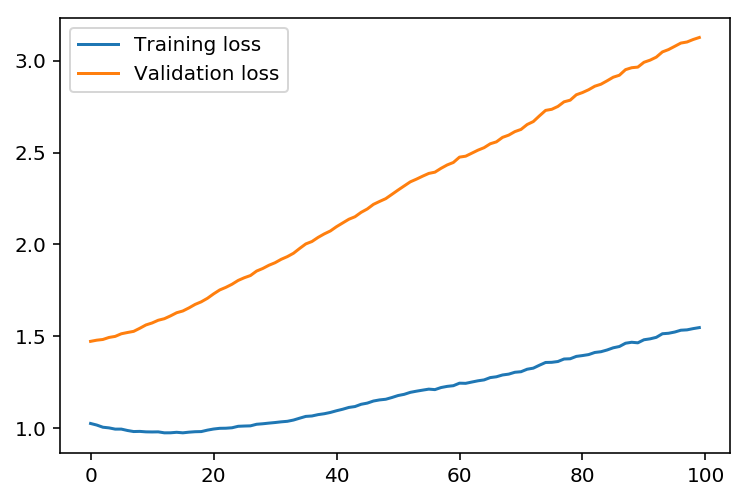

In [117]:
plt.plot(losses['train'], label='Training loss')
plt.plot(losses['validation'], label='Validation loss')
plt.legend()
_ = plt.ylim()

## Check out your predictions

Here, use the test data to view how well your network is modeling the data. If something is completely wrong here, make sure each step in your network is implemented correctly.

/Users/Arturo/anaconda/envs/dlnd/lib/python3.6/site-packages/ipykernel_launcher.py:10: DeprecationWarning: 
.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/indexing.html#ix-indexer-is-deprecated
  # Remove the CWD from sys.path while we load stuff.


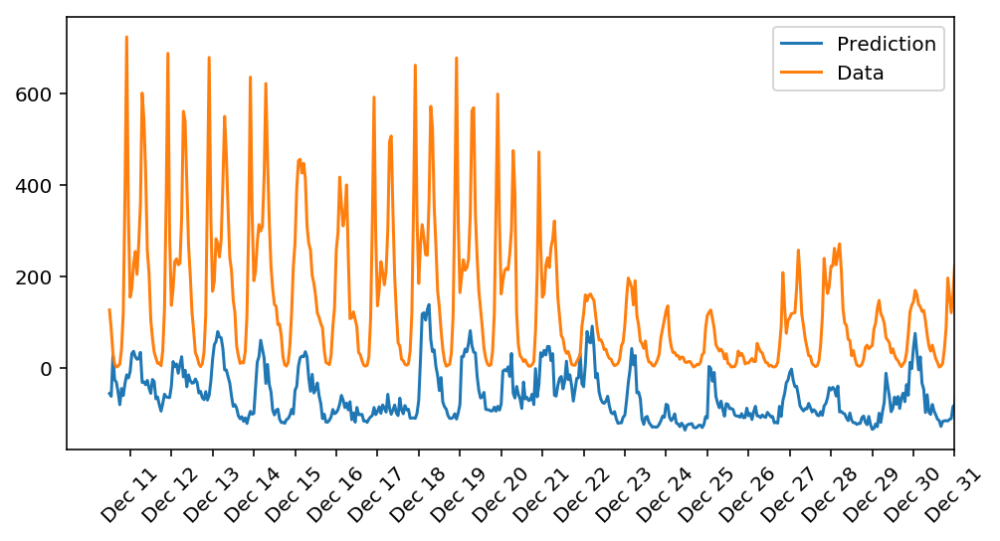

In [118]:
fig, ax = plt.subplots(figsize=(8,4))

mean, std = scaled_features['cnt']
predictions = network.run(test_features).T*std + mean
ax.plot(predictions[0], label='Prediction')
ax.plot((test_targets['cnt']*std + mean).values, label='Data')
ax.set_xlim(right=len(predictions))
ax.legend()

dates = pd.to_datetime(rides.ix[test_data.index]['dteday'])
dates = dates.apply(lambda d: d.strftime('%b %d'))
ax.set_xticks(np.arange(len(dates))[12::24])
_ = ax.set_xticklabels(dates[12::24], rotation=45)

## OPTIONAL: Thinking about your results(this question will not be evaluated in the rubric).
 
Answer these questions about your results. How well does the model predict the data? Where does it fail? Why does it fail where it does?

> **Note:** You can edit the text in this cell by double clicking on it. When you want to render the text, press control + enter

#### Your answer below

In [ ]:
I cannot get the unit tests to work so I will have to submit what I have since my backPropagation function is not working
